# 📌 1. Introdução

O objetivo deste projeto é construir modelos preditivos para **detectar churn de clientes em uma empresa de telecomunicações**, utilizando uma base de dados do Kaggle. A tarefa é de **classificação binária**, e envolve o uso de diferentes algoritmos, como redes neurais (MLP e Transformer), Random Forest, Gradient Boosting e mais.

Este notebook está organizado em seções por **responsável** e segue princípios de **código limpo** com **funções reutilizáveis**, documentação clara e visualizações apropriadas.

O grupo é composto por:

- Brenda  Guerra (bvga)
- Yasmin Maria Wanderley Soares (ymws)
- Gabriel Ferreira da Silva (gfs4)
- Lucas Santiago Monterazo (lsm6)
- Matheus Correia (mcr)


# ⚙️ 2. Metodologia

## 2.1. Etapas do projeto
O projeto foi dividido para ser feito por etapas, com cada membro responsável por uma etapa:
- **T1-T4 (lsm6)**: Pré-processamento dos dados, normalização, codificação e divisão dos conjuntos
- **T5-T6 (gfs4)**: Modelagem com MLP e Transformer
- **T7-T8 (mcr)**: Modelagem com Random Forest e Gradient Boosting
- **T9-T11 (dvga)**: Avaliação e visualização dos modelos
- **T12-T14 (ymws)**: Outras visualizações, organização, integração, documentação e apresentação



# 🧹 3. Pré-processamento



## 3.1. Carregamento e inspeção inicial

In [ ]:
#dependencias
!pip install tabular-transformers optuna

import importlib.util
from google.colab import files

def check_and_install(package):
    if importlib.util.find_spec(package) is None:
        !pip install {package} -qq

check_and_install('tensorflow')
check_and_install('numpy')
check_and_install('pandas')
check_and_install('scipy')
check_and_install('matplotlib')
check_and_install('scikit-learn')
check_and_install('kagglehub')
check_and_install('seaborn')
check_and_install('tabpfn')
check_and_install('torch')
check_and_install('tabular_transformers')
check_and_install('optuna')
check_and_install('xgboost')
check_and_install('lightgbm')
check_and_install('catboost')


#libs
import tensorflow as tf
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
import io
import os
from scipy import stats
from sklearn.metrics import mean_squared_error, log_loss, confusion_matrix, roc_auc_score, precision_score, recall_score, f1_score, roc_curve, auc
import seaborn as sns
%matplotlib inline

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 395.9/395.9 kB 17.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 247.0/247.0 kB 17.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.6/61.6 kB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 91.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 68.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 46.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 11.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
import kagglehub
import os
import pandas as pd

# Download do dataset pelo Kaggle
dataset_path = kagglehub.dataset_download("kapturovalexander/customers-churned-in-telecom-services")
csv_filename = 'customer_churn_telecom_services.csv' # Corrected filename
csv_filepath = os.path.join(dataset_path, csv_filename) # Construct the correct file path

#loading the dataset -- #decoding the files as uploaded will be a dictionary of keys (the file names) and values (the encoded file objects)

churn = pd.read_csv(csv_filepath)
display(churn.head())

,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
0,Female,0,Yes,No,1,No,No phone service,DSL,No,Yes,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,No
1,Male,0,No,No,34,Yes,No,DSL,Yes,No,Yes,No,No,No,One year,No,Mailed check,56.95,1889.50,No
2,Male,0,No,No,2,Yes,No,DSL,Yes,Yes,No,No,No,No,Month-to-month,Yes,Mailed check,53.85,108.15,Yes
3,Male,0,No,No,45,No,No phone service,DSL,Yes,No,Yes,Yes,No,No,One year,No,Bank transfer (automatic),42.30,1840.75,No
4,Female,0,No,No,2,Yes,No,Fiber optic,No,No,No,No,No,No,Month-to-month,Yes,Electronic check,70.70,151.65,Yes


## 3.2. Limpeza dos dados (nulos, inconsistências, outliers)

In [ ]:
def tratar_dados(df):
    # Remove irrelevant columns if any (none identified in this dataset initially)
    # Handle 'TotalCharges' which is object type and contains some spaces
    # Replace spaces with NaN and then convert to numeric
    df['TotalCharges'] = df['TotalCharges'].replace(' ', np.nan)
    df['TotalCharges'] = pd.to_numeric(df['TotalCharges'])

    # Remove rows with missing values (introduced by the above step or originally present)
    df = df.dropna()

    # Handle inconsistencies in categorical strings (extra spaces, capitalization)
    for col in df.select_dtypes(include='object').columns:
        df[col] = df[col].astype(str).str.strip().str.lower()

    return df

## 3.3. Codificação e normalização

- Codificação para redes (one-hot + normalização)

- Codificação para árvores (label ou nada)

In [ ]:
from sklearn.preprocessing import LabelEncoder, StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline

# Identify categorical and numerical features
def get_feature_types(df, target='Churn'):
    categorical_features = df.select_dtypes(include='object').columns.tolist()
    if target in categorical_features:
        categorical_features.remove(target)
    numeric_features = df.select_dtypes(include=np.number).columns.tolist()
    return categorical_features, numeric_features

# Preprocessing for Neural Networks (One-Hot Encoding + Scaling)
def preprocess_for_nn(df, target='Churn'):
    df_processed = df.copy()
    categorical_features, numeric_features = get_feature_types(df_processed, target=target)

    # Separate target variable before processing
    y = df_processed[target].apply(lambda x: 1 if x == 'Yes' else 0) # Convert Churn to 0/1
    X = df_processed.drop(target, axis=1)


    # Create a column transformer for applying different transformations to different columns
    preprocessor = ColumnTransformer(
        transformers=[
            ('num', StandardScaler(), numeric_features),
            ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)])

    # Create a preprocessing pipeline
    pipeline = Pipeline(steps=[('preprocessor', preprocessor)])

    X_processed = pipeline.fit_transform(X)
    return X_processed, y, pipeline # Return pipeline to be used for transforming new data

# Preprocessing for Tree-based Models (Label Encoding - for categorical features where order doesn't matter, or leave as is for some algorithms)
# For simplicity and compatibility with most tree models in sklearn, we'll use Label Encoding for object types.
def preprocess_for_trees(df, target='Churn'):
    df_processed = df.copy()
    # Convert target to numeric
    df_processed[target] = df_processed[target].apply(lambda x: 1 if x == 'yes' else 0)

    for col in df_processed.select_dtypes(include='object').columns:
        df_processed[col] = LabelEncoder().fit_transform(df_processed[col])

    X = df_processed.drop(target, axis=1)
    y = df_processed[target]

    return X, y

## 3.4. Divisão dos dados (treino, validação, teste)

In [ ]:
from sklearn.model_selection import train_test_split

def dividir_dados(X, y):
    X_trainval, X_test, y_trainval, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)
    X_train, X_val, y_train, y_val = train_test_split(X_trainval, y_trainval, test_size=0.25, random_state=42, stratify=y_trainval)

    return X_train, X_val, X_test, y_train, y_val, y_test

## 3.5 Feature Engineering

In [ ]:
def create_engineered_features(df):
    df_engineered = df.copy()

    df_engineered['AvgMonthlyCharge_per_Tenure'] = df_engineered.apply(
        lambda row: row['TotalCharges'] / row['tenure'] if row['tenure'] > 0 else 0, axis=1
    )

    optional_services = ['OnlineSecurity', 'OnlineBackup', 'DeviceProtection', 'TechSupport', 'StreamingTV', 'StreamingMovies']
    for col in optional_services:
        if col in df_engineered.columns:
            # Ensure consistent handling of 'No internet service' or similar
            df_engineered[col] = df_engineered[col].apply(lambda x: 1 if x == 'Yes' else 0)
    df_engineered['NumExtraServices'] = df_engineered[optional_services].sum(axis=1)

    if 'InternetService' in df_engineered.columns and 'Contract' in df_engineered.columns:
         df_engineered['InternetService_Contract'] = df_engineered['InternetService'] + '_' + df_engineered['Contract']

    if 'PaymentMethod' in df_engineered.columns:
        df_engineered['IsElectronicCheck'] = df_engineered['PaymentMethod'].apply(lambda x: 1 if x == 'Electronic check' else 0)

    return df_engineered

# Apply the feature engineering step to your cleaned data
# Make sure to run the 'tratar_dados' function first to get 'churn_cleaned'
churn_cleaned = tratar_dados(churn.copy())
churn_cleaned_engineered = create_engineered_features(churn_cleaned.copy())

print("Original columns:", churn_cleaned.columns.tolist())
print("Columns after feature engineering:", churn_cleaned_engineered.columns.tolist())
display(churn_cleaned_engineered[['tenure', 'MonthlyCharges', 'TotalCharges', 'AvgMonthlyCharge_per_Tenure', 'NumExtraServices', 'InternetService_Contract', 'IsElectronicCheck']].head())

Original columns: ['gender', 'SeniorCitizen', 'Partner', 'Dependents', 'tenure', 'PhoneService', 'MultipleLines', 'InternetService', 'OnlineSecurity', 'OnlineBackup', 'DeviceProtection', 'TechSupport', 'StreamingTV', 'StreamingMovies', 'Contract', 'PaperlessBilling', 'PaymentMethod', 'MonthlyCharges', 'TotalCharges', 'Churn']
Columns after feature engineering: ['gender', 'SeniorCitizen', 'Partner', 'Dependents', 'tenure', 'PhoneService', 'MultipleLines', 'InternetService', 'OnlineSecurity', 'OnlineBackup', 'DeviceProtection', 'TechSupport', 'StreamingTV', 'StreamingMovies', 'Contract', 'PaperlessBilling', 'PaymentMethod', 'MonthlyCharges', 'TotalCharges', 'Churn', 'AvgMonthlyCharge_per_Tenure', 'NumExtraServices', 'InternetService_Contract', 'IsElectronicCheck']


,tenure,MonthlyCharges,TotalCharges,AvgMonthlyCharge_per_Tenure,NumExtraServices,InternetService_Contract,IsElectronicCheck
0,1,29.85,29.85,29.850000,0,dsl_month-to-month,0
1,34,56.95,1889.50,55.573529,0,dsl_one year,0
2,2,53.85,108.15,54.075000,0,dsl_month-to-month,0
3,45,42.30,1840.75,40.905556,0,dsl_one year,0
4,2,70.70,151.65,75.825000,0,fiber optic_month-to-month,0


## 3.6. Visualização inicial dos dados

In [ ]:
# Apply data cleaning
churn_cleaned = tratar_dados(churn.copy())


# Apply feature engineering
churn_engineered = create_engineered_features(churn_cleaned.copy())


# Data reparticioning (Should be in division) !!!IMPORTANT!!!
churn_minority = churn_engineered[churn_engineered['Churn'] == 'yes']
churn_majority = churn_engineered[churn_engineered['Churn'] == 'no']

churn_minority_duplicated = pd.concat([churn_minority]*3, ignore_index=True)

churn_balanced = pd.concat([churn_majority, churn_minority_duplicated], ignore_index=True)

# Preprocessing and Splitting for Neural Networks
X_processed_nn, y_nn, pipeline_nn = preprocess_for_nn(churn_balanced)
X_train_nn, X_val_nn, X_test_nn, y_train_nn, y_val_nn, y_test_nn = dividir_dados(X_processed_nn, y_nn)

# Preprocessing and Splitting for Tree-based Models
X_processed_trees, y_trees = preprocess_for_trees(churn_balanced)
X_train_trees, X_val_trees, X_test_trees, y_train_trees, y_val_trees, y_test_trees = dividir_dados(X_processed_trees, y_trees)

print("Data preprocessing and splitting complete.")
print("\nShapes for Neural Networks:")
print("X_train_nn:", X_train_nn.shape)
print("X_val_nn:", X_val_nn.shape)
print("X_test_nn:", X_test_nn.shape)
print("y_train_nn:", y_train_nn.shape)
print("y_val_nn:", y_val_nn.shape)
print("y_test_nn:", y_test_nn.shape)

print("\nShapes for Tree-based Models:")
print("X_train_trees:", X_train_trees.shape)
print("X_val_trees:", X_val_trees.shape)
print("X_test_trees:", X_test_trees.shape)
print("y_train_trees:", y_train_trees.shape)
print("y_val_trees:", y_val_trees.shape)
print("y_test_trees:", y_test_trees.shape)

Data preprocessing and splitting complete.

Shapes for Neural Networks:
X_train_nn: (6462, 45)
X_val_nn: (2154, 45)
X_test_nn: (2154, 45)
y_train_nn: (6462,)
y_val_nn: (2154,)
y_test_nn: (2154,)

Shapes for Tree-based Models:
X_train_trees: (6462, 23)
X_val_trees: (2154, 23)
X_test_trees: (2154, 23)
y_train_trees: (6462,)
y_val_trees: (2154,)
y_test_trees: (2154,)



--- Data after Cleaning ---
Shape before cleaning: (7043, 20)
Shape after cleaning: (7032, 20)

Missing values after cleaning:
gender              0
SeniorCitizen       0
Partner             0
Dependents          0
tenure              0
PhoneService        0
MultipleLines       0
InternetService     0
OnlineSecurity      0
OnlineBackup        0
DeviceProtection    0
TechSupport         0
StreamingTV         0
StreamingMovies     0
Contract            0
PaperlessBilling    0
PaymentMethod       0
MonthlyCharges      0
TotalCharges        0
Churn               0
dtype: int64

--- Visualizing outliers after cleaning ---


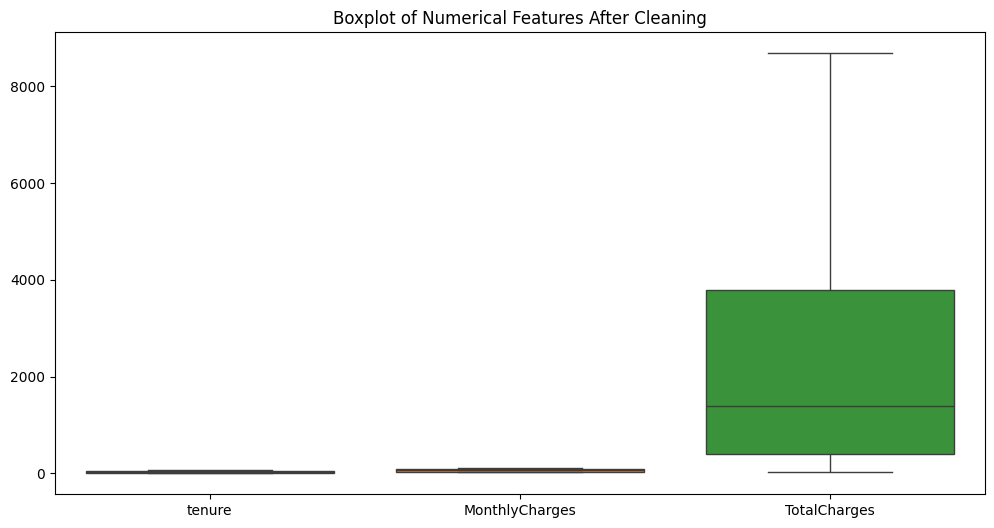


--- Data after Feature Engineering ---
Shape after Feature Engineering: (7032, 24)


,tenure,MonthlyCharges,TotalCharges,AvgMonthlyCharge_per_Tenure,NumExtraServices,InternetService_Contract,IsElectronicCheck
0,1,29.85,29.85,29.850000,0,dsl_month-to-month,0
1,34,56.95,1889.50,55.573529,0,dsl_one year,0
2,2,53.85,108.15,54.075000,0,dsl_month-to-month,0
3,45,42.30,1840.75,40.905556,0,dsl_one year,0
4,2,70.70,151.65,75.825000,0,fiber optic_month-to-month,0



--- Data after Encoding (for Neural Networks) ---
Shape after One-Hot Encoding and Scaling: (10770, 45)


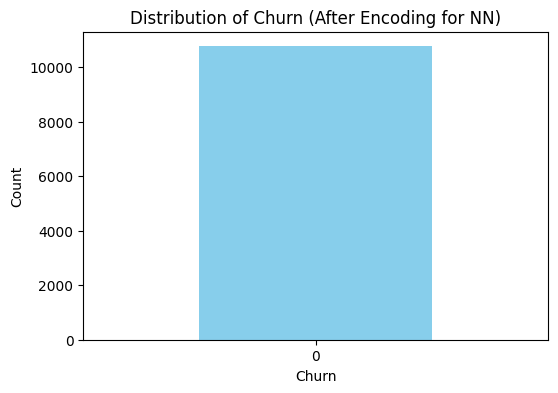


--- Data after Encoding (for Tree-based Models) ---
Shape after Label Encoding: (10770, 23)


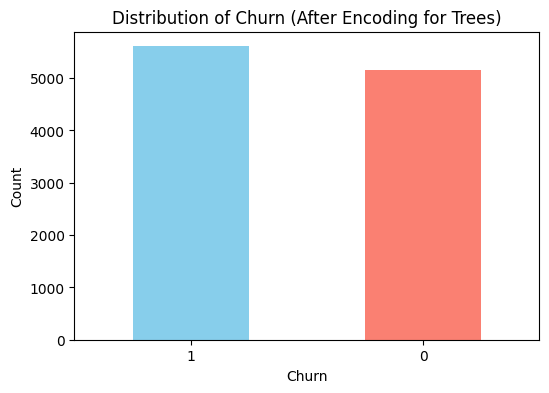


--- Data after Splitting (Example for Neural Networks) ---
Shape of X_train_nn: (6462, 45)
Shape of X_val_nn: (2154, 45)
Shape of X_test_nn: (2154, 45)
Shape of y_train_nn: (6462,)
Shape of y_val_nn: (2154,)
Shape of y_test_nn: (2154,)


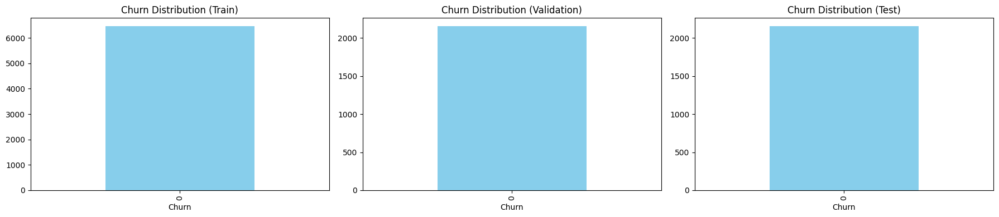

In [ ]:
print("\n--- Data after Cleaning ---")
print("Shape before cleaning:", churn.shape)
print("Shape after cleaning:", churn_cleaned.shape)
print("\nMissing values after cleaning:")
print(churn_cleaned.isnull().sum())

print("\n--- Visualizing outliers after cleaning ---")
plt.figure(figsize=(12, 6))
sns.boxplot(data=churn_cleaned[['tenure', 'MonthlyCharges', 'TotalCharges']])
plt.title('Boxplot of Numerical Features After Cleaning')
plt.show()


print("\n--- Data after Feature Engineering ---")
print("Shape after Feature Engineering:", churn_engineered.shape)
display(churn_engineered[['tenure', 'MonthlyCharges', 'TotalCharges', 'AvgMonthlyCharge_per_Tenure', 'NumExtraServices', 'InternetService_Contract', 'IsElectronicCheck']].head())


print("\n--- Data after Encoding (for Neural Networks) ---")
print("Shape after One-Hot Encoding and Scaling:", X_processed_nn.shape)
# Visualize the distribution of the target variable in the processed data.
plt.figure(figsize=(6, 4))
pd.Series(y_nn).value_counts().plot(kind='bar', color=['skyblue', 'salmon'])
plt.title('Distribution of Churn (After Encoding for NN)')
plt.xlabel('Churn')
plt.ylabel('Count')
plt.xticks(rotation=0)
plt.show()


print("\n--- Data after Encoding (for Tree-based Models) ---")
print("Shape after Label Encoding:", X_processed_trees.shape)
# Visualize the distribution of the target variable again.
plt.figure(figsize=(6, 4))
pd.Series(y_trees).value_counts().plot(kind='bar', color=['skyblue', 'salmon'])
plt.title('Distribution of Churn (After Encoding for Trees)')
plt.xlabel('Churn')
plt.ylabel('Count')
plt.xticks(rotation=0)
plt.show()


print("\n--- Data after Splitting (Example for Neural Networks) ---")
print("Shape of X_train_nn:", X_train_nn.shape)
print("Shape of X_val_nn:", X_val_nn.shape)
print("Shape of X_test_nn:", X_test_nn.shape)
print("Shape of y_train_nn:", y_train_nn.shape)
print("Shape of y_val_nn:", y_val_nn.shape)
print("Shape of y_test_nn:", y_test_nn.shape)

# Visualize the distribution of the target variable in each split to check stratification.
plt.figure(figsize=(18, 4))
plt.subplot(1, 3, 1)
pd.Series(y_train_nn).value_counts().plot(kind='bar', color=['skyblue', 'salmon'])
plt.title('Churn Distribution (Train)')
plt.subplot(1, 3, 2)
pd.Series(y_val_nn).value_counts().plot(kind='bar', color=['skyblue', 'salmon'])
plt.title('Churn Distribution (Validation)')
plt.subplot(1, 3, 3)
pd.Series(y_test_nn).value_counts().plot(kind='bar', color=['skyblue', 'salmon'])
plt.title('Churn Distribution (Test)')
plt.tight_layout()
plt.show()

## 6.1. Métricas de avaliação

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
from sklearn.metrics import mean_squared_error, log_loss, confusion_matrix, roc_auc_score, precision_score, recall_score, f1_score, roc_curve, auc

In [ ]:
# KS
def ks_statistic(y_true, y_pred):
    y_true = np.asarray(y_true).ravel()
    y_pred = np.asarray(y_pred).ravel()
    ks_stat, p_value = stats.ks_2samp(y_true, y_pred)
    return float(ks_stat), float(p_value)

In [ ]:
# Plot Gráfico KS
def plot_ks_distribution(y_true, y_pred_prob):
    y_true = np.asarray(y_true).ravel()       # garante vetor 1D
    y_pred_prob = np.asarray(y_pred_prob).ravel()

    plt.figure(figsize=(10, 6))
    plt.hist(y_true, bins=20, alpha=0.5, label="Real", color='blue')
    plt.hist(y_pred_prob, bins=20, alpha=0.5, label="Predito", color='red')

    plt.title("Distribuição das Previsões Reais vs. Previsões do Modelo")
    plt.xlabel("Valor")
    plt.ylabel("Frequência")
    plt.legend(loc="best")

    ks_stat, p_value = stats.ks_2samp(y_true, y_pred_prob)

    # forçar a ser float antes de formatar
    ks_stat = float(ks_stat)
    p_value = float(p_value)

    plt.text(0.95, 0.95, f"KS Stat: {ks_stat:.3f}\nP-Value: {p_value:.3f}",
             ha='right', va='top', transform=plt.gca().transAxes,
             fontsize=12, color='black')

    plt.tight_layout()
    plt.show()

In [ ]:
# MSE
def calculate_mse(y_true, y_pred):
    mse = mean_squared_error(y_true, y_pred)
    return mse

In [ ]:
# Cross Entropy
def cross_entropy(y_true, y_pred_prob):
    return log_loss(y_true, y_pred_prob)

In [ ]:
# Matriz de Confusão
def confusion_matrix_metrics(y_true, y_pred):
    cm = confusion_matrix(y_true, y_pred)
    return cm

In [ ]:
def plot_confusion_matrix(y_true, y_pred, title):
    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(4, 3))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
                xticklabels=["Negativo", "Positivo"],
                yticklabels=["Negativo", "Positivo"])
    plt.xlabel("Predito")
    plt.ylabel("Verdadeiro")
    plt.title(title)
    plt.tight_layout()
    plt.show()

In [ ]:
# ROC
def auc_roc(y_true, y_pred_prob):
    auc = roc_auc_score(y_true, y_pred_prob)
    return auc

In [ ]:
# Plot Curva ROC
def plot_roc_curve(y_true, y_pred_prob):
    fpr, tpr, thresholds = roc_curve(y_true, y_pred_prob)

    roc_auc = auc(fpr, tpr)

    plt.figure(figsize=(10, 6))
    plt.plot(fpr, tpr, color='blue', label=f'Curva ROC (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='gray', linestyle='--', label='Linha Aleatória (AUC = 0.5)')

    plt.title("Curva ROC")
    plt.xlabel("Taxa de Falsos Positivos (FPR)")
    plt.ylabel("Taxa de Verdadeiros Positivos (TPR)")
    plt.legend(loc="lower right")

    plt.tight_layout()
    plt.show()

In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

def classification_metrics(y_true, y_pred):
    accuracy  = accuracy_score(y_true, y_pred)
    precision = precision_score(y_true, y_pred)
    recall    = recall_score(y_true, y_pred)
    f1        = f1_score(y_true, y_pred)
    return accuracy, precision, recall, f1

In [ ]:
def ks_score_and_plot(y_true, y_pred_prob, title="KS Statistic"):
    # vetor 1D
    y_true = np.asarray(y_true).ravel().astype(int)
    scores = np.asarray(y_pred_prob).ravel().astype(float)

    # ordena por score (crescente)
    order = np.argsort(scores)
    y_sorted = y_true[order]
    s_sorted = scores[order]

    # totais
    n_pos = (y_sorted == 1).sum()
    n_neg = (y_sorted == 0).sum()
    if n_pos == 0 or n_neg == 0:
        raise ValueError("KS requer ao menos um positivo e um negativo.")

    # CDFs cumulativas
    cum_pos = np.cumsum(y_sorted == 1) / n_pos
    cum_neg = np.cumsum(y_sorted == 0) / n_neg

    # distância KS ponto a ponto
    ks_diff = np.abs(cum_pos - cum_neg)
    ks_idx  = np.argmax(ks_diff)
    ks_val  = float(ks_diff[ks_idx])
    ks_thr  = float(s_sorted[ks_idx])

    # Plot (CDFs + anotação do KS)
    plt.figure(figsize=(7, 5))
    plt.plot(s_sorted, cum_pos, label="CDF Positivos", linewidth=2)
    plt.plot(s_sorted, cum_neg, label="CDF Negativos", linewidth=2)
    plt.vlines(ks_thr, cum_neg[ks_idx], cum_pos[ks_idx], linestyles="--")
    plt.scatter([ks_thr, ks_thr], [cum_pos[ks_idx], cum_neg[ks_idx]])

    plt.title(f"{title} | KS={ks_val:.3f} @thr={ks_thr:.4f}")
    plt.xlabel("Probabilidade prevista (score)")
    plt.ylabel("Fração cumulativa")
    plt.legend(loc="lower right")
    plt.tight_layout()
    plt.show()

    return ks_val, ks_thr

In [ ]:
# Avaliação do Modelo
def evaluate_model(model, X_train, X_val, X_test, y_train, y_val, y_test):

    y_train_pred_prob = model.predict(X_train).squeeze()
    y_val_pred_prob   = model.predict(X_val).squeeze()
    y_test_pred_prob  = model.predict(X_test).squeeze()

    # Classes (0 ou 1)
    y_train_pred = (y_train_pred_prob >= 0.5).astype(int)
    y_val_pred   = (y_val_pred_prob   >= 0.5).astype(int)
    y_test_pred  = (y_test_pred_prob  >= 0.5).astype(int)

    # MSE
    mse_train = calculate_mse(y_train, y_train_pred)
    mse_val = calculate_mse(y_val, y_val_pred)
    mse_test = calculate_mse(y_test, y_test_pred)

    # Cross-Entropy
    ce_train = cross_entropy(y_train, y_train_pred_prob)
    ce_val = cross_entropy(y_val, y_val_pred_prob)
    ce_test = cross_entropy(y_test, y_test_pred_prob)

    # Métricas de classificação
    accuracy_train, precision_train, recall_train, f1_train = classification_metrics(y_train, y_train_pred)
    accuracy_val, precision_val, recall_val, f1_val = classification_metrics(y_val, y_val_pred)
    accuracy_test, precision_test, recall_test, f1_test = classification_metrics(y_test, y_test_pred)

    # AUC-ROC
    auc_train = auc_roc(y_train, y_train_pred_prob)
    auc_val = auc_roc(y_val, y_val_pred_prob)
    auc_test = auc_roc(y_test, y_test_pred_prob)

    # KS Statistic
    ks_train, ks_p_value_train = ks_statistic(y_train, y_train_pred_prob)
    ks_val, ks_p_value_val = ks_statistic(y_val, y_val_pred_prob)
    ks_test, ks_p_value_test = ks_statistic(y_test, y_test_pred_prob)

    # Matriz de Confusão
    cm_train = confusion_matrix_metrics(y_train, y_train_pred)
    cm_val = confusion_matrix_metrics(y_val, y_val_pred)
    cm_test = confusion_matrix_metrics(y_test, y_test_pred)

    # Printando todos os resultados
    print('\n')
    print(f'MSE Train: {mse_train}')
    print(f'MSE Val: {mse_val}')
    print(f'MSE Test: {mse_test}')
    print('\n')

    print('\n')
    print(f'Cross-Entropy Train: {ce_train}')
    print(f'Cross-Entropy Val: {ce_val}')
    print(f'Cross-Entropy Test: {ce_test}')
    print('\n')

    print('\n')
    print(f'Accuracy Train: {accuracy_train}')
    print(f'Accuracy Val: {accuracy_val}')
    print(f'Accuracy Test: {accuracy_test}')
    print('\n')

    print('\n')
    print(f'Precision Train: {precision_train}')
    print(f'Precision Val: {precision_val}')
    print(f'Precision Test: {precision_test}')
    print('\n')

    print('\n')
    print(f'Recall Train: {recall_train}')
    print(f'Recall Val: {recall_val}')
    print(f'Recall Test: {recall_test}')
    print('\n')

    print('\n')
    print(f'F1 Train: {f1_train}')
    print(f'F1 Val: {f1_val}')
    print(f'F1 Test: {f1_test}')
    print('\n')

    print('\n')
    print(f'AUC Train: {auc_train}')
    print(f'AUC Val: {auc_val}')
    print(f'AUC Test: {auc_test}')
    print('\n')

    print('\n')
    print(f'Confusion Matrix Train: \n{cm_train}')
    print(f'Confusion Matrix Val: \n{cm_val}')
    print(f'Confusion Matrix Test: \n{cm_test}')
    print('\n')


    print('\n')
    plot_confusion_matrix(y_train, y_train_pred, "Matriz de Confusão - Treino")
    print('\n')
    plot_confusion_matrix(y_val,   y_val_pred,   "Matriz de Confusão - Validação")
    print('\n')
    plot_confusion_matrix(y_test,  y_test_pred,  "Matriz de Confusão - Teste")
    print('\n')

    # Plotando a curva ROC
    print('\n')
    plot_roc_curve(y_test, y_test_pred_prob)
    print('\n')

    # Plotando a curva KS
    print('\n')
    plot_ks_distribution(y_test, y_test_pred_prob)
    print('\n')

    print('\n')
    ks_train, thr_train = ks_score_and_plot(y_train_nn, y_train_pred_prob, "KS - Treino")
    print('\n')
    ks_val,   thr_val   = ks_score_and_plot(y_val_nn,   y_val_pred_prob,   "KS - Validação")
    print('\n')
    ks_test,  thr_test  = ks_score_and_plot(y_test_nn,  y_test_pred_prob,  "KS - Teste")
    print('\n')

# 🧠 4. Modelagem com Redes Neurais (Pessoa 2)

## MLP

Experimentações:


1.   
2.   Item de lista





In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, LabelEncoder
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping

import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, roc_auc_score
import numpy as np
import tensorflow as tf

def auc_roc(y_true, y_pred_prob):
    auc = roc_auc_score(y_true, y_pred_prob)
    return auc

def ks_statistic(y_true, y_pred):
    ks_stat, p_value = stats.ks_2samp(y_true, y_pred)
    return ks_stat, p_value
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, roc_auc_score
import numpy as np
import tensorflow as tf

class RocKsCallback(tf.keras.callbacks.Callback):
    def __init__(self, X_val, y_val, plot_interval=25):
        super().__init__()
        self.X_val = X_val
        self.y_val = y_val
        self.plot_interval = plot_interval

    def on_epoch_end(self, epoch, logs=None):
        y_pred_proba = self.model.predict(self.X_val, verbose=0).ravel()

        # ROC AUC
        fpr, tpr, thresholds = roc_curve(self.y_val, y_pred_proba)
        roc_auc = roc_auc_score(self.y_val, y_pred_proba)

        # KS
        ks_statistic = np.max(np.abs(tpr - fpr))
        ks_threshold = thresholds[np.argmax(np.abs(tpr - fpr))]

        print(f"Epoch {epoch+1} - ROC AUC: {roc_auc:.4f} | KS: {ks_statistic:.4f}")

        # Plot & show in Colab
        if (epoch + 1) % self.plot_interval == 0:
            fig, axs = plt.subplots(1, 2, figsize=(10, 4))

            # ROC plot
            axs[0].plot(fpr, tpr, label=f'AUC = {roc_auc:.3f}')
            axs[0].plot([0, 1], [0, 1], 'k--')
            axs[0].set_title(f'ROC Curve - Epoch {epoch+1}')
            axs[0].set_xlabel('FPR')
            axs[0].set_ylabel('TPR')
            axs[0].legend()
            axs[0].grid(True)

            # KS plot
            axs[1].plot(thresholds, tpr, label='TPR')
            axs[1].plot(thresholds, fpr, label='FPR')
            axs[1].axvline(ks_threshold, color='r', linestyle='--',
                           label=f'KS = {ks_statistic:.3f}')
            axs[1].set_title('KS Curve')
            axs[1].set_xlabel('Threshold')
            axs[1].set_ylabel('Rate')
            axs[1].legend()
            axs[1].grid(True)

            plt.tight_layout()
            plt.show()
            plt.savefig(f'roc_ks_epoch_{epoch+1}.png', dpi=300)




### Experimentação 1

Epoch 1/500


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


150/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6646 - loss: 0.6231Epoch 1 - ROC AUC: 0.8068 | KS: 0.4756
162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - accuracy: 0.6672 - loss: 0.6206 - val_accuracy: 0.7374 - val_loss: 0.5390
Epoch 2/500
156/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7379 - loss: 0.5288Epoch 2 - ROC AUC: 0.8224 | KS: 0.4872
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7382 - loss: 0.5284 - val_accuracy: 0.7378 - val_loss: 0.5163
Epoch 3/500
157/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7455 - loss: 0.5114Epoch 3 - ROC AUC: 0.8279 | KS: 0.4942
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7456 - loss: 0.5112 - val_accuracy: 0.7428 - val_loss: 0.5088
Epoch 4/500
158/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7535 - loss: 0.4961Epoch 4 - ROC AUC: 0.8291 | KS: 0.4981
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7533 - loss: 0.4963 - val_accuracy: 0.7490 - val_loss: 0.5057
Epoch 5/500
143/162 ━━━━━━━━━━━━━━━━━━━━ 0s

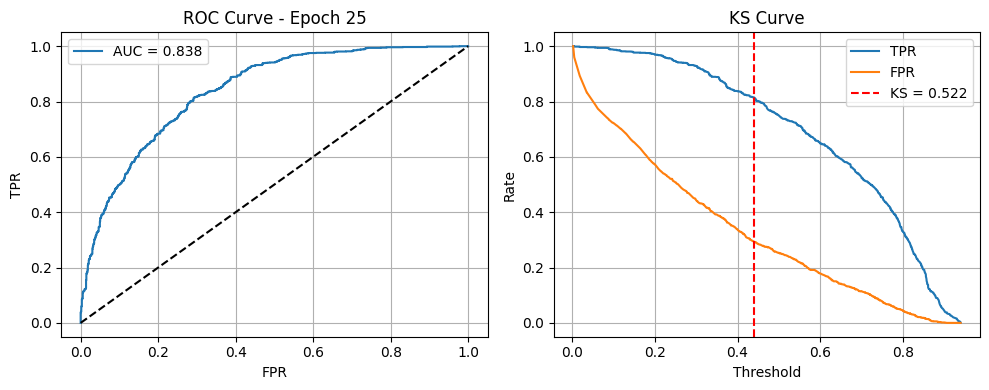

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.7539 - loss: 0.4935 - val_accuracy: 0.7483 - val_loss: 0.4929
Epoch 26/500
148/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7494 - loss: 0.4925Epoch 26 - ROC AUC: 0.8393 | KS: 0.5221
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - accuracy: 0.7504 - loss: 0.4914 - val_accuracy: 0.7607 - val_loss: 0.4915
Epoch 27/500
144/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7702 - loss: 0.4692Epoch 27 - ROC AUC: 0.8383 | KS: 0.5167
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7693 - loss: 0.4701 - val_accuracy: 0.7483 - val_loss: 0.4920
Epoch 28/500
144/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7737 - loss: 0.4681Epoch 28 - ROC AUC: 0.8401 | KS: 0.5221
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7721 - loss: 0.4696 - val_accuracy: 0.7568 - val_loss: 0.4903
Epoch 29/500
143/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7741 - loss: 0.4675Epoch 29 - ROC AUC: 0.8400 | KS: 0.5182
162/162 ━━━━━━━━━━━━━━━━

<Figure size 640x480 with 0 Axes>

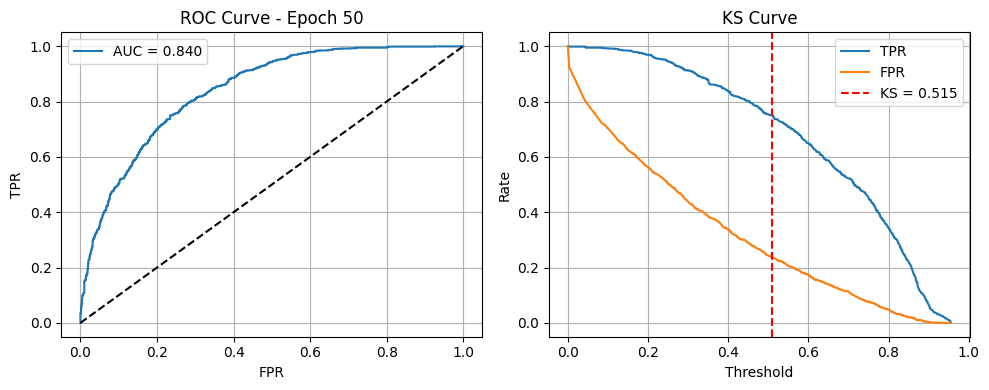

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.7740 - loss: 0.4693 - val_accuracy: 0.7552 - val_loss: 0.4891
Epoch 51/500
160/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7713 - loss: 0.4596Epoch 51 - ROC AUC: 0.8406 | KS: 0.5182
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7713 - loss: 0.4598 - val_accuracy: 0.7545 - val_loss: 0.4869
Epoch 52/500
158/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7708 - loss: 0.4651Epoch 52 - ROC AUC: 0.8405 | KS: 0.5174
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7708 - loss: 0.4652 - val_accuracy: 0.7572 - val_loss: 0.4881
Epoch 53/500
159/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7646 - loss: 0.4753Epoch 53 - ROC AUC: 0.8397 | KS: 0.5151
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7648 - loss: 0.4751 - val_accuracy: 0.7545 - val_loss: 0.4885
Epoch 54/500
161/162 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7592 - loss: 0.4808Epoch 54 - ROC AUC: 0.8412 | KS: 0.5221
162/162 ━━━━━━━━━━━━━━━━

<Figure size 640x480 with 0 Axes>

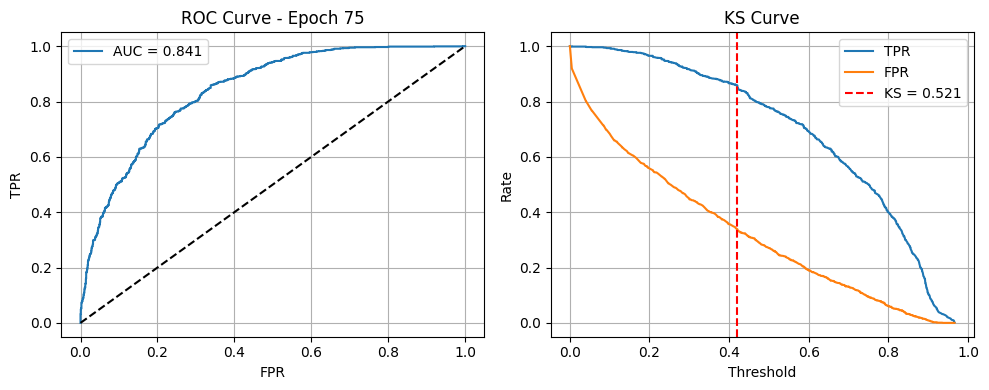

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.7650 - loss: 0.4763 - val_accuracy: 0.7545 - val_loss: 0.4865
Epoch 76/500
145/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7754 - loss: 0.4577Epoch 76 - ROC AUC: 0.8418 | KS: 0.5252
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - accuracy: 0.7756 - loss: 0.4581 - val_accuracy: 0.7568 - val_loss: 0.4851
Epoch 77/500
157/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7767 - loss: 0.4591Epoch 77 - ROC AUC: 0.8415 | KS: 0.5221
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7767 - loss: 0.4592 - val_accuracy: 0.7533 - val_loss: 0.4856
Epoch 78/500
157/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7829 - loss: 0.4475Epoch 78 - ROC AUC: 0.8401 | KS: 0.5198
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7826 - loss: 0.4481 - val_accuracy: 0.7552 - val_loss: 0.4878
Epoch 79/500
146/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7751 - loss: 0.4589Epoch 79 - ROC AUC: 0.8409 | KS: 0.5190
162/162 ━━━━━━━━━━━━━━━

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


✅ Validação final — Loss: 0.4851, Accuracy: 0.7568


<Figure size 640x480 with 0 Axes>

In [ ]:
# MLP simples com:
# - 1 camada oculta de 10 neurônios, ativação ReLU
# - camada de saída: 1 neurônio, ativação sigmoide para saída binária
# Otimizador: Adam
# Taxa de aprendizado padrão do Adam
# Sem dropout ou regularização explícita
# Épocas máximas: 500, com early stopping
# Patience do early stopping: 20 (para evitar overfitting)

model = Sequential([
    Dense(10, activation='relu', input_shape=(X_train_nn.shape[1],)),
    Dense(1, activation='sigmoid')
])

model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
early_stop = EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)
history = model.fit(
    X_train_nn, y_train_nn,
    validation_data=(X_val_nn, y_val_nn),
    epochs=500,
    callbacks=[early_stop, RocKsCallback(X_val_nn, y_val_nn)],
    verbose=1,
    batch_size=32
)

model.save('nn_1camada.h5')
files.download('nn_1camada.h5')

loss, acc = model.evaluate(X_val_nn, y_val_nn, verbose=0)
print(f"\n✅ Validação final — Loss: {loss:.4f}, Accuracy: {acc:.4f}")

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, precision_score, recall_score, f1_score

y_pred_probs = model.predict(X_test_nn)
y_pred = (y_pred_probs > 0.5).astype(int).flatten()

precision = precision_score(y_test_nn, y_pred)
recall = recall_score(y_test_nn, y_pred)
f1 = f1_score(y_test_nn, y_pred)

print("\n📊 Classification Report:\n")
print(classification_report(y_test_nn, y_pred, target_names=["Não Churn", "Churn"]))


81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

📊 Classification Report:

              precision    recall  f1-score   support

   Não Churn       0.81      0.75      0.78      1291
       Churn       0.77      0.82      0.79      1291

    accuracy                           0.79      2582
   macro avg       0.79      0.79      0.79      2582
weighted avg       0.79      0.79      0.79      2582



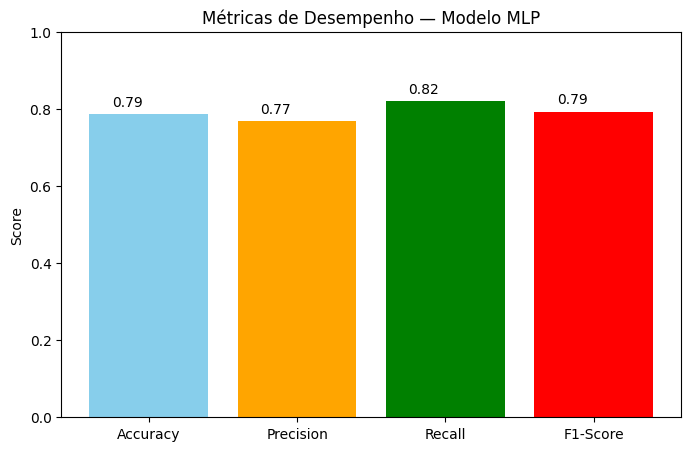

In [ ]:
import matplotlib.pyplot as plt

metrics_names = ['Accuracy', 'Precision', 'Recall', 'F1-Score']
metrics_values = [
    model.evaluate(X_test_nn, y_test_nn, verbose=0)[1],  # accuracy from model
    precision,
    recall,
    f1
]

plt.figure(figsize=(8, 5))
bars = plt.bar(metrics_names, metrics_values, color=['skyblue', 'orange', 'green', 'red'])
plt.ylim(0, 1)
plt.title('Métricas de Desempenho — Modelo MLP')
plt.ylabel('Score')
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + 0.15, yval + 0.02, f'{yval:.2f}')
plt.show()


### Experimentação 2

Epoch 1/500


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5535 - loss: 0.6774Epoch 1 - ROC AUC: 0.8001 | KS: 0.4957
162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - accuracy: 0.5537 - loss: 0.6773 - val_accuracy: 0.7471 - val_loss: 0.5913
Epoch 2/500
148/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6881 - loss: 0.5999Epoch 2 - ROC AUC: 0.8157 | KS: 0.5058
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.6881 - loss: 0.5995 - val_accuracy: 0.7517 - val_loss: 0.5430
Epoch 3/500
153/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7075 - loss: 0.5885Epoch 3 - ROC AUC: 0.8209 | KS: 0.5143
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.7075 - loss: 0.5881 - val_accuracy: 0.7568 - val_loss: 0.5331
Epoch 4/500
156/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7180 - loss: 0.5676Epoch 4 - ROC AUC: 0.8247 | KS: 0.5120
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7176 - loss: 0.5678 - val_accuracy: 0.7475 - val_loss: 0.5259
Epoch 5/500
157/162 ━━━━━━━━━━━━━━━━━━━━ 0s 

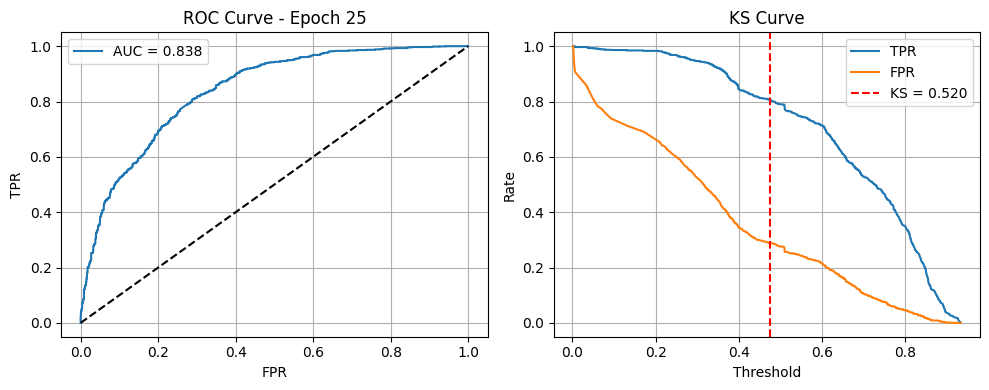

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.7547 - loss: 0.5289 - val_accuracy: 0.7568 - val_loss: 0.4970
Epoch 26/500
147/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7556 - loss: 0.5221Epoch 26 - ROC AUC: 0.8380 | KS: 0.5205
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7555 - loss: 0.5219 - val_accuracy: 0.7545 - val_loss: 0.4976
Epoch 27/500
148/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7537 - loss: 0.5173Epoch 27 - ROC AUC: 0.8370 | KS: 0.5198
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.7532 - loss: 0.5173 - val_accuracy: 0.7510 - val_loss: 0.5025
Epoch 28/500
157/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7480 - loss: 0.5225Epoch 28 - ROC AUC: 0.8388 | KS: 0.5267
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7483 - loss: 0.5221 - val_accuracy: 0.7521 - val_loss: 0.4970
Epoch 29/500
154/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7471 - loss: 0.5293Epoch 29 - ROC AUC: 0.8388 | KS: 0.5283
162/162 ━━━━━━━━━━━━━━━━

<Figure size 640x480 with 0 Axes>

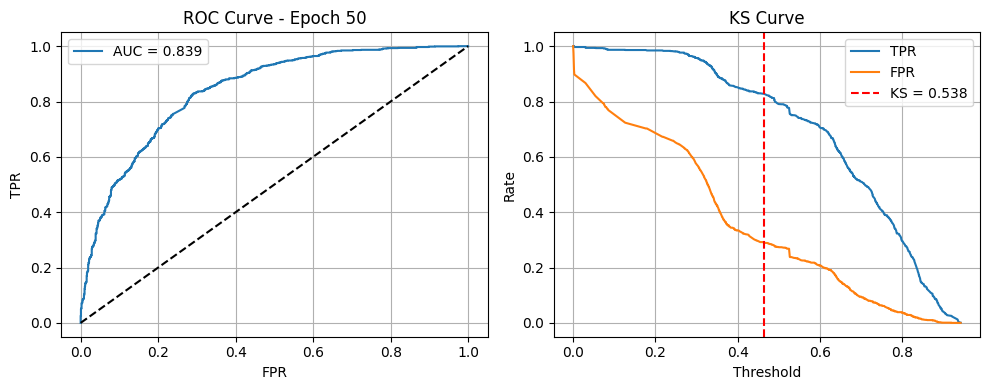

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - accuracy: 0.7607 - loss: 0.5161 - val_accuracy: 0.7587 - val_loss: 0.4978
Epoch 51/500
161/162 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - accuracy: 0.7606 - loss: 0.5097 Epoch 51 - ROC AUC: 0.8402 | KS: 0.5321
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - accuracy: 0.7606 - loss: 0.5097 - val_accuracy: 0.7614 - val_loss: 0.4961
Epoch 52/500
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7557 - loss: 0.5208Epoch 52 - ROC AUC: 0.8378 | KS: 0.5190
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.7558 - loss: 0.5208 - val_accuracy: 0.7576 - val_loss: 0.4993
Epoch 53/500
159/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7548 - loss: 0.5139Epoch 53 - ROC AUC: 0.8407 | KS: 0.5352
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step - accuracy: 0.7549 - loss: 0.5138 - val_accuracy: 0.7649 - val_loss: 0.4958
Epoch 54/500
159/162 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.7546 - loss: 0.5018Epoch 54 - ROC AUC: 0.8405 | KS: 0.5345
162/162 ━━━━━━━━━━━━

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


✅ Validação final — Loss: 0.4949, Accuracy: 0.7591


<Figure size 640x480 with 0 Axes>

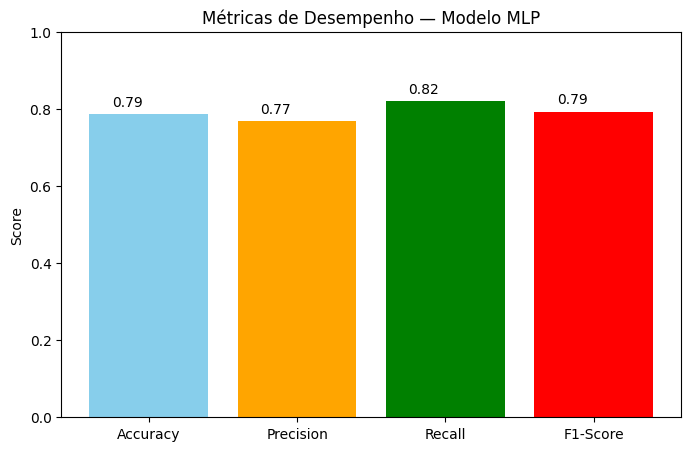

In [ ]:
# MLP com 3 camadas ocultas de 10 neurônios cada,
# ativação ReLU nas camadas ocultas,
# dropout de 30% após cada camada oculta para regularização,
# camada de saída com 1 neurônio e ativação sigmoide para saída binária,
# otimizador RMSprop,
# loss binary_crossentropy,
# métricas: acurácia,
# treinamento com até 500 épocas e early stopping com paciência de 20 para evitar overfitting.


model = Sequential([
    Dense(10, activation='relu', input_shape=(X_train_nn.shape[1],)),
    Dropout(0.3),
    Dense(10, activation='relu'),
    Dropout(0.3),
    Dense(10, activation='relu'),
    Dropout(0.3),
    Dense(1, activation='sigmoid')
])

model.compile(optimizer='RMSprop', loss='binary_crossentropy', metrics=['accuracy'])

early_stop = EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)

history = model.fit(
    X_train_nn, y_train_nn,
    validation_data=(X_val_nn, y_val_nn),
    epochs=500,
    callbacks=[early_stop, RocKsCallback(X_val_nn, y_val_nn)],
    verbose=1,
    batch_size=32
)

model.save('nn_3camada_0.3dropout_500epochs.h5')
files.download('nn_3camada_0.3dropout_500epochs.h5')

# Avaliação
loss, acc = model.evaluate(X_val_nn, y_val_nn, verbose=0)
print(f"\n✅ Validação final — Loss: {loss:.4f}, Accuracy: {acc:.4f}")

metrics_names = ['Accuracy', 'Precision', 'Recall', 'F1-Score']
metrics_values = [
    model.evaluate(X_test_nn, y_test_nn, verbose=0)[1],  # accuracy do modelo
    precision,
    recall,
    f1
]

plt.figure(figsize=(8, 5))
bars = plt.bar(metrics_names, metrics_values, color=['skyblue', 'orange', 'green', 'red'])
plt.ylim(0, 1)
plt.title('Métricas de Desempenho — Modelo MLP')
plt.ylabel('Score')
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + 0.15, yval + 0.02, f'{yval:.2f}')
plt.show()


### Experimentação 3

Epoch 1/500


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


195/202 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6098 - loss: 0.6587Epoch 1 - ROC AUC: 0.8156 | KS: 0.4975
202/202 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - accuracy: 0.6124 - loss: 0.6563 - val_accuracy: 0.7479 - val_loss: 0.5258
Epoch 2/500
187/202 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7349 - loss: 0.5410Epoch 2 - ROC AUC: 0.8259 | KS: 0.5139
202/202 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7358 - loss: 0.5399 - val_accuracy: 0.7563 - val_loss: 0.5106
Epoch 3/500
190/202 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7462 - loss: 0.5164Epoch 3 - ROC AUC: 0.8274 | KS: 0.5158
202/202 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - accuracy: 0.7466 - loss: 0.5164 - val_accuracy: 0.7572 - val_loss: 0.5090
Epoch 4/500
196/202 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7638 - loss: 0.4963Epoch 4 - ROC AUC: 0.8291 | KS: 0.5123
202/202 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7636 - loss: 0.4966 - val_accuracy: 0.7530 - val_loss: 0.5057
Epoch 5/500
181/202 ━━━━━━━━━━━━━━━━━━━━ 0s 

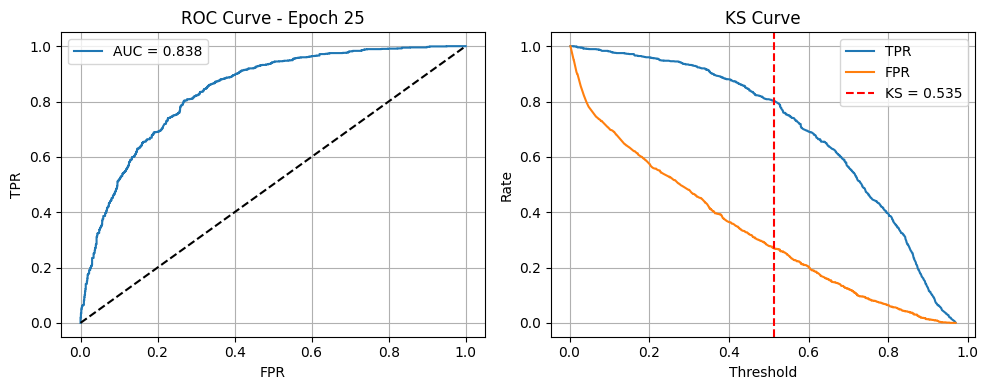

202/202 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.7790 - loss: 0.4836 - val_accuracy: 0.7669 - val_loss: 0.4949
Epoch 26/500
179/202 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7814 - loss: 0.4651Epoch 26 - ROC AUC: 0.8389 | KS: 0.5412
202/202 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - accuracy: 0.7809 - loss: 0.4666 - val_accuracy: 0.7674 - val_loss: 0.4929
Epoch 27/500
192/202 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7828 - loss: 0.4814Epoch 27 - ROC AUC: 0.8372 | KS: 0.5278
202/202 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7829 - loss: 0.4811 - val_accuracy: 0.7628 - val_loss: 0.4965
Epoch 28/500
182/202 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7840 - loss: 0.4839Epoch 28 - ROC AUC: 0.8379 | KS: 0.5274
202/202 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7839 - loss: 0.4829 - val_accuracy: 0.7558 - val_loss: 0.4948
Epoch 29/500
189/202 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7847 - loss: 0.4787Epoch 29 - ROC AUC: 0.8378 | KS: 0.5350
202/202 ━━━━━━━━━━━━━━━━

<Figure size 640x480 with 0 Axes>

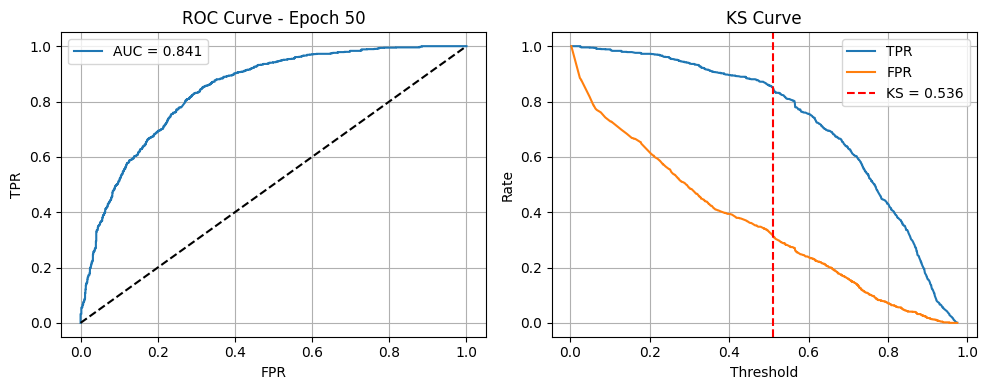

202/202 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.7806 - loss: 0.4599 - val_accuracy: 0.7683 - val_loss: 0.4895
Epoch 51/500
176/202 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7931 - loss: 0.4554Epoch 51 - ROC AUC: 0.8417 | KS: 0.5419
202/202 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7921 - loss: 0.4564 - val_accuracy: 0.7711 - val_loss: 0.4886
Epoch 52/500
186/202 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7807 - loss: 0.4730Epoch 52 - ROC AUC: 0.8410 | KS: 0.5339
202/202 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7811 - loss: 0.4725 - val_accuracy: 0.7669 - val_loss: 0.4901
Epoch 53/500
183/202 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7841 - loss: 0.4616Epoch 53 - ROC AUC: 0.8414 | KS: 0.5398
202/202 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7843 - loss: 0.4619 - val_accuracy: 0.7683 - val_loss: 0.4882
Epoch 54/500
187/202 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7818 - loss: 0.4690Epoch 54 - ROC AUC: 0.8426 | KS: 0.5434
202/202 ━━━━━━━━━━━━━━━━

<Figure size 640x480 with 0 Axes>

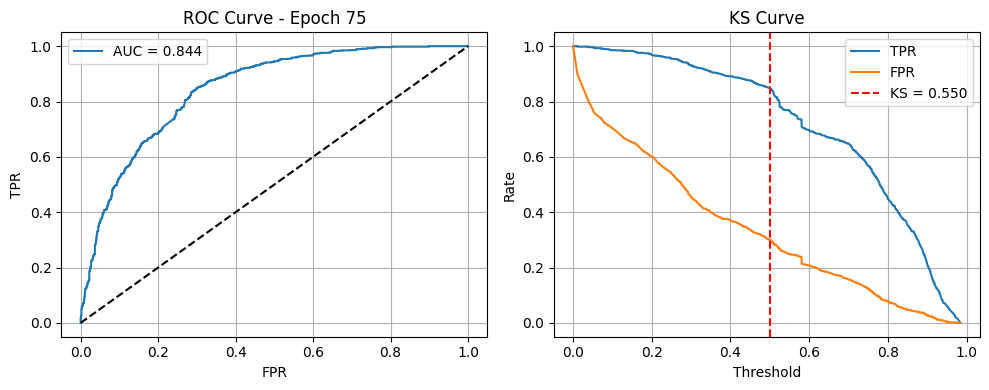

202/202 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.7796 - loss: 0.4631 - val_accuracy: 0.7772 - val_loss: 0.4841
Epoch 76/500
198/202 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7801 - loss: 0.4667Epoch 76 - ROC AUC: 0.8430 | KS: 0.5371
202/202 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7803 - loss: 0.4664 - val_accuracy: 0.7683 - val_loss: 0.4863
Epoch 77/500
181/202 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7929 - loss: 0.4564Epoch 77 - ROC AUC: 0.8432 | KS: 0.5453
202/202 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7928 - loss: 0.4565 - val_accuracy: 0.7730 - val_loss: 0.4852
Epoch 78/500
197/202 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7923 - loss: 0.4576Epoch 78 - ROC AUC: 0.8448 | KS: 0.5481
202/202 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7923 - loss: 0.4576 - val_accuracy: 0.7744 - val_loss: 0.4829
Epoch 79/500
197/202 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7877 - loss: 0.4549Epoch 79 - ROC AUC: 0.8450 | KS: 0.5420
202/202 ━━━━━━━━━━━━━━━━

<Figure size 640x480 with 0 Axes>

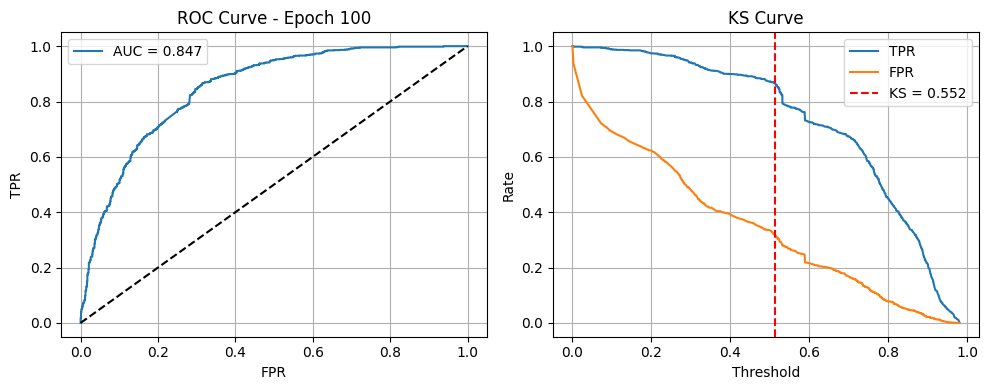

202/202 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.7978 - loss: 0.4491 - val_accuracy: 0.7730 - val_loss: 0.4814
Epoch 101/500
179/202 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7856 - loss: 0.4603Epoch 101 - ROC AUC: 0.8457 | KS: 0.5545
202/202 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7861 - loss: 0.4595 - val_accuracy: 0.7744 - val_loss: 0.4816
Epoch 102/500
199/202 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7888 - loss: 0.4506Epoch 102 - ROC AUC: 0.8440 | KS: 0.5521
202/202 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7888 - loss: 0.4506 - val_accuracy: 0.7781 - val_loss: 0.4833
Epoch 103/500
202/202 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7859 - loss: 0.4458Epoch 103 - ROC AUC: 0.8450 | KS: 0.5563
202/202 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7859 - loss: 0.4458 - val_accuracy: 0.7799 - val_loss: 0.4845
Epoch 104/500
196/202 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7889 - loss: 0.4543Epoch 104 - ROC AUC: 0.8452 | KS: 0.5529
202/202 ━━━━━━━━

<Figure size 640x480 with 0 Axes>

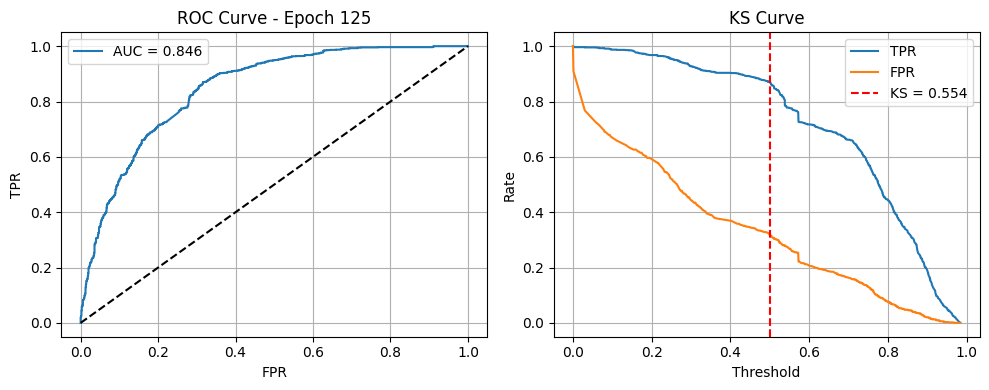

202/202 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.7979 - loss: 0.4417 - val_accuracy: 0.7809 - val_loss: 0.4802
Epoch 126/500
194/202 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7905 - loss: 0.4457Epoch 126 - ROC AUC: 0.8453 | KS: 0.5583
202/202 ━━━━━━━━━━━━━━━━━━━━ 38s 190ms/step - accuracy: 0.7905 - loss: 0.4457 - val_accuracy: 0.7813 - val_loss: 0.4813
Epoch 127/500
179/202 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7896 - loss: 0.4480Epoch 127 - ROC AUC: 0.8463 | KS: 0.5576
202/202 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - accuracy: 0.7891 - loss: 0.4484 - val_accuracy: 0.7823 - val_loss: 0.4794
Epoch 128/500
193/202 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7921 - loss: 0.4447Epoch 128 - ROC AUC: 0.8460 | KS: 0.5533
202/202 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7920 - loss: 0.4449 - val_accuracy: 0.7772 - val_loss: 0.4800
Epoch 129/500
201/202 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7899 - loss: 0.4484Epoch 129 - ROC AUC: 0.8470 | KS: 0.5588
202/202 ━━━━━

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


✅ Validação final — Loss: 0.4791, Accuracy: 0.7748


<Figure size 640x480 with 0 Axes>

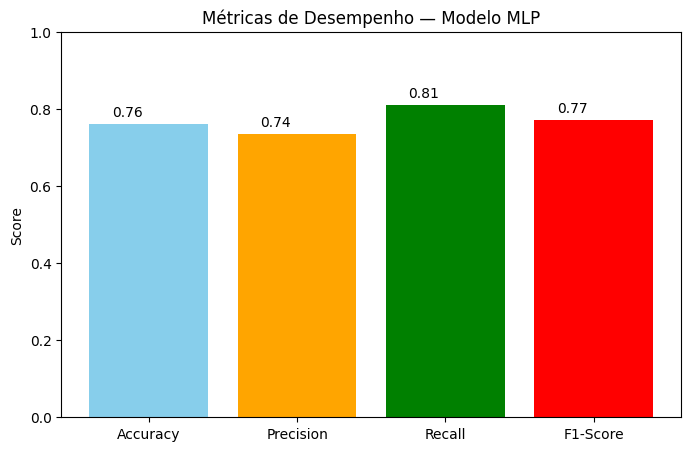

In [ ]:
# MLP com 2 camadas ocultas (20 neurônios cada)
# Ativação: ReLU
# Otimizador: Adam
# Dropout: 30% após cada camada oculta para regularização
# Sem regularização explícita (L1/L2)
# Épocas máximas: 500, com early stopping
# Patience do early stopping: 20 (para evitar overfitting)

model = Sequential([
    Dense(20, activation='relu', input_shape=(X_train_nn.shape[1],)),
    Dropout(0.3),
    Dense(20, activation='relu'),
    Dropout(0.3),
    Dense(1, activation='sigmoid')
])

model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

early_stop = EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)

history = model.fit(
    X_train_nn, y_train_nn,
    validation_data=(X_val_nn, y_val_nn),
    epochs=500,
    callbacks=[early_stop, RocKsCallback(X_val_nn, y_val_nn)],
    verbose=1,
    batch_size=32
)

model.save('nn_2camada_0.3dropout_500epochs.h5')
files.download('nn_2camada_0.3dropout_500epochs.h5')

# Avaliação
loss, acc = model.evaluate(X_val_nn, y_val_nn, verbose=0)
print(f"\n✅ Validação final — Loss: {loss:.4f}, Accuracy: {acc:.4f}")

metrics_names = ['Accuracy', 'Precision', 'Recall', 'F1-Score']
metrics_values = [
    model.evaluate(X_test_nn, y_test_nn, verbose=0)[1],  # accuracy do modelo
    precision,
    recall,
    f1
]

plt.figure(figsize=(8, 5))
bars = plt.bar(metrics_names, metrics_values, color=['skyblue', 'orange', 'green', 'red'])
plt.ylim(0, 1)
plt.title('Métricas de Desempenho — Modelo MLP')
plt.ylabel('Score')
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + 0.15, yval + 0.02, f'{yval:.2f}')
plt.show()


### Experimentação 4

Epoch 1/1000


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


161/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6552 - loss: 0.6179Epoch 1 - ROC AUC: 0.8282 | KS: 0.4981
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.6558 - loss: 0.6173 - val_accuracy: 0.7486 - val_loss: 0.5144
Epoch 2/1000
145/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7444 - loss: 0.5283Epoch 2 - ROC AUC: 0.8311 | KS: 0.5043
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7435 - loss: 0.5294 - val_accuracy: 0.7510 - val_loss: 0.5060
Epoch 3/1000
147/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7466 - loss: 0.5305Epoch 3 - ROC AUC: 0.8345 | KS: 0.5089
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7466 - loss: 0.5304 - val_accuracy: 0.7455 - val_loss: 0.5010
Epoch 4/1000
150/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7522 - loss: 0.5251Epoch 4 - ROC AUC: 0.8368 | KS: 0.5174
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.7518 - loss: 0.5249 - val_accuracy: 0.7475 - val_loss: 0.4990
Epoch 5/1000
162/162 ━━━━━━━━━━━━━━━━━━━━

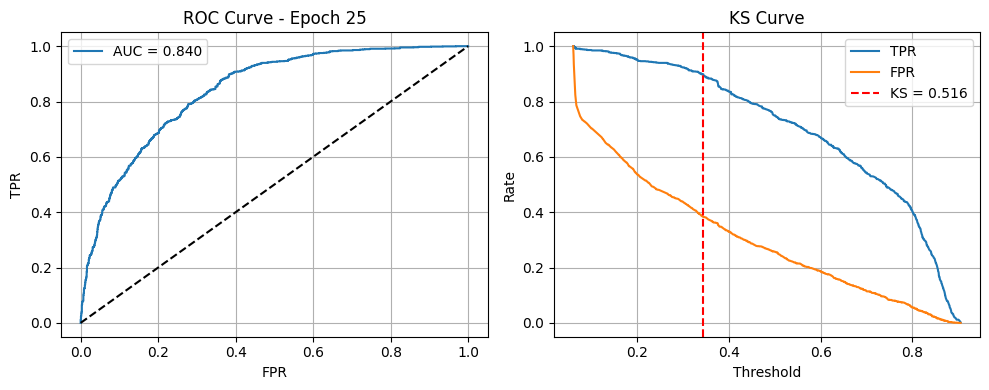

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7493 - loss: 0.5060 - val_accuracy: 0.7459 - val_loss: 0.4937
Epoch 26/1000
149/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7676 - loss: 0.4830Epoch 26 - ROC AUC: 0.8407 | KS: 0.5174
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.7663 - loss: 0.4849 - val_accuracy: 0.7529 - val_loss: 0.4924
Epoch 27/1000
150/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7387 - loss: 0.5124Epoch 27 - ROC AUC: 0.8406 | KS: 0.5174
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.7397 - loss: 0.5115 - val_accuracy: 0.7533 - val_loss: 0.4920
Epoch 28/1000
143/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7533 - loss: 0.4988Epoch 28 - ROC AUC: 0.8389 | KS: 0.5120
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7534 - loss: 0.4999 - val_accuracy: 0.7514 - val_loss: 0.4946
Epoch 29/1000
151/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7585 - loss: 0.4919Epoch 29 - ROC AUC: 0.8392 | KS: 0.5136
162/162 ━━━━━━━━━━━━

<Figure size 640x480 with 0 Axes>

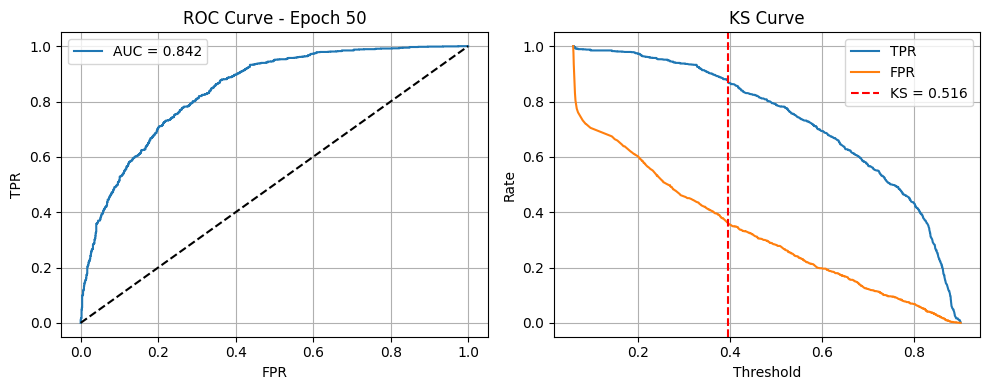

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.7640 - loss: 0.4865 - val_accuracy: 0.7529 - val_loss: 0.4905
Epoch 51/1000
155/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7669 - loss: 0.4927Epoch 51 - ROC AUC: 0.8415 | KS: 0.5205
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.7667 - loss: 0.4931 - val_accuracy: 0.7552 - val_loss: 0.4910
Epoch 52/1000
160/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7496 - loss: 0.4993Epoch 52 - ROC AUC: 0.8414 | KS: 0.5151
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.7497 - loss: 0.4994 - val_accuracy: 0.7525 - val_loss: 0.4912
Epoch 53/1000
161/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7685 - loss: 0.4917Epoch 53 - ROC AUC: 0.8424 | KS: 0.5244
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7684 - loss: 0.4918 - val_accuracy: 0.7560 - val_loss: 0.4893
Epoch 54/1000
146/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7700 - loss: 0.4844Epoch 54 - ROC AUC: 0.8421 | KS: 0.5198
162/162 ━━━━━━━━━━━

<Figure size 640x480 with 0 Axes>

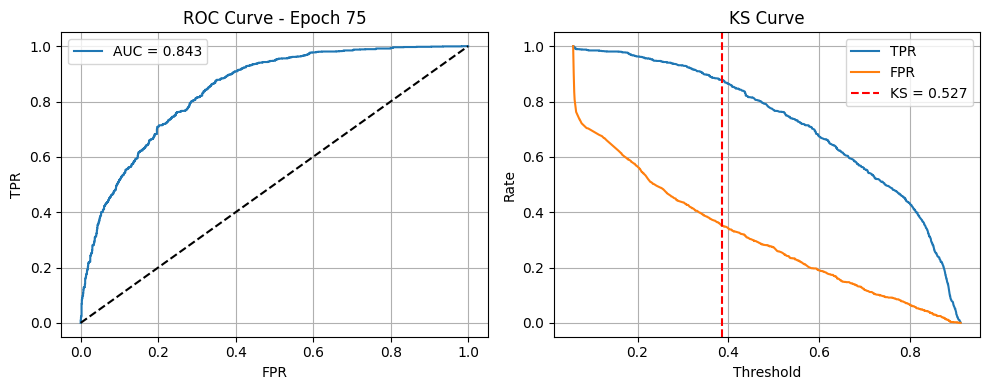

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - accuracy: 0.7624 - loss: 0.4931 - val_accuracy: 0.7483 - val_loss: 0.4881
Epoch 76/1000
151/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7504 - loss: 0.5110Epoch 76 - ROC AUC: 0.8441 | KS: 0.5298
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7511 - loss: 0.5101 - val_accuracy: 0.7610 - val_loss: 0.4875
Epoch 77/1000
153/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7559 - loss: 0.5003Epoch 77 - ROC AUC: 0.8428 | KS: 0.5290
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7563 - loss: 0.5001 - val_accuracy: 0.7514 - val_loss: 0.4889
Epoch 78/1000
150/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7782 - loss: 0.4832Epoch 78 - ROC AUC: 0.8434 | KS: 0.5283
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7770 - loss: 0.4842 - val_accuracy: 0.7552 - val_loss: 0.4891
Epoch 79/1000
155/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7511 - loss: 0.5032Epoch 79 - ROC AUC: 0.8443 | KS: 0.5298
162/162 ━━━━━━━━━━━

<Figure size 640x480 with 0 Axes>

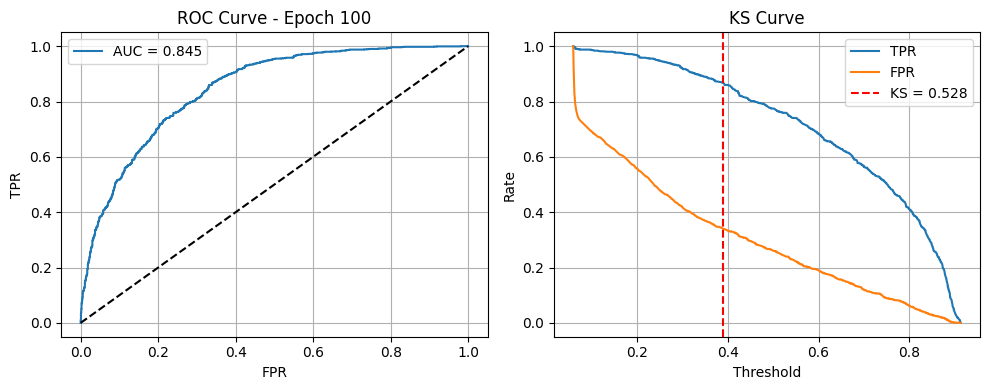

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.7505 - loss: 0.5025 - val_accuracy: 0.7572 - val_loss: 0.4856
Epoch 101/1000
161/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7633 - loss: 0.4961Epoch 101 - ROC AUC: 0.8436 | KS: 0.5221
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.7633 - loss: 0.4961 - val_accuracy: 0.7560 - val_loss: 0.4883
Epoch 102/1000
153/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7652 - loss: 0.4914Epoch 102 - ROC AUC: 0.8453 | KS: 0.5321
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7648 - loss: 0.4917 - val_accuracy: 0.7618 - val_loss: 0.4856
Epoch 103/1000
151/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7652 - loss: 0.4914Epoch 103 - ROC AUC: 0.8426 | KS: 0.5190
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.7649 - loss: 0.4914 - val_accuracy: 0.7533 - val_loss: 0.4899
Epoch 104/1000
144/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7552 - loss: 0.5021Epoch 104 - ROC AUC: 0.8461 | KS: 0.5321
162/162 ━━━

<Figure size 640x480 with 0 Axes>

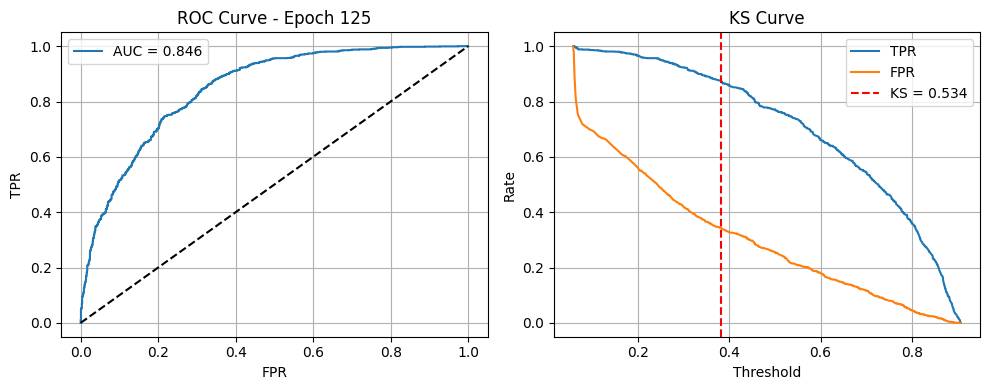

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.7612 - loss: 0.4938 - val_accuracy: 0.7583 - val_loss: 0.4846
Epoch 126/1000
146/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7532 - loss: 0.4921Epoch 126 - ROC AUC: 0.8463 | KS: 0.5352
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.7536 - loss: 0.4922 - val_accuracy: 0.7564 - val_loss: 0.4835
Epoch 127/1000
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7696 - loss: 0.4909Epoch 127 - ROC AUC: 0.8452 | KS: 0.5376
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7696 - loss: 0.4909 - val_accuracy: 0.7603 - val_loss: 0.4851
Epoch 128/1000
160/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7753 - loss: 0.4806Epoch 128 - ROC AUC: 0.8462 | KS: 0.5399
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.7752 - loss: 0.4808 - val_accuracy: 0.7603 - val_loss: 0.4836
Epoch 129/1000
161/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7724 - loss: 0.4773Epoch 129 - ROC AUC: 0.8459 | KS: 0.5399
162/162 ━━━

<Figure size 640x480 with 0 Axes>

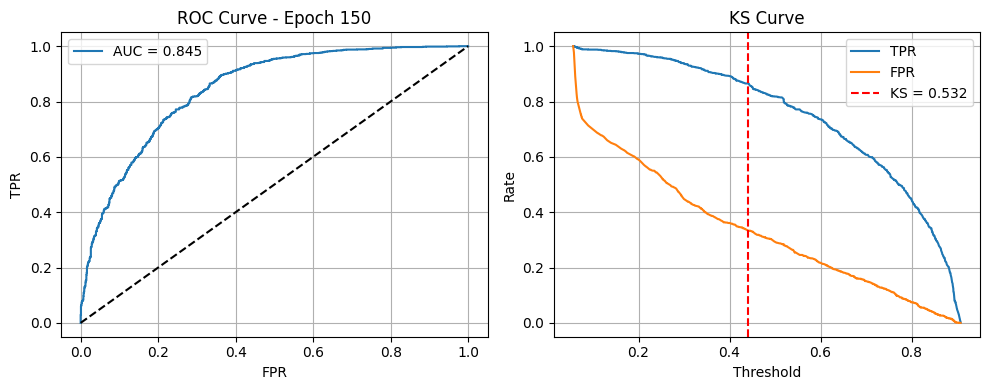

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step - accuracy: 0.7713 - loss: 0.4878 - val_accuracy: 0.7634 - val_loss: 0.4853
Epoch 151/1000
156/162 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7697 - loss: 0.4726Epoch 151 - ROC AUC: 0.8463 | KS: 0.5391
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.7695 - loss: 0.4730 - val_accuracy: 0.7583 - val_loss: 0.4832
Epoch 152/1000
156/162 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7574 - loss: 0.4904Epoch 152 - ROC AUC: 0.8474 | KS: 0.5399
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.7577 - loss: 0.4902 - val_accuracy: 0.7626 - val_loss: 0.4832
Epoch 153/1000
146/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7700 - loss: 0.4919Epoch 153 - ROC AUC: 0.8470 | KS: 0.5383
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7702 - loss: 0.4913 - val_accuracy: 0.7641 - val_loss: 0.4825
Epoch 154/1000
156/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7706 - loss: 0.4782Epoch 154 - ROC AUC: 0.8475 | KS: 0.5422
162/162 ━

<Figure size 640x480 with 0 Axes>

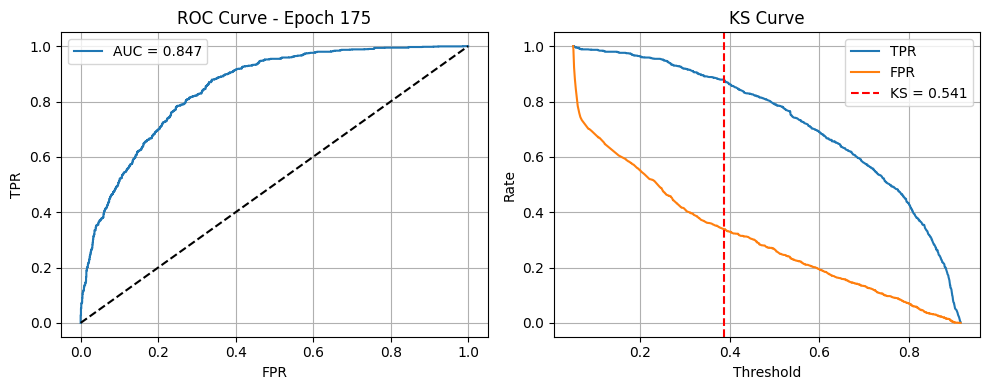

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.7717 - loss: 0.4752 - val_accuracy: 0.7626 - val_loss: 0.4822
Epoch 176/1000
145/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7698 - loss: 0.4750Epoch 176 - ROC AUC: 0.8481 | KS: 0.5430
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - accuracy: 0.7696 - loss: 0.4758 - val_accuracy: 0.7661 - val_loss: 0.4809
Epoch 177/1000
159/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7724 - loss: 0.4821Epoch 177 - ROC AUC: 0.8449 | KS: 0.5283
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7723 - loss: 0.4821 - val_accuracy: 0.7579 - val_loss: 0.4851
Epoch 178/1000
158/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7717 - loss: 0.4810Epoch 178 - ROC AUC: 0.8464 | KS: 0.5298
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7716 - loss: 0.4810 - val_accuracy: 0.7610 - val_loss: 0.4826
Epoch 179/1000
156/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7595 - loss: 0.4918Epoch 179 - ROC AUC: 0.8473 | KS: 0.5399
162/162 ━━━

<Figure size 640x480 with 0 Axes>

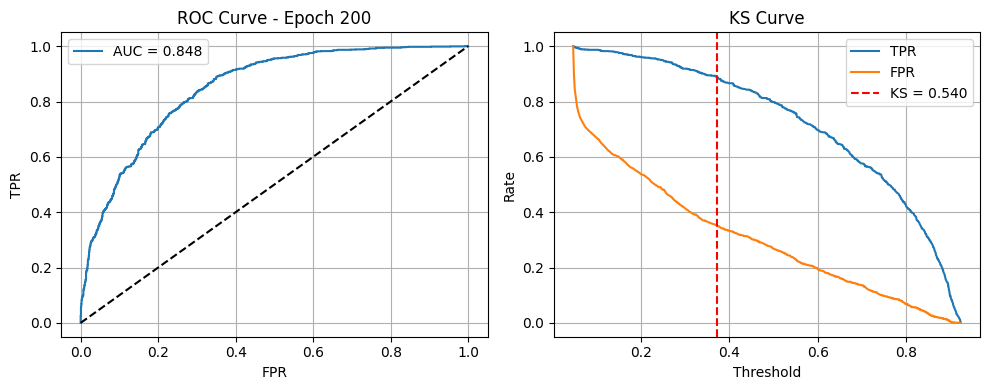

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - accuracy: 0.7692 - loss: 0.4856 - val_accuracy: 0.7649 - val_loss: 0.4795
Epoch 201/1000
147/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7739 - loss: 0.4752Epoch 201 - ROC AUC: 0.8487 | KS: 0.5368
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7745 - loss: 0.4755 - val_accuracy: 0.7668 - val_loss: 0.4791
Epoch 202/1000
150/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7678 - loss: 0.4817Epoch 202 - ROC AUC: 0.8477 | KS: 0.5414
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7681 - loss: 0.4817 - val_accuracy: 0.7661 - val_loss: 0.4804
Epoch 203/1000
143/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7710 - loss: 0.4788Epoch 203 - ROC AUC: 0.8471 | KS: 0.5376
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7712 - loss: 0.4790 - val_accuracy: 0.7657 - val_loss: 0.4827
Epoch 204/1000
150/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7756 - loss: 0.4711Epoch 204 - ROC AUC: 0.8472 | KS: 0.5352
162/162 ━━━

<Figure size 640x480 with 0 Axes>

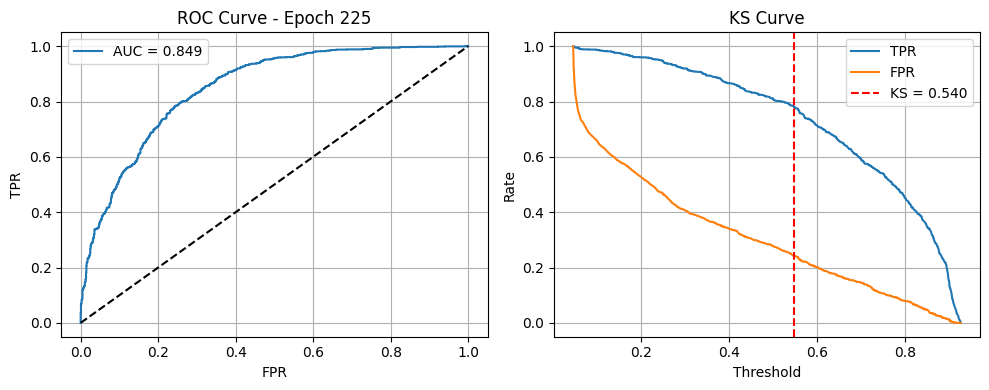

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.7655 - loss: 0.4897 - val_accuracy: 0.7657 - val_loss: 0.4796
Epoch 226/1000
152/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7712 - loss: 0.4809Epoch 226 - ROC AUC: 0.8496 | KS: 0.5399
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7712 - loss: 0.4810 - val_accuracy: 0.7665 - val_loss: 0.4786
Epoch 227/1000
153/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7614 - loss: 0.4899Epoch 227 - ROC AUC: 0.8496 | KS: 0.5399
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7617 - loss: 0.4895 - val_accuracy: 0.7696 - val_loss: 0.4783
Epoch 228/1000
152/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7665 - loss: 0.4878Epoch 228 - ROC AUC: 0.8487 | KS: 0.5376
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.7669 - loss: 0.4871 - val_accuracy: 0.7657 - val_loss: 0.4798
Epoch 229/1000
152/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7787 - loss: 0.4740Epoch 229 - ROC AUC: 0.8487 | KS: 0.5383
162/162 ━━━━

<Figure size 640x480 with 0 Axes>

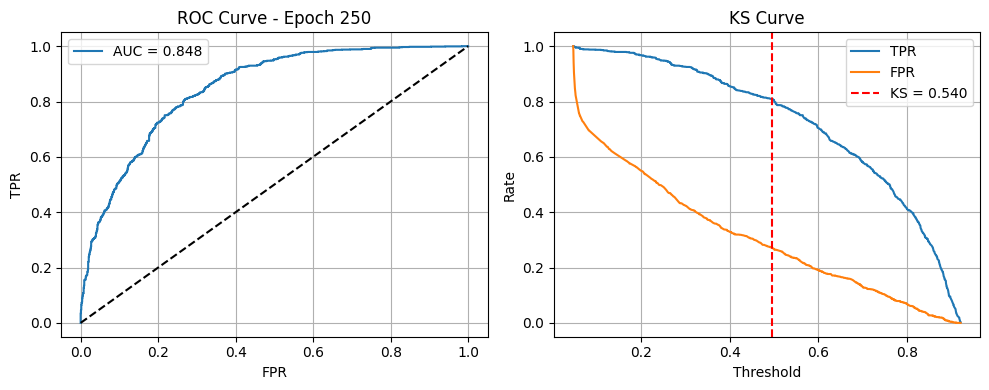

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - accuracy: 0.7807 - loss: 0.4633 - val_accuracy: 0.7684 - val_loss: 0.4801
Epoch 251/1000
153/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7679 - loss: 0.4803Epoch 251 - ROC AUC: 0.8492 | KS: 0.5476
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.7677 - loss: 0.4803 - val_accuracy: 0.7680 - val_loss: 0.4782
Epoch 252/1000
149/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7793 - loss: 0.4674Epoch 252 - ROC AUC: 0.8504 | KS: 0.5438
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7792 - loss: 0.4679 - val_accuracy: 0.7680 - val_loss: 0.4774
Epoch 253/1000
148/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7806 - loss: 0.4693Epoch 253 - ROC AUC: 0.8496 | KS: 0.5469
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7796 - loss: 0.4702 - val_accuracy: 0.7696 - val_loss: 0.4780
Epoch 254/1000
161/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7756 - loss: 0.4773Epoch 254 - ROC AUC: 0.8502 | KS: 0.5484
162/162 ━━━━

<Figure size 640x480 with 0 Axes>

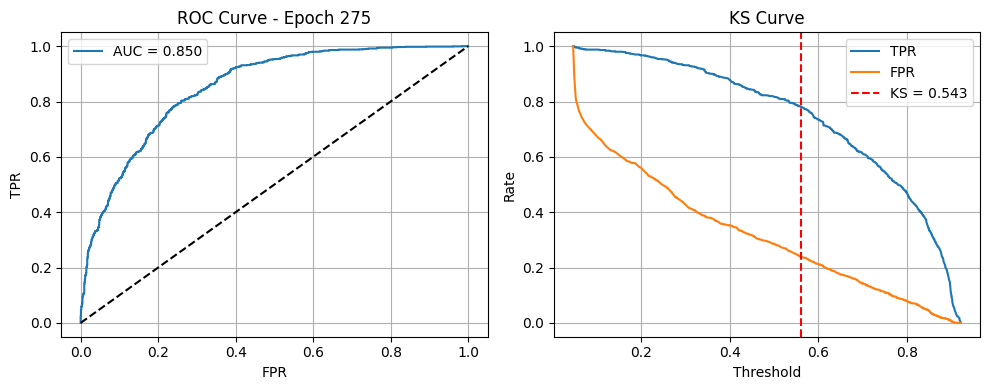

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - accuracy: 0.7839 - loss: 0.4639 - val_accuracy: 0.7661 - val_loss: 0.4776
Epoch 276/1000
145/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7685 - loss: 0.4810Epoch 276 - ROC AUC: 0.8505 | KS: 0.5461
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7693 - loss: 0.4803 - val_accuracy: 0.7672 - val_loss: 0.4771
Epoch 277/1000
150/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7820 - loss: 0.4751Epoch 277 - ROC AUC: 0.8512 | KS: 0.5492
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7815 - loss: 0.4751 - val_accuracy: 0.7668 - val_loss: 0.4759
Epoch 278/1000
153/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7879 - loss: 0.4578Epoch 278 - ROC AUC: 0.8501 | KS: 0.5445
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7871 - loss: 0.4587 - val_accuracy: 0.7688 - val_loss: 0.4774
Epoch 279/1000
151/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7778 - loss: 0.4722Epoch 279 - ROC AUC: 0.8504 | KS: 0.5461
162/162 ━━━

<Figure size 640x480 with 0 Axes>

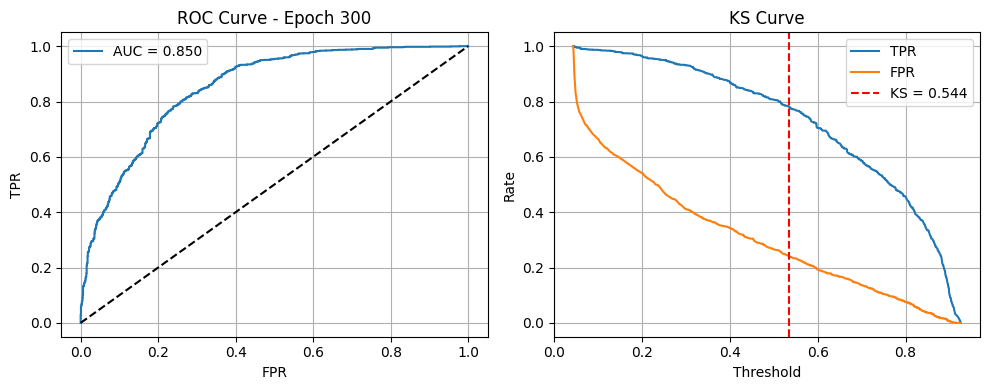

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.7848 - loss: 0.4634 - val_accuracy: 0.7703 - val_loss: 0.4764
Epoch 301/1000
147/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7776 - loss: 0.4728Epoch 301 - ROC AUC: 0.8511 | KS: 0.5515
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7773 - loss: 0.4730 - val_accuracy: 0.7727 - val_loss: 0.4757
Epoch 302/1000
152/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7681 - loss: 0.4833Epoch 302 - ROC AUC: 0.8518 | KS: 0.5577
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7686 - loss: 0.4825 - val_accuracy: 0.7742 - val_loss: 0.4746
Epoch 303/1000
160/162 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.7780 - loss: 0.4711Epoch 303 - ROC AUC: 0.8502 | KS: 0.5438
162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - accuracy: 0.7780 - loss: 0.4710 - val_accuracy: 0.7699 - val_loss: 0.4765
Epoch 304/1000
155/162 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7755 - loss: 0.4783Epoch 304 - ROC AUC: 0.8515 | KS: 0.5515
162/162 ━━━

<Figure size 640x480 with 0 Axes>

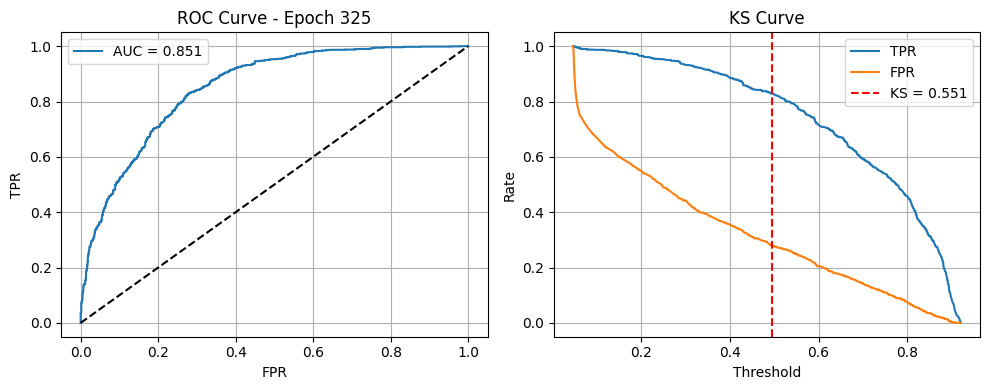

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.7687 - loss: 0.4800 - val_accuracy: 0.7738 - val_loss: 0.4760
Epoch 326/1000
159/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7806 - loss: 0.4782Epoch 326 - ROC AUC: 0.8517 | KS: 0.5476
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.7806 - loss: 0.4781 - val_accuracy: 0.7707 - val_loss: 0.4758
Epoch 327/1000
149/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7691 - loss: 0.4831Epoch 327 - ROC AUC: 0.8517 | KS: 0.5492
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.7703 - loss: 0.4819 - val_accuracy: 0.7715 - val_loss: 0.4745
Epoch 328/1000
145/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7789 - loss: 0.4674Epoch 328 - ROC AUC: 0.8529 | KS: 0.5461
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7792 - loss: 0.4672 - val_accuracy: 0.7715 - val_loss: 0.4732
Epoch 329/1000
159/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7771 - loss: 0.4779Epoch 329 - ROC AUC: 0.8514 | KS: 0.5515
162/162 ━━━━

<Figure size 640x480 with 0 Axes>

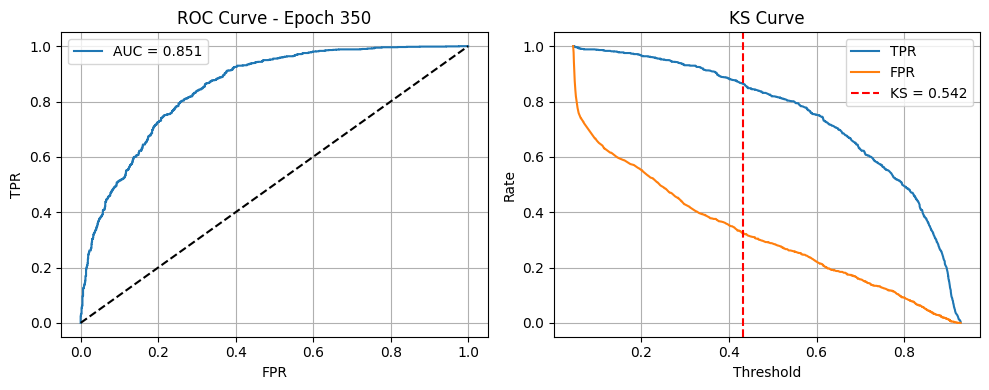

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.7765 - loss: 0.4740 - val_accuracy: 0.7665 - val_loss: 0.4770
Epoch 351/1000
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7774 - loss: 0.4709Epoch 351 - ROC AUC: 0.8532 | KS: 0.5507
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.7774 - loss: 0.4709 - val_accuracy: 0.7715 - val_loss: 0.4730
Epoch 352/1000
157/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7864 - loss: 0.4598Epoch 352 - ROC AUC: 0.8514 | KS: 0.5453
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.7859 - loss: 0.4602 - val_accuracy: 0.7715 - val_loss: 0.4762
Epoch 353/1000
156/162 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.7770 - loss: 0.4665Epoch 353 - ROC AUC: 0.8533 | KS: 0.5469
162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step - accuracy: 0.7771 - loss: 0.4666 - val_accuracy: 0.7711 - val_loss: 0.4729
Epoch 354/1000
161/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7674 - loss: 0.4828Epoch 354 - ROC AUC: 0.8517 | KS: 0.5453
162/162 ━━━

<Figure size 640x480 with 0 Axes>

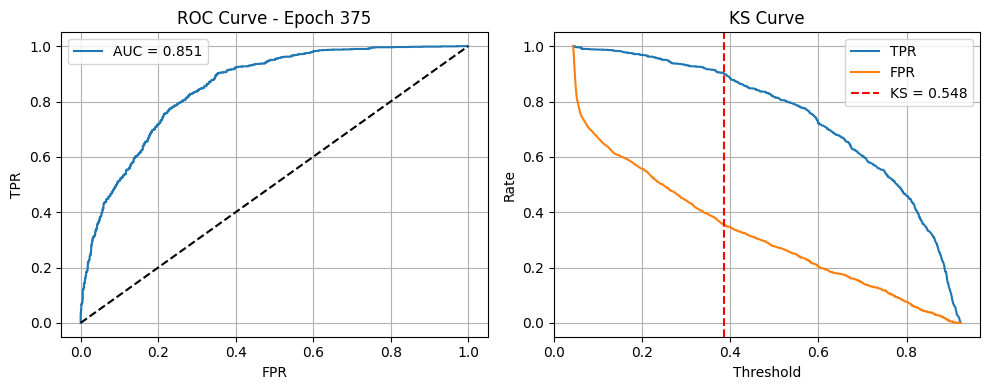

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.7732 - loss: 0.4689 - val_accuracy: 0.7703 - val_loss: 0.4754
Epoch 376/1000
155/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7751 - loss: 0.4726Epoch 376 - ROC AUC: 0.8529 | KS: 0.5577
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.7751 - loss: 0.4726 - val_accuracy: 0.7723 - val_loss: 0.4745
Epoch 377/1000
154/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7723 - loss: 0.4749Epoch 377 - ROC AUC: 0.8534 | KS: 0.5531
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7727 - loss: 0.4746 - val_accuracy: 0.7707 - val_loss: 0.4727
Epoch 378/1000
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7903 - loss: 0.4550Epoch 378 - ROC AUC: 0.8539 | KS: 0.5515
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7902 - loss: 0.4551 - val_accuracy: 0.7742 - val_loss: 0.4720
Epoch 379/1000
153/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7847 - loss: 0.4560Epoch 379 - ROC AUC: 0.8526 | KS: 0.5515
162/162 ━━━

<Figure size 640x480 with 0 Axes>

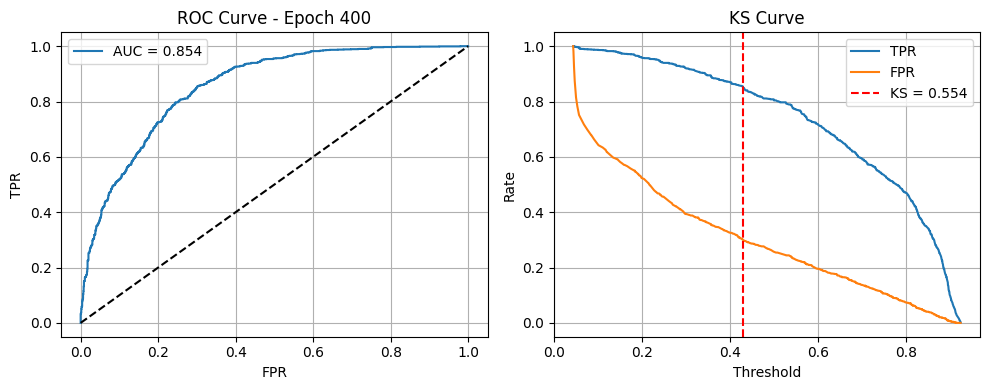

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - accuracy: 0.7870 - loss: 0.4533 - val_accuracy: 0.7738 - val_loss: 0.4727
Epoch 401/1000
151/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7827 - loss: 0.4744Epoch 401 - ROC AUC: 0.8526 | KS: 0.5500
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7825 - loss: 0.4742 - val_accuracy: 0.7723 - val_loss: 0.4734
Epoch 402/1000
146/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7848 - loss: 0.4578Epoch 402 - ROC AUC: 0.8531 | KS: 0.5515
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7840 - loss: 0.4589 - val_accuracy: 0.7738 - val_loss: 0.4728
Epoch 403/1000
159/162 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7837 - loss: 0.4667Epoch 403 - ROC AUC: 0.8518 | KS: 0.5492
162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - accuracy: 0.7835 - loss: 0.4668 - val_accuracy: 0.7707 - val_loss: 0.4748
Epoch 404/1000
161/162 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7780 - loss: 0.4707Epoch 404 - ROC AUC: 0.8527 | KS: 0.5476
162/162 ━━━

<Figure size 640x480 with 0 Axes>

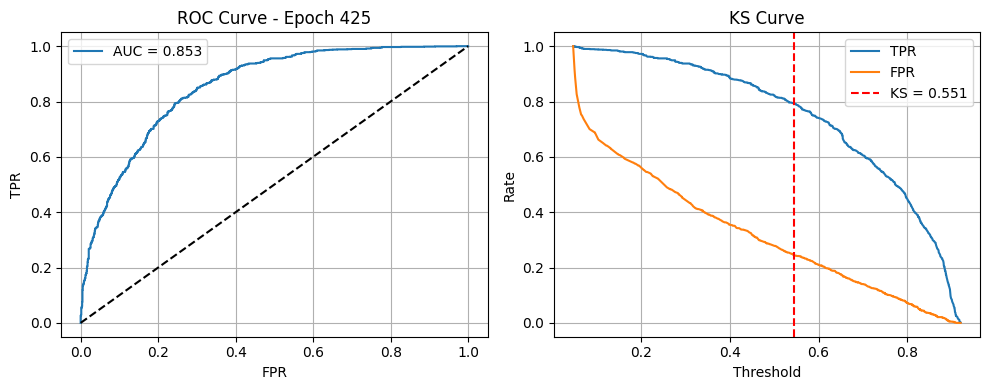

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.7824 - loss: 0.4582 - val_accuracy: 0.7719 - val_loss: 0.4729
Epoch 426/1000
153/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7849 - loss: 0.4522Epoch 426 - ROC AUC: 0.8528 | KS: 0.5554
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.7845 - loss: 0.4527 - val_accuracy: 0.7699 - val_loss: 0.4731
Epoch 427/1000
157/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7816 - loss: 0.4582Epoch 427 - ROC AUC: 0.8527 | KS: 0.5554
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7816 - loss: 0.4583 - val_accuracy: 0.7699 - val_loss: 0.4739
Epoch 428/1000
149/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7834 - loss: 0.4708Epoch 428 - ROC AUC: 0.8522 | KS: 0.5554
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.7835 - loss: 0.4705 - val_accuracy: 0.7719 - val_loss: 0.4743
Epoch 429/1000
159/162 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7737 - loss: 0.4734Epoch 429 - ROC AUC: 0.8522 | KS: 0.5546
162/162 ━━━

<Figure size 640x480 with 0 Axes>

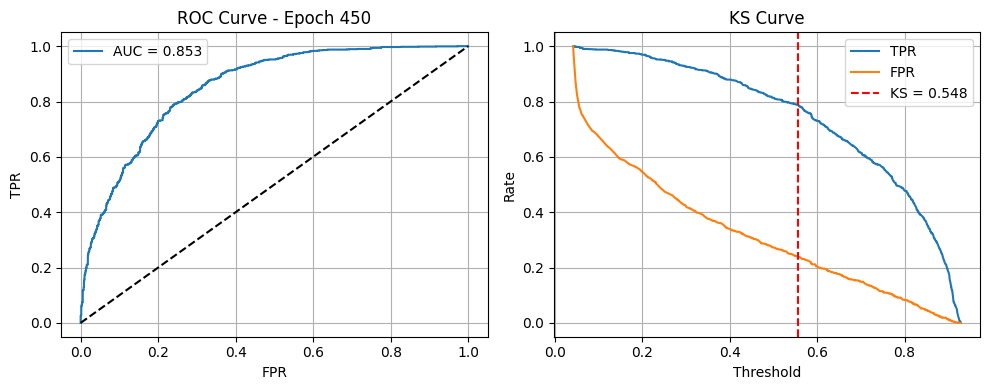

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.7779 - loss: 0.4680 - val_accuracy: 0.7703 - val_loss: 0.4734
Epoch 451/1000
160/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7835 - loss: 0.4656Epoch 451 - ROC AUC: 0.8538 | KS: 0.5546
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7835 - loss: 0.4656 - val_accuracy: 0.7754 - val_loss: 0.4725
Epoch 452/1000
158/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7858 - loss: 0.4598Epoch 452 - ROC AUC: 0.8530 | KS: 0.5554
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7856 - loss: 0.4600 - val_accuracy: 0.7750 - val_loss: 0.4738
Epoch 453/1000
158/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7839 - loss: 0.4674Epoch 453 - ROC AUC: 0.8539 | KS: 0.5531
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7839 - loss: 0.4673 - val_accuracy: 0.7715 - val_loss: 0.4721
Epoch 454/1000
146/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7761 - loss: 0.4683Epoch 454 - ROC AUC: 0.8528 | KS: 0.5569
162/162 ━━━

<Figure size 640x480 with 0 Axes>

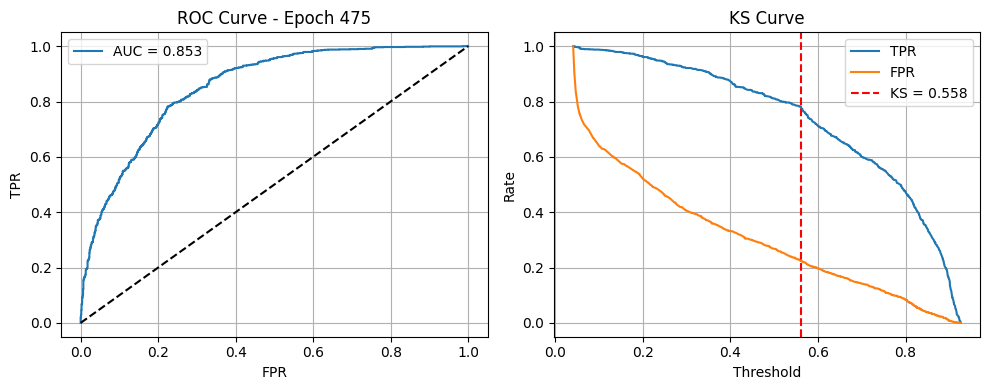

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.7879 - loss: 0.4581 - val_accuracy: 0.7719 - val_loss: 0.4726
Epoch 476/1000
161/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7858 - loss: 0.4487Epoch 476 - ROC AUC: 0.8516 | KS: 0.5492
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7857 - loss: 0.4488 - val_accuracy: 0.7711 - val_loss: 0.4757
Epoch 477/1000
149/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7798 - loss: 0.4709Epoch 477 - ROC AUC: 0.8531 | KS: 0.5531
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.7798 - loss: 0.4705 - val_accuracy: 0.7727 - val_loss: 0.4732
Epoch 478/1000
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7755 - loss: 0.4728Epoch 478 - ROC AUC: 0.8524 | KS: 0.5538
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7756 - loss: 0.4727 - val_accuracy: 0.7711 - val_loss: 0.4741
Epoch 479/1000
160/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7874 - loss: 0.4626Epoch 479 - ROC AUC: 0.8531 | KS: 0.5531
162/162 ━━━

<Figure size 640x480 with 0 Axes>

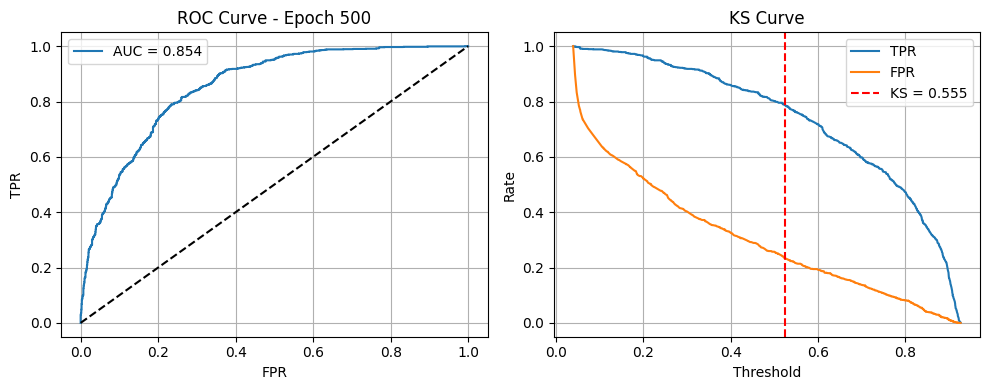

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - accuracy: 0.7942 - loss: 0.4457 - val_accuracy: 0.7727 - val_loss: 0.4722
Epoch 501/1000
159/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7812 - loss: 0.4594Epoch 501 - ROC AUC: 0.8527 | KS: 0.5538
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7812 - loss: 0.4595 - val_accuracy: 0.7734 - val_loss: 0.4746
Epoch 502/1000
161/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7845 - loss: 0.4612Epoch 502 - ROC AUC: 0.8535 | KS: 0.5531
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7845 - loss: 0.4612 - val_accuracy: 0.7746 - val_loss: 0.4724
Epoch 503/1000
161/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7879 - loss: 0.4615Epoch 503 - ROC AUC: 0.8530 | KS: 0.5562
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7878 - loss: 0.4615 - val_accuracy: 0.7758 - val_loss: 0.4733
Epoch 504/1000
160/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7850 - loss: 0.4692Epoch 504 - ROC AUC: 0.8528 | KS: 0.5546
162/162 ━━━

<Figure size 640x480 with 0 Axes>

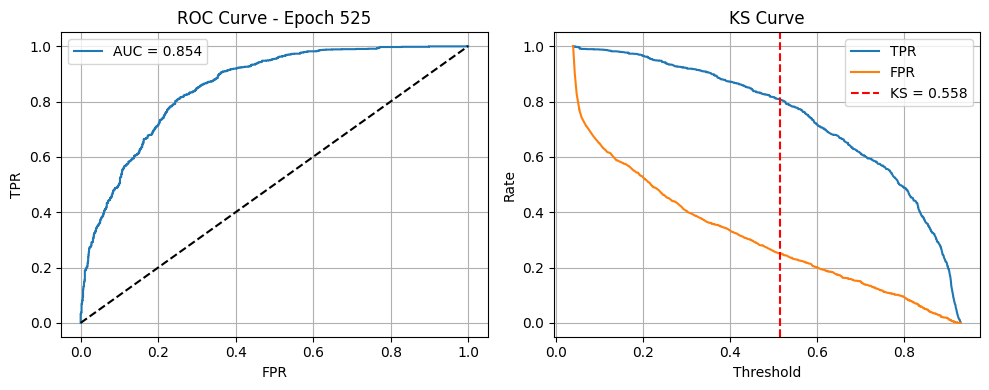

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.7840 - loss: 0.4608 - val_accuracy: 0.7781 - val_loss: 0.4726
Epoch 526/1000
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7826 - loss: 0.4622Epoch 526 - ROC AUC: 0.8531 | KS: 0.5562
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.7827 - loss: 0.4622 - val_accuracy: 0.7750 - val_loss: 0.4746
Epoch 527/1000
159/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7906 - loss: 0.4628Epoch 527 - ROC AUC: 0.8527 | KS: 0.5631
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.7906 - loss: 0.4628 - val_accuracy: 0.7796 - val_loss: 0.4739
Epoch 528/1000
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7870 - loss: 0.4560Epoch 528 - ROC AUC: 0.8539 | KS: 0.5569
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.7870 - loss: 0.4560 - val_accuracy: 0.7769 - val_loss: 0.4729
Epoch 529/1000
151/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7878 - loss: 0.4574Epoch 529 - ROC AUC: 0.8528 | KS: 0.5562
162/162 ━

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


✅ Validação final — Loss: 0.4705, Accuracy: 0.7715


<Figure size 640x480 with 0 Axes>

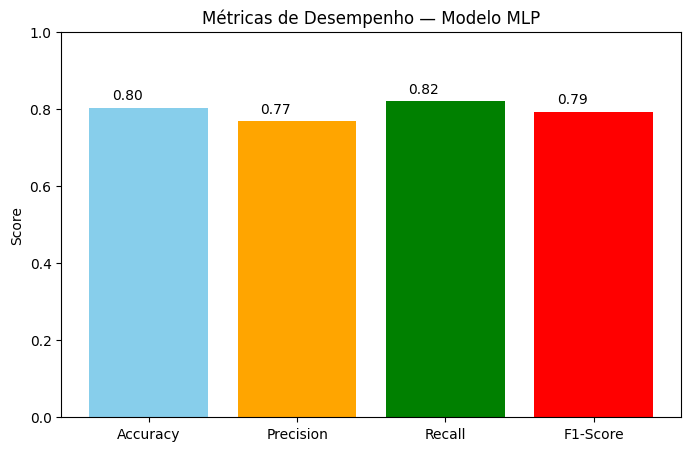

In [ ]:
# MLP com 2 camadas ocultas:
# - primeira camada com 40 neurônios, ativação tanh
# - segunda camada com 10 neurônios, ativação tanh
# Dropout de 30% após cada camada oculta para regularização
# Camada de saída com 1 neurônio, ativação sigmoide para saída binária
# Otimizador RMSprop
# Loss binary_crossentropy
# Métrica acurácia
# Até 1000 épocas com early stopping, paciência de 100 para evitar overfitting precoce

model = Sequential([
    Dense(40, activation='tanh', input_shape=(X_train_nn.shape[1],)),
    Dropout(0.3),  # 30% dos neurônios desativados nessa camada
    Dense(10, activation='tanh'),
    Dropout(0.3),  # Outro dropout antes da saída

    Dense(1, activation='sigmoid')  # Saída binária
])

model.compile(optimizer='RMSprop', loss='binary_crossentropy', metrics=['accuracy'])

early_stop = EarlyStopping(monitor='val_loss', patience=100, restore_best_weights=True)

history = model.fit(
    X_train_nn, y_train_nn,
    validation_data=(X_val_nn, y_val_nn),
    epochs=1000,
    callbacks=[early_stop, RocKsCallback(X_val_nn, y_val_nn)],
    verbose=1,
    batch_size=32
)


model.save('nn_2camada_0.3dropout_1000epochs.h5')
files.download('nn_2camada_0.3dropout_1000epochs.h5')

# Avaliação
loss, acc = model.evaluate(X_val_nn, y_val_nn, verbose=0)
print(f"\n✅ Validação final — Loss: {loss:.4f}, Accuracy: {acc:.4f}")

metrics_names = ['Accuracy', 'Precision', 'Recall', 'F1-Score']
metrics_values = [
    model.evaluate(X_test_nn, y_test_nn, verbose=0)[1],  # accuracy from model
    precision,
    recall,
    f1
]

plt.figure(figsize=(8, 5))
bars = plt.bar(metrics_names, metrics_values, color=['skyblue', 'orange', 'green', 'red'])
plt.ylim(0, 1)
plt.title('Métricas de Desempenho — Modelo MLP')
plt.ylabel('Score')
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + 0.15, yval + 0.02, f'{yval:.2f}')
plt.show()

In [ ]:
model.save('nn_2camada_0.3dropout_1000epochs.h5')
files.download('nn_2camada_0.3dropout_1000epochs.h5')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Experimentação 5

Epoch 1/1000


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.4640 - loss: 0.9455Epoch 1 - ROC AUC: 0.4440 | KS: 0.1239
162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.4640 - loss: 0.9454 - val_accuracy: 0.4597 - val_loss: 0.9012
Epoch 2/1000
153/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.4874 - loss: 0.9118Epoch 2 - ROC AUC: 0.4461 | KS: 0.1239
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.4871 - loss: 0.9121 - val_accuracy: 0.4617 - val_loss: 0.8985
Epoch 3/1000
142/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.4777 - loss: 0.9317Epoch 3 - ROC AUC: 0.4484 | KS: 0.1232
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.4775 - loss: 0.9313 - val_accuracy: 0.4632 - val_loss: 0.8958
Epoch 4/1000
143/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.4812 - loss: 0.9071Epoch 4 - ROC AUC: 0.4506 | KS: 0.1224
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.4818 - loss: 0.9063 - val_accuracy: 0.4659 - val_loss: 0.8932
Epoch 5/1000
154/162 ━━━━━━━━━━━━━━━━━━━━

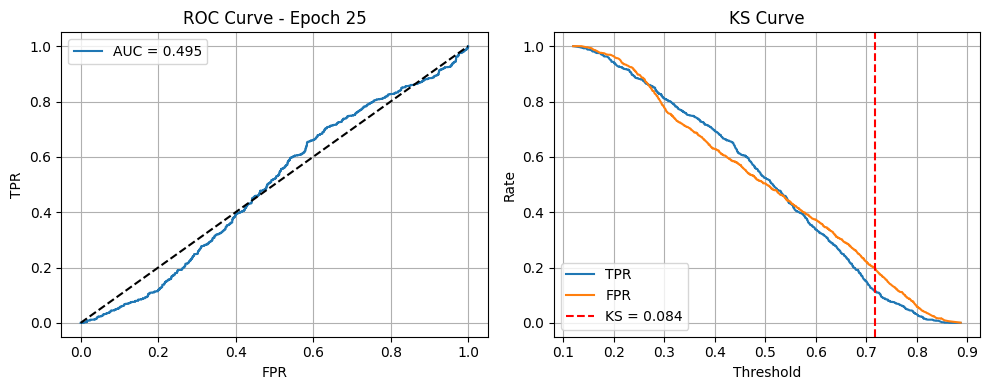

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - accuracy: 0.4960 - loss: 0.8792 - val_accuracy: 0.5105 - val_loss: 0.8433
Epoch 26/1000
150/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.5143 - loss: 0.8584Epoch 26 - ROC AUC: 0.4969 | KS: 0.0813
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.5141 - loss: 0.8589 - val_accuracy: 0.5112 - val_loss: 0.8411
Epoch 27/1000
148/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.5081 - loss: 0.8759Epoch 27 - ROC AUC: 0.4990 | KS: 0.0782
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.5086 - loss: 0.8751 - val_accuracy: 0.5128 - val_loss: 0.8390
Epoch 28/1000
145/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.5177 - loss: 0.8646Epoch 28 - ROC AUC: 0.5011 | KS: 0.0798
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.5164 - loss: 0.8653 - val_accuracy: 0.5155 - val_loss: 0.8369
Epoch 29/1000
145/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.5174 - loss: 0.8715Epoch 29 - ROC AUC: 0.5034 | KS: 0.0821
162/162 ━━━━━━━━━━━

<Figure size 640x480 with 0 Axes>

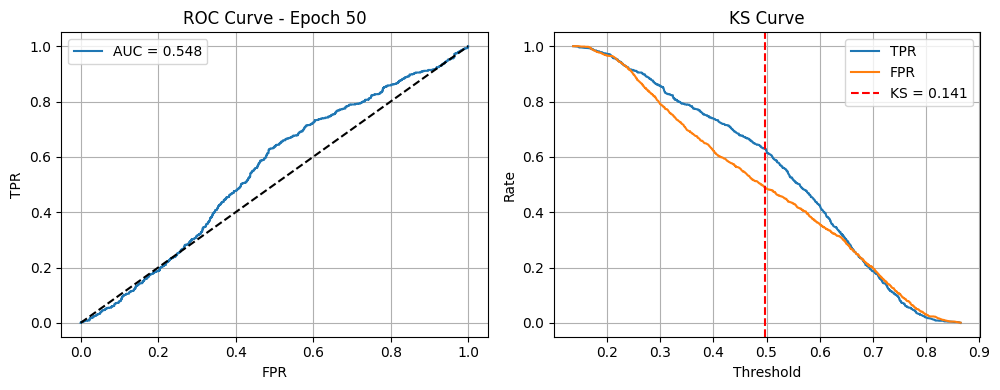

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.5402 - loss: 0.8190 - val_accuracy: 0.5670 - val_loss: 0.7945
Epoch 51/1000
150/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5499 - loss: 0.8209Epoch 51 - ROC AUC: 0.5500 | KS: 0.1441
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.5500 - loss: 0.8206 - val_accuracy: 0.5716 - val_loss: 0.7928
Epoch 52/1000
145/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5334 - loss: 0.8309Epoch 52 - ROC AUC: 0.5520 | KS: 0.1456
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.5343 - loss: 0.8304 - val_accuracy: 0.5716 - val_loss: 0.7910
Epoch 53/1000
157/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.5403 - loss: 0.8216Epoch 53 - ROC AUC: 0.5541 | KS: 0.1487
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.5404 - loss: 0.8215 - val_accuracy: 0.5713 - val_loss: 0.7892
Epoch 54/1000
143/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5439 - loss: 0.8155Epoch 54 - ROC AUC: 0.5561 | KS: 0.1495
162/162 ━━━━━━━━━━━

<Figure size 640x480 with 0 Axes>

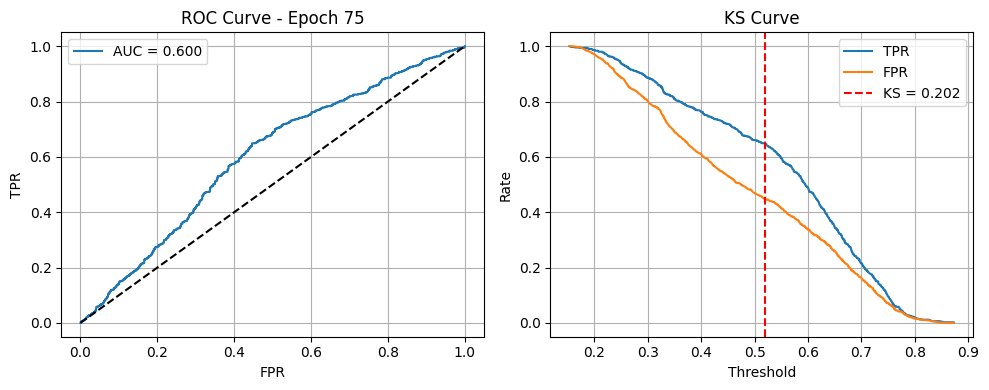

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - accuracy: 0.5667 - loss: 0.7882 - val_accuracy: 0.5964 - val_loss: 0.7542
Epoch 76/1000
155/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5716 - loss: 0.7918Epoch 76 - ROC AUC: 0.6026 | KS: 0.2029
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.5711 - loss: 0.7923 - val_accuracy: 0.5964 - val_loss: 0.7527
Epoch 77/1000
153/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5638 - loss: 0.8008Epoch 77 - ROC AUC: 0.6048 | KS: 0.2029
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.5644 - loss: 0.8003 - val_accuracy: 0.5972 - val_loss: 0.7513
Epoch 78/1000
159/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5677 - loss: 0.7916Epoch 78 - ROC AUC: 0.6068 | KS: 0.2037
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.5677 - loss: 0.7916 - val_accuracy: 0.5972 - val_loss: 0.7499
Epoch 79/1000
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5770 - loss: 0.7804Epoch 79 - ROC AUC: 0.6089 | KS: 0.2076
162/162 ━━━━━━━━━━━

<Figure size 640x480 with 0 Axes>

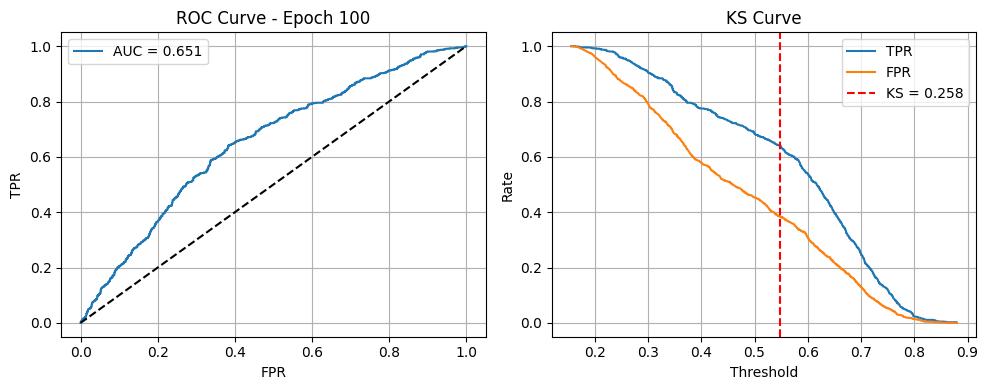

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.5695 - loss: 0.7775 - val_accuracy: 0.6150 - val_loss: 0.7205
Epoch 101/1000
144/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5958 - loss: 0.7563Epoch 101 - ROC AUC: 0.6528 | KS: 0.2587
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.5954 - loss: 0.7566 - val_accuracy: 0.6166 - val_loss: 0.7193
Epoch 102/1000
150/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.5892 - loss: 0.7605Epoch 102 - ROC AUC: 0.6546 | KS: 0.2626
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.5889 - loss: 0.7606 - val_accuracy: 0.6185 - val_loss: 0.7181
Epoch 103/1000
156/162 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.5802 - loss: 0.7657Epoch 103 - ROC AUC: 0.6564 | KS: 0.2641
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.5807 - loss: 0.7652 - val_accuracy: 0.6185 - val_loss: 0.7169
Epoch 104/1000
160/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5941 - loss: 0.7563Epoch 104 - ROC AUC: 0.6583 | KS: 0.2649
162/162 ━━━━

<Figure size 640x480 with 0 Axes>

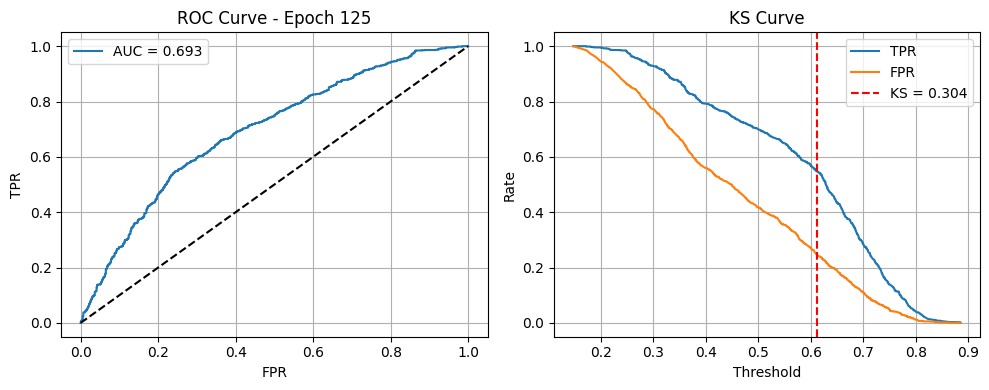

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.6152 - loss: 0.7277 - val_accuracy: 0.6414 - val_loss: 0.6925
Epoch 126/1000
159/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5995 - loss: 0.7412Epoch 126 - ROC AUC: 0.6947 | KS: 0.3052
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.5996 - loss: 0.7412 - val_accuracy: 0.6410 - val_loss: 0.6915
Epoch 127/1000
153/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6078 - loss: 0.7339Epoch 127 - ROC AUC: 0.6961 | KS: 0.3075
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.6078 - loss: 0.7340 - val_accuracy: 0.6406 - val_loss: 0.6905
Epoch 128/1000
147/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6098 - loss: 0.7381Epoch 128 - ROC AUC: 0.6976 | KS: 0.3098
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.6098 - loss: 0.7380 - val_accuracy: 0.6421 - val_loss: 0.6895
Epoch 129/1000
146/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6189 - loss: 0.7307Epoch 129 - ROC AUC: 0.6990 | KS: 0.3122
162/162 ━━━

<Figure size 640x480 with 0 Axes>

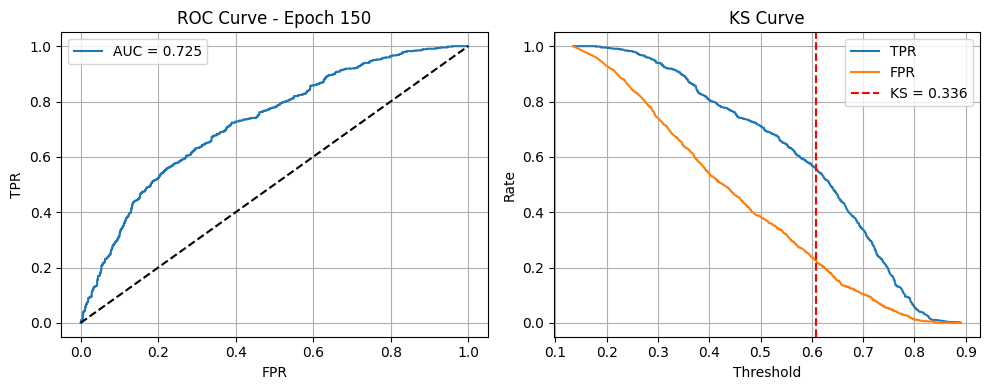

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - accuracy: 0.6163 - loss: 0.7241 - val_accuracy: 0.6638 - val_loss: 0.6692
Epoch 151/1000
160/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.6242 - loss: 0.7167Epoch 151 - ROC AUC: 0.7260 | KS: 0.3369
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.6243 - loss: 0.7166 - val_accuracy: 0.6654 - val_loss: 0.6683
Epoch 152/1000
155/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6343 - loss: 0.7044Epoch 152 - ROC AUC: 0.7270 | KS: 0.3385
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.6346 - loss: 0.7044 - val_accuracy: 0.6654 - val_loss: 0.6675
Epoch 153/1000
157/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6440 - loss: 0.7027Epoch 153 - ROC AUC: 0.7281 | KS: 0.3400
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.6437 - loss: 0.7032 - val_accuracy: 0.6665 - val_loss: 0.6667
Epoch 154/1000
153/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6565 - loss: 0.6957Epoch 154 - ROC AUC: 0.7290 | KS: 0.3400
162/162 ━━━

<Figure size 640x480 with 0 Axes>

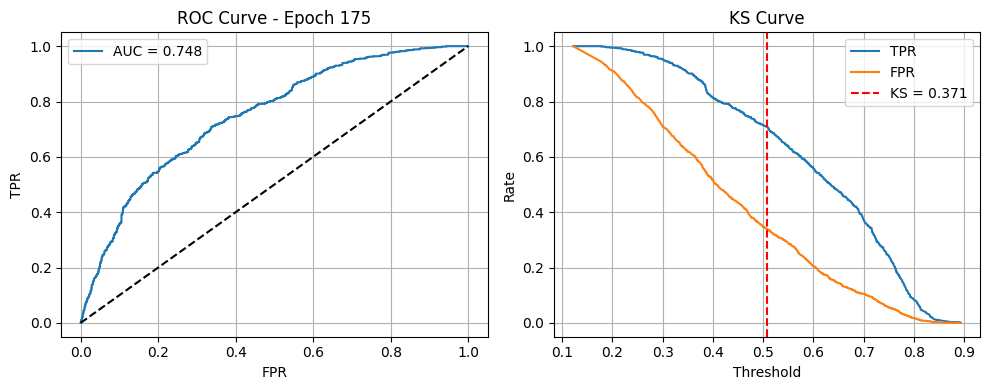

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - accuracy: 0.6533 - loss: 0.6809 - val_accuracy: 0.6828 - val_loss: 0.6500
Epoch 176/1000
154/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.6531 - loss: 0.6841Epoch 176 - ROC AUC: 0.7491 | KS: 0.3718
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.6531 - loss: 0.6845 - val_accuracy: 0.6840 - val_loss: 0.6493
Epoch 177/1000
159/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6496 - loss: 0.6977Epoch 177 - ROC AUC: 0.7499 | KS: 0.3718
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.6498 - loss: 0.6976 - val_accuracy: 0.6840 - val_loss: 0.6487
Epoch 178/1000
150/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6458 - loss: 0.6929Epoch 178 - ROC AUC: 0.7507 | KS: 0.3718
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.6460 - loss: 0.6927 - val_accuracy: 0.6844 - val_loss: 0.6480
Epoch 179/1000
152/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6520 - loss: 0.6798Epoch 179 - ROC AUC: 0.7515 | KS: 0.3726
162/162 ━━━

<Figure size 640x480 with 0 Axes>

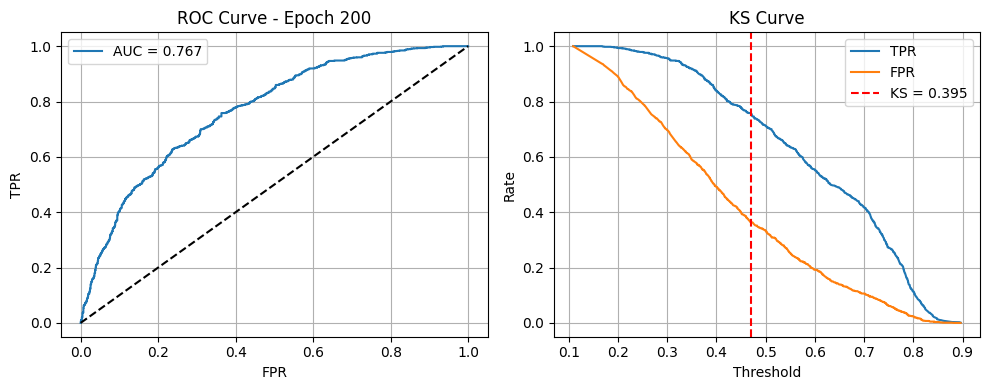

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.6575 - loss: 0.6896 - val_accuracy: 0.6894 - val_loss: 0.6343
Epoch 201/1000
146/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6711 - loss: 0.6578Epoch 201 - ROC AUC: 0.7672 | KS: 0.3950
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.6696 - loss: 0.6595 - val_accuracy: 0.6902 - val_loss: 0.6338
Epoch 202/1000
147/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6566 - loss: 0.6768Epoch 202 - ROC AUC: 0.7679 | KS: 0.3958
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.6562 - loss: 0.6771 - val_accuracy: 0.6913 - val_loss: 0.6332
Epoch 203/1000
152/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.6648 - loss: 0.6690Epoch 203 - ROC AUC: 0.7685 | KS: 0.3958
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.6644 - loss: 0.6697 - val_accuracy: 0.6917 - val_loss: 0.6327
Epoch 204/1000
149/162 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.6568 - loss: 0.6738Epoch 204 - ROC AUC: 0.7691 | KS: 0.3966
162/162 ━━━━

<Figure size 640x480 with 0 Axes>

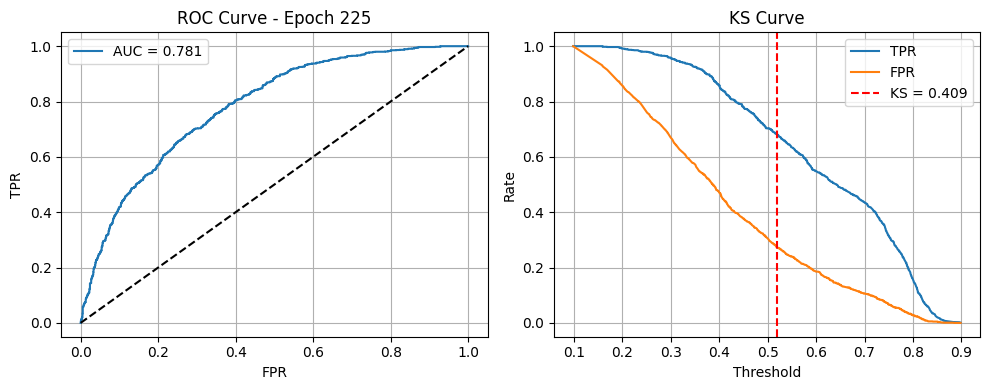

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.6774 - loss: 0.6625 - val_accuracy: 0.6998 - val_loss: 0.6215
Epoch 226/1000
156/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6693 - loss: 0.6730Epoch 226 - ROC AUC: 0.7818 | KS: 0.4105
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.6692 - loss: 0.6730 - val_accuracy: 0.7002 - val_loss: 0.6210
Epoch 227/1000
146/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6772 - loss: 0.6646Epoch 227 - ROC AUC: 0.7823 | KS: 0.4121
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.6765 - loss: 0.6654 - val_accuracy: 0.7006 - val_loss: 0.6206
Epoch 228/1000
161/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6748 - loss: 0.6621Epoch 228 - ROC AUC: 0.7829 | KS: 0.4136
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.6748 - loss: 0.6621 - val_accuracy: 0.7014 - val_loss: 0.6201
Epoch 229/1000
161/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6646 - loss: 0.6715Epoch 229 - ROC AUC: 0.7833 | KS: 0.4136
162/162 ━━━━

<Figure size 640x480 with 0 Axes>

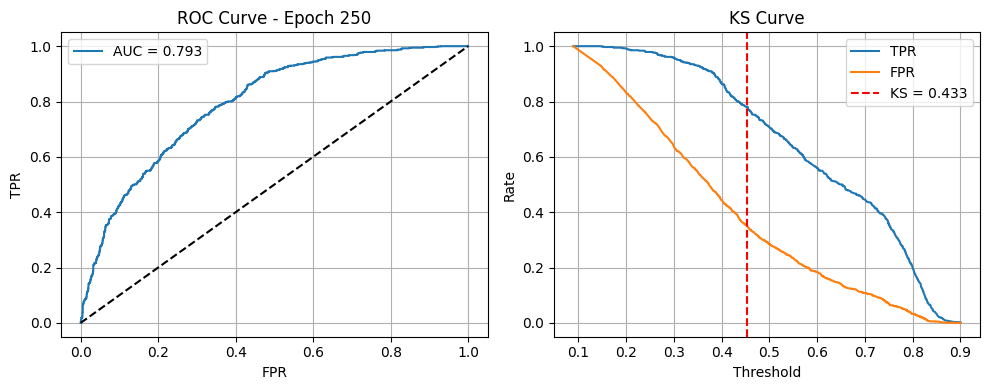

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.6735 - loss: 0.6569 - val_accuracy: 0.7111 - val_loss: 0.6110
Epoch 251/1000
160/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6816 - loss: 0.6446Epoch 251 - ROC AUC: 0.7932 | KS: 0.4322
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.6817 - loss: 0.6447 - val_accuracy: 0.7115 - val_loss: 0.6106
Epoch 252/1000
159/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6775 - loss: 0.6656Epoch 252 - ROC AUC: 0.7935 | KS: 0.4330
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.6774 - loss: 0.6654 - val_accuracy: 0.7126 - val_loss: 0.6102
Epoch 253/1000
160/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6708 - loss: 0.6618Epoch 253 - ROC AUC: 0.7939 | KS: 0.4338
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.6710 - loss: 0.6617 - val_accuracy: 0.7126 - val_loss: 0.6099
Epoch 254/1000
155/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6755 - loss: 0.6525Epoch 254 - ROC AUC: 0.7942 | KS: 0.4369
162/162 ━━━

<Figure size 640x480 with 0 Axes>

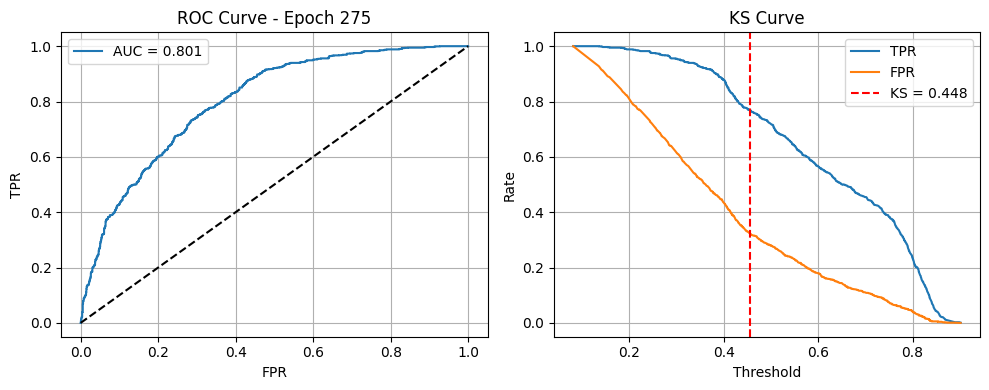

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - accuracy: 0.6924 - loss: 0.6322 - val_accuracy: 0.7196 - val_loss: 0.6024
Epoch 276/1000
152/162 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.6991 - loss: 0.6415Epoch 276 - ROC AUC: 0.8010 | KS: 0.4485
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.6983 - loss: 0.6419 - val_accuracy: 0.7196 - val_loss: 0.6020
Epoch 277/1000
152/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6944 - loss: 0.6443Epoch 277 - ROC AUC: 0.8013 | KS: 0.4500
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.6941 - loss: 0.6447 - val_accuracy: 0.7196 - val_loss: 0.6017
Epoch 278/1000
148/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7049 - loss: 0.6334Epoch 278 - ROC AUC: 0.8016 | KS: 0.4500
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7039 - loss: 0.6346 - val_accuracy: 0.7200 - val_loss: 0.6014
Epoch 279/1000
150/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6783 - loss: 0.6528Epoch 279 - ROC AUC: 0.8019 | KS: 0.4500
162/162 ━━

<Figure size 640x480 with 0 Axes>

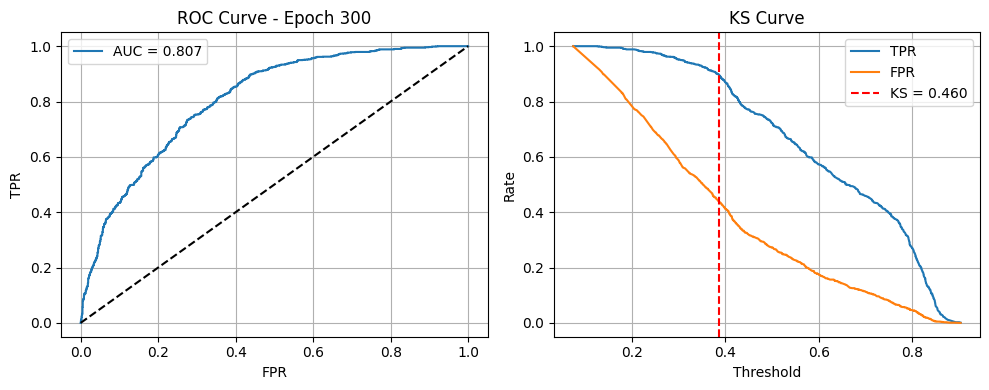

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - accuracy: 0.6819 - loss: 0.6531 - val_accuracy: 0.7246 - val_loss: 0.5953
Epoch 301/1000
147/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.6726 - loss: 0.6588Epoch 301 - ROC AUC: 0.8073 | KS: 0.4609
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.6742 - loss: 0.6577 - val_accuracy: 0.7246 - val_loss: 0.5950
Epoch 302/1000
157/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6965 - loss: 0.6339Epoch 302 - ROC AUC: 0.8075 | KS: 0.4601
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.6963 - loss: 0.6342 - val_accuracy: 0.7242 - val_loss: 0.5948
Epoch 303/1000
147/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6881 - loss: 0.6338Epoch 303 - ROC AUC: 0.8077 | KS: 0.4617
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.6885 - loss: 0.6341 - val_accuracy: 0.7246 - val_loss: 0.5945
Epoch 304/1000
158/162 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.6978 - loss: 0.6205Epoch 304 - ROC AUC: 0.8079 | KS: 0.4632
162/162 ━━━

<Figure size 640x480 with 0 Axes>

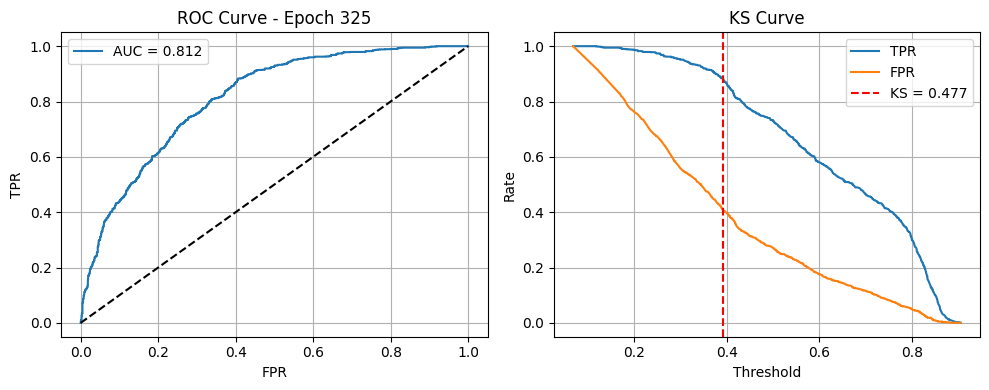

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.6925 - loss: 0.6439 - val_accuracy: 0.7304 - val_loss: 0.5895
Epoch 326/1000
158/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6965 - loss: 0.6356Epoch 326 - ROC AUC: 0.8118 | KS: 0.4771
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.6965 - loss: 0.6357 - val_accuracy: 0.7304 - val_loss: 0.5893
Epoch 327/1000
161/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6858 - loss: 0.6424Epoch 327 - ROC AUC: 0.8119 | KS: 0.4764
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.6860 - loss: 0.6423 - val_accuracy: 0.7304 - val_loss: 0.5891
Epoch 328/1000
154/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6944 - loss: 0.6429Epoch 328 - ROC AUC: 0.8120 | KS: 0.4764
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.6942 - loss: 0.6428 - val_accuracy: 0.7304 - val_loss: 0.5889
Epoch 329/1000
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7076 - loss: 0.6347Epoch 329 - ROC AUC: 0.8122 | KS: 0.4764
162/162 ━━━

<Figure size 640x480 with 0 Axes>

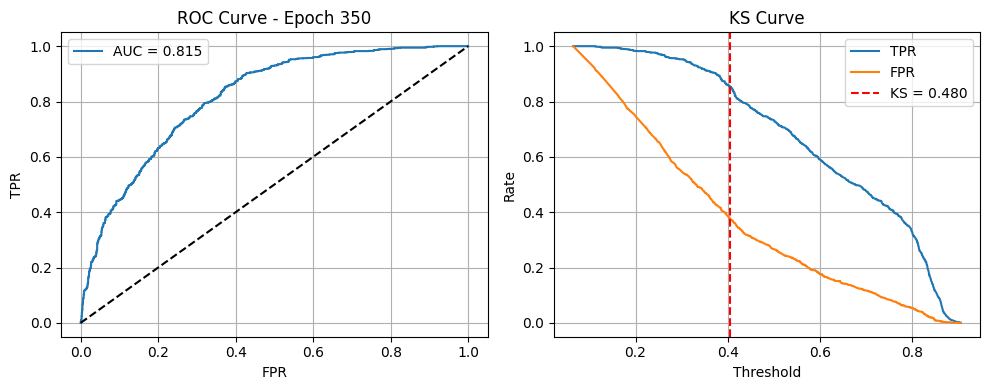

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step - accuracy: 0.7013 - loss: 0.6277 - val_accuracy: 0.7328 - val_loss: 0.5847
Epoch 351/1000
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6835 - loss: 0.6488Epoch 351 - ROC AUC: 0.8151 | KS: 0.4810
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.6836 - loss: 0.6487 - val_accuracy: 0.7328 - val_loss: 0.5845
Epoch 352/1000
160/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7000 - loss: 0.6302Epoch 352 - ROC AUC: 0.8152 | KS: 0.4818
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7000 - loss: 0.6303 - val_accuracy: 0.7332 - val_loss: 0.5844
Epoch 353/1000
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.6913 - loss: 0.6320Epoch 353 - ROC AUC: 0.8153 | KS: 0.4818
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.6913 - loss: 0.6319 - val_accuracy: 0.7324 - val_loss: 0.5842
Epoch 354/1000
159/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6828 - loss: 0.6462Epoch 354 - ROC AUC: 0.8154 | KS: 0.4810
162/162 ━━━

<Figure size 640x480 with 0 Axes>

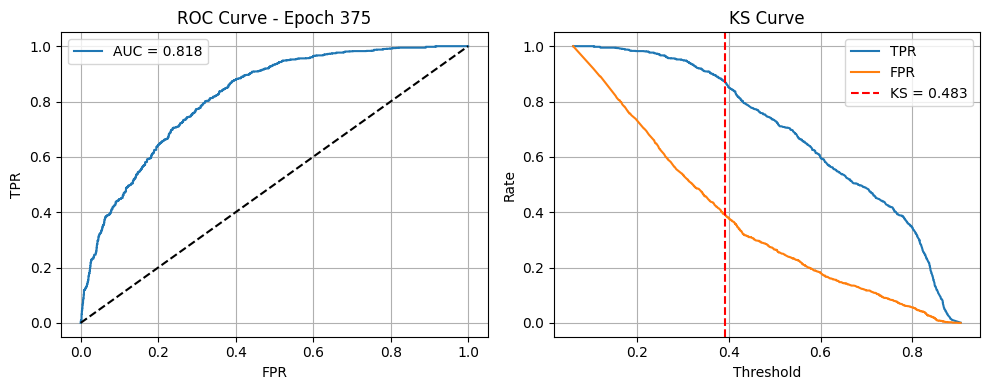

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.7043 - loss: 0.6301 - val_accuracy: 0.7320 - val_loss: 0.5807
Epoch 376/1000
152/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7056 - loss: 0.6225Epoch 376 - ROC AUC: 0.8178 | KS: 0.4833
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7059 - loss: 0.6223 - val_accuracy: 0.7320 - val_loss: 0.5806
Epoch 377/1000
149/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7118 - loss: 0.6122Epoch 377 - ROC AUC: 0.8179 | KS: 0.4826
162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - accuracy: 0.7113 - loss: 0.6133 - val_accuracy: 0.7320 - val_loss: 0.5804
Epoch 378/1000
150/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7252 - loss: 0.6098Epoch 378 - ROC AUC: 0.8180 | KS: 0.4826
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.7239 - loss: 0.6109 - val_accuracy: 0.7320 - val_loss: 0.5803
Epoch 379/1000
157/162 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7182 - loss: 0.6131Epoch 379 - ROC AUC: 0.8181 | KS: 0.4826
162/162 ━━━

<Figure size 640x480 with 0 Axes>

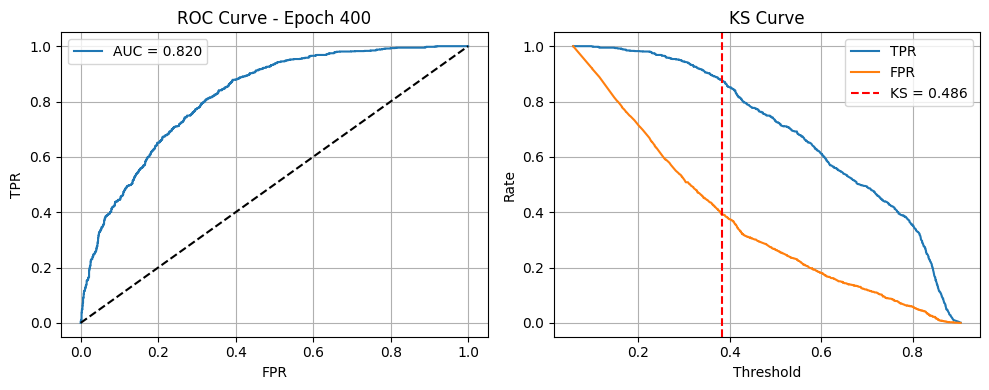

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - accuracy: 0.7156 - loss: 0.6188 - val_accuracy: 0.7328 - val_loss: 0.5774
Epoch 401/1000
152/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7132 - loss: 0.6232Epoch 401 - ROC AUC: 0.8199 | KS: 0.4857
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.7131 - loss: 0.6231 - val_accuracy: 0.7320 - val_loss: 0.5773
Epoch 402/1000
150/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7138 - loss: 0.6184Epoch 402 - ROC AUC: 0.8200 | KS: 0.4857
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7132 - loss: 0.6189 - val_accuracy: 0.7320 - val_loss: 0.5771
Epoch 403/1000
153/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7233 - loss: 0.6109Epoch 403 - ROC AUC: 0.8201 | KS: 0.4849
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7229 - loss: 0.6113 - val_accuracy: 0.7320 - val_loss: 0.5770
Epoch 404/1000
156/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7045 - loss: 0.6243Epoch 404 - ROC AUC: 0.8201 | KS: 0.4864
162/162 ━━━

<Figure size 640x480 with 0 Axes>

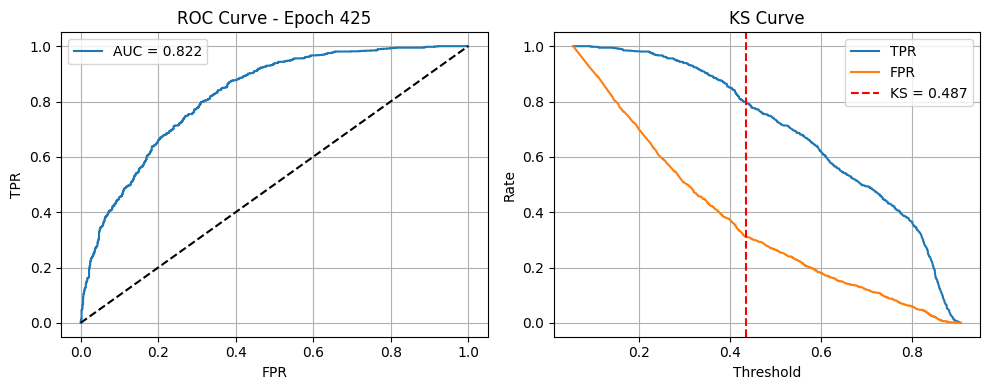

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - accuracy: 0.7079 - loss: 0.6137 - val_accuracy: 0.7347 - val_loss: 0.5746
Epoch 426/1000
159/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7242 - loss: 0.6083Epoch 426 - ROC AUC: 0.8216 | KS: 0.4880
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.7240 - loss: 0.6085 - val_accuracy: 0.7347 - val_loss: 0.5745
Epoch 427/1000
161/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7182 - loss: 0.6078Epoch 427 - ROC AUC: 0.8216 | KS: 0.4880
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7181 - loss: 0.6079 - val_accuracy: 0.7347 - val_loss: 0.5744
Epoch 428/1000
157/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7188 - loss: 0.6097Epoch 428 - ROC AUC: 0.8217 | KS: 0.4880
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7185 - loss: 0.6099 - val_accuracy: 0.7347 - val_loss: 0.5743
Epoch 429/1000
154/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7148 - loss: 0.6150Epoch 429 - ROC AUC: 0.8217 | KS: 0.4880
162/162 ━━━

<Figure size 640x480 with 0 Axes>

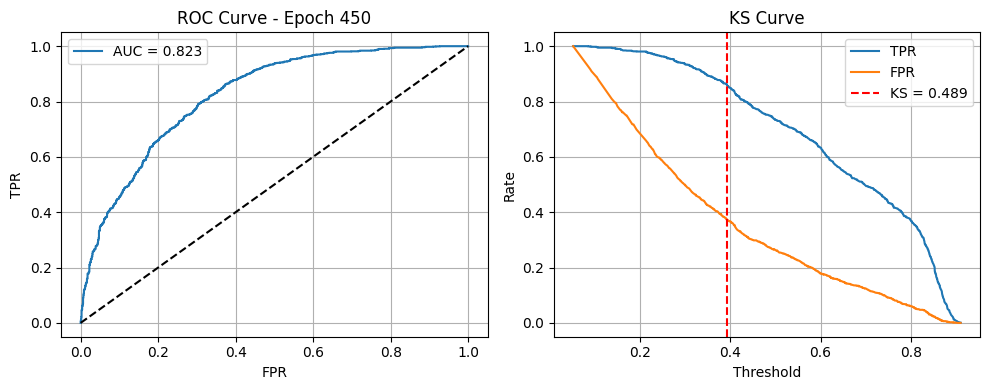

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - accuracy: 0.7206 - loss: 0.6130 - val_accuracy: 0.7355 - val_loss: 0.5722
Epoch 451/1000
154/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7234 - loss: 0.6120Epoch 451 - ROC AUC: 0.8230 | KS: 0.4895
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.7232 - loss: 0.6123 - val_accuracy: 0.7359 - val_loss: 0.5721
Epoch 452/1000
148/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7088 - loss: 0.6154Epoch 452 - ROC AUC: 0.8231 | KS: 0.4903
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7092 - loss: 0.6153 - val_accuracy: 0.7359 - val_loss: 0.5720
Epoch 453/1000
155/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7079 - loss: 0.6225Epoch 453 - ROC AUC: 0.8232 | KS: 0.4911
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7081 - loss: 0.6220 - val_accuracy: 0.7359 - val_loss: 0.5720
Epoch 454/1000
152/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7140 - loss: 0.6176Epoch 454 - ROC AUC: 0.8232 | KS: 0.4903
162/162 ━━━

<Figure size 640x480 with 0 Axes>

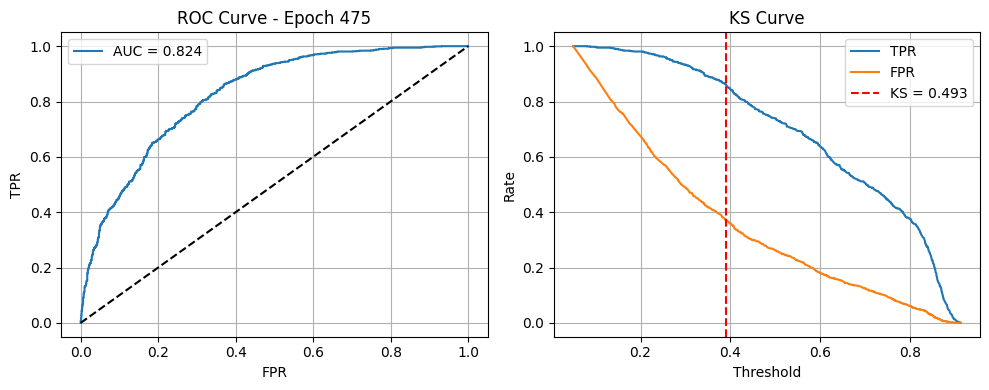

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.7187 - loss: 0.6106 - val_accuracy: 0.7378 - val_loss: 0.5702
Epoch 476/1000
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7193 - loss: 0.6090Epoch 476 - ROC AUC: 0.8242 | KS: 0.4926
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7193 - loss: 0.6090 - val_accuracy: 0.7378 - val_loss: 0.5701
Epoch 477/1000
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7180 - loss: 0.6225Epoch 477 - ROC AUC: 0.8243 | KS: 0.4934
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7180 - loss: 0.6225 - val_accuracy: 0.7378 - val_loss: 0.5700
Epoch 478/1000
160/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7113 - loss: 0.6211Epoch 478 - ROC AUC: 0.8243 | KS: 0.4926
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7114 - loss: 0.6209 - val_accuracy: 0.7378 - val_loss: 0.5700
Epoch 479/1000
157/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7217 - loss: 0.6039Epoch 479 - ROC AUC: 0.8243 | KS: 0.4942
162/162 ━━━

<Figure size 640x480 with 0 Axes>

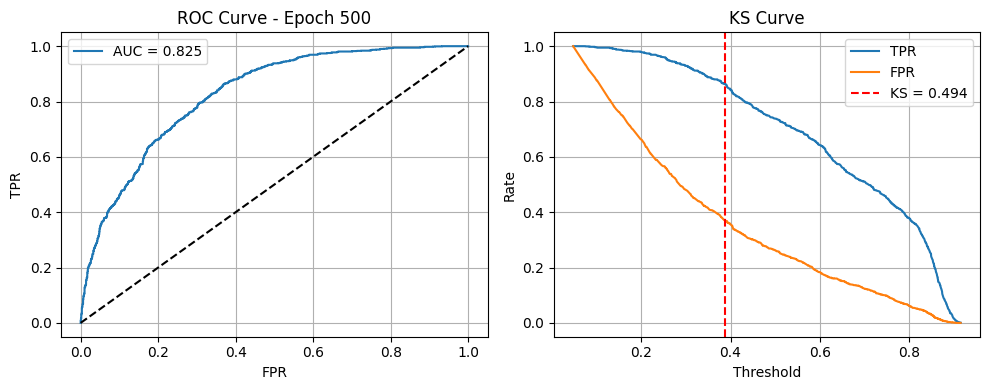

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.7188 - loss: 0.6194 - val_accuracy: 0.7378 - val_loss: 0.5684
Epoch 501/1000
161/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7065 - loss: 0.6225Epoch 501 - ROC AUC: 0.8252 | KS: 0.4942
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7066 - loss: 0.6223 - val_accuracy: 0.7378 - val_loss: 0.5684
Epoch 502/1000
151/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7181 - loss: 0.6121Epoch 502 - ROC AUC: 0.8252 | KS: 0.4950
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7182 - loss: 0.6122 - val_accuracy: 0.7378 - val_loss: 0.5683
Epoch 503/1000
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7111 - loss: 0.6201Epoch 503 - ROC AUC: 0.8252 | KS: 0.4950
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.7111 - loss: 0.6200 - val_accuracy: 0.7378 - val_loss: 0.5682
Epoch 504/1000
158/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7155 - loss: 0.6143Epoch 504 - ROC AUC: 0.8252 | KS: 0.4950
162/162 ━━━

<Figure size 640x480 with 0 Axes>

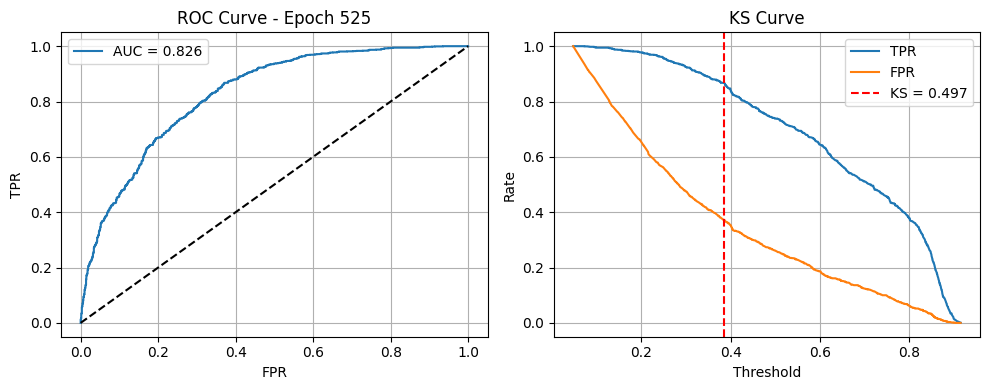

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - accuracy: 0.7163 - loss: 0.6047 - val_accuracy: 0.7386 - val_loss: 0.5669
Epoch 526/1000
152/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7230 - loss: 0.6039Epoch 526 - ROC AUC: 0.8260 | KS: 0.4973
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.7226 - loss: 0.6043 - val_accuracy: 0.7386 - val_loss: 0.5668
Epoch 527/1000
155/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7247 - loss: 0.6063Epoch 527 - ROC AUC: 0.8260 | KS: 0.4973
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7246 - loss: 0.6067 - val_accuracy: 0.7390 - val_loss: 0.5668
Epoch 528/1000
148/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7108 - loss: 0.6183Epoch 528 - ROC AUC: 0.8260 | KS: 0.4973
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.7111 - loss: 0.6180 - val_accuracy: 0.7386 - val_loss: 0.5667
Epoch 529/1000
151/162 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7169 - loss: 0.6100Epoch 529 - ROC AUC: 0.8261 | KS: 0.4981
162/162 ━━

<Figure size 640x480 with 0 Axes>

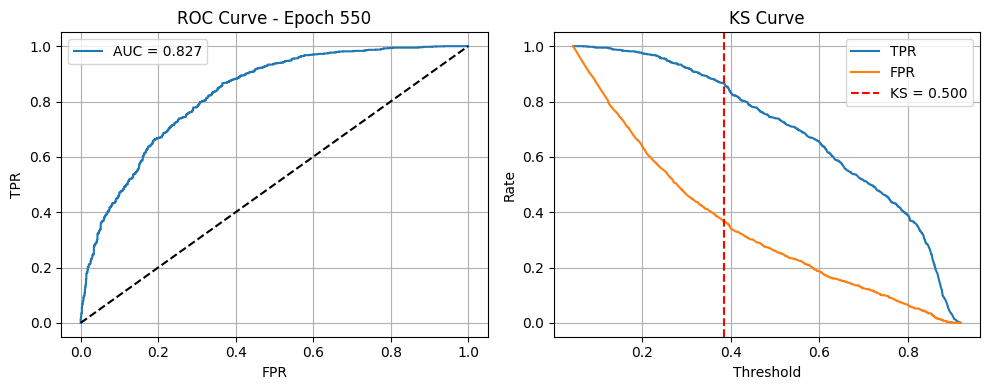

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.7344 - loss: 0.5956 - val_accuracy: 0.7397 - val_loss: 0.5656
Epoch 551/1000
153/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7195 - loss: 0.6084Epoch 551 - ROC AUC: 0.8267 | KS: 0.5004
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.7197 - loss: 0.6084 - val_accuracy: 0.7397 - val_loss: 0.5655
Epoch 552/1000
150/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7355 - loss: 0.5897Epoch 552 - ROC AUC: 0.8267 | KS: 0.5004
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7345 - loss: 0.5906 - val_accuracy: 0.7397 - val_loss: 0.5655
Epoch 553/1000
149/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7244 - loss: 0.6061Epoch 553 - ROC AUC: 0.8268 | KS: 0.4996
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7245 - loss: 0.6061 - val_accuracy: 0.7397 - val_loss: 0.5654
Epoch 554/1000
155/162 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7225 - loss: 0.6123Epoch 554 - ROC AUC: 0.8268 | KS: 0.4996
162/162 ━━━

<Figure size 640x480 with 0 Axes>

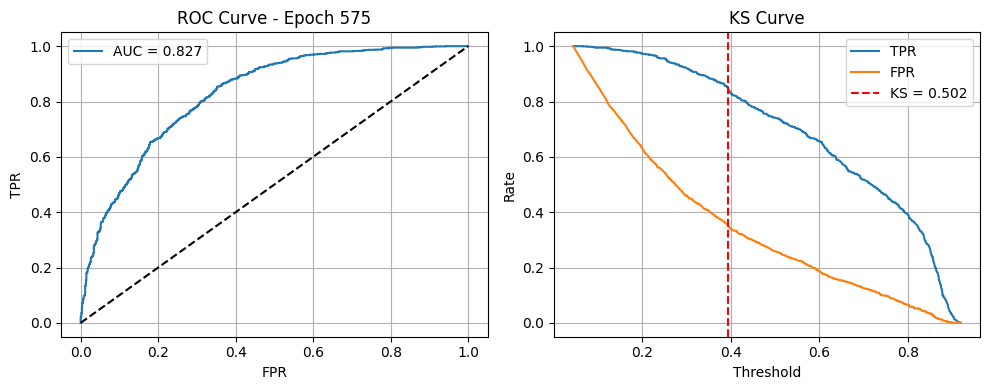

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - accuracy: 0.7118 - loss: 0.6101 - val_accuracy: 0.7413 - val_loss: 0.5644
Epoch 576/1000
155/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7134 - loss: 0.6143Epoch 576 - ROC AUC: 0.8274 | KS: 0.5019
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.7138 - loss: 0.6137 - val_accuracy: 0.7413 - val_loss: 0.5643
Epoch 577/1000
154/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7172 - loss: 0.6212Epoch 577 - ROC AUC: 0.8274 | KS: 0.5019
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7177 - loss: 0.6203 - val_accuracy: 0.7413 - val_loss: 0.5643
Epoch 578/1000
158/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7161 - loss: 0.6070Epoch 578 - ROC AUC: 0.8275 | KS: 0.5019
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7163 - loss: 0.6069 - val_accuracy: 0.7413 - val_loss: 0.5643
Epoch 579/1000
156/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7247 - loss: 0.5983Epoch 579 - ROC AUC: 0.8275 | KS: 0.5019
162/162 ━━━

<Figure size 640x480 with 0 Axes>

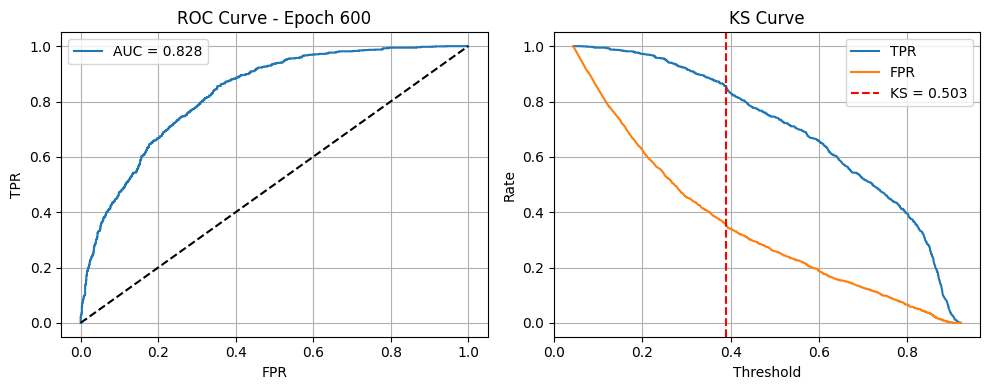

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step - accuracy: 0.7264 - loss: 0.5955 - val_accuracy: 0.7428 - val_loss: 0.5633
Epoch 601/1000
159/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7284 - loss: 0.5965Epoch 601 - ROC AUC: 0.8279 | KS: 0.5019
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.7283 - loss: 0.5966 - val_accuracy: 0.7428 - val_loss: 0.5633
Epoch 602/1000
156/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7202 - loss: 0.6081Epoch 602 - ROC AUC: 0.8280 | KS: 0.5019
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7203 - loss: 0.6080 - val_accuracy: 0.7428 - val_loss: 0.5633
Epoch 603/1000
157/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7319 - loss: 0.5919Epoch 603 - ROC AUC: 0.8280 | KS: 0.5019
162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - accuracy: 0.7317 - loss: 0.5922 - val_accuracy: 0.7428 - val_loss: 0.5632
Epoch 604/1000
153/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7253 - loss: 0.6049Epoch 604 - ROC AUC: 0.8280 | KS: 0.5019
162/162 ━━

<Figure size 640x480 with 0 Axes>

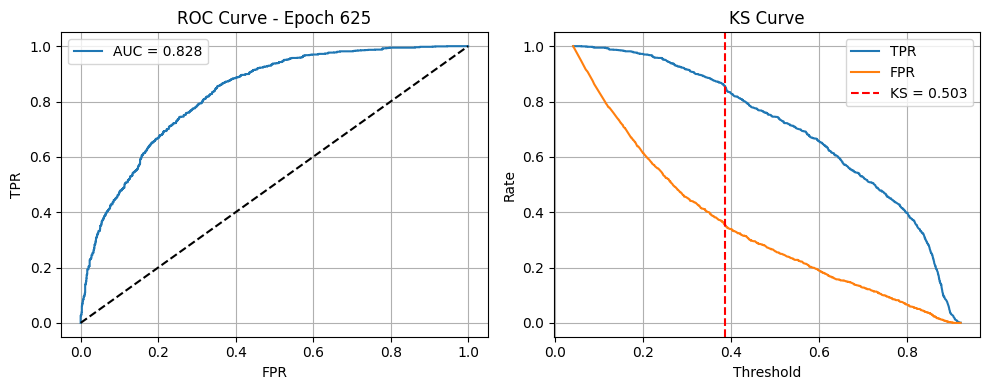

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step - accuracy: 0.7171 - loss: 0.6015 - val_accuracy: 0.7432 - val_loss: 0.5624
Epoch 626/1000
161/162 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7234 - loss: 0.6052Epoch 626 - ROC AUC: 0.8285 | KS: 0.5027
162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - accuracy: 0.7234 - loss: 0.6052 - val_accuracy: 0.7432 - val_loss: 0.5624
Epoch 627/1000
161/162 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - accuracy: 0.7240 - loss: 0.6016Epoch 627 - ROC AUC: 0.8285 | KS: 0.5027
162/162 ━━━━━━━━━━━━━━━━━━━━ 5s 19ms/step - accuracy: 0.7240 - loss: 0.6015 - val_accuracy: 0.7432 - val_loss: 0.5623
Epoch 628/1000
157/162 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.7268 - loss: 0.6001Epoch 628 - ROC AUC: 0.8285 | KS: 0.5027
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.7266 - loss: 0.6002 - val_accuracy: 0.7432 - val_loss: 0.5623
Epoch 629/1000
155/162 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.7288 - loss: 0.5973Epoch 629 - ROC AUC: 0.8285 | KS: 0.5027
162/162 

<Figure size 640x480 with 0 Axes>

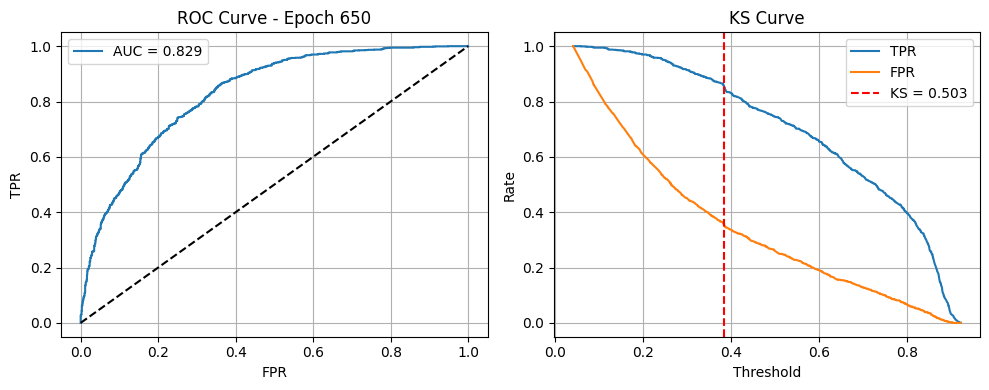

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step - accuracy: 0.7193 - loss: 0.5968 - val_accuracy: 0.7424 - val_loss: 0.5615
Epoch 651/1000
159/162 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.7111 - loss: 0.6152Epoch 651 - ROC AUC: 0.8289 | KS: 0.5027
162/162 ━━━━━━━━━━━━━━━━━━━━ 4s 12ms/step - accuracy: 0.7115 - loss: 0.6148 - val_accuracy: 0.7424 - val_loss: 0.5615
Epoch 652/1000
157/162 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - accuracy: 0.7199 - loss: 0.6135Epoch 652 - ROC AUC: 0.8289 | KS: 0.5027
162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 20ms/step - accuracy: 0.7201 - loss: 0.6133 - val_accuracy: 0.7424 - val_loss: 0.5615
Epoch 653/1000
158/162 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.7291 - loss: 0.5970Epoch 653 - ROC AUC: 0.8289 | KS: 0.5027
162/162 ━━━━━━━━━━━━━━━━━━━━ 5s 21ms/step - accuracy: 0.7289 - loss: 0.5972 - val_accuracy: 0.7424 - val_loss: 0.5614
Epoch 654/1000
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.7185 - loss: 0.5997Epoch 654 - ROC AUC: 0.8289 | KS: 0.5027
162/162

<Figure size 640x480 with 0 Axes>

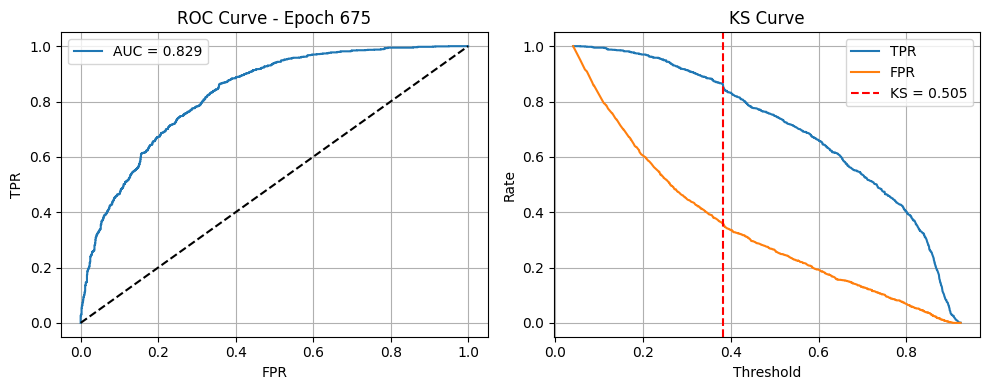

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - accuracy: 0.7211 - loss: 0.6052 - val_accuracy: 0.7428 - val_loss: 0.5608
Epoch 676/1000
150/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7267 - loss: 0.6033Epoch 676 - ROC AUC: 0.8292 | KS: 0.5050
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7268 - loss: 0.6030 - val_accuracy: 0.7428 - val_loss: 0.5607
Epoch 677/1000
153/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7363 - loss: 0.5936Epoch 677 - ROC AUC: 0.8292 | KS: 0.5058
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7358 - loss: 0.5938 - val_accuracy: 0.7428 - val_loss: 0.5607
Epoch 678/1000
160/162 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.7338 - loss: 0.5838Epoch 678 - ROC AUC: 0.8292 | KS: 0.5058
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - accuracy: 0.7338 - loss: 0.5839 - val_accuracy: 0.7428 - val_loss: 0.5607
Epoch 679/1000
157/162 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7352 - loss: 0.5929Epoch 679 - ROC AUC: 0.8292 | KS: 0.5058
162/162 ━━

<Figure size 640x480 with 0 Axes>

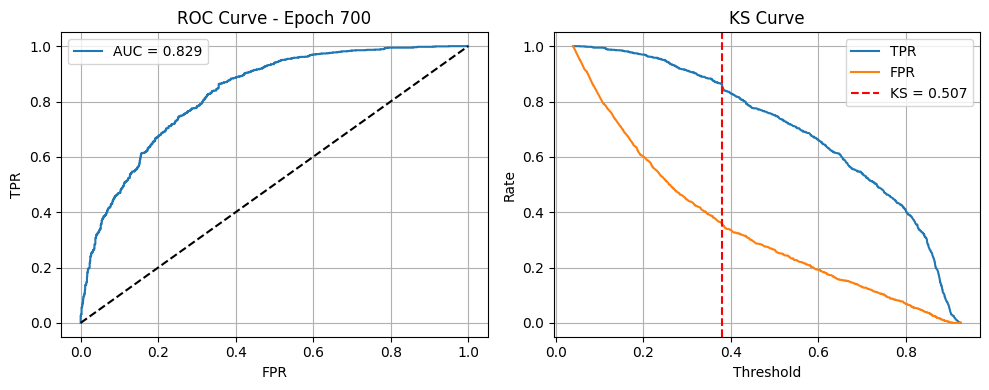

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - accuracy: 0.7250 - loss: 0.5925 - val_accuracy: 0.7428 - val_loss: 0.5601
Epoch 701/1000
159/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7325 - loss: 0.5935Epoch 701 - ROC AUC: 0.8295 | KS: 0.5081
162/162 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7326 - loss: 0.5935 - val_accuracy: 0.7440 - val_loss: 0.5601
Epoch 702/1000
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7285 - loss: 0.5968Epoch 702 - ROC AUC: 0.8295 | KS: 0.5081
162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - accuracy: 0.7285 - loss: 0.5968 - val_accuracy: 0.7440 - val_loss: 0.5600
Epoch 703/1000
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7130 - loss: 0.6202Epoch 703 - ROC AUC: 0.8295 | KS: 0.5081
162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step - accuracy: 0.7131 - loss: 0.6201 - val_accuracy: 0.7440 - val_loss: 0.5600
Epoch 704/1000
157/162 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7246 - loss: 0.6050Epoch 704 - ROC AUC: 0.8295 | KS: 0.5081
162/162 ━━

<Figure size 640x480 with 0 Axes>

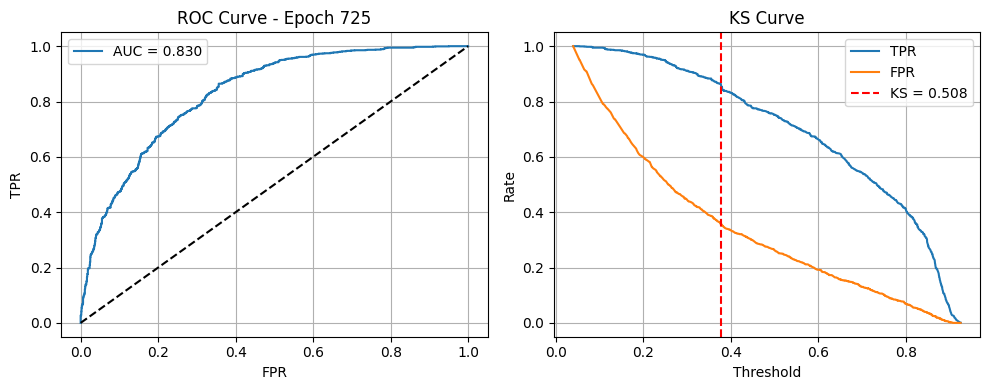

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step - accuracy: 0.7206 - loss: 0.6135 - val_accuracy: 0.7448 - val_loss: 0.5595
Epoch 726/1000
160/162 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7309 - loss: 0.6043Epoch 726 - ROC AUC: 0.8299 | KS: 0.5081
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.7308 - loss: 0.6043 - val_accuracy: 0.7448 - val_loss: 0.5594
Epoch 727/1000
159/162 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7312 - loss: 0.6038Epoch 727 - ROC AUC: 0.8299 | KS: 0.5081
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step - accuracy: 0.7313 - loss: 0.6035 - val_accuracy: 0.7444 - val_loss: 0.5594
Epoch 728/1000
159/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7345 - loss: 0.5827Epoch 728 - ROC AUC: 0.8299 | KS: 0.5081
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.7343 - loss: 0.5830 - val_accuracy: 0.7444 - val_loss: 0.5594
Epoch 729/1000
155/162 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.7294 - loss: 0.5996Epoch 729 - ROC AUC: 0.8299 | KS: 0.5081
162/162 ━━

<Figure size 640x480 with 0 Axes>

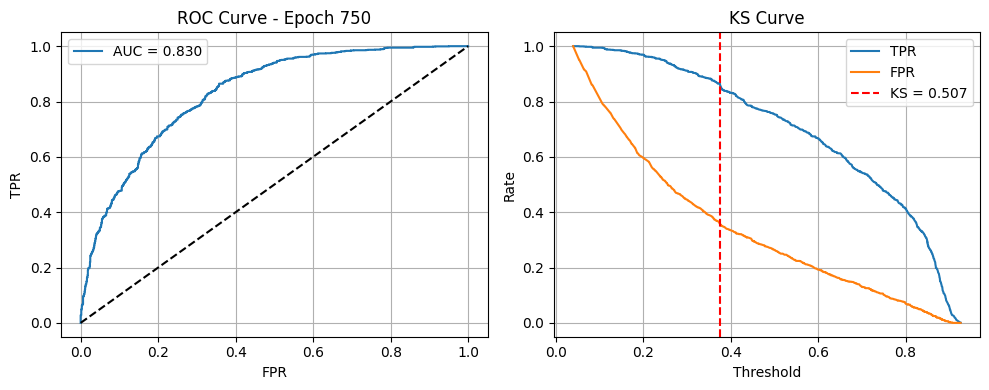

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - accuracy: 0.7159 - loss: 0.6088 - val_accuracy: 0.7452 - val_loss: 0.5589
Epoch 751/1000
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7276 - loss: 0.5907Epoch 751 - ROC AUC: 0.8302 | KS: 0.5074
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7276 - loss: 0.5907 - val_accuracy: 0.7452 - val_loss: 0.5588
Epoch 752/1000
160/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7117 - loss: 0.6159Epoch 752 - ROC AUC: 0.8302 | KS: 0.5066
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7120 - loss: 0.6155 - val_accuracy: 0.7452 - val_loss: 0.5588
Epoch 753/1000
159/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7411 - loss: 0.5775Epoch 753 - ROC AUC: 0.8302 | KS: 0.5066
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.7410 - loss: 0.5779 - val_accuracy: 0.7452 - val_loss: 0.5588
Epoch 754/1000
154/162 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7286 - loss: 0.5979Epoch 754 - ROC AUC: 0.8302 | KS: 0.5066
162/162 ━━━

<Figure size 640x480 with 0 Axes>

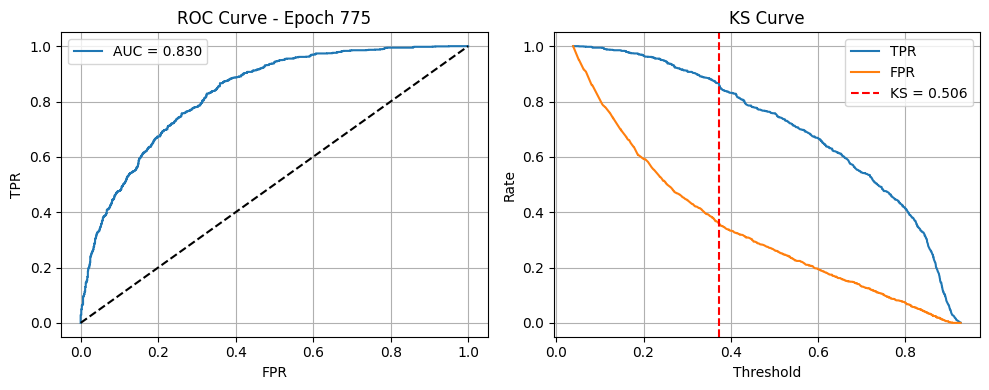

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - accuracy: 0.7322 - loss: 0.5927 - val_accuracy: 0.7471 - val_loss: 0.5583
Epoch 776/1000
157/162 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7444 - loss: 0.5876Epoch 776 - ROC AUC: 0.8305 | KS: 0.5058
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7442 - loss: 0.5877 - val_accuracy: 0.7471 - val_loss: 0.5583
Epoch 777/1000
151/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7268 - loss: 0.6015Epoch 777 - ROC AUC: 0.8305 | KS: 0.5058
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.7271 - loss: 0.6011 - val_accuracy: 0.7471 - val_loss: 0.5583
Epoch 778/1000
156/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7396 - loss: 0.5851Epoch 778 - ROC AUC: 0.8305 | KS: 0.5058
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7392 - loss: 0.5854 - val_accuracy: 0.7471 - val_loss: 0.5583
Epoch 779/1000
150/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7373 - loss: 0.5906Epoch 779 - ROC AUC: 0.8305 | KS: 0.5066
162/162 ━━━

<Figure size 640x480 with 0 Axes>

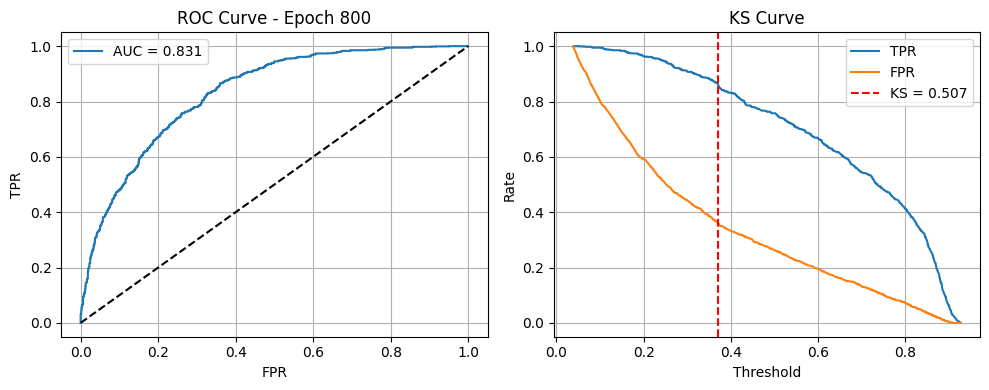

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - accuracy: 0.7377 - loss: 0.5856 - val_accuracy: 0.7479 - val_loss: 0.5578
Epoch 801/1000
153/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7221 - loss: 0.6070Epoch 801 - ROC AUC: 0.8306 | KS: 0.5066
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step - accuracy: 0.7226 - loss: 0.6060 - val_accuracy: 0.7479 - val_loss: 0.5578
Epoch 802/1000
159/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7350 - loss: 0.5916Epoch 802 - ROC AUC: 0.8306 | KS: 0.5066
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7350 - loss: 0.5916 - val_accuracy: 0.7479 - val_loss: 0.5578
Epoch 803/1000
149/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7433 - loss: 0.5829Epoch 803 - ROC AUC: 0.8307 | KS: 0.5066
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7421 - loss: 0.5844 - val_accuracy: 0.7479 - val_loss: 0.5577
Epoch 804/1000
154/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7310 - loss: 0.5973Epoch 804 - ROC AUC: 0.8307 | KS: 0.5066
162/162 ━━

<Figure size 640x480 with 0 Axes>

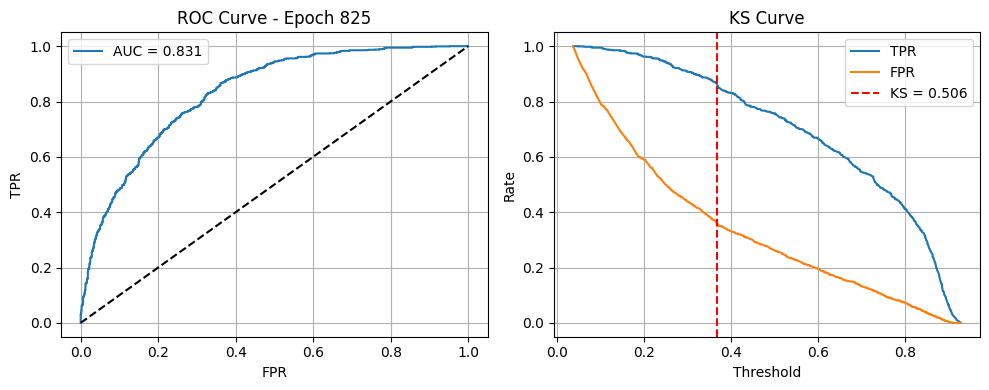

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step - accuracy: 0.7407 - loss: 0.5840 - val_accuracy: 0.7479 - val_loss: 0.5573
Epoch 826/1000
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7449 - loss: 0.5807Epoch 826 - ROC AUC: 0.8309 | KS: 0.5058
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7449 - loss: 0.5807 - val_accuracy: 0.7479 - val_loss: 0.5573
Epoch 827/1000
150/162 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7262 - loss: 0.5891Epoch 827 - ROC AUC: 0.8309 | KS: 0.5058
162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - accuracy: 0.7268 - loss: 0.5892 - val_accuracy: 0.7479 - val_loss: 0.5573
Epoch 828/1000
153/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7427 - loss: 0.5835Epoch 828 - ROC AUC: 0.8309 | KS: 0.5058
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.7426 - loss: 0.5835 - val_accuracy: 0.7479 - val_loss: 0.5572
Epoch 829/1000
151/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7381 - loss: 0.6006Epoch 829 - ROC AUC: 0.8309 | KS: 0.5058
162/162 ━━

<Figure size 640x480 with 0 Axes>

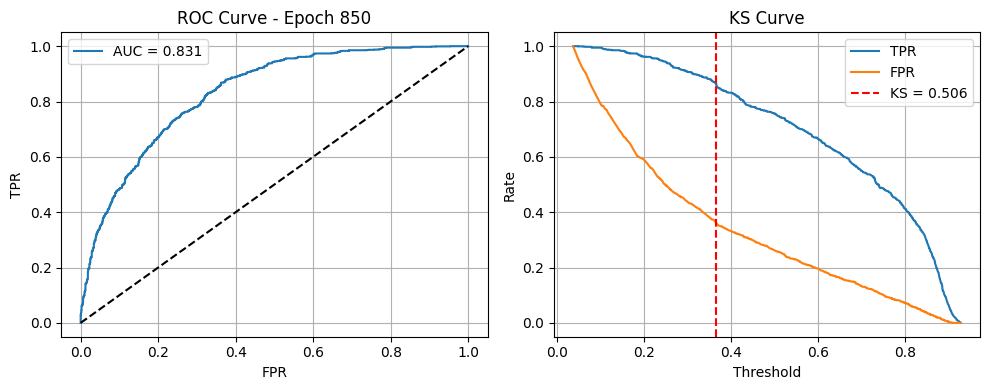

162/162 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step - accuracy: 0.7322 - loss: 0.5971 - val_accuracy: 0.7475 - val_loss: 0.5569
Epoch 851/1000
153/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7391 - loss: 0.5918Epoch 851 - ROC AUC: 0.8311 | KS: 0.5058
162/162 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - accuracy: 0.7386 - loss: 0.5923 - val_accuracy: 0.7475 - val_loss: 0.5568
Epoch 852/1000
149/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7380 - loss: 0.5830Epoch 852 - ROC AUC: 0.8311 | KS: 0.5058
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7377 - loss: 0.5837 - val_accuracy: 0.7475 - val_loss: 0.5568
Epoch 853/1000
153/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7283 - loss: 0.6020Epoch 853 - ROC AUC: 0.8311 | KS: 0.5050
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7287 - loss: 0.6017 - val_accuracy: 0.7475 - val_loss: 0.5568
Epoch 854/1000
158/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7395 - loss: 0.5816Epoch 854 - ROC AUC: 0.8312 | KS: 0.5050
162/162 ━━━

<Figure size 640x480 with 0 Axes>

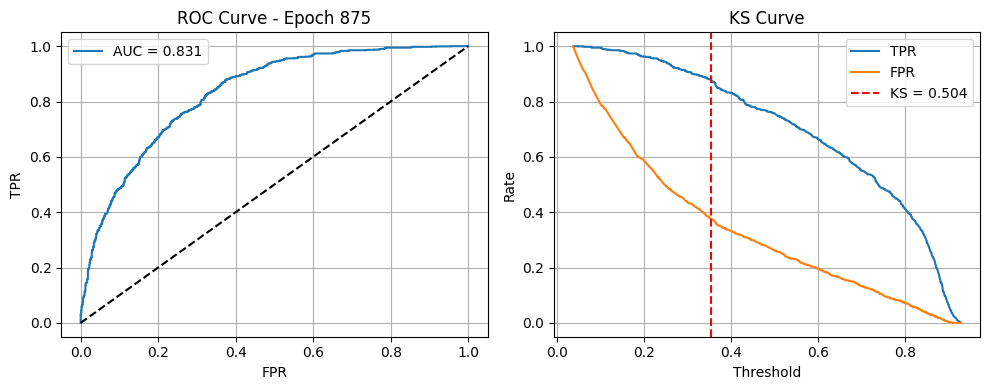

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - accuracy: 0.7389 - loss: 0.5837 - val_accuracy: 0.7479 - val_loss: 0.5564
Epoch 876/1000
155/162 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7346 - loss: 0.5870Epoch 876 - ROC AUC: 0.8313 | KS: 0.5043
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step - accuracy: 0.7347 - loss: 0.5872 - val_accuracy: 0.7479 - val_loss: 0.5564
Epoch 877/1000
150/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7429 - loss: 0.5794Epoch 877 - ROC AUC: 0.8313 | KS: 0.5043
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.7422 - loss: 0.5802 - val_accuracy: 0.7483 - val_loss: 0.5564
Epoch 878/1000
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7309 - loss: 0.5941Epoch 878 - ROC AUC: 0.8313 | KS: 0.5043
162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - accuracy: 0.7309 - loss: 0.5941 - val_accuracy: 0.7483 - val_loss: 0.5564
Epoch 879/1000
161/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7395 - loss: 0.5909Epoch 879 - ROC AUC: 0.8313 | KS: 0.5043
162/162 ━━

<Figure size 640x480 with 0 Axes>

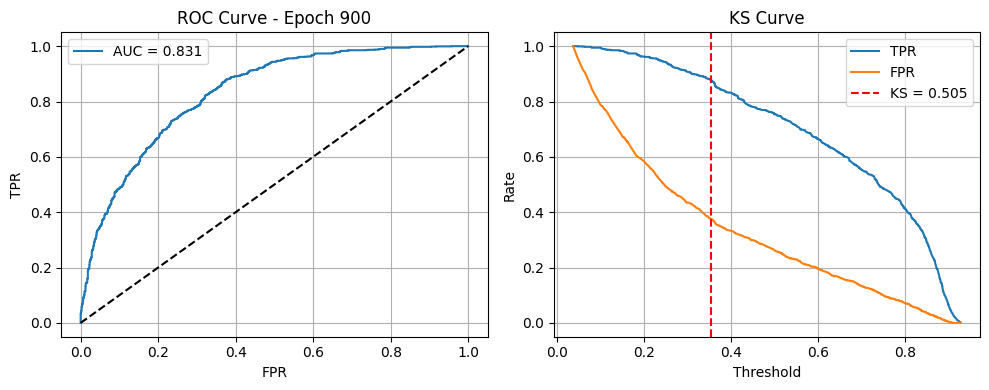

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - accuracy: 0.7339 - loss: 0.5847 - val_accuracy: 0.7463 - val_loss: 0.5560
Epoch 901/1000
157/162 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7179 - loss: 0.5914Epoch 901 - ROC AUC: 0.8315 | KS: 0.5050
162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 13ms/step - accuracy: 0.7182 - loss: 0.5915 - val_accuracy: 0.7459 - val_loss: 0.5560
Epoch 902/1000
152/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7248 - loss: 0.5983Epoch 902 - ROC AUC: 0.8315 | KS: 0.5050
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.7251 - loss: 0.5981 - val_accuracy: 0.7459 - val_loss: 0.5560
Epoch 903/1000
150/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7248 - loss: 0.5969Epoch 903 - ROC AUC: 0.8315 | KS: 0.5050
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7253 - loss: 0.5964 - val_accuracy: 0.7459 - val_loss: 0.5560
Epoch 904/1000
159/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7392 - loss: 0.6014Epoch 904 - ROC AUC: 0.8315 | KS: 0.5050
162/162 ━━

<Figure size 640x480 with 0 Axes>

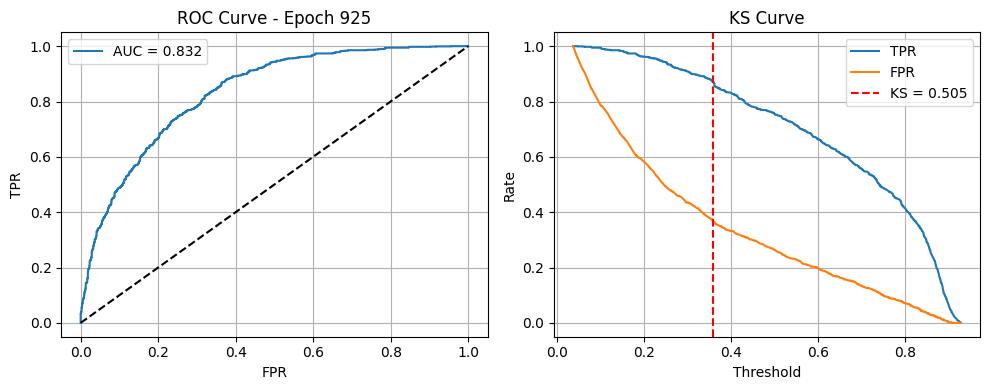

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step - accuracy: 0.7395 - loss: 0.5974 - val_accuracy: 0.7452 - val_loss: 0.5556
Epoch 926/1000
155/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7323 - loss: 0.5816Epoch 926 - ROC AUC: 0.8317 | KS: 0.5050
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.7323 - loss: 0.5819 - val_accuracy: 0.7459 - val_loss: 0.5556
Epoch 927/1000
158/162 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7306 - loss: 0.5881Epoch 927 - ROC AUC: 0.8317 | KS: 0.5050
162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - accuracy: 0.7308 - loss: 0.5881 - val_accuracy: 0.7459 - val_loss: 0.5556
Epoch 928/1000
155/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7353 - loss: 0.5974Epoch 928 - ROC AUC: 0.8317 | KS: 0.5043
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7353 - loss: 0.5971 - val_accuracy: 0.7459 - val_loss: 0.5556
Epoch 929/1000
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7170 - loss: 0.6121Epoch 929 - ROC AUC: 0.8317 | KS: 0.5050
162/162 ━

<Figure size 640x480 with 0 Axes>

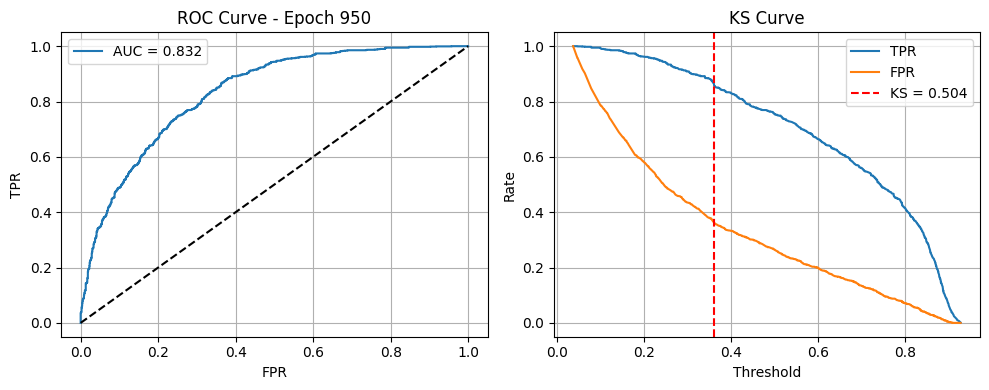

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - accuracy: 0.7295 - loss: 0.6020 - val_accuracy: 0.7448 - val_loss: 0.5553
Epoch 951/1000
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7295 - loss: 0.5954Epoch 951 - ROC AUC: 0.8318 | KS: 0.5043
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7296 - loss: 0.5954 - val_accuracy: 0.7448 - val_loss: 0.5552
Epoch 952/1000
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7283 - loss: 0.6084Epoch 952 - ROC AUC: 0.8318 | KS: 0.5043
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.7283 - loss: 0.6083 - val_accuracy: 0.7448 - val_loss: 0.5552
Epoch 953/1000
152/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7373 - loss: 0.5877Epoch 953 - ROC AUC: 0.8318 | KS: 0.5043
162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - accuracy: 0.7370 - loss: 0.5877 - val_accuracy: 0.7448 - val_loss: 0.5552
Epoch 954/1000
157/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7291 - loss: 0.5868Epoch 954 - ROC AUC: 0.8318 | KS: 0.5043
162/162 ━━━

<Figure size 640x480 with 0 Axes>

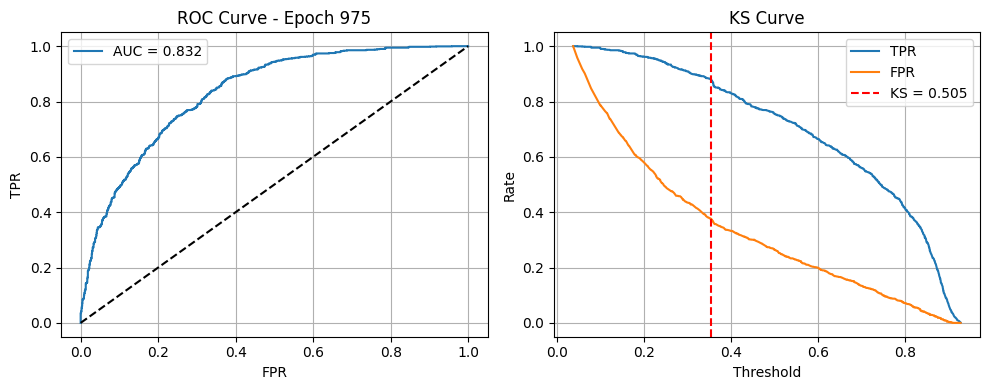

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 13ms/step - accuracy: 0.7385 - loss: 0.5910 - val_accuracy: 0.7455 - val_loss: 0.5549
Epoch 976/1000
150/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7196 - loss: 0.5879Epoch 976 - ROC AUC: 0.8319 | KS: 0.5050
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.7205 - loss: 0.5881 - val_accuracy: 0.7459 - val_loss: 0.5549
Epoch 977/1000
153/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7304 - loss: 0.5967Epoch 977 - ROC AUC: 0.8319 | KS: 0.5050
162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - accuracy: 0.7309 - loss: 0.5960 - val_accuracy: 0.7455 - val_loss: 0.5549
Epoch 978/1000
159/162 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7392 - loss: 0.5930Epoch 978 - ROC AUC: 0.8319 | KS: 0.5050
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.7392 - loss: 0.5928 - val_accuracy: 0.7455 - val_loss: 0.5549
Epoch 979/1000
155/162 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7379 - loss: 0.5846Epoch 979 - ROC AUC: 0.8320 | KS: 0.5050
162/162 ━━━

<Figure size 640x480 with 0 Axes>

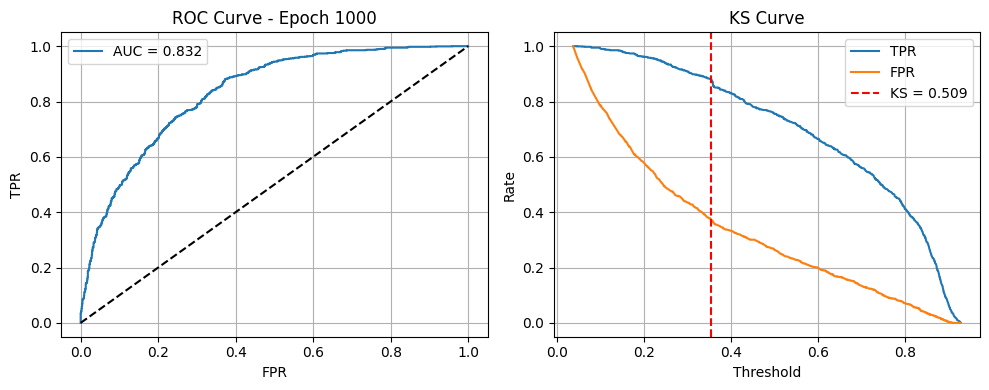

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step - accuracy: 0.7409 - loss: 0.5758 - val_accuracy: 0.7455 - val_loss: 0.5546


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


✅ Validação final — Loss: 0.5546, Accuracy: 0.7455


<Figure size 640x480 with 0 Axes>

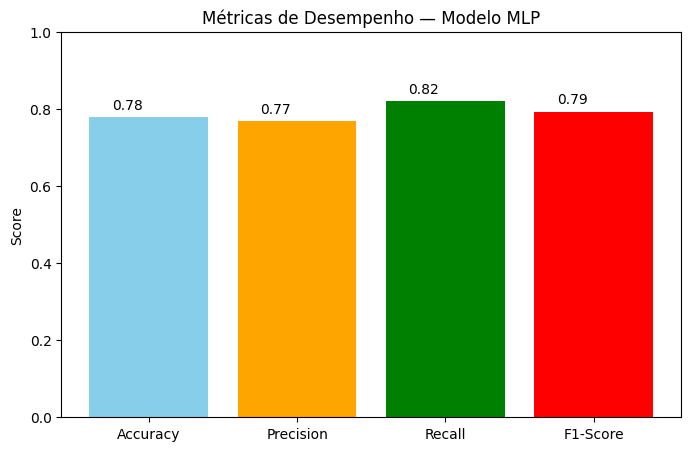

In [ ]:
from tensorflow.keras.regularizers import l2

# MLP com 2 camadas ocultas e regularização L2:
# - primeira camada com 40 neurônios, ativação tanh, L2=0.001
# - segunda camada com 10 neurônios, ativação tanh, L2=0.001
# Dropout de 30% após cada camada oculta para regularização adicional
# Camada de saída com 1 neurônio, ativação sigmoide para saída binária
# Otimizador Adadelta
# Loss binary_crossentropy
# Métrica acurácia
# Até 1000 épocas com early stopping, paciência de 10 para evitar overfitting precoce

model = Sequential([
    Dense(40, activation='tanh', kernel_regularizer=l2(0.001), input_shape=(X_train_nn.shape[1],)),
    Dropout(0.3),
    Dense(10, activation='tanh', kernel_regularizer=l2(0.001)),
    Dropout(0.3),
    Dense(1, activation='sigmoid')
])

model.compile(optimizer='Adadelta', loss='binary_crossentropy', metrics=['accuracy'])

early_stop = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

history = model.fit(
    X_train_nn, y_train_nn,
    validation_data=(X_val_nn, y_val_nn),
    epochs=1000,
    callbacks=[early_stop, RocKsCallback(X_val_nn, y_val_nn)],
    verbose=1,
    batch_size=32
)

model.save('nn_2camada_0.3dropout_1000epochs_adadelta.h5')
files.download('nn_2camada_0.3dropout_1000epochs_adadelta.h5')

# Avaliação
loss, acc = model.evaluate(X_val_nn, y_val_nn, verbose=0)
print(f"\n✅ Validação final — Loss: {loss:.4f}, Accuracy: {acc:.4f}")

metrics_names = ['Accuracy', 'Precision', 'Recall', 'F1-Score']
metrics_values = [
    model.evaluate(X_test_nn, y_test_nn, verbose=0)[1],  # accuracy from model
    precision,
    recall,
    f1
]

plt.figure(figsize=(8, 5))
bars = plt.bar(metrics_names, metrics_values, color=['skyblue', 'orange', 'green', 'red'])
plt.ylim(0, 1)
plt.title('Métricas de Desempenho — Modelo MLP')
plt.ylabel('Score')
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + 0.15, yval + 0.02, f'{yval:.2f}')
plt.show()


## TAB

### Experimentação 1

In [ ]:
# Uso do TabPFNClassifier para classificação tabular:
# - Modelo baseado em redes probabilísticas pré-treinadas
# - Detecta padrões complexos em dados tabulares com boa performance em datasets pequenos/médios
# - Usa GPU se disponível para acelerar o treino e predição
# - Não requer muita parametrização manual (usa 'ignore_pretraining_limits=True' para flexibilidade)
# - Realiza fit nos dados de treino e prediz no conjunto de validação
# - Avaliação com relatório detalhado e matriz de confusão para análise dos resultados

from tabpfn import TabPFNClassifier
import torch
from sklearn.metrics import classification_report, confusion_matrix

model = TabPFNClassifier(device='cuda' if torch.cuda.is_available() else 'cpu',
    ignore_pretraining_limits=True
)
model.fit(X_train_nn, y_train_nn)

y_pred = model.predict(X_val_nn)

print("📊 Relatório de Classificação:")
print(classification_report(y_val_nn, y_pred))

print("🧩 Matriz de Confusão:")
print(confusion_matrix(y_val_nn, y_pred))

📊 Relatório de Classificação:
              precision    recall  f1-score   support

           0       0.88      0.85      0.87      1291
           1       0.85      0.89      0.87      1291

    accuracy                           0.87      2582
   macro avg       0.87      0.87      0.87      2582
weighted avg       0.87      0.87      0.87      2582

🧩 Matriz de Confusão:
[[1093  198]
 [ 143 1148]]


In [ ]:
from sklearn.metrics import mean_squared_error, log_loss, confusion_matrix, roc_auc_score, accuracy_score, precision_score, recall_score, f1_score, roc_curve, auc
y_pred_proba = model.predict_proba(X_val_nn)[:, 1]

fpr, tpr, thresholds = roc_curve(y_val_nn, y_pred_proba)
ks_statistic = np.max(tpr - fpr)
ks_threshold = thresholds[np.argmax(tpr - fpr)]
y_pred_class = (y_pred_proba >= 0.5).astype(int)

acc = accuracy_score(y_val_nn, y_pred_class)
prec = precision_score(y_val_nn, y_pred_class)
rec = recall_score(y_val_nn, y_pred_class)
f1 = f1_score(y_val_nn, y_pred_class)


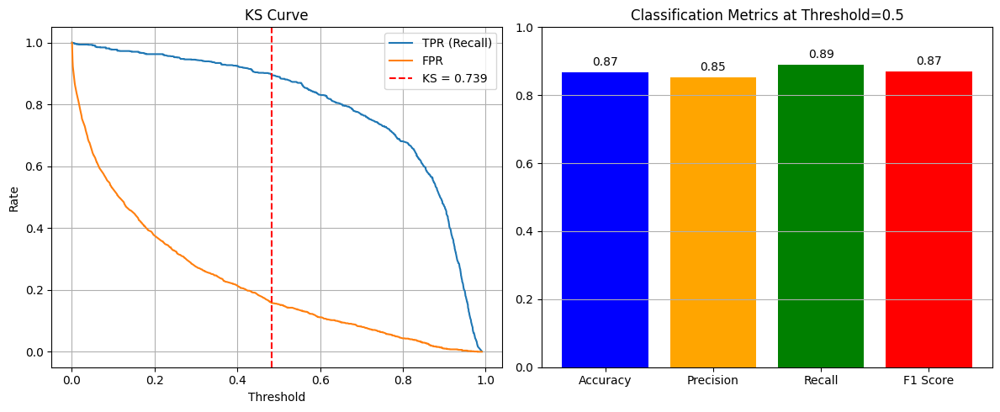

In [ ]:
plt.figure(figsize=(12,5))

# KS Curve subplot
plt.subplot(1,2,1)
plt.plot(thresholds, tpr, label='TPR (Recall)')
plt.plot(thresholds, fpr, label='FPR')
plt.axvline(ks_threshold, color='r', linestyle='--', label=f'KS = {ks_statistic:.3f}')
plt.xlabel('Threshold')
plt.ylabel('Rate')
plt.title('KS Curve')
plt.legend()
plt.grid(True)

# Bar plot of other metrics
plt.subplot(1,2,2)
metrics_names = ['Accuracy', 'Precision', 'Recall', 'F1 Score']
metrics_values = [acc, prec, rec, f1]
plt.bar(metrics_names, metrics_values, color=['blue', 'orange', 'green', 'red'])
plt.ylim(0,1)
plt.title('Classification Metrics at Threshold=0.5')
for i, v in enumerate(metrics_values):
    plt.text(i, v + 0.02, f"{v:.2f}", ha='center')
plt.grid(axis='y')

plt.tight_layout()
plt.show()


In [ ]:
import joblib
joblib.dump(model, 'tabpfn_model.pkl')
files.download('tabpfn_model.pkl')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Experimentação 2

In [ ]:
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, TensorDataset
import numpy as np
from sklearn.metrics import roc_curve, accuracy_score, precision_score, recall_score, f1_score
import matplotlib.pyplot as plt

def ks_statistic(y_true, y_pred_proba):
    fpr, tpr, thresholds = roc_curve(y_true, y_pred_proba)
    ks = np.max(np.abs(tpr - fpr))
    return ks

X_val_tensor = torch.tensor(X_val_nn, dtype=torch.float32)
y_val_tensor = torch.tensor(y_val_nn.values, dtype=torch.float32)
val_loader = DataLoader(TensorDataset(X_val_tensor, y_val_tensor), batch_size=32)


def plot_ks_curve(y_true, y_pred_proba, title="KS Curve"):
    fpr, tpr, thresholds = roc_curve(y_true, y_pred_proba)
    ks_statistic = np.max(np.abs(tpr - fpr))
    ks_threshold = thresholds[np.argmax(np.abs(tpr - fpr))]

    plt.figure(figsize=(6,6))
    plt.plot(thresholds, tpr, label='TPR (True Positive Rate)')
    plt.plot(thresholds, fpr, label='FPR (False Positive Rate)')
    plt.axvline(ks_threshold, color='r', linestyle='--', label=f'KS = {ks_statistic:.3f}')
    plt.xlabel('Threshold')
    plt.ylabel('Rate')
    plt.title(title)
    plt.legend()
    plt.grid(True)
    plt.show()

def evaluate_validation(model, val_loader, device, epoch=None):
    model.eval()
    all_preds_proba = []
    all_targets = []
    with torch.no_grad():
        for xb, yb in val_loader:
            xb = xb.to(device)
            preds = model(xb).squeeze().cpu().numpy()
            all_preds_proba.extend(preds)
            all_targets.extend(yb.numpy())

    all_preds_proba = np.array(all_preds_proba)
    all_targets = np.array(all_targets)

    if epoch is not None and epoch%25==0:
        plot_ks_curve(all_targets, all_preds_proba, title=f"KS Curve at Epoch {epoch+1}")

    ks = ks_statistic(all_targets, all_preds_proba)

    all_preds = (all_preds_proba >= 0.5).astype(int)
    acc = accuracy_score(all_targets, all_preds)
    prec = precision_score(all_targets, all_preds)
    rec = recall_score(all_targets, all_preds)
    f1 = f1_score(all_targets, all_preds)

    return ks, acc, prec, rec, f1

class STABTransformer(nn.Module):
    def __init__(self, input_dim, d_model=64, n_heads=4, n_layers=2, dropout=0.1):
        super(STABTransformer, self).__init__()
        self.input_proj = nn.Linear(input_dim, d_model)

        encoder_layer = nn.TransformerEncoderLayer(d_model=d_model, nhead=n_heads, dropout=dropout, batch_first=True)
        self.encoder = nn.TransformerEncoder(encoder_layer, num_layers=n_layers)

        self.head = nn.Sequential(
            nn.Linear(d_model, 64),
            nn.ReLU(),
            nn.Dropout(dropout),
            nn.Linear(64, 1),
            nn.Sigmoid()
        )

    def forward(self, x):
        # x shape: (batch_size, input_dim)
        x = self.input_proj(x).unsqueeze(1)  # shape: (batch_size, seq_len=1, d_model)
        x = self.encoder(x)                 # shape: (batch_size, 1, d_model)
        x = x.squeeze(1)                    # shape: (batch_size, d_model)
        return self.head(x)


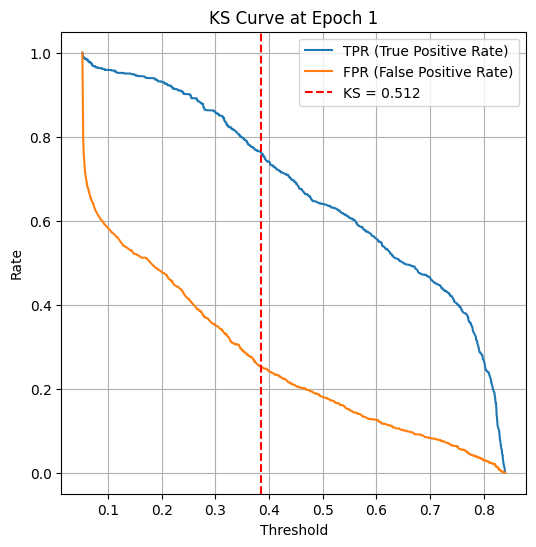

Epoch 000 — Train Loss: 0.5368 | Train Acc: 0.7361 | Val KS: 0.5120 | Val Acc: 0.7301 | Val Prec: 0.7807 | Val Recall: 0.6398 | Val F1: 0.7033
Epoch 010 — Train Loss: 0.4918 | Train Acc: 0.7600 | Val KS: 0.5314 | Val Acc: 0.7572 | Val Prec: 0.7416 | Val Recall: 0.7893 | Val F1: 0.7647
Epoch 020 — Train Loss: 0.4599 | Train Acc: 0.7793 | Val KS: 0.5407 | Val Acc: 0.7390 | Val Prec: 0.7802 | Val Recall: 0.6654 | Val F1: 0.7182


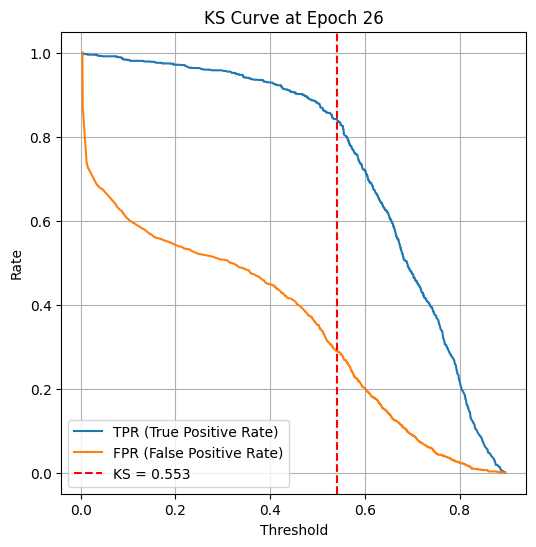

Epoch 030 — Train Loss: 0.4216 | Train Acc: 0.7923 | Val KS: 0.5523 | Val Acc: 0.7707 | Val Prec: 0.7456 | Val Recall: 0.8218 | Val F1: 0.7819
Epoch 040 — Train Loss: 0.3813 | Train Acc: 0.8136 | Val KS: 0.5577 | Val Acc: 0.7591 | Val Prec: 0.7591 | Val Recall: 0.7591 | Val F1: 0.7591


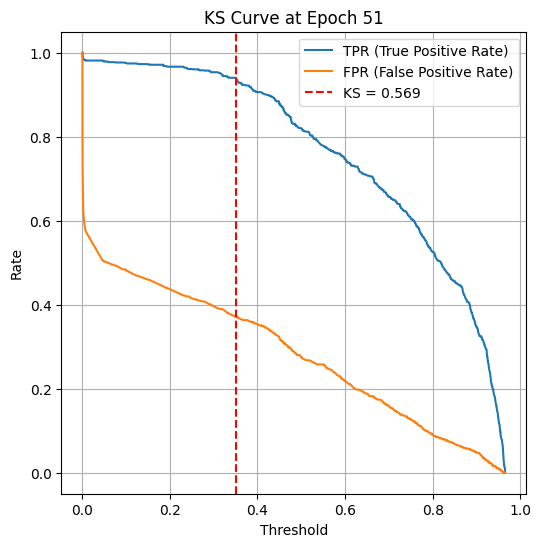

Epoch 050 — Train Loss: 0.3583 | Train Acc: 0.8268 | Val KS: 0.5693 | Val Acc: 0.7727 | Val Prec: 0.7489 | Val Recall: 0.8203 | Val F1: 0.7830
Epoch 060 — Train Loss: 0.3272 | Train Acc: 0.8444 | Val KS: 0.5500 | Val Acc: 0.7715 | Val Prec: 0.7237 | Val Recall: 0.8784 | Val F1: 0.7936
Epoch 070 — Train Loss: 0.3026 | Train Acc: 0.8549 | Val KS: 0.5670 | Val Acc: 0.7789 | Val Prec: 0.7400 | Val Recall: 0.8598 | Val F1: 0.7954


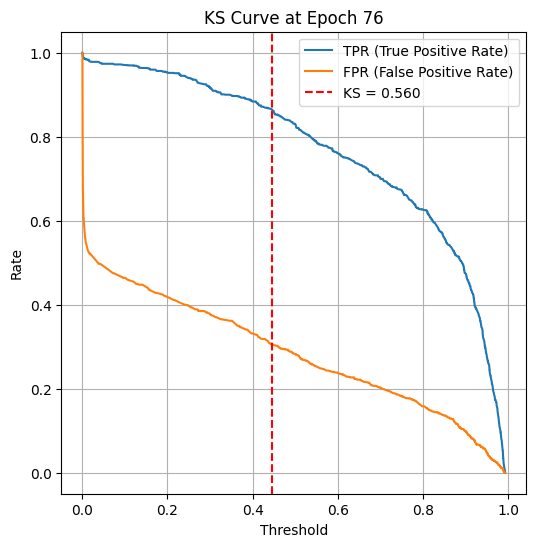

Epoch 080 — Train Loss: 0.2790 | Train Acc: 0.8652 | Val KS: 0.5624 | Val Acc: 0.7758 | Val Prec: 0.7386 | Val Recall: 0.8536 | Val F1: 0.7920
Epoch 090 — Train Loss: 0.2654 | Train Acc: 0.8747 | Val KS: 0.5662 | Val Acc: 0.7804 | Val Prec: 0.7312 | Val Recall: 0.8869 | Val F1: 0.8015
Epoch 099 — Train Loss: 0.2516 | Train Acc: 0.8863 | Val KS: 0.6026 | Val Acc: 0.7889 | Val Prec: 0.7759 | Val Recall: 0.8125 | Val F1: 0.7938


In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from torch.utils.data import TensorDataset, DataLoader
import torch.nn.functional as F

X_train_tensor = torch.tensor(X_train_nn, dtype=torch.float32)
y_train_tensor = torch.tensor(y_train_nn, dtype=torch.float32)


train_loader = DataLoader(TensorDataset(X_train_tensor, y_train_tensor), batch_size=32, shuffle=True)

# Model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = STABTransformer(input_dim=X_train_tensor.shape[1]).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
loss_fn = nn.BCELoss()

epochs=100
for epoch in range(epochs):
    model.train()
    epoch_loss = 0

    all_preds = []
    all_targets = []

    for xb, yb in train_loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).squeeze()
        loss = loss_fn(pred, yb)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()

        preds_np = (pred > 0.5).detach().cpu().numpy()
        targets_np = yb.detach().cpu().numpy()

        all_preds.extend(preds_np)
        all_targets.extend(targets_np)

    # Training metrics
    acc = accuracy_score(all_targets, all_preds)
    prec = precision_score(all_targets, all_preds)
    rec = recall_score(all_targets, all_preds)
    f1 = f1_score(all_targets, all_preds)

    # Validation metrics
    ks_val, acc_val, prec_val, rec_val, f1_val = evaluate_validation(model, val_loader, device, epoch)

    if epoch % 10 == 0 or epoch == epochs - 1:
        print(f"Epoch {epoch:03d} — Train Loss: {epoch_loss/len(train_loader):.4f} | "
              f"Train Acc: {acc:.4f} | Val KS: {ks_val:.4f} | Val Acc: {acc_val:.4f} | "
              f"Val Prec: {prec_val:.4f} | Val Recall: {rec_val:.4f} | Val F1: {f1_val:.4f}")


In [ ]:
model.eval()
X_test_tensor = torch.tensor(X_test_nn, dtype=torch.float32)
y_test_tensor = torch.tensor(y_test_nn.values, dtype=torch.float32)  # <-- Aqui está o fix

with torch.no_grad():
    y_pred_prob = model(X_test_tensor.to(device)).cpu().squeeze().numpy()
    y_pred = (y_pred_prob >= 0.5).astype(int)


# Save model weights
torch.save(model.state_dict(), 'stab_transformer_4head_2layer_0.1droput.pt')
files.download('stab_transformer_4head_2layer_0.1droput.pt')


acc = accuracy_score(y_test_nn, y_pred)
prec = precision_score(y_test_nn, y_pred)
rec = recall_score(y_test_nn, y_pred)
f1 = f1_score(y_test_nn, y_pred)

print(f"✅ Accuracy: {acc:.4f}")
print(f"✅ Precision: {prec:.4f}")
print(f"✅ Recall: {rec:.4f}")
print(f"✅ F1 Score: {f1:.4f}")


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

✅ Accuracy: 0.8180
✅ Precision: 0.8003
✅ Recall: 0.8474
✅ F1 Score: 0.8232


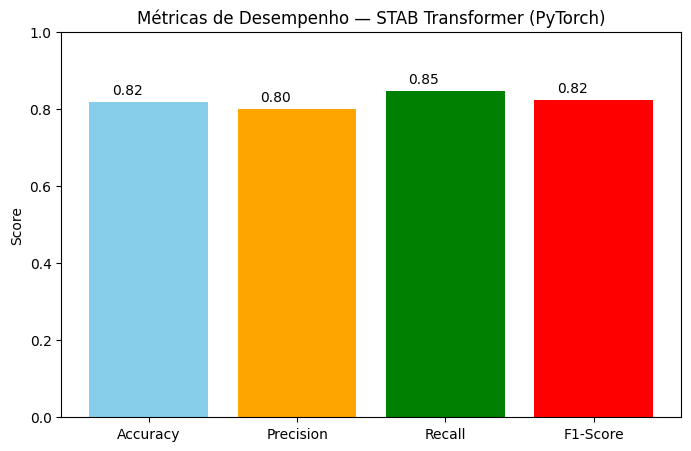

In [ ]:
metrics_names = ['Accuracy', 'Precision', 'Recall', 'F1-Score']
metrics_values = [acc, prec, rec, f1]

plt.figure(figsize=(8, 5))
bars = plt.bar(metrics_names, metrics_values, color=['skyblue', 'orange', 'green', 'red'])
plt.ylim(0, 1)
plt.title('Métricas de Desempenho — STAB Transformer (PyTorch)')
plt.ylabel('Score')
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + 0.15, yval + 0.02, f'{yval:.2f}')
plt.show()


### Experimentação 3

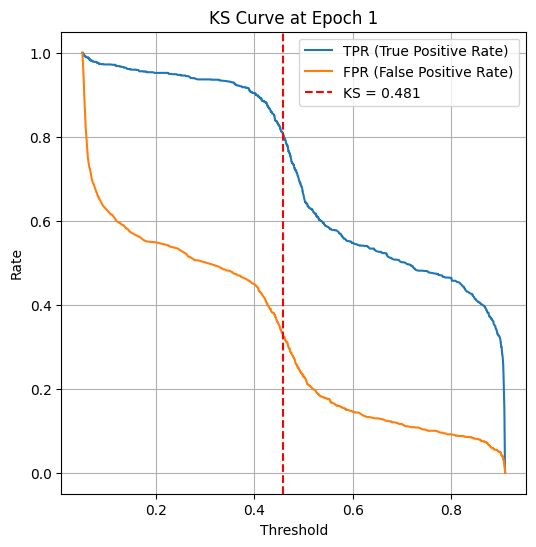

Epoch 000 — Train Loss: 0.5517 | Train Acc: 0.7342 | Val KS: 0.4810 | Val Acc: 0.7157 | Val Prec: 0.7424 | Val Recall: 0.6607 | Val F1: 0.6992
Epoch 010 — Train Loss: 0.5256 | Train Acc: 0.7540 | Val KS: 0.5027 | Val Acc: 0.7421 | Val Prec: 0.7351 | Val Recall: 0.7568 | Val F1: 0.7458
Epoch 020 — Train Loss: 0.5093 | Train Acc: 0.7551 | Val KS: 0.5074 | Val Acc: 0.7409 | Val Prec: 0.7704 | Val Recall: 0.6863 | Val F1: 0.7259


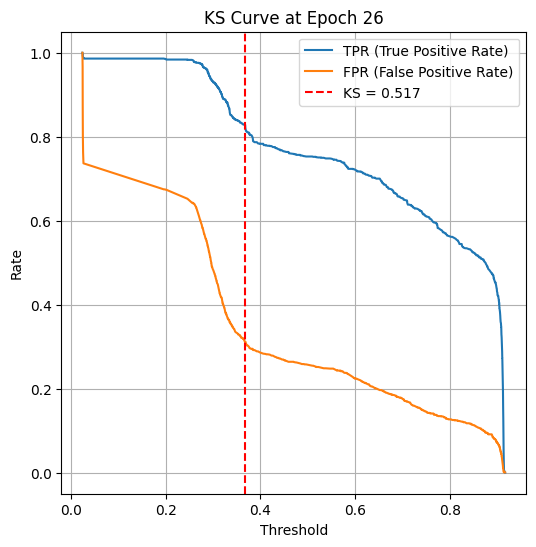

Epoch 030 — Train Loss: 0.4967 | Train Acc: 0.7606 | Val KS: 0.5112 | Val Acc: 0.7517 | Val Prec: 0.7444 | Val Recall: 0.7668 | Val F1: 0.7554
Epoch 040 — Train Loss: 0.5070 | Train Acc: 0.7549 | Val KS: 0.5151 | Val Acc: 0.7463 | Val Prec: 0.7275 | Val Recall: 0.7878 | Val F1: 0.7564


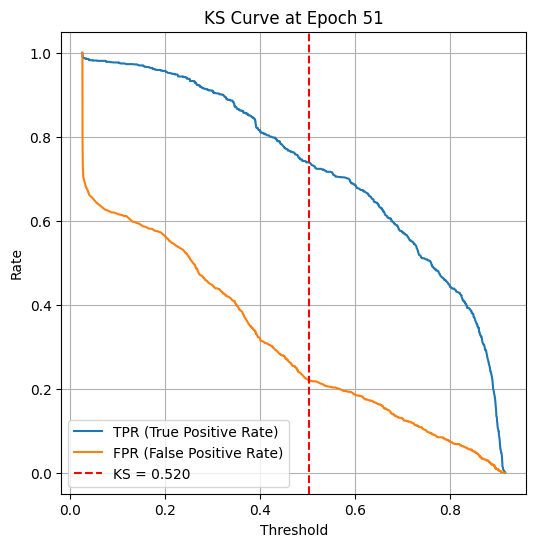

Epoch 050 — Train Loss: 0.4896 | Train Acc: 0.7666 | Val KS: 0.5198 | Val Acc: 0.7591 | Val Prec: 0.7700 | Val Recall: 0.7390 | Val F1: 0.7542
Epoch 060 — Train Loss: 0.4924 | Train Acc: 0.7685 | Val KS: 0.5167 | Val Acc: 0.7525 | Val Prec: 0.7447 | Val Recall: 0.7684 | Val F1: 0.7564
Epoch 070 — Train Loss: 0.4882 | Train Acc: 0.7654 | Val KS: 0.5213 | Val Acc: 0.7568 | Val Prec: 0.7356 | Val Recall: 0.8017 | Val F1: 0.7672


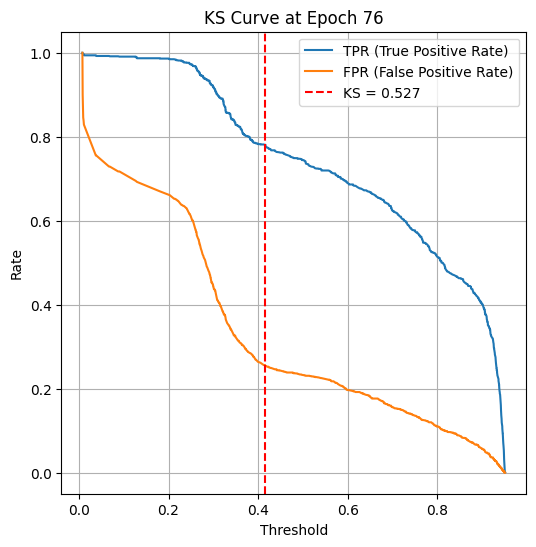

Epoch 080 — Train Loss: 0.4855 | Train Acc: 0.7701 | Val KS: 0.5244 | Val Acc: 0.7583 | Val Prec: 0.7653 | Val Recall: 0.7452 | Val F1: 0.7551
Epoch 090 — Train Loss: 0.4827 | Train Acc: 0.7726 | Val KS: 0.5345 | Val Acc: 0.7622 | Val Prec: 0.7311 | Val Recall: 0.8296 | Val F1: 0.7772


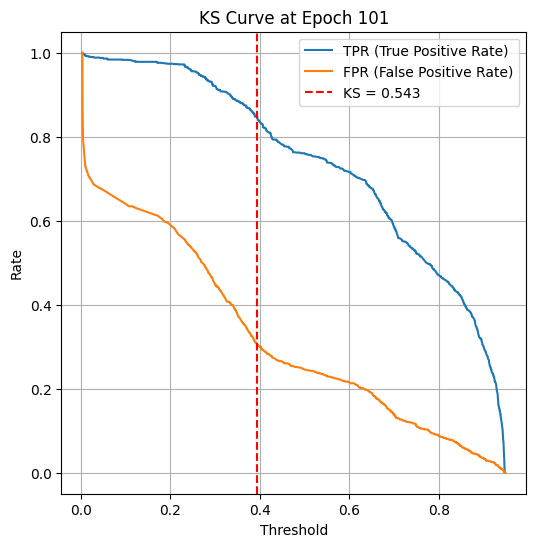

Epoch 100 — Train Loss: 0.4778 | Train Acc: 0.7722 | Val KS: 0.5430 | Val Acc: 0.7576 | Val Prec: 0.7560 | Val Recall: 0.7607 | Val F1: 0.7583
Epoch 110 — Train Loss: 0.4956 | Train Acc: 0.7580 | Val KS: 0.5012 | Val Acc: 0.7409 | Val Prec: 0.7331 | Val Recall: 0.7576 | Val F1: 0.7451
Epoch 120 — Train Loss: 0.4815 | Train Acc: 0.7699 | Val KS: 0.5290 | Val Acc: 0.7591 | Val Prec: 0.7377 | Val Recall: 0.8040 | Val F1: 0.7695


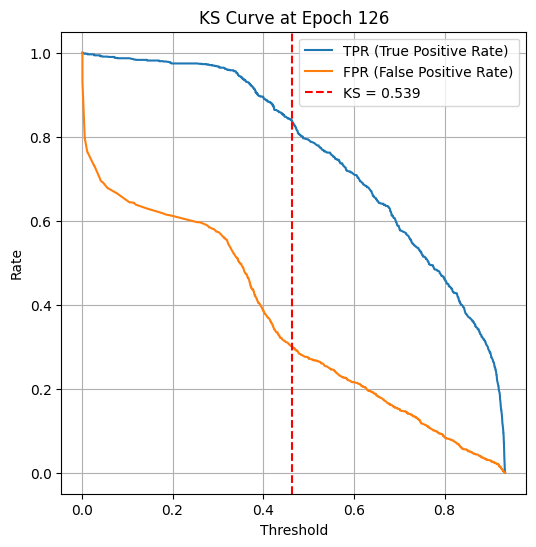

Epoch 130 — Train Loss: 0.4789 | Train Acc: 0.7733 | Val KS: 0.5314 | Val Acc: 0.7521 | Val Prec: 0.7653 | Val Recall: 0.7273 | Val F1: 0.7458
Epoch 140 — Train Loss: 0.4711 | Train Acc: 0.7728 | Val KS: 0.5205 | Val Acc: 0.7548 | Val Prec: 0.7658 | Val Recall: 0.7343 | Val F1: 0.7497


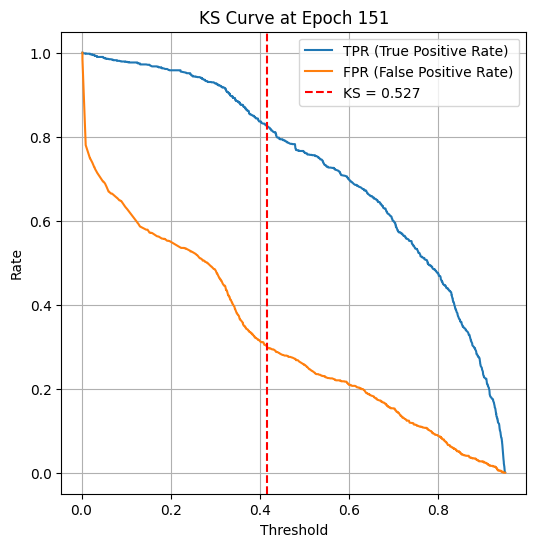

Epoch 150 — Train Loss: 0.4724 | Train Acc: 0.7778 | Val KS: 0.5275 | Val Acc: 0.7529 | Val Prec: 0.7479 | Val Recall: 0.7630 | Val F1: 0.7554
Epoch 160 — Train Loss: 0.4772 | Train Acc: 0.7737 | Val KS: 0.5198 | Val Acc: 0.7533 | Val Prec: 0.7366 | Val Recall: 0.7885 | Val F1: 0.7617
Epoch 170 — Train Loss: 0.4634 | Train Acc: 0.7747 | Val KS: 0.5376 | Val Acc: 0.7637 | Val Prec: 0.7498 | Val Recall: 0.7916 | Val F1: 0.7702


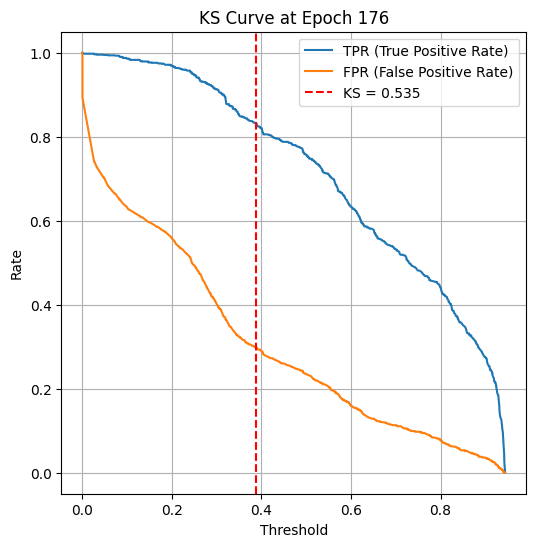

Epoch 180 — Train Loss: 0.4617 | Train Acc: 0.7745 | Val KS: 0.5314 | Val Acc: 0.7626 | Val Prec: 0.7260 | Val Recall: 0.8435 | Val F1: 0.7804
Epoch 190 — Train Loss: 0.4628 | Train Acc: 0.7755 | Val KS: 0.5314 | Val Acc: 0.7634 | Val Prec: 0.7564 | Val Recall: 0.7769 | Val F1: 0.7665


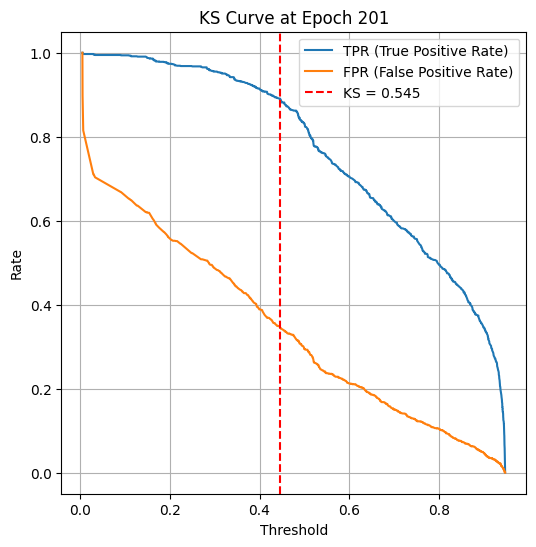

Epoch 200 — Train Loss: 0.4600 | Train Acc: 0.7720 | Val KS: 0.5453 | Val Acc: 0.7676 | Val Prec: 0.7378 | Val Recall: 0.8304 | Val F1: 0.7813
Epoch 210 — Train Loss: 0.4584 | Train Acc: 0.7747 | Val KS: 0.5012 | Val Acc: 0.7479 | Val Prec: 0.7165 | Val Recall: 0.8203 | Val F1: 0.7649
Epoch 220 — Train Loss: 0.4666 | Train Acc: 0.7697 | Val KS: 0.5306 | Val Acc: 0.7537 | Val Prec: 0.7321 | Val Recall: 0.8002 | Val F1: 0.7646


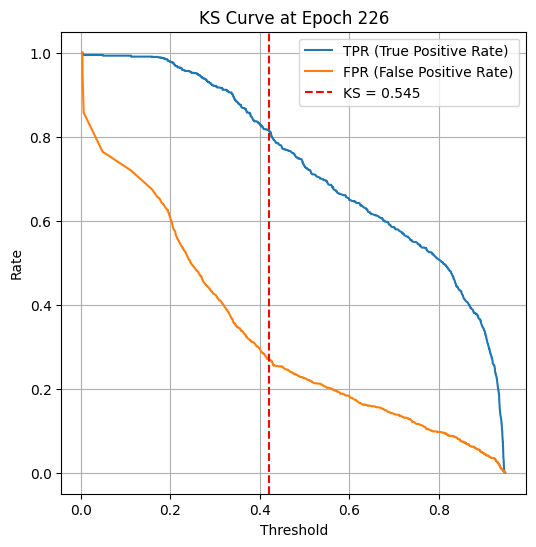

Epoch 230 — Train Loss: 0.4454 | Train Acc: 0.7861 | Val KS: 0.5531 | Val Acc: 0.7676 | Val Prec: 0.7339 | Val Recall: 0.8397 | Val F1: 0.7832
Epoch 240 — Train Loss: 0.4440 | Train Acc: 0.7813 | Val KS: 0.5461 | Val Acc: 0.7614 | Val Prec: 0.7480 | Val Recall: 0.7885 | Val F1: 0.7677


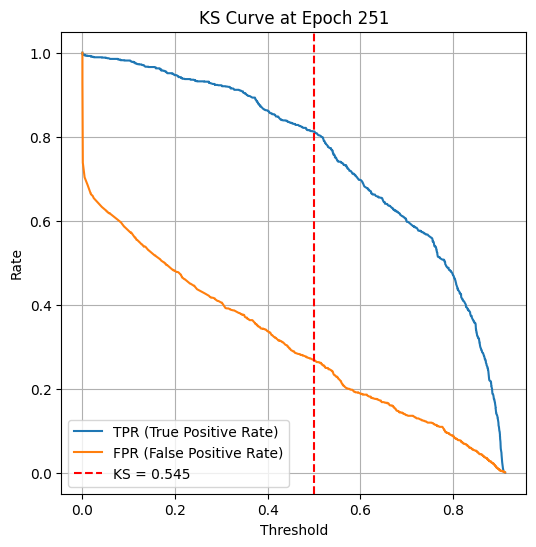

Epoch 250 — Train Loss: 0.4437 | Train Acc: 0.7846 | Val KS: 0.5453 | Val Acc: 0.7727 | Val Prec: 0.7525 | Val Recall: 0.8125 | Val F1: 0.7814
Epoch 260 — Train Loss: 0.4309 | Train Acc: 0.7983 | Val KS: 0.5445 | Val Acc: 0.7649 | Val Prec: 0.7485 | Val Recall: 0.7978 | Val F1: 0.7724
Epoch 270 — Train Loss: 0.4346 | Train Acc: 0.7916 | Val KS: 0.5453 | Val Acc: 0.7707 | Val Prec: 0.7446 | Val Recall: 0.8242 | Val F1: 0.7824


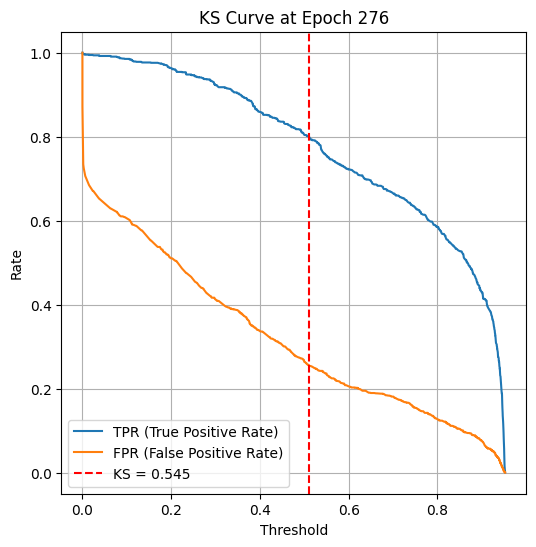

Epoch 280 — Train Loss: 0.4366 | Train Acc: 0.7960 | Val KS: 0.5259 | Val Acc: 0.7548 | Val Prec: 0.7452 | Val Recall: 0.7746 | Val F1: 0.7596
Epoch 290 — Train Loss: 0.4201 | Train Acc: 0.8012 | Val KS: 0.5531 | Val Acc: 0.7680 | Val Prec: 0.7674 | Val Recall: 0.7692 | Val F1: 0.7683


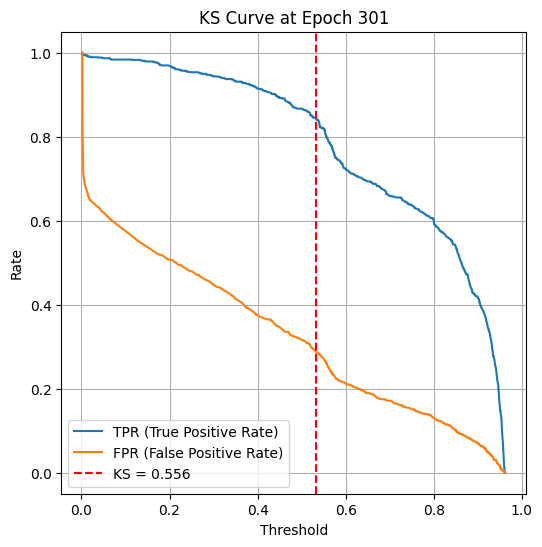

Epoch 300 — Train Loss: 0.4237 | Train Acc: 0.8024 | Val KS: 0.5562 | Val Acc: 0.7758 | Val Prec: 0.7333 | Val Recall: 0.8668 | Val F1: 0.7945
Epoch 310 — Train Loss: 0.4231 | Train Acc: 0.8059 | Val KS: 0.5329 | Val Acc: 0.7610 | Val Prec: 0.7262 | Val Recall: 0.8381 | Val F1: 0.7781
Epoch 320 — Train Loss: 0.4066 | Train Acc: 0.8098 | Val KS: 0.5507 | Val Acc: 0.7672 | Val Prec: 0.7717 | Val Recall: 0.7591 | Val F1: 0.7653


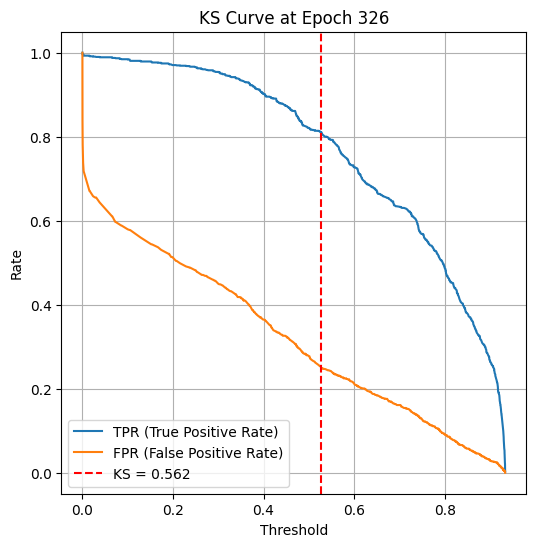

Epoch 330 — Train Loss: 0.3907 | Train Acc: 0.8160 | Val KS: 0.5585 | Val Acc: 0.7765 | Val Prec: 0.7390 | Val Recall: 0.8552 | Val F1: 0.7928
Epoch 340 — Train Loss: 0.3936 | Train Acc: 0.8160 | Val KS: 0.5593 | Val Acc: 0.7792 | Val Prec: 0.7454 | Val Recall: 0.8482 | Val F1: 0.7935


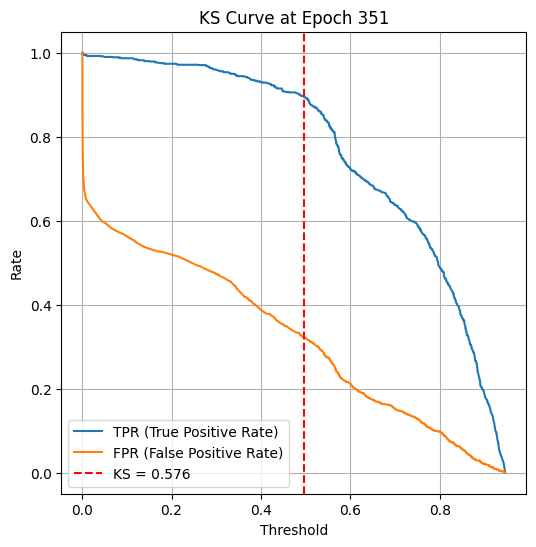

Epoch 350 — Train Loss: 0.3778 | Train Acc: 0.8239 | Val KS: 0.5755 | Val Acc: 0.7862 | Val Prec: 0.7358 | Val Recall: 0.8931 | Val F1: 0.8069
Epoch 360 — Train Loss: 0.3767 | Train Acc: 0.8233 | Val KS: 0.5647 | Val Acc: 0.7804 | Val Prec: 0.7257 | Val Recall: 0.9016 | Val F1: 0.8041
Epoch 370 — Train Loss: 0.3519 | Train Acc: 0.8367 | Val KS: 0.5724 | Val Acc: 0.7858 | Val Prec: 0.7566 | Val Recall: 0.8428 | Val F1: 0.7974


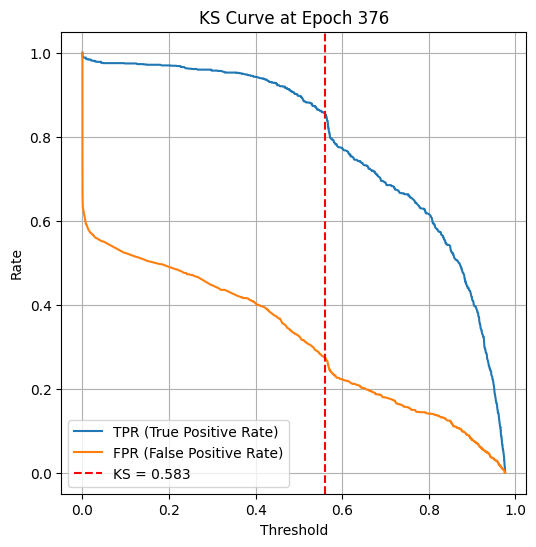

Epoch 380 — Train Loss: 0.3451 | Train Acc: 0.8396 | Val KS: 0.5755 | Val Acc: 0.7870 | Val Prec: 0.7349 | Val Recall: 0.8978 | Val F1: 0.8082
Epoch 390 — Train Loss: 0.3414 | Train Acc: 0.8419 | Val KS: 0.5871 | Val Acc: 0.7897 | Val Prec: 0.7544 | Val Recall: 0.8590 | Val F1: 0.8033


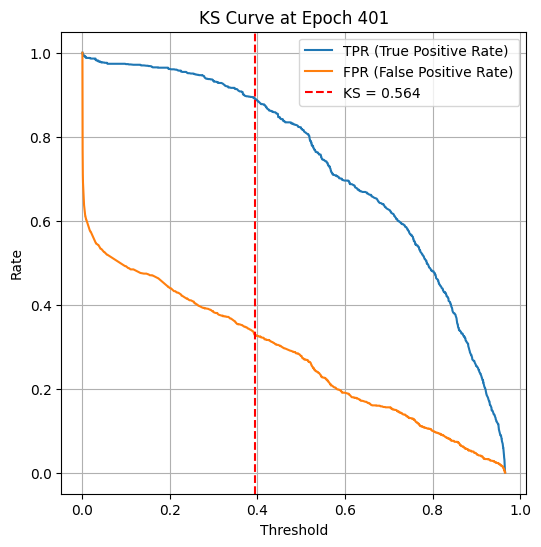

Epoch 400 — Train Loss: 0.3255 | Train Acc: 0.8537 | Val KS: 0.5639 | Val Acc: 0.7711 | Val Prec: 0.7468 | Val Recall: 0.8203 | Val F1: 0.7818
Epoch 410 — Train Loss: 0.3146 | Train Acc: 0.8551 | Val KS: 0.5918 | Val Acc: 0.7854 | Val Prec: 0.7458 | Val Recall: 0.8660 | Val F1: 0.8014
Epoch 420 — Train Loss: 0.3134 | Train Acc: 0.8559 | Val KS: 0.5833 | Val Acc: 0.7862 | Val Prec: 0.7349 | Val Recall: 0.8954 | Val F1: 0.8073


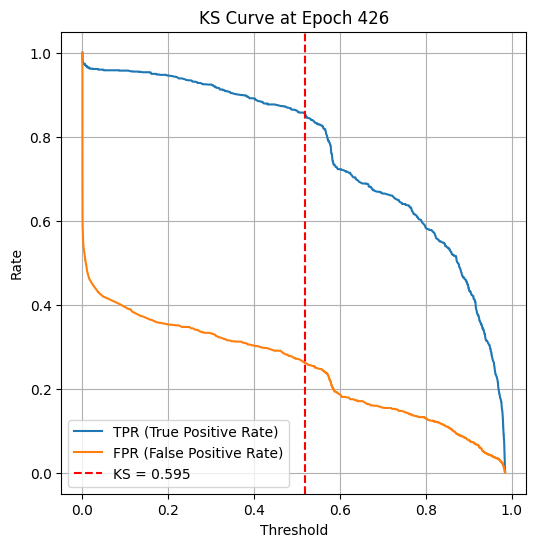

Epoch 430 — Train Loss: 0.2968 | Train Acc: 0.8642 | Val KS: 0.5988 | Val Acc: 0.7920 | Val Prec: 0.7503 | Val Recall: 0.8753 | Val F1: 0.8080
Epoch 440 — Train Loss: 0.3068 | Train Acc: 0.8657 | Val KS: 0.5809 | Val Acc: 0.7870 | Val Prec: 0.7389 | Val Recall: 0.8877 | Val F1: 0.8065


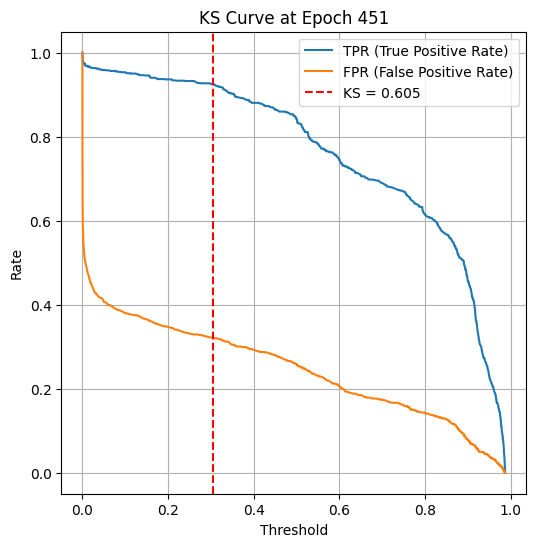

Epoch 450 — Train Loss: 0.2949 | Train Acc: 0.8648 | Val KS: 0.6050 | Val Acc: 0.7916 | Val Prec: 0.7650 | Val Recall: 0.8420 | Val F1: 0.8016
Epoch 460 — Train Loss: 0.2938 | Train Acc: 0.8723 | Val KS: 0.5972 | Val Acc: 0.7823 | Val Prec: 0.7666 | Val Recall: 0.8118 | Val F1: 0.7886
Epoch 470 — Train Loss: 0.2875 | Train Acc: 0.8708 | Val KS: 0.6065 | Val Acc: 0.7932 | Val Prec: 0.7522 | Val Recall: 0.8745 | Val F1: 0.8087


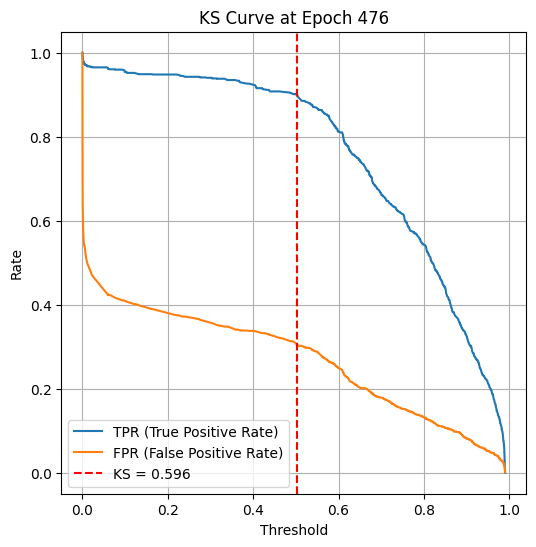

Epoch 480 — Train Loss: 0.2822 | Train Acc: 0.8683 | Val KS: 0.6057 | Val Acc: 0.7940 | Val Prec: 0.7313 | Val Recall: 0.9295 | Val F1: 0.8186
Epoch 490 — Train Loss: 0.2733 | Train Acc: 0.8783 | Val KS: 0.6081 | Val Acc: 0.8036 | Val Prec: 0.7569 | Val Recall: 0.8947 | Val F1: 0.8200
Epoch 499 — Train Loss: 0.2628 | Train Acc: 0.8789 | Val KS: 0.5918 | Val Acc: 0.7932 | Val Prec: 0.7329 | Val Recall: 0.9225 | Val F1: 0.8169


In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from torch.utils.data import TensorDataset, DataLoader
import torch.nn.functional as F

X_train_tensor = torch.tensor(X_train_nn, dtype=torch.float32)
y_train_tensor = torch.tensor(y_train_nn, dtype=torch.float32)


train_loader = DataLoader(TensorDataset(X_train_tensor, y_train_tensor), batch_size=32, shuffle=True)

# Model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = STABTransformer(input_dim=X_train_tensor.shape[1], n_heads=8, n_layers=3, dropout=0.3).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
loss_fn = nn.BCELoss()
loss_fn = nn.BCELoss()

epochs=500
for epoch in range(epochs):
    model.train()
    epoch_loss = 0

    all_preds = []
    all_targets = []

    for xb, yb in train_loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).squeeze()
        loss = loss_fn(pred, yb)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()

        preds_np = (pred > 0.5).detach().cpu().numpy()
        targets_np = yb.detach().cpu().numpy()

        all_preds.extend(preds_np)
        all_targets.extend(targets_np)

    # Training metrics
    acc = accuracy_score(all_targets, all_preds)
    prec = precision_score(all_targets, all_preds)
    rec = recall_score(all_targets, all_preds)
    f1 = f1_score(all_targets, all_preds)

    # Validation metrics
    ks_val, acc_val, prec_val, rec_val, f1_val = evaluate_validation(model, val_loader, device, epoch)

    if epoch % 10 == 0 or epoch == epochs - 1:
        print(f"Epoch {epoch:03d} — Train Loss: {epoch_loss/len(train_loader):.4f} | "
              f"Train Acc: {acc:.4f} | Val KS: {ks_val:.4f} | Val Acc: {acc_val:.4f} | "
              f"Val Prec: {prec_val:.4f} | Val Recall: {rec_val:.4f} | Val F1: {f1_val:.4f}")



In [ ]:

torch.save(model.state_dict(), 'stab_transformer_8head_3layer_0.3droput_500epochs.pt')
files.download('stab_transformer_8head_3layer_0.3droput_500epochs.pt')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

✅ Accuracy: 0.8160
✅ Precision: 0.7540
✅ Recall: 0.9380
✅ F1 Score: 0.8360


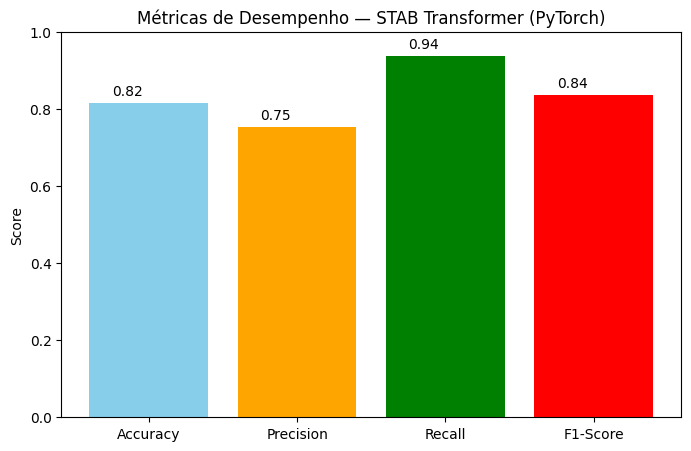

In [ ]:
model.eval()
X_test_tensor = torch.tensor(X_test_nn, dtype=torch.float32)
y_test_tensor = torch.tensor(y_test_nn.values, dtype=torch.float32)  # <-- Aqui está o fix

with torch.no_grad():
    y_pred_prob = model(X_test_tensor.to(device)).cpu().squeeze().numpy()
    y_pred = (y_pred_prob >= 0.5).astype(int)


# Save model weights
torch.save(model.state_dict(), 'stab_transformer_4head_2layer_0.1droput.pt')
files.download('stab_transformer_4head_2layer_0.1droput.pt')


acc = accuracy_score(y_test_nn, y_pred)
prec = precision_score(y_test_nn, y_pred)
rec = recall_score(y_test_nn, y_pred)
f1 = f1_score(y_test_nn, y_pred)

print(f"✅ Accuracy: {acc:.4f}")
print(f"✅ Precision: {prec:.4f}")
print(f"✅ Recall: {rec:.4f}")
print(f"✅ F1 Score: {f1:.4f}")

metrics_names = ['Accuracy', 'Precision', 'Recall', 'F1-Score']
metrics_values = [acc, prec, rec, f1]

plt.figure(figsize=(8, 5))
bars = plt.bar(metrics_names, metrics_values, color=['skyblue', 'orange', 'green', 'red'])
plt.ylim(0, 1)
plt.title('Métricas de Desempenho — STAB Transformer (PyTorch)')
plt.ylabel('Score')
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + 0.15, yval + 0.02, f'{yval:.2f}')
plt.show()



### Experimentação 4

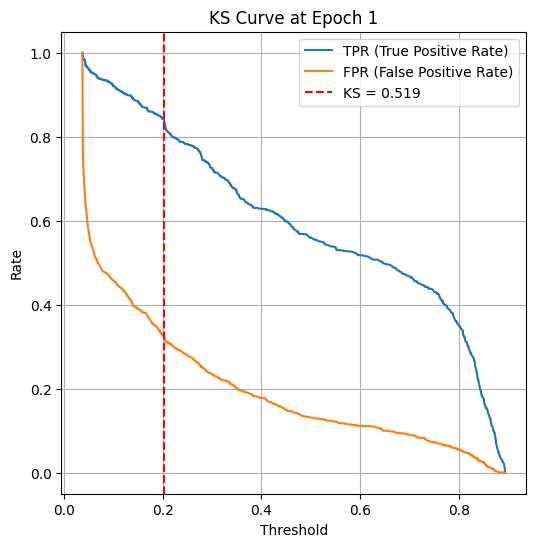

Epoch 000 — Train Loss: 0.5404 | Train Acc: 0.7383 | Val KS: 0.5190 | Val Acc: 0.7146 | Val Prec: 0.8105 | Val Recall: 0.5600 | Val F1: 0.6624
Epoch 010 — Train Loss: 0.5056 | Train Acc: 0.7617 | Val KS: 0.5190 | Val Acc: 0.7502 | Val Prec: 0.7212 | Val Recall: 0.8156 | Val F1: 0.7655
Epoch 020 — Train Loss: 0.4891 | Train Acc: 0.7679 | Val KS: 0.5190 | Val Acc: 0.7521 | Val Prec: 0.7453 | Val Recall: 0.7661 | Val F1: 0.7555


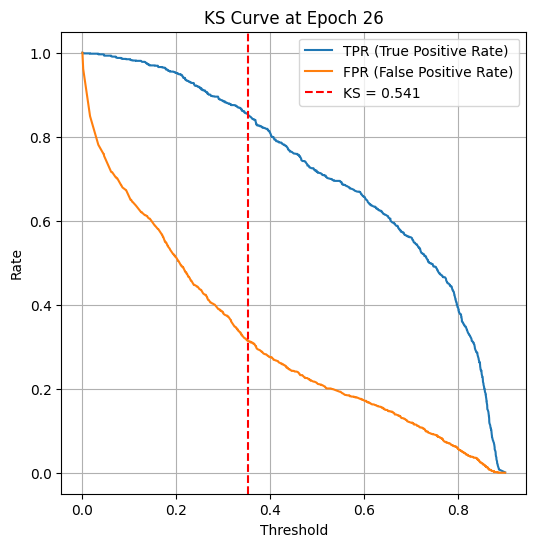

Epoch 030 — Train Loss: 0.4764 | Train Acc: 0.7706 | Val KS: 0.5213 | Val Acc: 0.7521 | Val Prec: 0.7561 | Val Recall: 0.7444 | Val F1: 0.7502
Epoch 040 — Train Loss: 0.4688 | Train Acc: 0.7722 | Val KS: 0.5422 | Val Acc: 0.7541 | Val Prec: 0.7433 | Val Recall: 0.7761 | Val F1: 0.7594


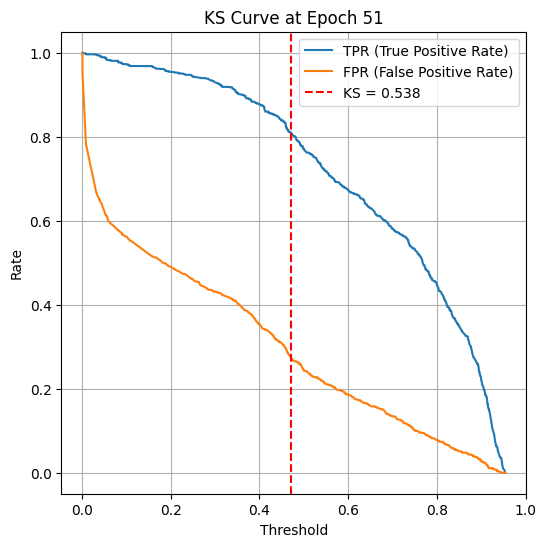

Epoch 050 — Train Loss: 0.4455 | Train Acc: 0.7828 | Val KS: 0.5376 | Val Acc: 0.7645 | Val Prec: 0.7605 | Val Recall: 0.7723 | Val F1: 0.7663
Epoch 060 — Train Loss: 0.4323 | Train Acc: 0.7904 | Val KS: 0.5337 | Val Acc: 0.7599 | Val Prec: 0.7686 | Val Recall: 0.7436 | Val F1: 0.7559
Epoch 070 — Train Loss: 0.4123 | Train Acc: 0.8067 | Val KS: 0.5600 | Val Acc: 0.7758 | Val Prec: 0.7380 | Val Recall: 0.8552 | Val F1: 0.7922


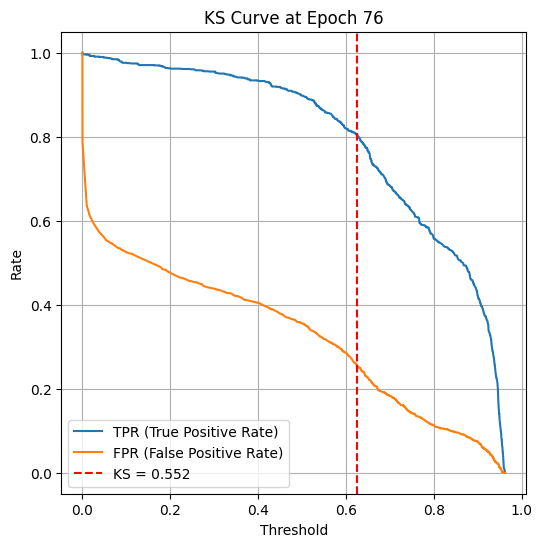

Epoch 080 — Train Loss: 0.4006 | Train Acc: 0.8164 | Val KS: 0.5407 | Val Acc: 0.7684 | Val Prec: 0.7225 | Val Recall: 0.8714 | Val F1: 0.7900
Epoch 090 — Train Loss: 0.3786 | Train Acc: 0.8276 | Val KS: 0.5716 | Val Acc: 0.7823 | Val Prec: 0.7468 | Val Recall: 0.8544 | Val F1: 0.7970


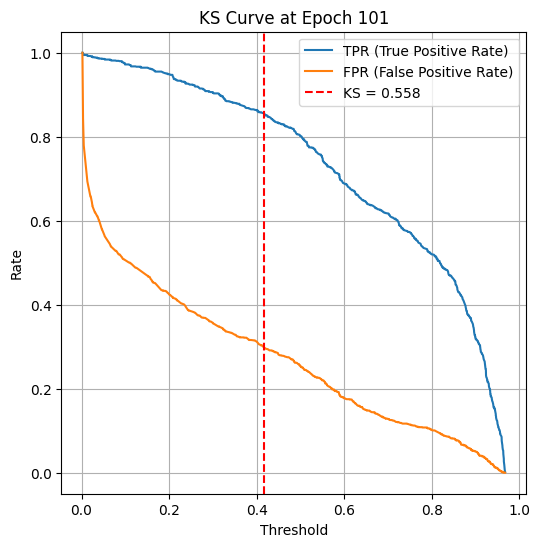

Epoch 100 — Train Loss: 0.3731 | Train Acc: 0.8311 | Val KS: 0.5585 | Val Acc: 0.7738 | Val Prec: 0.7594 | Val Recall: 0.8017 | Val F1: 0.7800
Epoch 110 — Train Loss: 0.3569 | Train Acc: 0.8353 | Val KS: 0.5538 | Val Acc: 0.7703 | Val Prec: 0.7162 | Val Recall: 0.8954 | Val F1: 0.7959
Epoch 120 — Train Loss: 0.3460 | Train Acc: 0.8398 | Val KS: 0.5825 | Val Acc: 0.7905 | Val Prec: 0.7513 | Val Recall: 0.8683 | Val F1: 0.8056


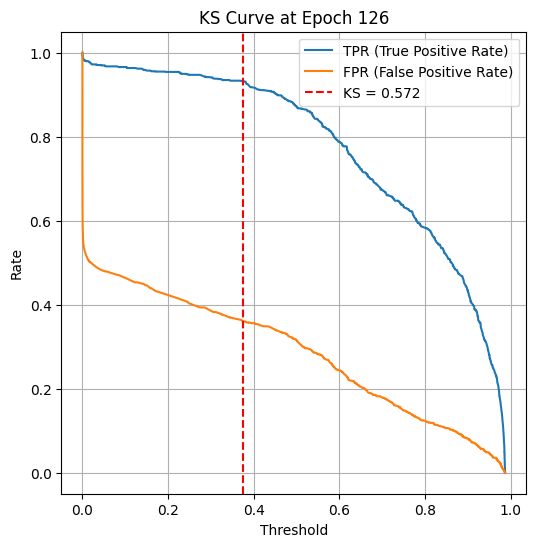

Epoch 130 — Train Loss: 0.3355 | Train Acc: 0.8454 | Val KS: 0.5840 | Val Acc: 0.7870 | Val Prec: 0.7430 | Val Recall: 0.8776 | Val F1: 0.8047
Epoch 140 — Train Loss: 0.3223 | Train Acc: 0.8512 | Val KS: 0.5902 | Val Acc: 0.7909 | Val Prec: 0.7427 | Val Recall: 0.8900 | Val F1: 0.8097


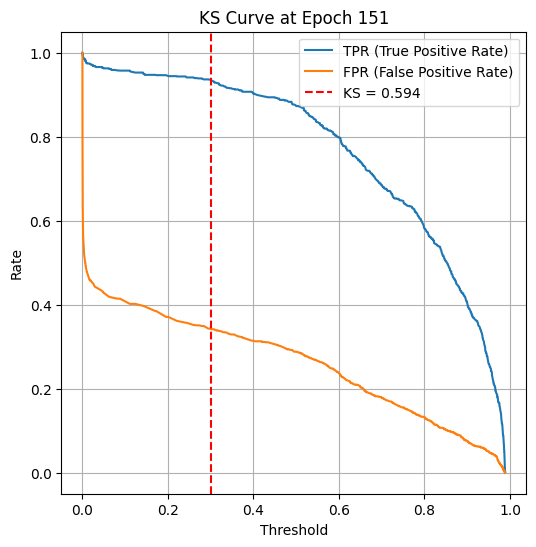

Epoch 150 — Train Loss: 0.3223 | Train Acc: 0.8565 | Val KS: 0.5941 | Val Acc: 0.7928 | Val Prec: 0.7520 | Val Recall: 0.8737 | Val F1: 0.8083
Epoch 160 — Train Loss: 0.3065 | Train Acc: 0.8588 | Val KS: 0.5980 | Val Acc: 0.7928 | Val Prec: 0.7490 | Val Recall: 0.8807 | Val F1: 0.8095
Epoch 170 — Train Loss: 0.2990 | Train Acc: 0.8654 | Val KS: 0.6011 | Val Acc: 0.7920 | Val Prec: 0.7461 | Val Recall: 0.8854 | Val F1: 0.8098


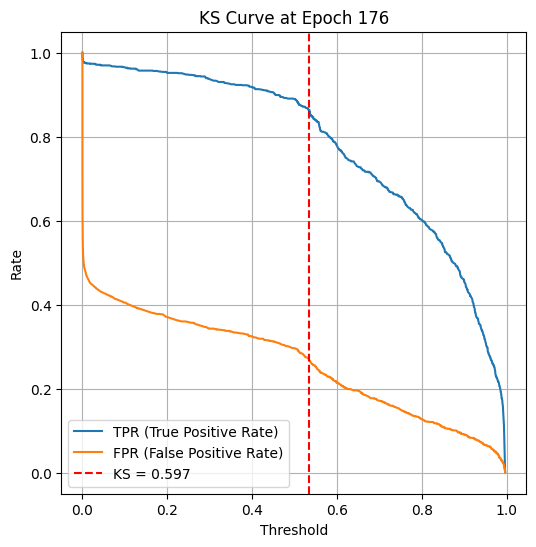

Epoch 180 — Train Loss: 0.2901 | Train Acc: 0.8661 | Val KS: 0.5840 | Val Acc: 0.7897 | Val Prec: 0.7379 | Val Recall: 0.8985 | Val F1: 0.8103
Epoch 190 — Train Loss: 0.2680 | Train Acc: 0.8737 | Val KS: 0.6042 | Val Acc: 0.7998 | Val Prec: 0.7449 | Val Recall: 0.9117 | Val F1: 0.8199


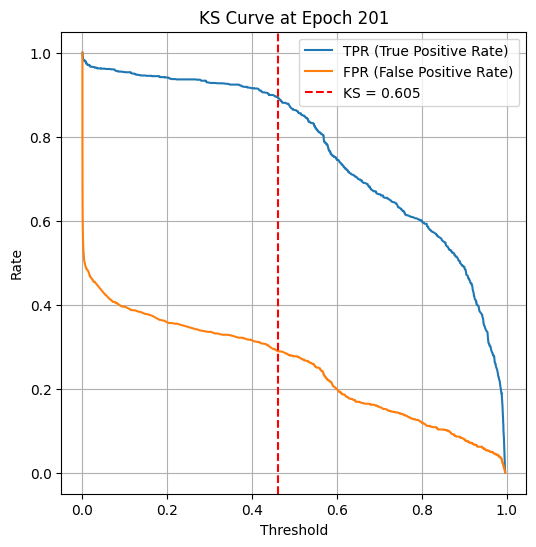

Epoch 200 — Train Loss: 0.2817 | Train Acc: 0.8718 | Val KS: 0.6050 | Val Acc: 0.7928 | Val Prec: 0.7568 | Val Recall: 0.8629 | Val F1: 0.8064
Epoch 210 — Train Loss: 0.2713 | Train Acc: 0.8787 | Val KS: 0.6019 | Val Acc: 0.7947 | Val Prec: 0.7619 | Val Recall: 0.8575 | Val F1: 0.8069
Epoch 220 — Train Loss: 0.2639 | Train Acc: 0.8778 | Val KS: 0.6096 | Val Acc: 0.7990 | Val Prec: 0.7615 | Val Recall: 0.8706 | Val F1: 0.8124


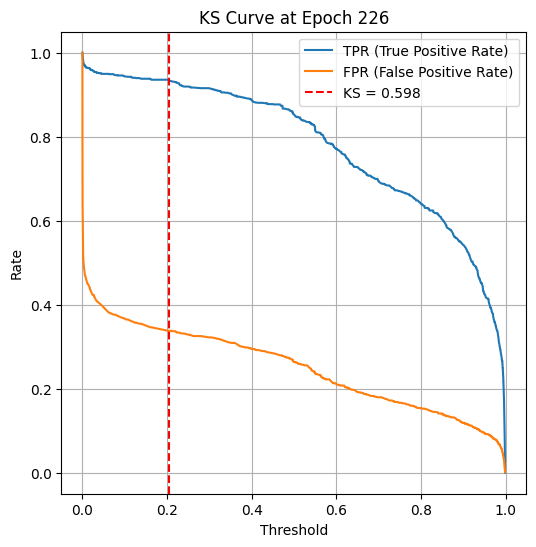

Epoch 230 — Train Loss: 0.2501 | Train Acc: 0.8855 | Val KS: 0.6019 | Val Acc: 0.7974 | Val Prec: 0.7440 | Val Recall: 0.9070 | Val F1: 0.8175
Epoch 240 — Train Loss: 0.2582 | Train Acc: 0.8812 | Val KS: 0.6011 | Val Acc: 0.8002 | Val Prec: 0.7502 | Val Recall: 0.9001 | Val F1: 0.8183


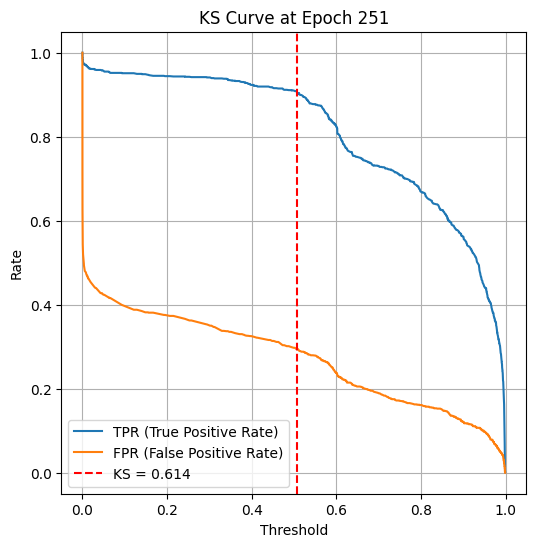

Epoch 250 — Train Loss: 0.2497 | Train Acc: 0.8838 | Val KS: 0.6143 | Val Acc: 0.8060 | Val Prec: 0.7535 | Val Recall: 0.9094 | Val F1: 0.8241
Epoch 260 — Train Loss: 0.2403 | Train Acc: 0.8911 | Val KS: 0.6026 | Val Acc: 0.7909 | Val Prec: 0.7351 | Val Recall: 0.9094 | Val F1: 0.8130
Epoch 270 — Train Loss: 0.2428 | Train Acc: 0.8917 | Val KS: 0.6096 | Val Acc: 0.8044 | Val Prec: 0.7569 | Val Recall: 0.8970 | Val F1: 0.8210


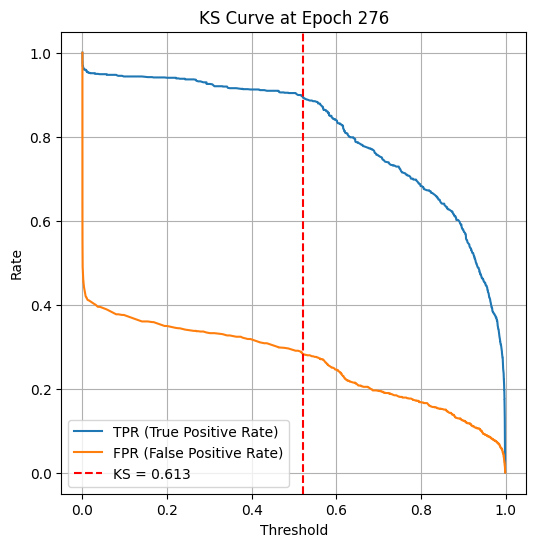

Epoch 280 — Train Loss: 0.2312 | Train Acc: 0.8933 | Val KS: 0.5995 | Val Acc: 0.7943 | Val Prec: 0.7323 | Val Recall: 0.9280 | Val F1: 0.8186
Epoch 290 — Train Loss: 0.2339 | Train Acc: 0.8958 | Val KS: 0.6181 | Val Acc: 0.8002 | Val Prec: 0.7693 | Val Recall: 0.8575 | Val F1: 0.8110


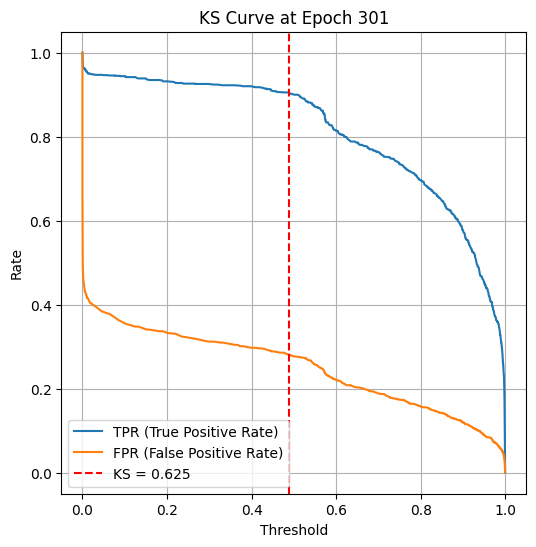

Epoch 300 — Train Loss: 0.2318 | Train Acc: 0.8969 | Val KS: 0.6251 | Val Acc: 0.8114 | Val Prec: 0.7645 | Val Recall: 0.9001 | Val F1: 0.8268
Epoch 310 — Train Loss: 0.2214 | Train Acc: 0.8989 | Val KS: 0.6189 | Val Acc: 0.8056 | Val Prec: 0.7521 | Val Recall: 0.9117 | Val F1: 0.8242
Epoch 320 — Train Loss: 0.2156 | Train Acc: 0.8998 | Val KS: 0.6235 | Val Acc: 0.8091 | Val Prec: 0.7611 | Val Recall: 0.9009 | Val F1: 0.8251


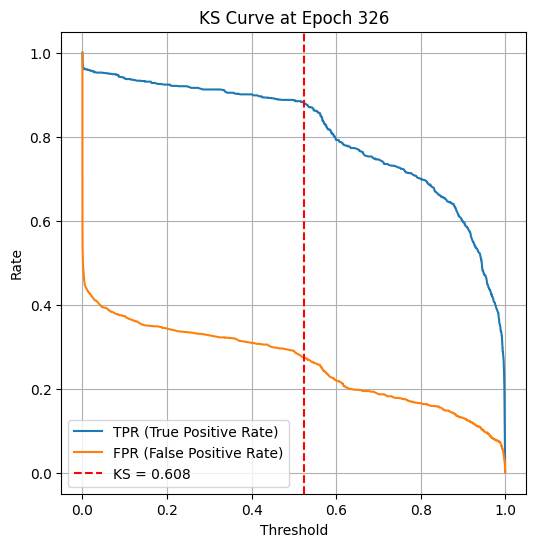

Epoch 330 — Train Loss: 0.2217 | Train Acc: 0.8987 | Val KS: 0.6197 | Val Acc: 0.8056 | Val Prec: 0.7890 | Val Recall: 0.8342 | Val F1: 0.8110
Epoch 340 — Train Loss: 0.2122 | Train Acc: 0.9016 | Val KS: 0.6266 | Val Acc: 0.8110 | Val Prec: 0.7675 | Val Recall: 0.8923 | Val F1: 0.8252


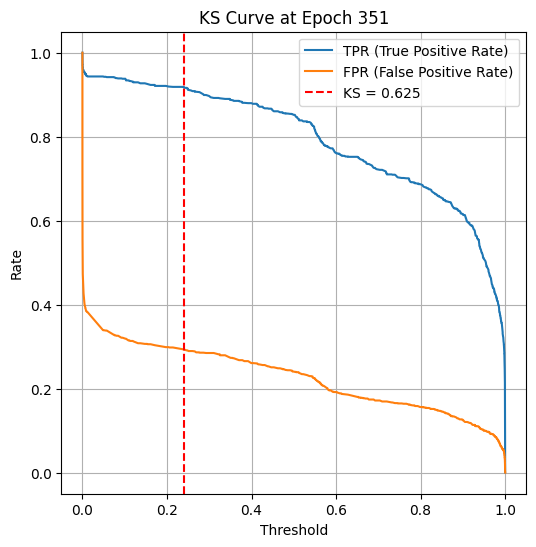

Epoch 350 — Train Loss: 0.2048 | Train Acc: 0.9074 | Val KS: 0.6251 | Val Acc: 0.8060 | Val Prec: 0.7801 | Val Recall: 0.8521 | Val F1: 0.8145
Epoch 360 — Train Loss: 0.2229 | Train Acc: 0.9014 | Val KS: 0.6359 | Val Acc: 0.8110 | Val Prec: 0.7878 | Val Recall: 0.8513 | Val F1: 0.8183
Epoch 370 — Train Loss: 0.2208 | Train Acc: 0.9045 | Val KS: 0.6235 | Val Acc: 0.8110 | Val Prec: 0.7572 | Val Recall: 0.9156 | Val F1: 0.8289


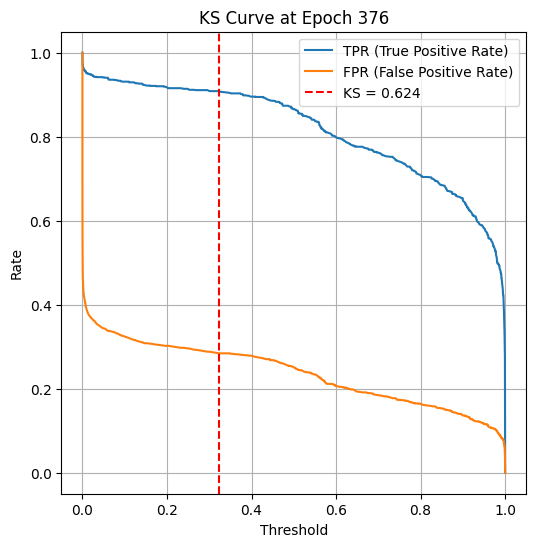

Epoch 380 — Train Loss: 0.2003 | Train Acc: 0.9109 | Val KS: 0.6313 | Val Acc: 0.8056 | Val Prec: 0.7828 | Val Recall: 0.8459 | Val F1: 0.8131
Epoch 390 — Train Loss: 0.2055 | Train Acc: 0.9103 | Val KS: 0.6197 | Val Acc: 0.8056 | Val Prec: 0.7524 | Val Recall: 0.9109 | Val F1: 0.8241


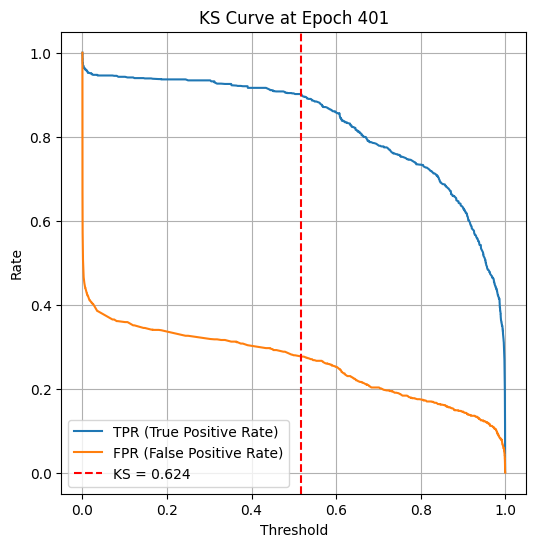

Epoch 400 — Train Loss: 0.2008 | Train Acc: 0.9091 | Val KS: 0.6243 | Val Acc: 0.8114 | Val Prec: 0.7634 | Val Recall: 0.9024 | Val F1: 0.8271
Epoch 410 — Train Loss: 0.2016 | Train Acc: 0.9126 | Val KS: 0.6189 | Val Acc: 0.8064 | Val Prec: 0.7645 | Val Recall: 0.8854 | Val F1: 0.8205
Epoch 420 — Train Loss: 0.1896 | Train Acc: 0.9120 | Val KS: 0.6158 | Val Acc: 0.8052 | Val Prec: 0.7616 | Val Recall: 0.8885 | Val F1: 0.8202


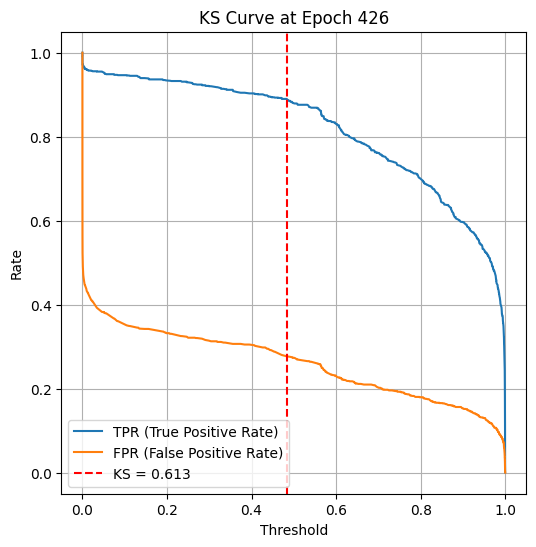

Epoch 430 — Train Loss: 0.1994 | Train Acc: 0.9091 | Val KS: 0.6174 | Val Acc: 0.8029 | Val Prec: 0.7566 | Val Recall: 0.8931 | Val F1: 0.8192
Epoch 440 — Train Loss: 0.1952 | Train Acc: 0.9150 | Val KS: 0.6204 | Val Acc: 0.8079 | Val Prec: 0.7573 | Val Recall: 0.9063 | Val F1: 0.8251


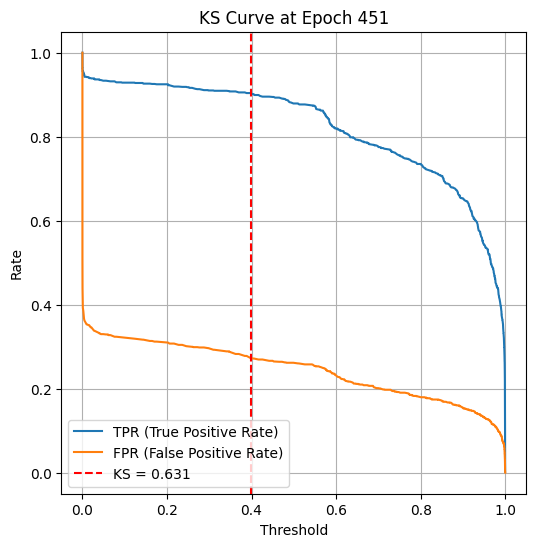

Epoch 450 — Train Loss: 0.1797 | Train Acc: 0.9161 | Val KS: 0.6313 | Val Acc: 0.8091 | Val Prec: 0.7711 | Val Recall: 0.8792 | Val F1: 0.8216
Epoch 460 — Train Loss: 0.1972 | Train Acc: 0.9124 | Val KS: 0.6057 | Val Acc: 0.7998 | Val Prec: 0.7478 | Val Recall: 0.9047 | Val F1: 0.8188
Epoch 470 — Train Loss: 0.1821 | Train Acc: 0.9157 | Val KS: 0.6321 | Val Acc: 0.8098 | Val Prec: 0.7639 | Val Recall: 0.8970 | Val F1: 0.8251


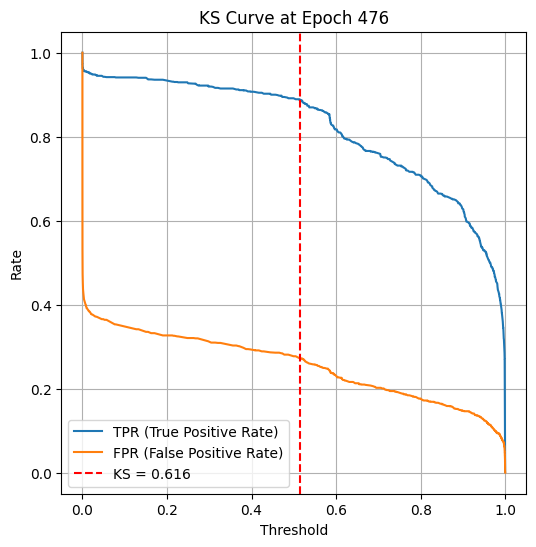

Epoch 480 — Train Loss: 0.1847 | Train Acc: 0.9155 | Val KS: 0.6336 | Val Acc: 0.8145 | Val Prec: 0.7743 | Val Recall: 0.8877 | Val F1: 0.8271
Epoch 490 — Train Loss: 0.1854 | Train Acc: 0.9171 | Val KS: 0.6359 | Val Acc: 0.8145 | Val Prec: 0.7654 | Val Recall: 0.9070 | Val F1: 0.8302


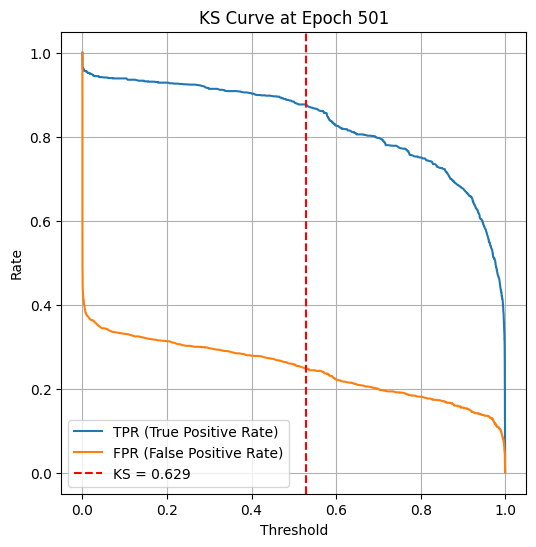

Epoch 500 — Train Loss: 0.1816 | Train Acc: 0.9198 | Val KS: 0.6290 | Val Acc: 0.8129 | Val Prec: 0.7741 | Val Recall: 0.8838 | Val F1: 0.8253
Epoch 510 — Train Loss: 0.1886 | Train Acc: 0.9182 | Val KS: 0.6336 | Val Acc: 0.8075 | Val Prec: 0.7704 | Val Recall: 0.8761 | Val F1: 0.8199
Epoch 520 — Train Loss: 0.1845 | Train Acc: 0.9175 | Val KS: 0.6297 | Val Acc: 0.8102 | Val Prec: 0.7712 | Val Recall: 0.8823 | Val F1: 0.8230


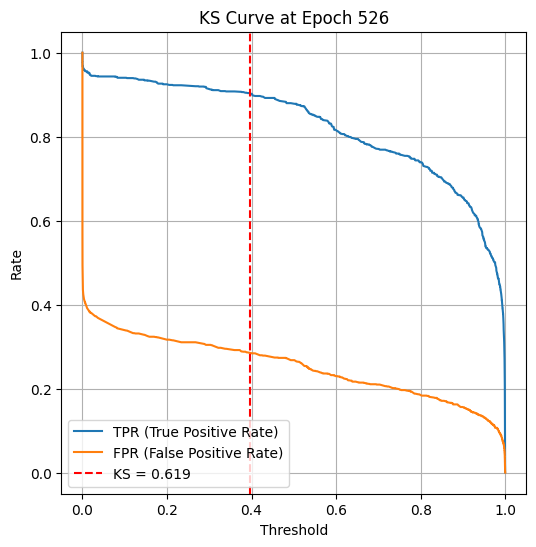

Epoch 530 — Train Loss: 0.1791 | Train Acc: 0.9196 | Val KS: 0.6398 | Val Acc: 0.8172 | Val Prec: 0.7754 | Val Recall: 0.8931 | Val F1: 0.8301
Epoch 540 — Train Loss: 0.1720 | Train Acc: 0.9210 | Val KS: 0.6390 | Val Acc: 0.8156 | Val Prec: 0.7740 | Val Recall: 0.8916 | Val F1: 0.8287


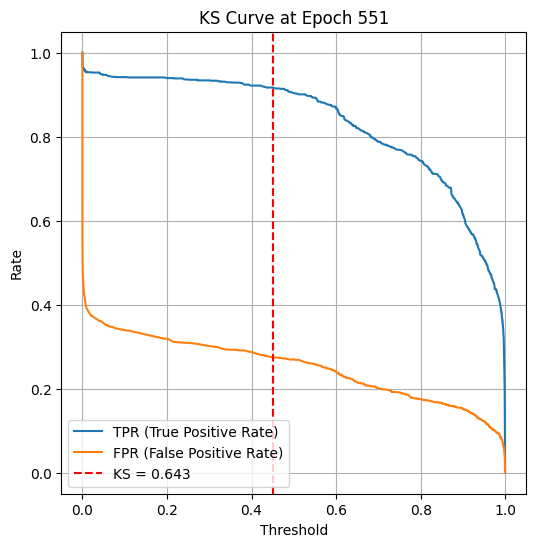

Epoch 550 — Train Loss: 0.1755 | Train Acc: 0.9239 | Val KS: 0.6429 | Val Acc: 0.8168 | Val Prec: 0.7701 | Val Recall: 0.9032 | Val F1: 0.8314
Epoch 560 — Train Loss: 0.1779 | Train Acc: 0.9192 | Val KS: 0.6390 | Val Acc: 0.8156 | Val Prec: 0.7651 | Val Recall: 0.9109 | Val F1: 0.8317
Epoch 570 — Train Loss: 0.1761 | Train Acc: 0.9206 | Val KS: 0.6282 | Val Acc: 0.8125 | Val Prec: 0.7636 | Val Recall: 0.9055 | Val F1: 0.8285


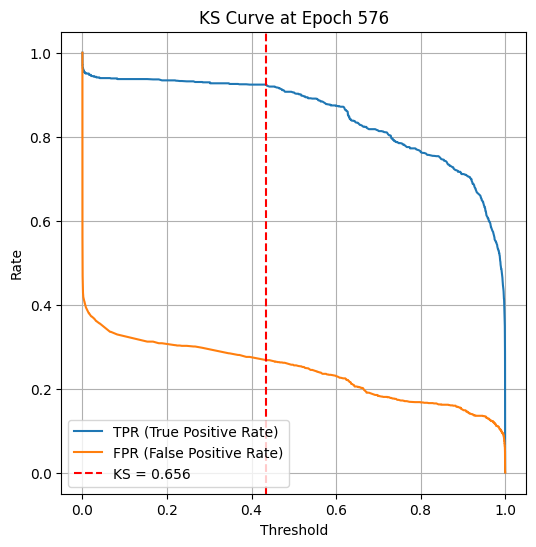

Epoch 580 — Train Loss: 0.1774 | Train Acc: 0.9196 | Val KS: 0.6220 | Val Acc: 0.8040 | Val Prec: 0.7782 | Val Recall: 0.8505 | Val F1: 0.8127
Epoch 590 — Train Loss: 0.1793 | Train Acc: 0.9243 | Val KS: 0.6290 | Val Acc: 0.8141 | Val Prec: 0.7742 | Val Recall: 0.8869 | Val F1: 0.8267


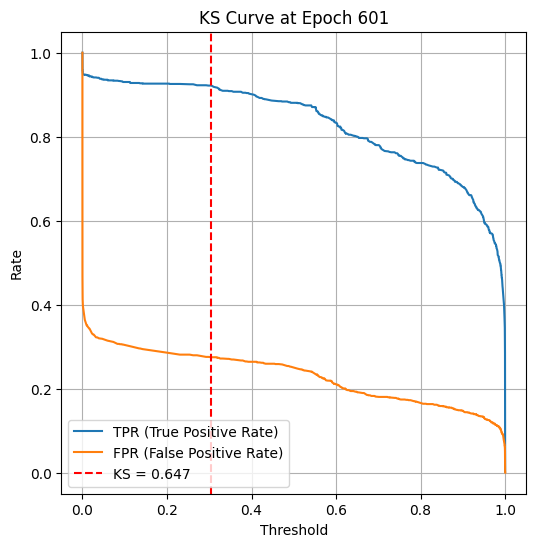

Epoch 600 — Train Loss: 0.1650 | Train Acc: 0.9266 | Val KS: 0.6468 | Val Acc: 0.8156 | Val Prec: 0.7793 | Val Recall: 0.8807 | Val F1: 0.8269
Epoch 610 — Train Loss: 0.1600 | Train Acc: 0.9349 | Val KS: 0.6561 | Val Acc: 0.8203 | Val Prec: 0.7823 | Val Recall: 0.8877 | Val F1: 0.8316
Epoch 620 — Train Loss: 0.1625 | Train Acc: 0.9279 | Val KS: 0.6437 | Val Acc: 0.8195 | Val Prec: 0.7716 | Val Recall: 0.9078 | Val F1: 0.8342


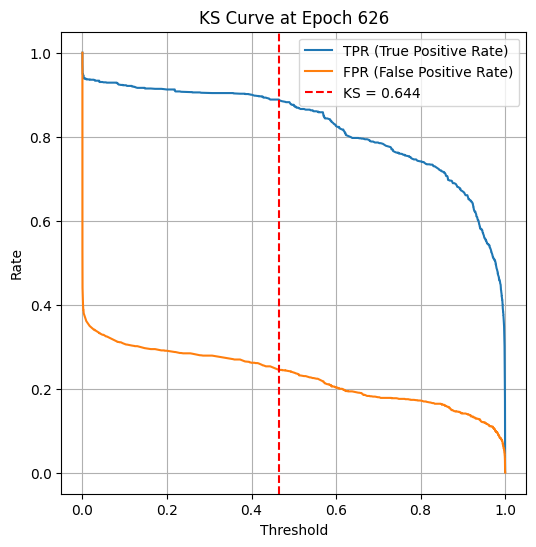

Epoch 630 — Train Loss: 0.1570 | Train Acc: 0.9318 | Val KS: 0.6266 | Val Acc: 0.8106 | Val Prec: 0.7677 | Val Recall: 0.8908 | Val F1: 0.8247
Epoch 640 — Train Loss: 0.1657 | Train Acc: 0.9248 | Val KS: 0.6251 | Val Acc: 0.8106 | Val Prec: 0.7635 | Val Recall: 0.9001 | Val F1: 0.8262


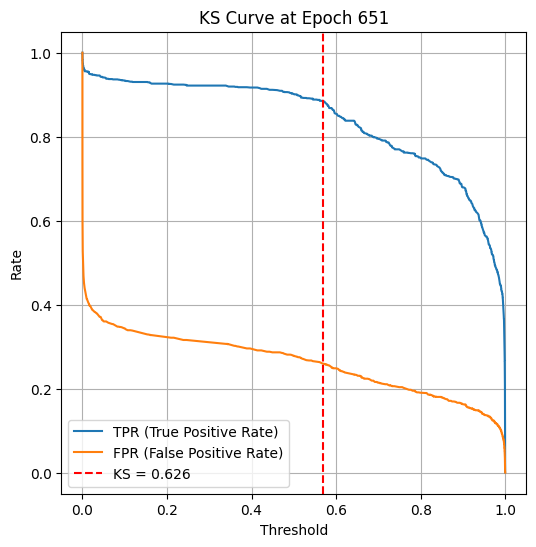

Epoch 650 — Train Loss: 0.1749 | Train Acc: 0.9262 | Val KS: 0.6259 | Val Acc: 0.8118 | Val Prec: 0.7643 | Val Recall: 0.9016 | Val F1: 0.8273
Epoch 660 — Train Loss: 0.1474 | Train Acc: 0.9318 | Val KS: 0.6352 | Val Acc: 0.8102 | Val Prec: 0.7846 | Val Recall: 0.8552 | Val F1: 0.8184
Epoch 670 — Train Loss: 0.1777 | Train Acc: 0.9202 | Val KS: 0.6336 | Val Acc: 0.8110 | Val Prec: 0.7647 | Val Recall: 0.8985 | Val F1: 0.8262


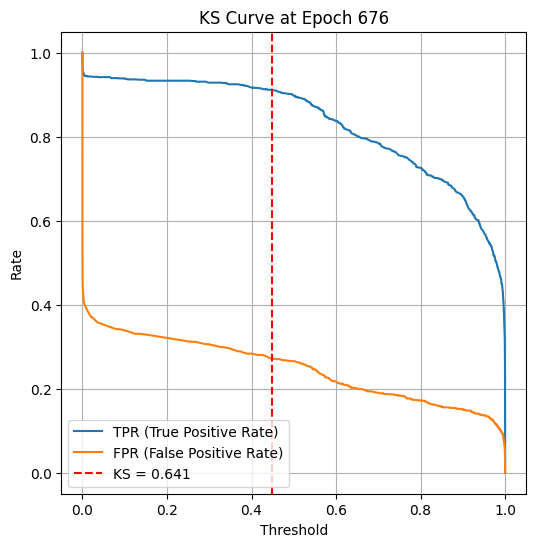

Epoch 680 — Train Loss: 0.1519 | Train Acc: 0.9324 | Val KS: 0.6514 | Val Acc: 0.8137 | Val Prec: 0.7868 | Val Recall: 0.8606 | Val F1: 0.8220
Epoch 690 — Train Loss: 0.1604 | Train Acc: 0.9274 | Val KS: 0.6421 | Val Acc: 0.8156 | Val Prec: 0.7793 | Val Recall: 0.8807 | Val F1: 0.8269


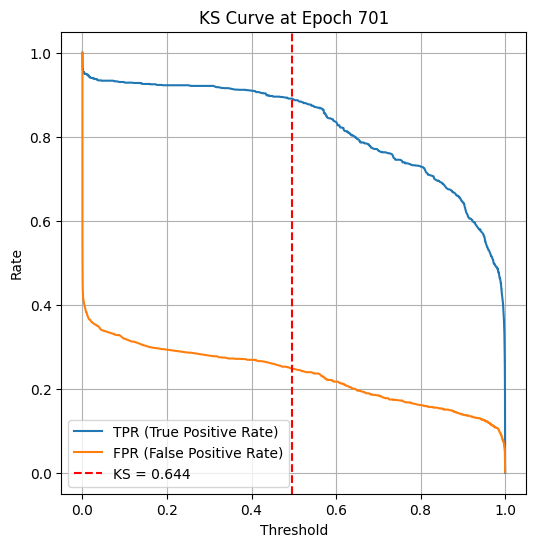

Epoch 700 — Train Loss: 0.1603 | Train Acc: 0.9274 | Val KS: 0.6437 | Val Acc: 0.8207 | Val Prec: 0.7824 | Val Recall: 0.8885 | Val F1: 0.8321
Epoch 710 — Train Loss: 0.1584 | Train Acc: 0.9283 | Val KS: 0.6514 | Val Acc: 0.8249 | Val Prec: 0.7802 | Val Recall: 0.9047 | Val F1: 0.8379
Epoch 720 — Train Loss: 0.1464 | Train Acc: 0.9339 | Val KS: 0.6328 | Val Acc: 0.8079 | Val Prec: 0.7732 | Val Recall: 0.8714 | Val F1: 0.8194


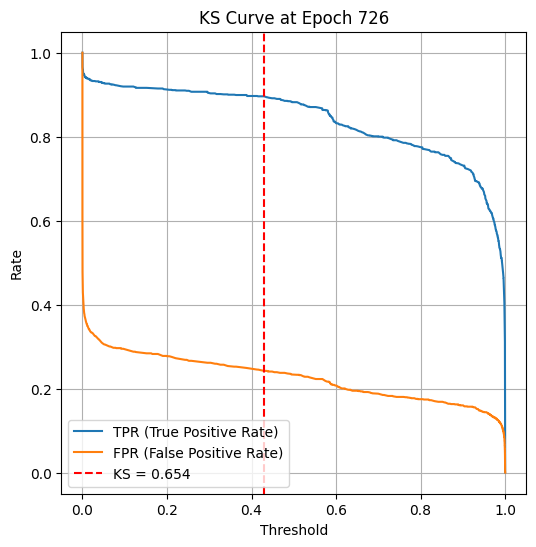

Epoch 730 — Train Loss: 0.1603 | Train Acc: 0.9312 | Val KS: 0.6445 | Val Acc: 0.8184 | Val Prec: 0.7807 | Val Recall: 0.8854 | Val F1: 0.8298
Epoch 740 — Train Loss: 0.1498 | Train Acc: 0.9328 | Val KS: 0.6305 | Val Acc: 0.8102 | Val Prec: 0.7679 | Val Recall: 0.8892 | Val F1: 0.8241


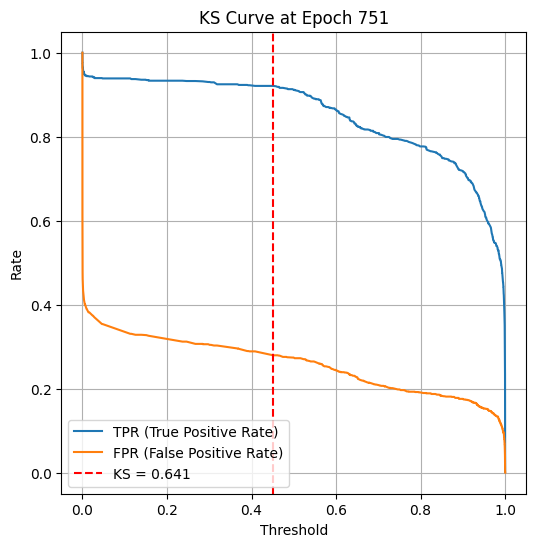

Epoch 750 — Train Loss: 0.1552 | Train Acc: 0.9330 | Val KS: 0.6414 | Val Acc: 0.8191 | Val Prec: 0.7693 | Val Recall: 0.9117 | Val F1: 0.8345
Epoch 760 — Train Loss: 0.1583 | Train Acc: 0.9326 | Val KS: 0.6313 | Val Acc: 0.8137 | Val Prec: 0.7620 | Val Recall: 0.9125 | Val F1: 0.8305
Epoch 770 — Train Loss: 0.1475 | Train Acc: 0.9326 | Val KS: 0.6274 | Val Acc: 0.8118 | Val Prec: 0.7707 | Val Recall: 0.8877 | Val F1: 0.8251


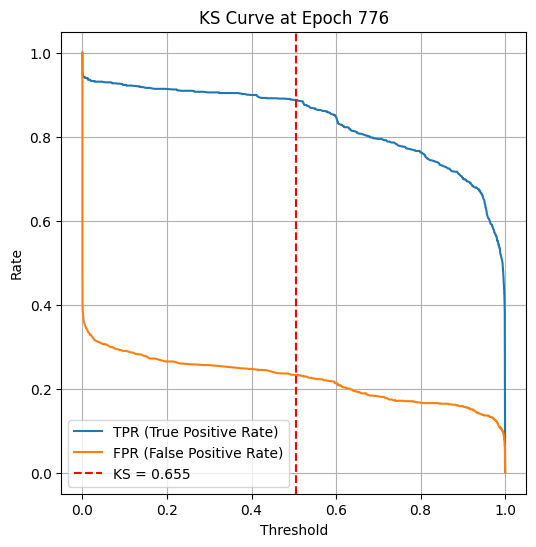

Epoch 780 — Train Loss: 0.1537 | Train Acc: 0.9299 | Val KS: 0.6538 | Val Acc: 0.8238 | Val Prec: 0.7750 | Val Recall: 0.9125 | Val F1: 0.8381
Epoch 790 — Train Loss: 0.1553 | Train Acc: 0.9320 | Val KS: 0.6468 | Val Acc: 0.8184 | Val Prec: 0.7715 | Val Recall: 0.9047 | Val F1: 0.8328


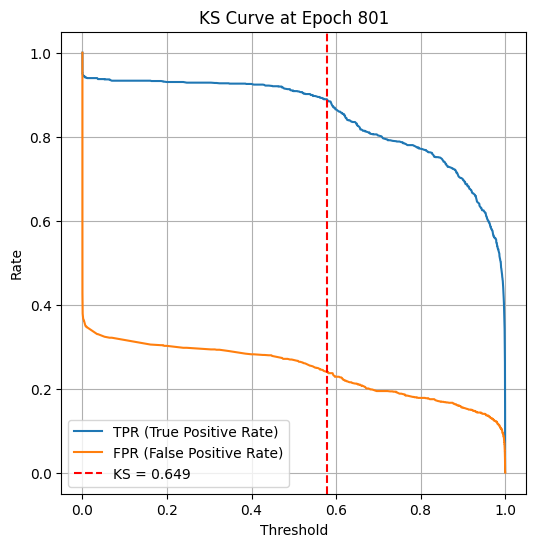

Epoch 800 — Train Loss: 0.1363 | Train Acc: 0.9372 | Val KS: 0.6491 | Val Acc: 0.8203 | Val Prec: 0.7722 | Val Recall: 0.9086 | Val F1: 0.8349
Epoch 810 — Train Loss: 0.1525 | Train Acc: 0.9341 | Val KS: 0.6259 | Val Acc: 0.8122 | Val Prec: 0.7644 | Val Recall: 0.9024 | Val F1: 0.8277
Epoch 820 — Train Loss: 0.1425 | Train Acc: 0.9355 | Val KS: 0.6561 | Val Acc: 0.8257 | Val Prec: 0.7843 | Val Recall: 0.8985 | Val F1: 0.8375


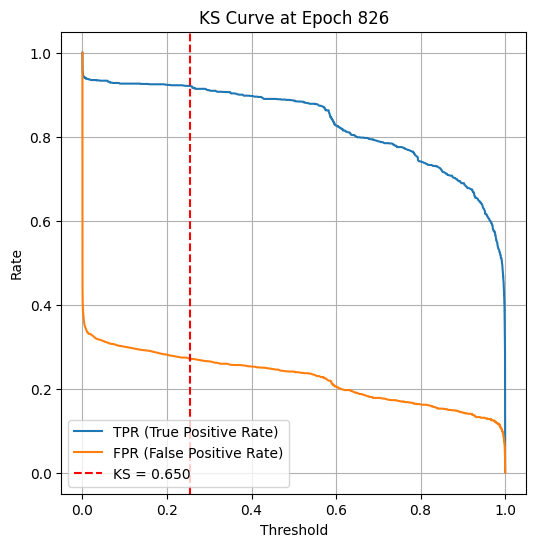

Epoch 830 — Train Loss: 0.1514 | Train Acc: 0.9336 | Val KS: 0.6530 | Val Acc: 0.8253 | Val Prec: 0.7842 | Val Recall: 0.8978 | Val F1: 0.8371
Epoch 840 — Train Loss: 0.1505 | Train Acc: 0.9359 | Val KS: 0.6321 | Val Acc: 0.8137 | Val Prec: 0.7755 | Val Recall: 0.8830 | Val F1: 0.8258


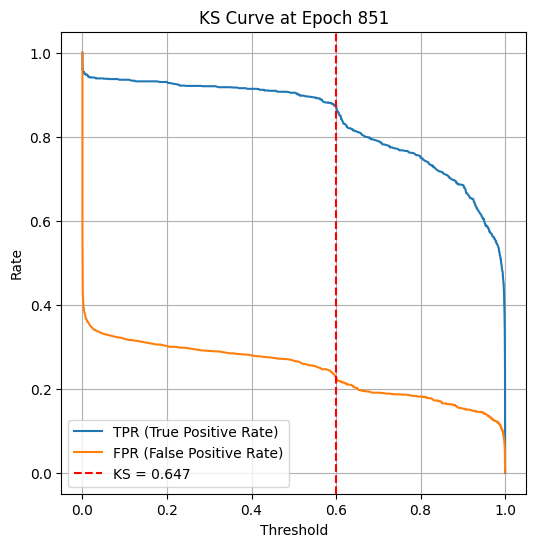

Epoch 850 — Train Loss: 0.1480 | Train Acc: 0.9345 | Val KS: 0.6468 | Val Acc: 0.8191 | Val Prec: 0.7725 | Val Recall: 0.9047 | Val F1: 0.8334
Epoch 860 — Train Loss: 0.1598 | Train Acc: 0.9310 | Val KS: 0.6305 | Val Acc: 0.8110 | Val Prec: 0.7647 | Val Recall: 0.8985 | Val F1: 0.8262
Epoch 870 — Train Loss: 0.1364 | Train Acc: 0.9376 | Val KS: 0.6522 | Val Acc: 0.8249 | Val Prec: 0.7936 | Val Recall: 0.8784 | Val F1: 0.8338


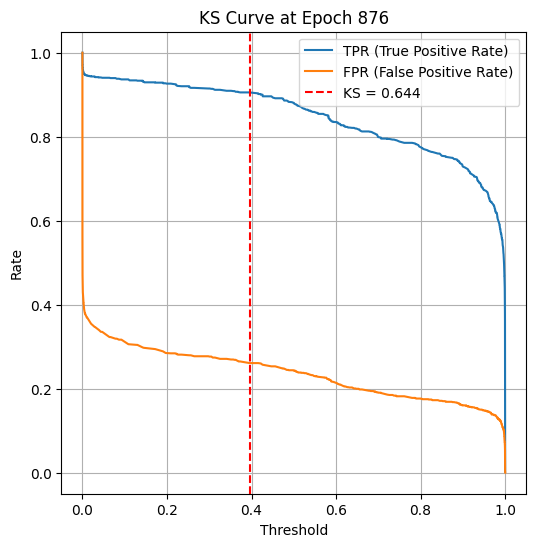

Epoch 880 — Train Loss: 0.1392 | Train Acc: 0.9401 | Val KS: 0.6507 | Val Acc: 0.8211 | Val Prec: 0.7825 | Val Recall: 0.8892 | Val F1: 0.8325
Epoch 890 — Train Loss: 0.1447 | Train Acc: 0.9399 | Val KS: 0.6576 | Val Acc: 0.8273 | Val Prec: 0.7900 | Val Recall: 0.8916 | Val F1: 0.8377


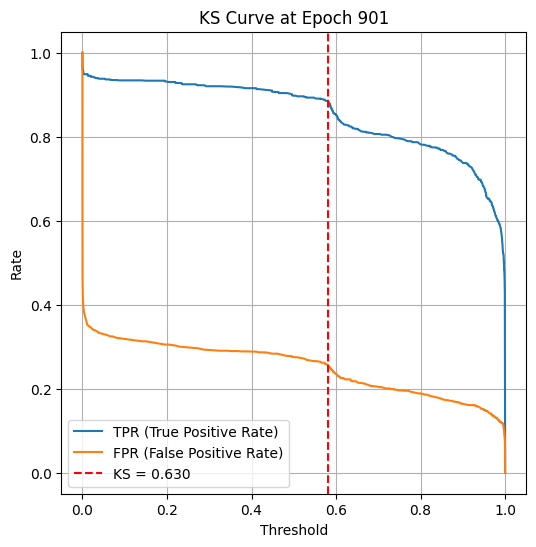

Epoch 900 — Train Loss: 0.1425 | Train Acc: 0.9398 | Val KS: 0.6297 | Val Acc: 0.8114 | Val Prec: 0.7655 | Val Recall: 0.8978 | Val F1: 0.8264
Epoch 910 — Train Loss: 0.1282 | Train Acc: 0.9421 | Val KS: 0.6468 | Val Acc: 0.8176 | Val Prec: 0.7759 | Val Recall: 0.8931 | Val F1: 0.8304
Epoch 920 — Train Loss: 0.1434 | Train Acc: 0.9382 | Val KS: 0.6305 | Val Acc: 0.8133 | Val Prec: 0.7639 | Val Recall: 0.9070 | Val F1: 0.8293


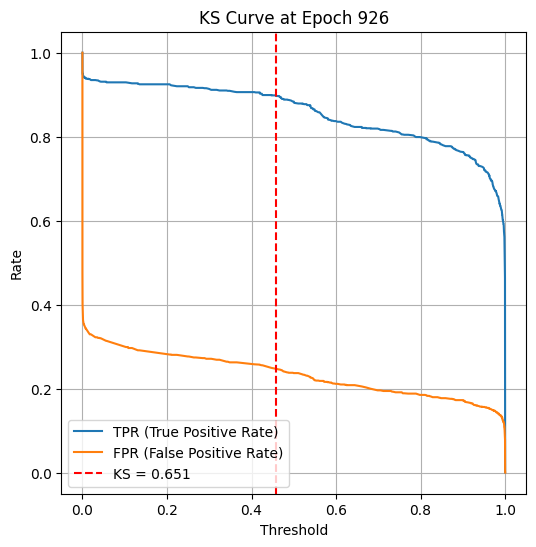

Epoch 930 — Train Loss: 0.1500 | Train Acc: 0.9367 | Val KS: 0.6538 | Val Acc: 0.8249 | Val Prec: 0.7806 | Val Recall: 0.9040 | Val F1: 0.8378
Epoch 940 — Train Loss: 0.1386 | Train Acc: 0.9386 | Val KS: 0.6499 | Val Acc: 0.8195 | Val Prec: 0.7923 | Val Recall: 0.8660 | Val F1: 0.8275


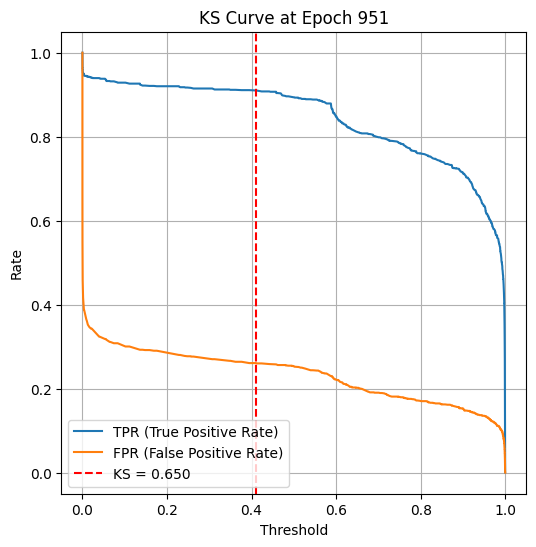

Epoch 950 — Train Loss: 0.1487 | Train Acc: 0.9357 | Val KS: 0.6499 | Val Acc: 0.8203 | Val Prec: 0.7792 | Val Recall: 0.8939 | Val F1: 0.8326
Epoch 960 — Train Loss: 0.1439 | Train Acc: 0.9330 | Val KS: 0.6685 | Val Acc: 0.8335 | Val Prec: 0.7988 | Val Recall: 0.8916 | Val F1: 0.8426
Epoch 970 — Train Loss: 0.1290 | Train Acc: 0.9409 | Val KS: 0.6491 | Val Acc: 0.8222 | Val Prec: 0.7792 | Val Recall: 0.8993 | Val F1: 0.8350


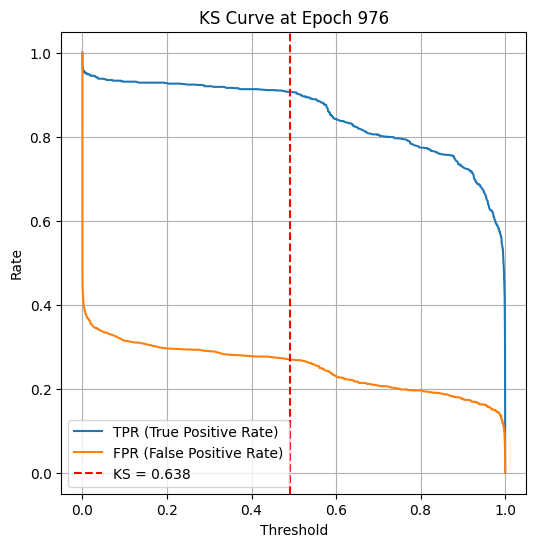

Epoch 980 — Train Loss: 0.1405 | Train Acc: 0.9386 | Val KS: 0.6507 | Val Acc: 0.8222 | Val Prec: 0.7777 | Val Recall: 0.9024 | Val F1: 0.8354
Epoch 990 — Train Loss: 0.1389 | Train Acc: 0.9372 | Val KS: 0.6406 | Val Acc: 0.8195 | Val Prec: 0.7748 | Val Recall: 0.9009 | Val F1: 0.8331
Epoch 999 — Train Loss: 0.1219 | Train Acc: 0.9448 | Val KS: 0.6476 | Val Acc: 0.8211 | Val Prec: 0.7829 | Val Recall: 0.8885 | Val F1: 0.8324


In [ ]:

# Model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = STABTransformer(input_dim=X_train_tensor.shape[1], n_heads=2, n_layers=2, dropout=0.3).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
loss_fn = nn.BCELoss()


epochs=1000
for epoch in range(epochs):
    model.train()
    epoch_loss = 0

    all_preds = []
    all_targets = []

    for xb, yb in train_loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).squeeze()
        loss = loss_fn(pred, yb)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()

        preds_np = (pred > 0.5).detach().cpu().numpy()
        targets_np = yb.detach().cpu().numpy()

        all_preds.extend(preds_np)
        all_targets.extend(targets_np)

    # Training metrics
    acc = accuracy_score(all_targets, all_preds)
    prec = precision_score(all_targets, all_preds)
    rec = recall_score(all_targets, all_preds)
    f1 = f1_score(all_targets, all_preds)

    # Validation metrics
    ks_val, acc_val, prec_val, rec_val, f1_val = evaluate_validation(model, val_loader, device, epoch)

    if epoch % 10 == 0 or epoch == epochs - 1:
        print(f"Epoch {epoch:03d} — Train Loss: {epoch_loss/len(train_loader):.4f} | "
              f"Train Acc: {acc:.4f} | Val KS: {ks_val:.4f} | Val Acc: {acc_val:.4f} | "
              f"Val Prec: {prec_val:.4f} | Val Recall: {rec_val:.4f} | Val F1: {f1_val:.4f}")


In [ ]:

torch.save(model.state_dict(), 'stab_transformer_2head_2layer_0.1droput_1000epochs.pt')
files.download('stab_transformer_2head_2layer_0.1droput_1000epochs.pt')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

✅ Accuracy: 0.8420
✅ Precision: 0.8051
✅ Recall: 0.9024
✅ F1 Score: 0.8510


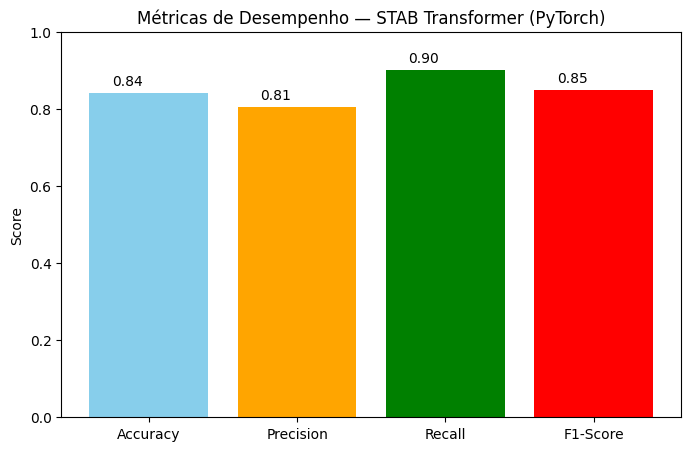

In [ ]:
model.eval()
X_test_tensor = torch.tensor(X_test_nn, dtype=torch.float32)
y_test_tensor = torch.tensor(y_test_nn.values, dtype=torch.float32)  # <-- Aqui está o fix

with torch.no_grad():
    y_pred_prob = model(X_test_tensor.to(device)).cpu().squeeze().numpy()
    y_pred = (y_pred_prob >= 0.5).astype(int)


# Save model weights
torch.save(model.state_dict(), 'stab_transformer_4head_2layer_0.1droput.pt')
files.download('stab_transformer_4head_2layer_0.1droput.pt')


acc = accuracy_score(y_test_nn, y_pred)
prec = precision_score(y_test_nn, y_pred)
rec = recall_score(y_test_nn, y_pred)
f1 = f1_score(y_test_nn, y_pred)

print(f"✅ Accuracy: {acc:.4f}")
print(f"✅ Precision: {prec:.4f}")
print(f"✅ Recall: {rec:.4f}")
print(f"✅ F1 Score: {f1:.4f}")

metrics_names = ['Accuracy', 'Precision', 'Recall', 'F1-Score']
metrics_values = [acc, prec, rec, f1]

plt.figure(figsize=(8, 5))
bars = plt.bar(metrics_names, metrics_values, color=['skyblue', 'orange', 'green', 'red'])
plt.ylim(0, 1)
plt.title('Métricas de Desempenho — STAB Transformer (PyTorch)')
plt.ylabel('Score')
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + 0.15, yval + 0.02, f'{yval:.2f}')
plt.show()



<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

✅ Accuracy: 0.8211
✅ Precision: 0.7829
✅ Recall: 0.8885
✅ F1 Score: 0.8324


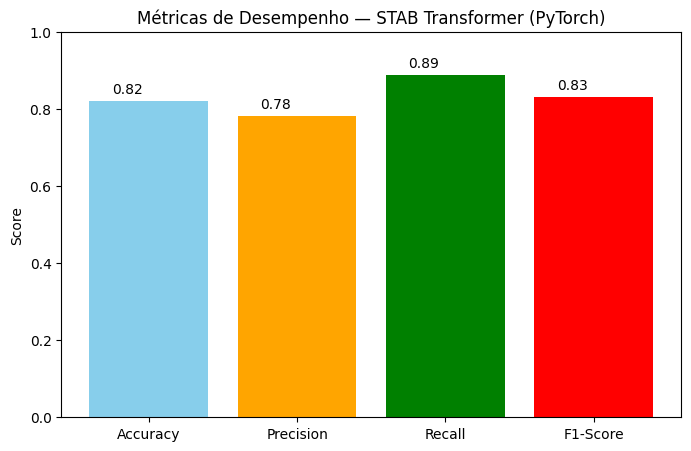

In [ ]:
model.eval()
X_test_tensor = torch.tensor(X_val_nn, dtype=torch.float32)
y_test_tensor = torch.tensor(y_val_nn.values, dtype=torch.float32)  # <-- Aqui está o fix

with torch.no_grad():
    y_pred_prob = model(X_test_tensor.to(device)).cpu().squeeze().numpy()
    y_pred = (y_pred_prob >= 0.5).astype(int)


# Save model weights
torch.save(model.state_dict(), 'stab_transformer_4head_2layer_0.1droput.pt')
files.download('stab_transformer_4head_2layer_0.1droput.pt')


acc = accuracy_score(y_test_nn, y_pred)
prec = precision_score(y_test_nn, y_pred)
rec = recall_score(y_test_nn, y_pred)
f1 = f1_score(y_test_nn, y_pred)

print(f"✅ Accuracy: {acc:.4f}")
print(f"✅ Precision: {prec:.4f}")
print(f"✅ Recall: {rec:.4f}")
print(f"✅ F1 Score: {f1:.4f}")

metrics_names = ['Accuracy', 'Precision', 'Recall', 'F1-Score']
metrics_values = [acc, prec, rec, f1]

plt.figure(figsize=(8, 5))
bars = plt.bar(metrics_names, metrics_values, color=['skyblue', 'orange', 'green', 'red'])
plt.ylim(0, 1)
plt.title('Métricas de Desempenho — STAB Transformer (PyTorch)')
plt.ylabel('Score')
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + 0.15, yval + 0.02, f'{yval:.2f}')
plt.show()



### Experimentação 5

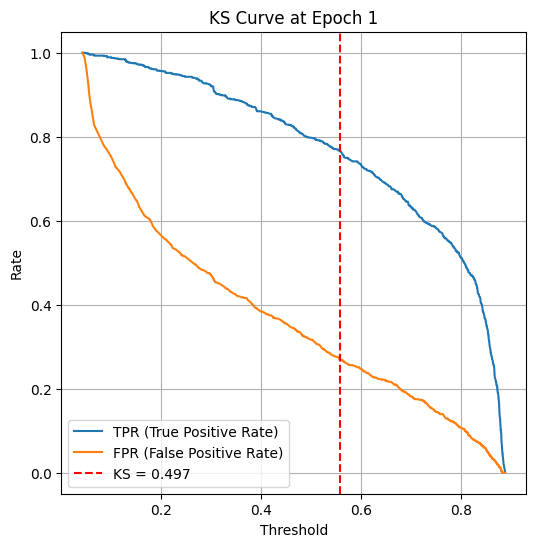

Epoch 000 — Train Loss: 0.5376 | Train Acc: 0.7398 | Val KS: 0.4973 | Val Acc: 0.7401 | Val Prec: 0.7156 | Val Recall: 0.7971 | Val F1: 0.7541
Epoch 010 — Train Loss: 0.4841 | Train Acc: 0.7577 | Val KS: 0.5128 | Val Acc: 0.7510 | Val Prec: 0.7580 | Val Recall: 0.7374 | Val F1: 0.7475
Epoch 020 — Train Loss: 0.4733 | Train Acc: 0.7691 | Val KS: 0.5252 | Val Acc: 0.7579 | Val Prec: 0.7569 | Val Recall: 0.7599 | Val F1: 0.7584


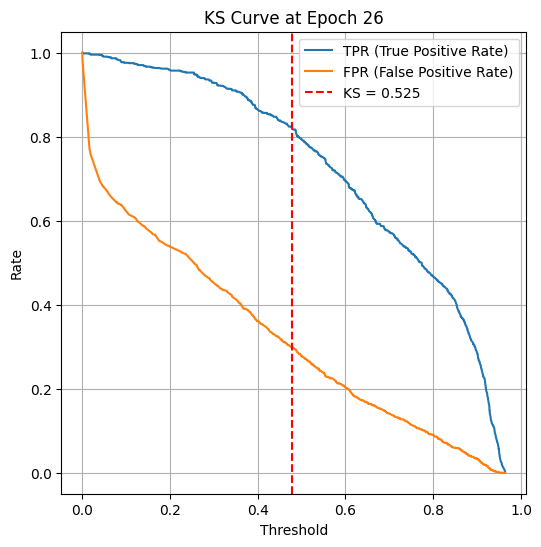

Epoch 030 — Train Loss: 0.4530 | Train Acc: 0.7747 | Val KS: 0.5391 | Val Acc: 0.7637 | Val Prec: 0.7593 | Val Recall: 0.7723 | Val F1: 0.7657
Epoch 040 — Train Loss: 0.4316 | Train Acc: 0.7898 | Val KS: 0.5368 | Val Acc: 0.7579 | Val Prec: 0.7137 | Val Recall: 0.8613 | Val F1: 0.7806


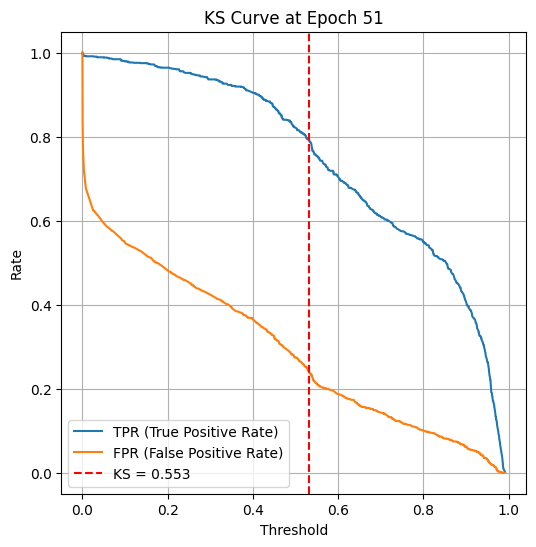

Epoch 050 — Train Loss: 0.4072 | Train Acc: 0.8028 | Val KS: 0.5531 | Val Acc: 0.7734 | Val Prec: 0.7496 | Val Recall: 0.8211 | Val F1: 0.7837
Epoch 060 — Train Loss: 0.3776 | Train Acc: 0.8165 | Val KS: 0.5453 | Val Acc: 0.7684 | Val Prec: 0.7321 | Val Recall: 0.8466 | Val F1: 0.7852
Epoch 070 — Train Loss: 0.3579 | Train Acc: 0.8268 | Val KS: 0.5740 | Val Acc: 0.7839 | Val Prec: 0.7495 | Val Recall: 0.8528 | Val F1: 0.7978


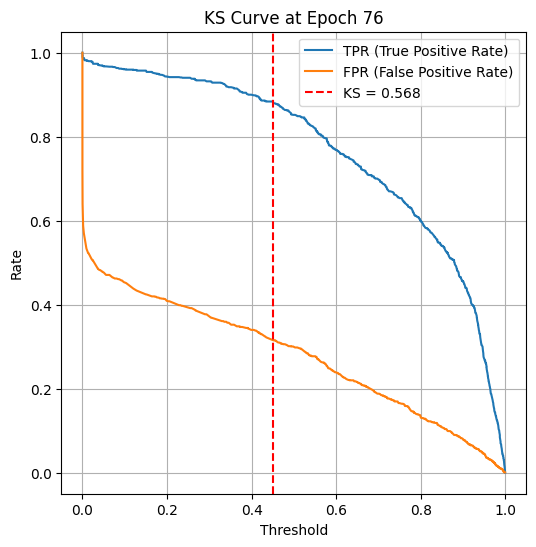

Epoch 080 — Train Loss: 0.3344 | Train Acc: 0.8421 | Val KS: 0.5693 | Val Acc: 0.7820 | Val Prec: 0.7382 | Val Recall: 0.8737 | Val F1: 0.8003
Epoch 090 — Train Loss: 0.3254 | Train Acc: 0.8454 | Val KS: 0.5833 | Val Acc: 0.7878 | Val Prec: 0.7459 | Val Recall: 0.8730 | Val F1: 0.8044


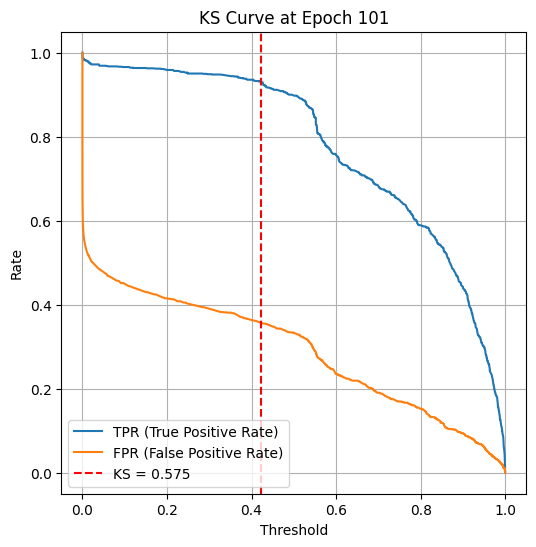

Epoch 100 — Train Loss: 0.3090 | Train Acc: 0.8545 | Val KS: 0.5747 | Val Acc: 0.7823 | Val Prec: 0.7294 | Val Recall: 0.8978 | Val F1: 0.8049
Epoch 110 — Train Loss: 0.2895 | Train Acc: 0.8615 | Val KS: 0.5980 | Val Acc: 0.7893 | Val Prec: 0.7488 | Val Recall: 0.8706 | Val F1: 0.8052
Epoch 120 — Train Loss: 0.2887 | Train Acc: 0.8632 | Val KS: 0.5918 | Val Acc: 0.7932 | Val Prec: 0.7528 | Val Recall: 0.8730 | Val F1: 0.8085


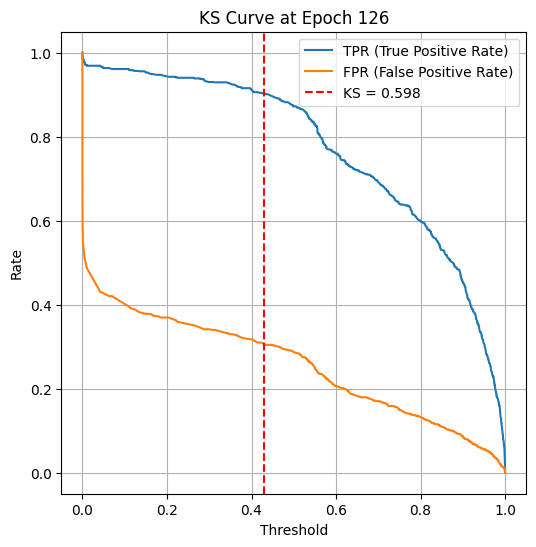

Epoch 130 — Train Loss: 0.2733 | Train Acc: 0.8690 | Val KS: 0.6019 | Val Acc: 0.7963 | Val Prec: 0.7590 | Val Recall: 0.8683 | Val F1: 0.8100
Epoch 140 — Train Loss: 0.2725 | Train Acc: 0.8743 | Val KS: 0.6057 | Val Acc: 0.7974 | Val Prec: 0.7500 | Val Recall: 0.8923 | Val F1: 0.8150


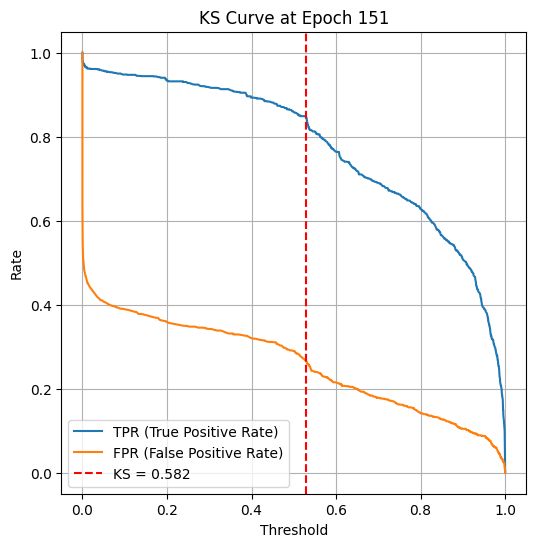

Epoch 150 — Train Loss: 0.2608 | Train Acc: 0.8758 | Val KS: 0.5825 | Val Acc: 0.7843 | Val Prec: 0.7476 | Val Recall: 0.8582 | Val F1: 0.7991
Epoch 160 — Train Loss: 0.2552 | Train Acc: 0.8822 | Val KS: 0.6034 | Val Acc: 0.7978 | Val Prec: 0.7654 | Val Recall: 0.8590 | Val F1: 0.8095
Epoch 170 — Train Loss: 0.2503 | Train Acc: 0.8830 | Val KS: 0.6228 | Val Acc: 0.8025 | Val Prec: 0.7588 | Val Recall: 0.8869 | Val F1: 0.8179


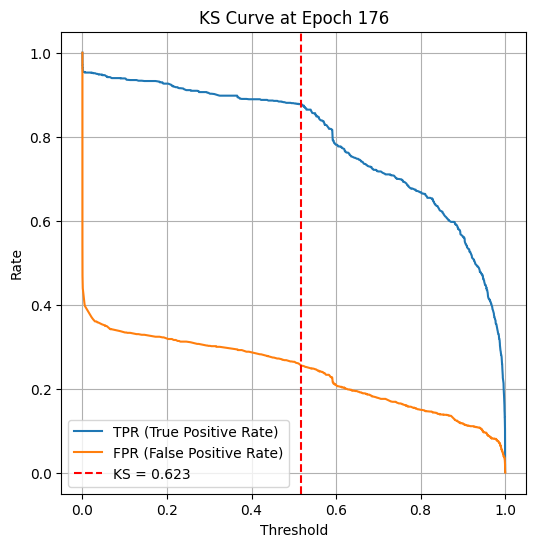

Epoch 180 — Train Loss: 0.2460 | Train Acc: 0.8826 | Val KS: 0.6057 | Val Acc: 0.7998 | Val Prec: 0.7597 | Val Recall: 0.8768 | Val F1: 0.8141
Epoch 190 — Train Loss: 0.2348 | Train Acc: 0.8894 | Val KS: 0.6112 | Val Acc: 0.7928 | Val Prec: 0.7723 | Val Recall: 0.8304 | Val F1: 0.8003


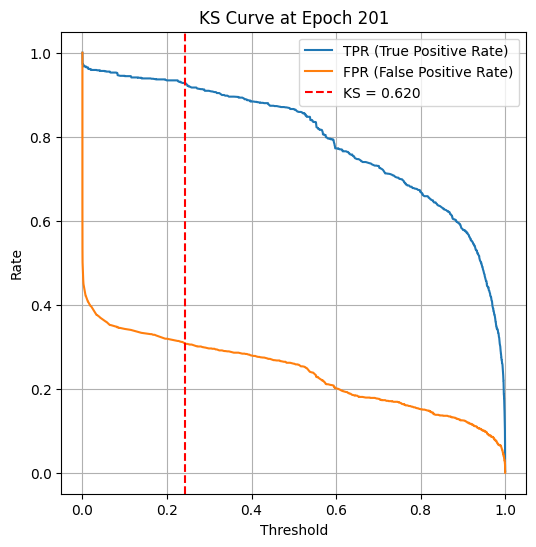

Epoch 200 — Train Loss: 0.2326 | Train Acc: 0.8898 | Val KS: 0.6204 | Val Acc: 0.8033 | Val Prec: 0.7694 | Val Recall: 0.8660 | Val F1: 0.8149
Epoch 210 — Train Loss: 0.2319 | Train Acc: 0.8902 | Val KS: 0.5926 | Val Acc: 0.7940 | Val Prec: 0.7453 | Val Recall: 0.8931 | Val F1: 0.8125
Epoch 220 — Train Loss: 0.2195 | Train Acc: 0.8991 | Val KS: 0.6135 | Val Acc: 0.8064 | Val Prec: 0.7718 | Val Recall: 0.8699 | Val F1: 0.8179


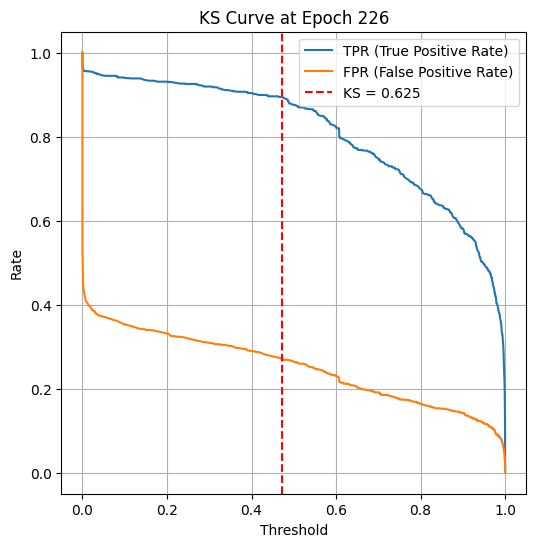

Epoch 230 — Train Loss: 0.2129 | Train Acc: 0.9000 | Val KS: 0.6158 | Val Acc: 0.8064 | Val Prec: 0.7696 | Val Recall: 0.8745 | Val F1: 0.8187
Epoch 240 — Train Loss: 0.2108 | Train Acc: 0.9039 | Val KS: 0.6143 | Val Acc: 0.7998 | Val Prec: 0.7618 | Val Recall: 0.8722 | Val F1: 0.8133


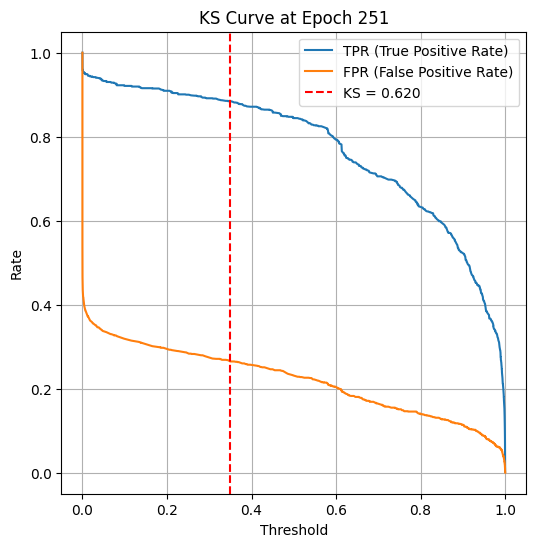

Epoch 250 — Train Loss: 0.2277 | Train Acc: 0.8956 | Val KS: 0.6197 | Val Acc: 0.8067 | Val Prec: 0.7853 | Val Recall: 0.8443 | Val F1: 0.8137
Epoch 260 — Train Loss: 0.2154 | Train Acc: 0.8997 | Val KS: 0.6135 | Val Acc: 0.7978 | Val Prec: 0.7635 | Val Recall: 0.8629 | Val F1: 0.8102
Epoch 270 — Train Loss: 0.2022 | Train Acc: 0.9059 | Val KS: 0.6274 | Val Acc: 0.8036 | Val Prec: 0.7749 | Val Recall: 0.8559 | Val F1: 0.8134


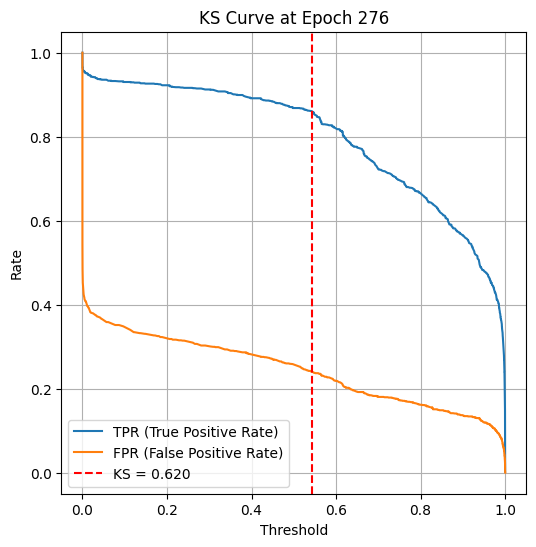

Epoch 280 — Train Loss: 0.2053 | Train Acc: 0.9070 | Val KS: 0.5763 | Val Acc: 0.7835 | Val Prec: 0.7463 | Val Recall: 0.8590 | Val F1: 0.7987
Epoch 290 — Train Loss: 0.1962 | Train Acc: 0.9126 | Val KS: 0.5980 | Val Acc: 0.7986 | Val Prec: 0.7614 | Val Recall: 0.8699 | Val F1: 0.8120


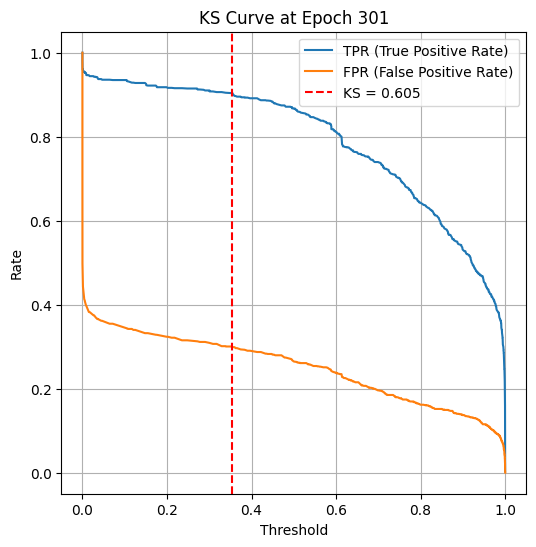

Epoch 300 — Train Loss: 0.1957 | Train Acc: 0.9086 | Val KS: 0.6050 | Val Acc: 0.8009 | Val Prec: 0.7659 | Val Recall: 0.8668 | Val F1: 0.8132
Epoch 310 — Train Loss: 0.1997 | Train Acc: 0.9072 | Val KS: 0.6127 | Val Acc: 0.8036 | Val Prec: 0.7707 | Val Recall: 0.8644 | Val F1: 0.8149
Epoch 320 — Train Loss: 0.1987 | Train Acc: 0.9082 | Val KS: 0.6189 | Val Acc: 0.8083 | Val Prec: 0.7632 | Val Recall: 0.8939 | Val F1: 0.8234


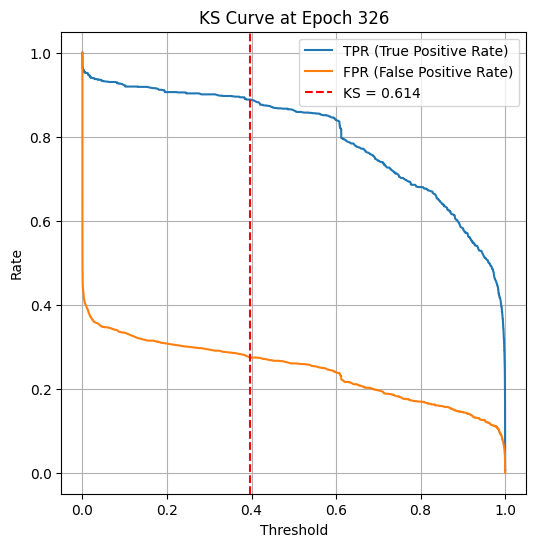

Epoch 330 — Train Loss: 0.1954 | Train Acc: 0.9155 | Val KS: 0.6359 | Val Acc: 0.8149 | Val Prec: 0.7809 | Val Recall: 0.8753 | Val F1: 0.8254
Epoch 340 — Train Loss: 0.1972 | Train Acc: 0.9111 | Val KS: 0.5972 | Val Acc: 0.7967 | Val Prec: 0.7602 | Val Recall: 0.8668 | Val F1: 0.8100


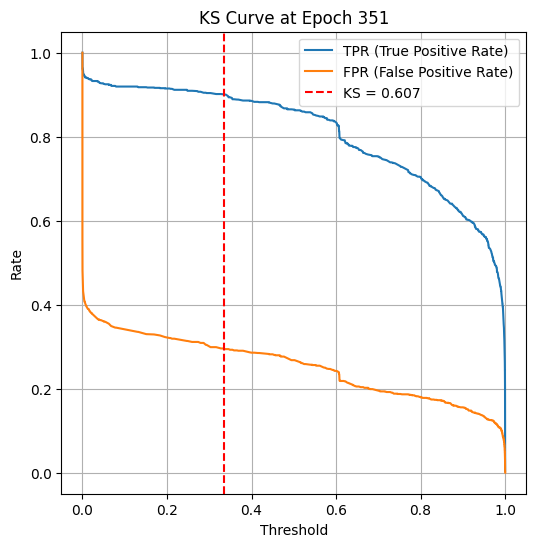

Epoch 350 — Train Loss: 0.1974 | Train Acc: 0.9097 | Val KS: 0.6065 | Val Acc: 0.7982 | Val Prec: 0.7633 | Val Recall: 0.8644 | Val F1: 0.8108
Epoch 360 — Train Loss: 0.1925 | Train Acc: 0.9124 | Val KS: 0.6274 | Val Acc: 0.8110 | Val Prec: 0.7682 | Val Recall: 0.8908 | Val F1: 0.8250
Epoch 370 — Train Loss: 0.1711 | Train Acc: 0.9198 | Val KS: 0.6235 | Val Acc: 0.8056 | Val Prec: 0.7741 | Val Recall: 0.8629 | Val F1: 0.8161


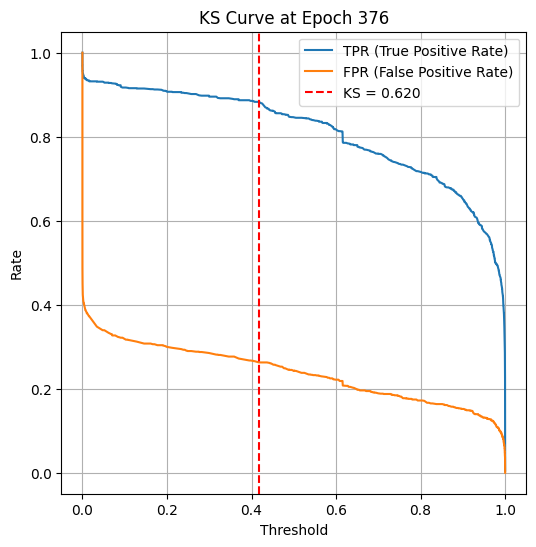

Epoch 380 — Train Loss: 0.1839 | Train Acc: 0.9186 | Val KS: 0.6282 | Val Acc: 0.8029 | Val Prec: 0.7789 | Val Recall: 0.8459 | Val F1: 0.8110
Epoch 390 — Train Loss: 0.1816 | Train Acc: 0.9132 | Val KS: 0.6112 | Val Acc: 0.8033 | Val Prec: 0.7581 | Val Recall: 0.8908 | Val F1: 0.8191


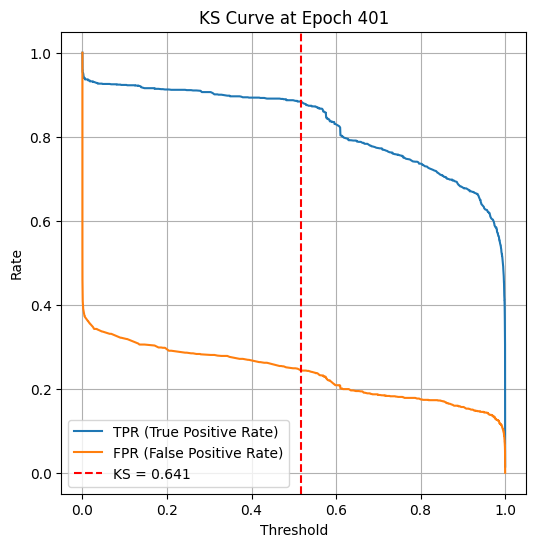

Epoch 400 — Train Loss: 0.1687 | Train Acc: 0.9213 | Val KS: 0.6406 | Val Acc: 0.8187 | Val Prec: 0.7809 | Val Recall: 0.8861 | Val F1: 0.8302
Epoch 410 — Train Loss: 0.1751 | Train Acc: 0.9208 | Val KS: 0.6150 | Val Acc: 0.8021 | Val Prec: 0.7843 | Val Recall: 0.8335 | Val F1: 0.8081
Epoch 420 — Train Loss: 0.1670 | Train Acc: 0.9246 | Val KS: 0.6197 | Val Acc: 0.7974 | Val Prec: 0.7771 | Val Recall: 0.8342 | Val F1: 0.8046


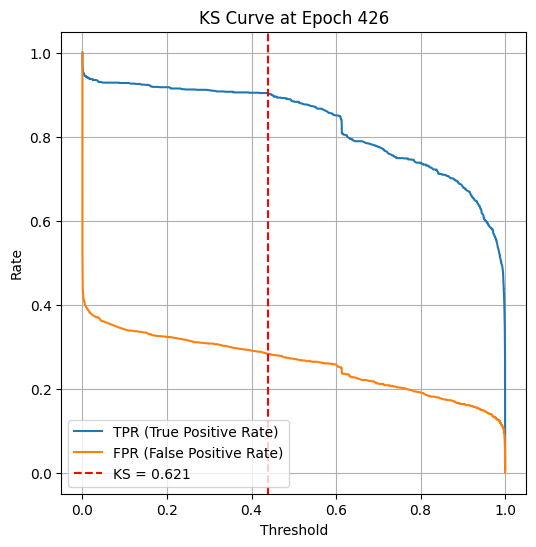

Epoch 430 — Train Loss: 0.1584 | Train Acc: 0.9279 | Val KS: 0.6065 | Val Acc: 0.7982 | Val Prec: 0.7633 | Val Recall: 0.8644 | Val F1: 0.8108
Epoch 440 — Train Loss: 0.1744 | Train Acc: 0.9194 | Val KS: 0.6336 | Val Acc: 0.8153 | Val Prec: 0.7713 | Val Recall: 0.8962 | Val F1: 0.8291


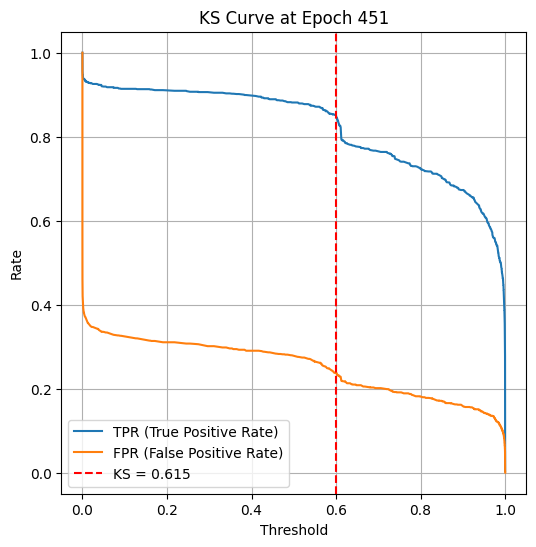

Epoch 450 — Train Loss: 0.1706 | Train Acc: 0.9204 | Val KS: 0.6150 | Val Acc: 0.8013 | Val Prec: 0.7597 | Val Recall: 0.8815 | Val F1: 0.8161
Epoch 460 — Train Loss: 0.1626 | Train Acc: 0.9229 | Val KS: 0.6352 | Val Acc: 0.8133 | Val Prec: 0.7835 | Val Recall: 0.8660 | Val F1: 0.8227
Epoch 470 — Train Loss: 0.1597 | Train Acc: 0.9266 | Val KS: 0.6297 | Val Acc: 0.8110 | Val Prec: 0.7775 | Val Recall: 0.8714 | Val F1: 0.8218


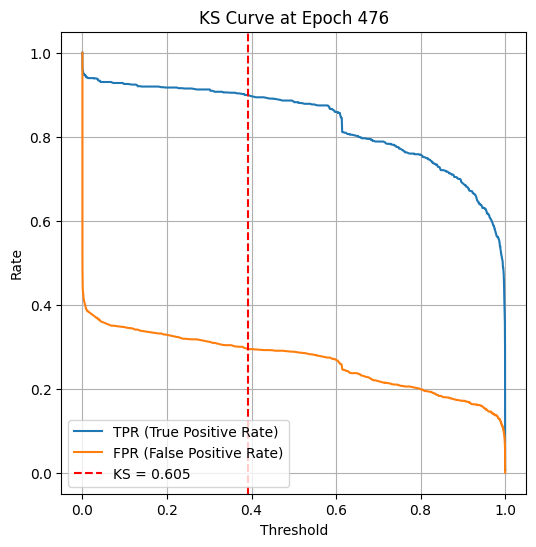

Epoch 480 — Train Loss: 0.1592 | Train Acc: 0.9270 | Val KS: 0.6367 | Val Acc: 0.8176 | Val Prec: 0.7778 | Val Recall: 0.8892 | Val F1: 0.8298
Epoch 490 — Train Loss: 0.1564 | Train Acc: 0.9279 | Val KS: 0.6290 | Val Acc: 0.8087 | Val Prec: 0.7716 | Val Recall: 0.8768 | Val F1: 0.8209


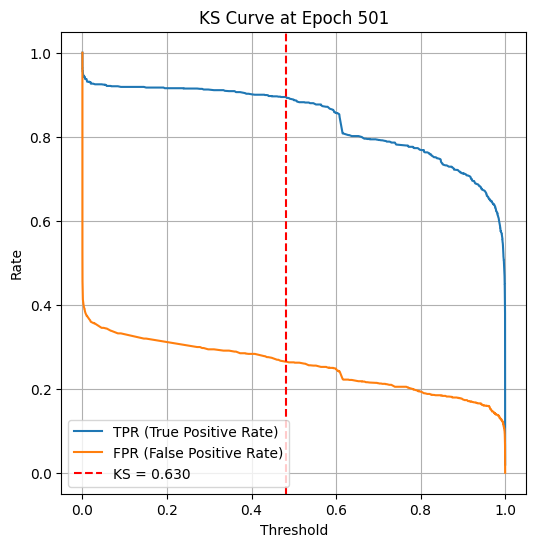

Epoch 500 — Train Loss: 0.1582 | Train Acc: 0.9268 | Val KS: 0.6297 | Val Acc: 0.8118 | Val Prec: 0.7710 | Val Recall: 0.8869 | Val F1: 0.8249
Epoch 510 — Train Loss: 0.1586 | Train Acc: 0.9310 | Val KS: 0.6344 | Val Acc: 0.8168 | Val Prec: 0.7809 | Val Recall: 0.8807 | Val F1: 0.8278
Epoch 520 — Train Loss: 0.1583 | Train Acc: 0.9279 | Val KS: 0.6251 | Val Acc: 0.8075 | Val Prec: 0.7776 | Val Recall: 0.8613 | Val F1: 0.8173


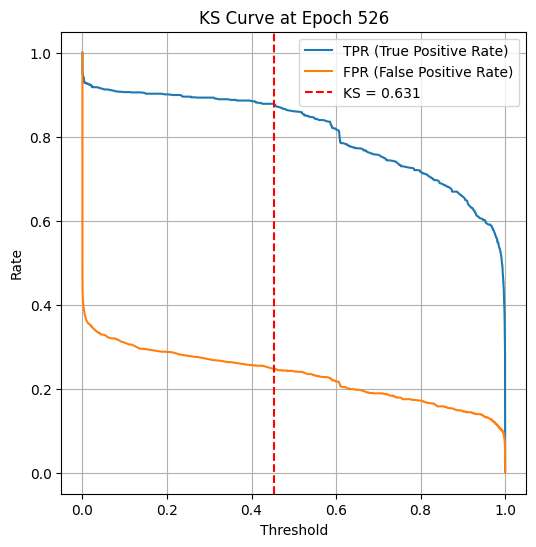

Epoch 530 — Train Loss: 0.1449 | Train Acc: 0.9332 | Val KS: 0.6274 | Val Acc: 0.8075 | Val Prec: 0.7734 | Val Recall: 0.8699 | Val F1: 0.8188
Epoch 540 — Train Loss: 0.1572 | Train Acc: 0.9266 | Val KS: 0.6266 | Val Acc: 0.8125 | Val Prec: 0.7721 | Val Recall: 0.8869 | Val F1: 0.8255


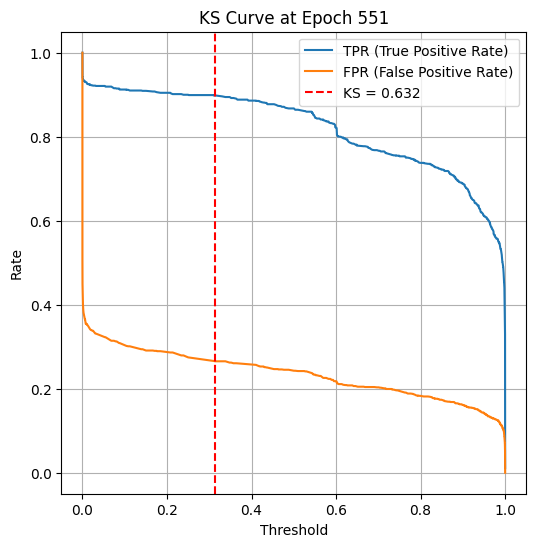

Epoch 550 — Train Loss: 0.1534 | Train Acc: 0.9305 | Val KS: 0.6321 | Val Acc: 0.8118 | Val Prec: 0.7805 | Val Recall: 0.8675 | Val F1: 0.8217
Epoch 560 — Train Loss: 0.1467 | Train Acc: 0.9334 | Val KS: 0.6290 | Val Acc: 0.8118 | Val Prec: 0.7770 | Val Recall: 0.8745 | Val F1: 0.8229
Epoch 570 — Train Loss: 0.1387 | Train Acc: 0.9339 | Val KS: 0.6545 | Val Acc: 0.8257 | Val Prec: 0.7835 | Val Recall: 0.9001 | Val F1: 0.8378


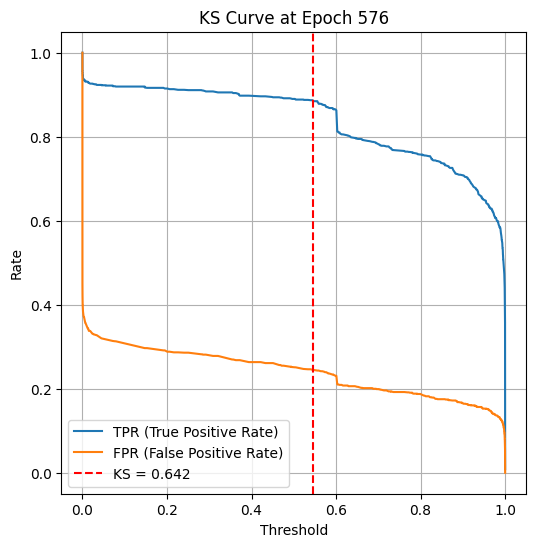

Epoch 580 — Train Loss: 0.1460 | Train Acc: 0.9349 | Val KS: 0.6243 | Val Acc: 0.8098 | Val Prec: 0.7660 | Val Recall: 0.8923 | Val F1: 0.8243
Epoch 590 — Train Loss: 0.1499 | Train Acc: 0.9328 | Val KS: 0.6305 | Val Acc: 0.8141 | Val Prec: 0.7742 | Val Recall: 0.8869 | Val F1: 0.8267


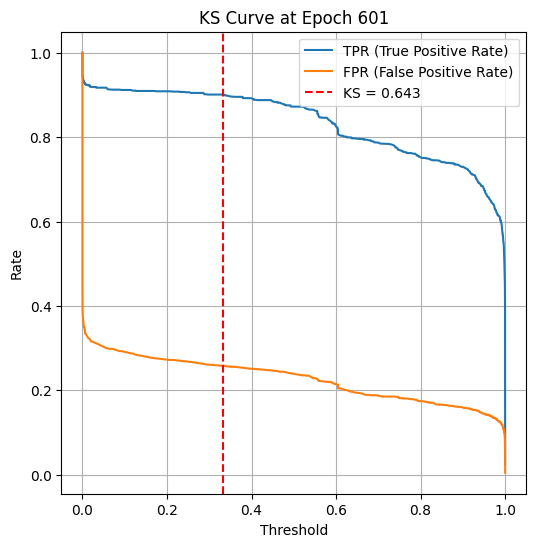

Epoch 600 — Train Loss: 0.1445 | Train Acc: 0.9343 | Val KS: 0.6429 | Val Acc: 0.8168 | Val Prec: 0.7852 | Val Recall: 0.8722 | Val F1: 0.8264
Epoch 610 — Train Loss: 0.1436 | Train Acc: 0.9330 | Val KS: 0.6313 | Val Acc: 0.8145 | Val Prec: 0.7725 | Val Recall: 0.8916 | Val F1: 0.8278
Epoch 620 — Train Loss: 0.1472 | Train Acc: 0.9347 | Val KS: 0.6212 | Val Acc: 0.8060 | Val Prec: 0.7676 | Val Recall: 0.8776 | Val F1: 0.8189


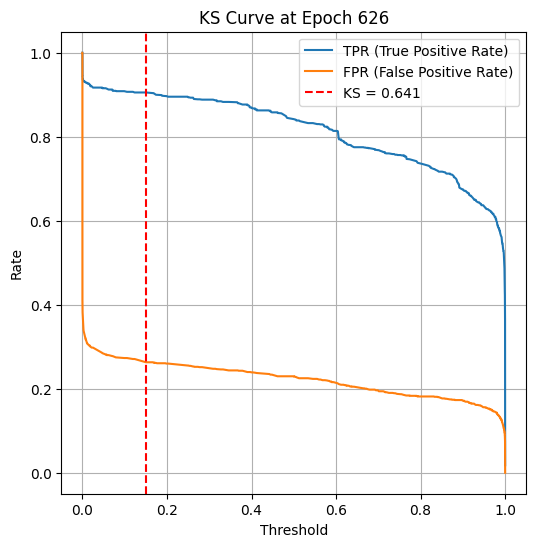

Epoch 630 — Train Loss: 0.1274 | Train Acc: 0.9417 | Val KS: 0.6530 | Val Acc: 0.8187 | Val Prec: 0.7876 | Val Recall: 0.8730 | Val F1: 0.8281
Epoch 640 — Train Loss: 0.1410 | Train Acc: 0.9336 | Val KS: 0.6406 | Val Acc: 0.8199 | Val Prec: 0.7821 | Val Recall: 0.8869 | Val F1: 0.8312


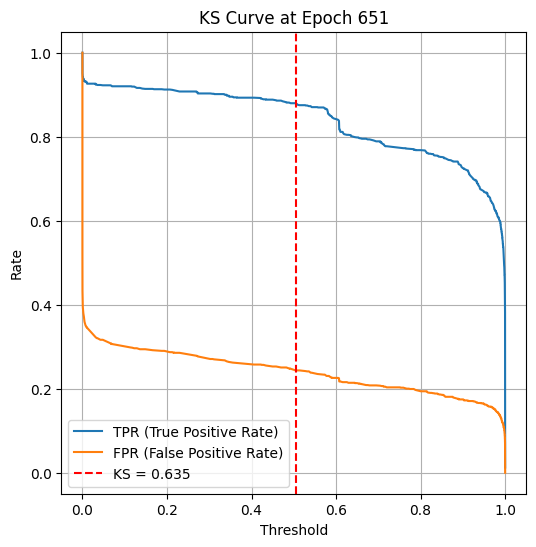

Epoch 650 — Train Loss: 0.1348 | Train Acc: 0.9365 | Val KS: 0.6352 | Val Acc: 0.8168 | Val Prec: 0.7813 | Val Recall: 0.8799 | Val F1: 0.8277
Epoch 660 — Train Loss: 0.1338 | Train Acc: 0.9415 | Val KS: 0.6530 | Val Acc: 0.8253 | Val Prec: 0.7966 | Val Recall: 0.8737 | Val F1: 0.8334
Epoch 670 — Train Loss: 0.1386 | Train Acc: 0.9370 | Val KS: 0.6274 | Val Acc: 0.8110 | Val Prec: 0.7775 | Val Recall: 0.8714 | Val F1: 0.8218


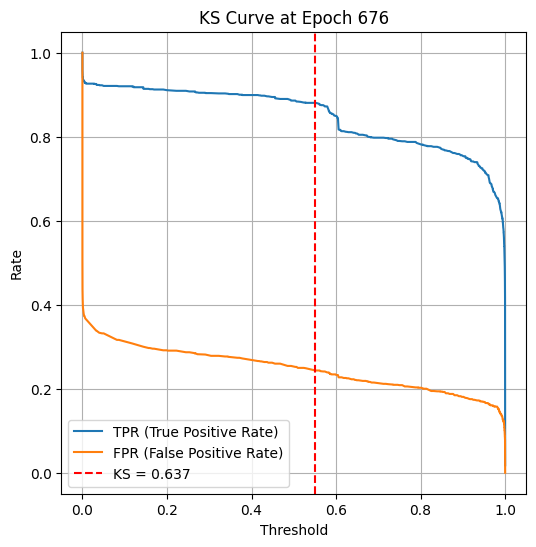

Epoch 680 — Train Loss: 0.1327 | Train Acc: 0.9415 | Val KS: 0.6452 | Val Acc: 0.8207 | Val Prec: 0.7879 | Val Recall: 0.8776 | Val F1: 0.8303
Epoch 690 — Train Loss: 0.1416 | Train Acc: 0.9367 | Val KS: 0.6383 | Val Acc: 0.8137 | Val Prec: 0.7725 | Val Recall: 0.8892 | Val F1: 0.8268


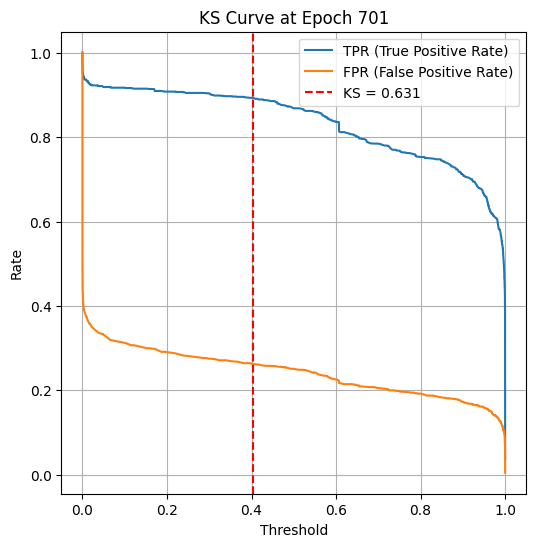

Epoch 700 — Train Loss: 0.1554 | Train Acc: 0.9339 | Val KS: 0.6313 | Val Acc: 0.8091 | Val Prec: 0.7763 | Val Recall: 0.8683 | Val F1: 0.8197
Epoch 710 — Train Loss: 0.1282 | Train Acc: 0.9413 | Val KS: 0.6452 | Val Acc: 0.8176 | Val Prec: 0.7904 | Val Recall: 0.8644 | Val F1: 0.8257
Epoch 720 — Train Loss: 0.1370 | Train Acc: 0.9394 | Val KS: 0.6576 | Val Acc: 0.8261 | Val Prec: 0.7891 | Val Recall: 0.8900 | Val F1: 0.8365


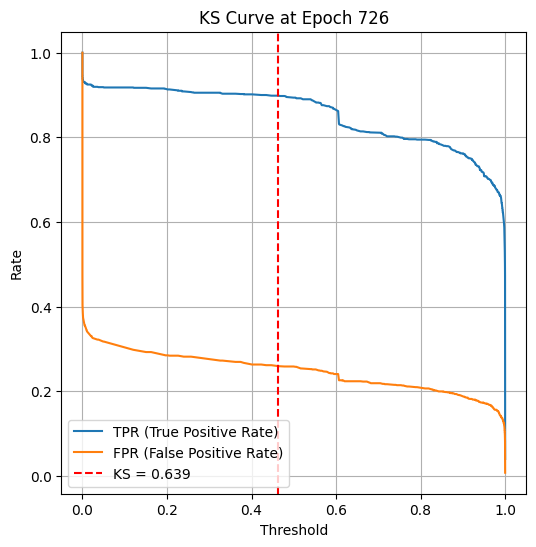

Epoch 730 — Train Loss: 0.1341 | Train Acc: 0.9405 | Val KS: 0.6344 | Val Acc: 0.8145 | Val Prec: 0.7762 | Val Recall: 0.8838 | Val F1: 0.8265
Epoch 740 — Train Loss: 0.1328 | Train Acc: 0.9388 | Val KS: 0.6228 | Val Acc: 0.8091 | Val Prec: 0.7671 | Val Recall: 0.8877 | Val F1: 0.8230


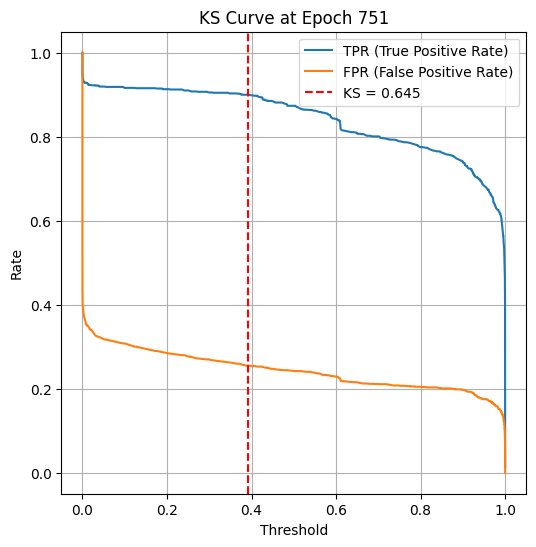

Epoch 750 — Train Loss: 0.1373 | Train Acc: 0.9363 | Val KS: 0.6452 | Val Acc: 0.8156 | Val Prec: 0.7828 | Val Recall: 0.8737 | Val F1: 0.8258
Epoch 760 — Train Loss: 0.1223 | Train Acc: 0.9423 | Val KS: 0.6553 | Val Acc: 0.8265 | Val Prec: 0.7962 | Val Recall: 0.8776 | Val F1: 0.8349
Epoch 770 — Train Loss: 0.1193 | Train Acc: 0.9438 | Val KS: 0.6390 | Val Acc: 0.8172 | Val Prec: 0.7784 | Val Recall: 0.8869 | Val F1: 0.8291


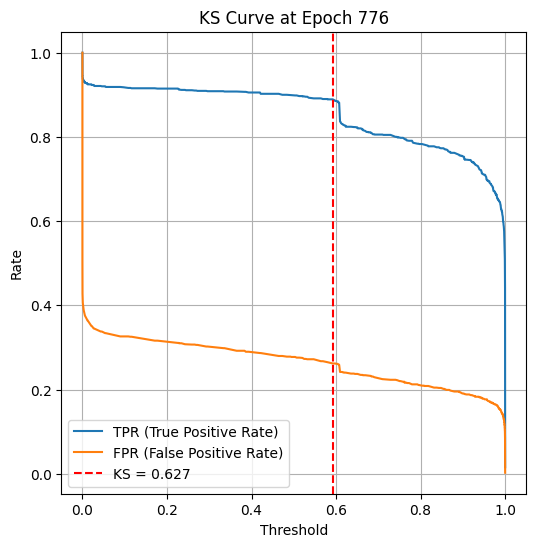

Epoch 780 — Train Loss: 0.1333 | Train Acc: 0.9388 | Val KS: 0.6390 | Val Acc: 0.8184 | Val Prec: 0.7819 | Val Recall: 0.8830 | Val F1: 0.8294
Epoch 790 — Train Loss: 0.1147 | Train Acc: 0.9475 | Val KS: 0.6437 | Val Acc: 0.8211 | Val Prec: 0.7825 | Val Recall: 0.8892 | Val F1: 0.8325


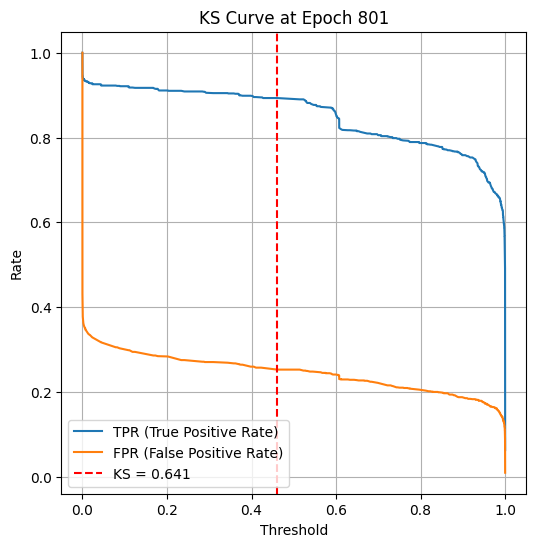

Epoch 800 — Train Loss: 0.1190 | Train Acc: 0.9456 | Val KS: 0.6406 | Val Acc: 0.8187 | Val Prec: 0.7790 | Val Recall: 0.8900 | Val F1: 0.8308
Epoch 810 — Train Loss: 0.1167 | Train Acc: 0.9465 | Val KS: 0.6344 | Val Acc: 0.8087 | Val Prec: 0.7743 | Val Recall: 0.8714 | Val F1: 0.8200
Epoch 820 — Train Loss: 0.1235 | Train Acc: 0.9448 | Val KS: 0.6282 | Val Acc: 0.8079 | Val Prec: 0.7702 | Val Recall: 0.8776 | Val F1: 0.8204


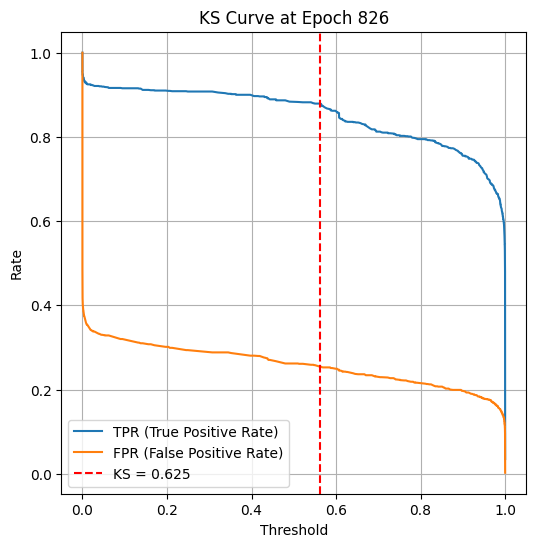

Epoch 830 — Train Loss: 0.1190 | Train Acc: 0.9452 | Val KS: 0.6336 | Val Acc: 0.8160 | Val Prec: 0.7746 | Val Recall: 0.8916 | Val F1: 0.8290
Epoch 840 — Train Loss: 0.1337 | Train Acc: 0.9409 | Val KS: 0.6476 | Val Acc: 0.8180 | Val Prec: 0.7893 | Val Recall: 0.8675 | Val F1: 0.8266


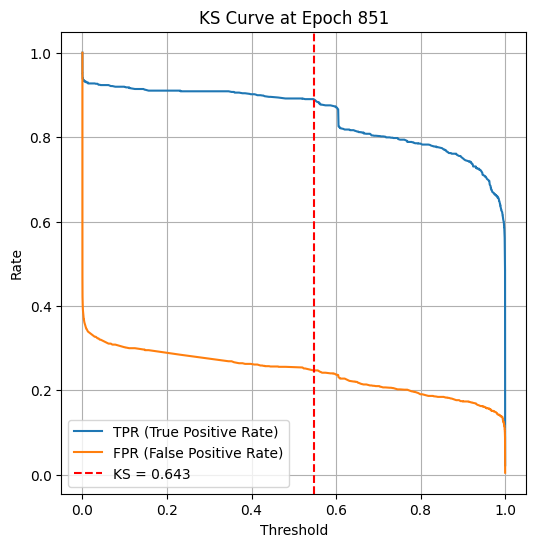

Epoch 850 — Train Loss: 0.1201 | Train Acc: 0.9440 | Val KS: 0.6429 | Val Acc: 0.8187 | Val Prec: 0.7782 | Val Recall: 0.8916 | Val F1: 0.8310
Epoch 860 — Train Loss: 0.1212 | Train Acc: 0.9475 | Val KS: 0.6538 | Val Acc: 0.8218 | Val Prec: 0.7904 | Val Recall: 0.8761 | Val F1: 0.8310
Epoch 870 — Train Loss: 0.1153 | Train Acc: 0.9471 | Val KS: 0.6305 | Val Acc: 0.8149 | Val Prec: 0.7745 | Val Recall: 0.8885 | Val F1: 0.8276


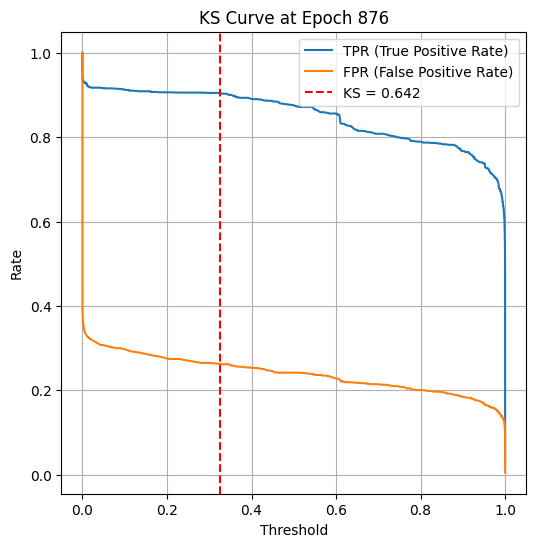

Epoch 880 — Train Loss: 0.1125 | Train Acc: 0.9494 | Val KS: 0.6297 | Val Acc: 0.8122 | Val Prec: 0.7768 | Val Recall: 0.8761 | Val F1: 0.8234
Epoch 890 — Train Loss: 0.1208 | Train Acc: 0.9485 | Val KS: 0.6468 | Val Acc: 0.8211 | Val Prec: 0.7803 | Val Recall: 0.8939 | Val F1: 0.8332


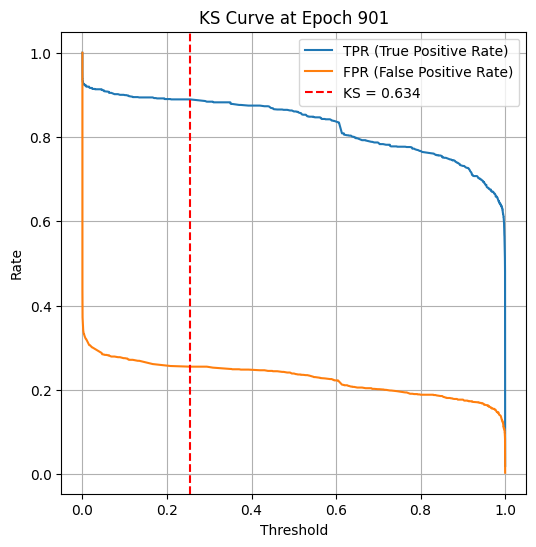

Epoch 900 — Train Loss: 0.1229 | Train Acc: 0.9467 | Val KS: 0.6344 | Val Acc: 0.8110 | Val Prec: 0.7829 | Val Recall: 0.8606 | Val F1: 0.8199
Epoch 910 — Train Loss: 0.1089 | Train Acc: 0.9506 | Val KS: 0.6406 | Val Acc: 0.8133 | Val Prec: 0.7803 | Val Recall: 0.8722 | Val F1: 0.8237
Epoch 920 — Train Loss: 0.1147 | Train Acc: 0.9502 | Val KS: 0.6429 | Val Acc: 0.8195 | Val Prec: 0.7851 | Val Recall: 0.8799 | Val F1: 0.8298


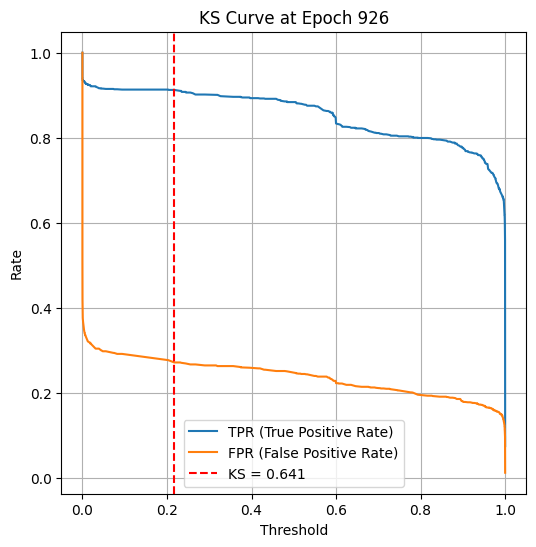

Epoch 930 — Train Loss: 0.1147 | Train Acc: 0.9481 | Val KS: 0.6243 | Val Acc: 0.8087 | Val Prec: 0.7762 | Val Recall: 0.8675 | Val F1: 0.8193
Epoch 940 — Train Loss: 0.1152 | Train Acc: 0.9489 | Val KS: 0.6491 | Val Acc: 0.8215 | Val Prec: 0.7890 | Val Recall: 0.8776 | Val F1: 0.8309


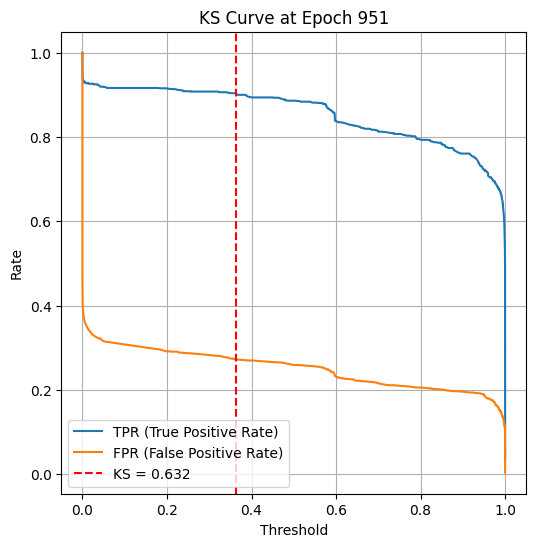

Epoch 950 — Train Loss: 0.1147 | Train Acc: 0.9491 | Val KS: 0.6321 | Val Acc: 0.8137 | Val Prec: 0.7740 | Val Recall: 0.8861 | Val F1: 0.8263
Epoch 960 — Train Loss: 0.1028 | Train Acc: 0.9500 | Val KS: 0.6452 | Val Acc: 0.8211 | Val Prec: 0.7841 | Val Recall: 0.8861 | Val F1: 0.8320
Epoch 970 — Train Loss: 0.1175 | Train Acc: 0.9465 | Val KS: 0.6514 | Val Acc: 0.8249 | Val Prec: 0.7969 | Val Recall: 0.8722 | Val F1: 0.8328


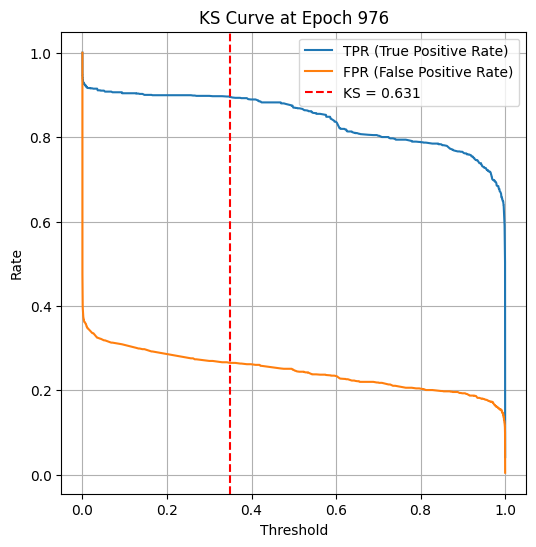

Epoch 980 — Train Loss: 0.1204 | Train Acc: 0.9465 | Val KS: 0.6344 | Val Acc: 0.8164 | Val Prec: 0.7800 | Val Recall: 0.8815 | Val F1: 0.8276
Epoch 990 — Train Loss: 0.1096 | Train Acc: 0.9471 | Val KS: 0.6476 | Val Acc: 0.8222 | Val Prec: 0.7845 | Val Recall: 0.8885 | Val F1: 0.8333
Epoch 999 — Train Loss: 0.1032 | Train Acc: 0.9516 | Val KS: 0.6266 | Val Acc: 0.8087 | Val Prec: 0.7765 | Val Recall: 0.8668 | Val F1: 0.8192


In [ ]:

# Model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = STABTransformer(input_dim=X_train_tensor.shape[1], n_heads=16, n_layers=1, dropout=0.3).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
loss_fn = nn.BCELoss()


epochs=1000
for epoch in range(epochs):
    model.train()
    epoch_loss = 0

    all_preds = []
    all_targets = []

    for xb, yb in train_loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).squeeze()
        loss = loss_fn(pred, yb)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()

        preds_np = (pred > 0.5).detach().cpu().numpy()
        targets_np = yb.detach().cpu().numpy()

        all_preds.extend(preds_np)
        all_targets.extend(targets_np)

    # Training metrics
    acc = accuracy_score(all_targets, all_preds)
    prec = precision_score(all_targets, all_preds)
    rec = recall_score(all_targets, all_preds)
    f1 = f1_score(all_targets, all_preds)

    # Validation metrics
    ks_val, acc_val, prec_val, rec_val, f1_val = evaluate_validation(model, val_loader, device, epoch)

    if epoch % 10 == 0 or epoch == epochs - 1:
        print(f"Epoch {epoch:03d} — Train Loss: {epoch_loss/len(train_loader):.4f} | "
              f"Train Acc: {acc:.4f} | Val KS: {ks_val:.4f} | Val Acc: {acc_val:.4f} | "
              f"Val Prec: {prec_val:.4f} | Val Recall: {rec_val:.4f} | Val F1: {f1_val:.4f}")


In [ ]:

torch.save(model.state_dict(), 'stab_transformer_16head_1layer_0.1droput_1000epochs.pt')
files.download('stab_transformer_16head_1layer_0.1droput_1000epochs.pt')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

✅ Accuracy: 0.8451
✅ Precision: 0.8157
✅ Recall: 0.8916
✅ F1 Score: 0.8520


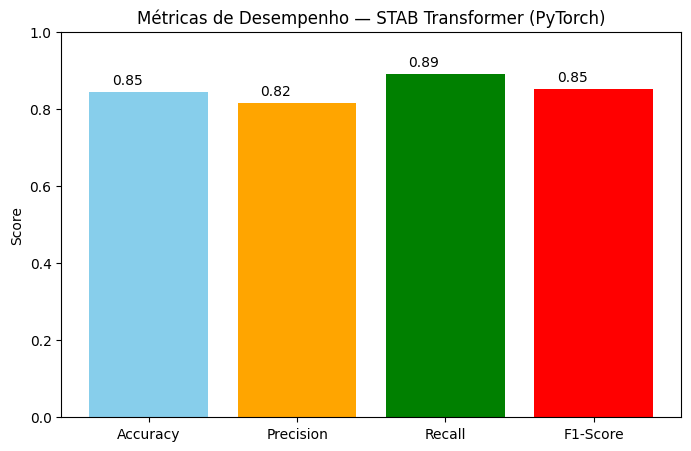

In [ ]:
model.eval()
X_test_tensor = torch.tensor(X_test_nn, dtype=torch.float32)
y_test_tensor = torch.tensor(y_test_nn.values, dtype=torch.float32)  # <-- Aqui está o fix

with torch.no_grad():
    y_pred_prob = model(X_test_tensor.to(device)).cpu().squeeze().numpy()
    y_pred = (y_pred_prob >= 0.5).astype(int)

acc = accuracy_score(y_test_nn, y_pred)
prec = precision_score(y_test_nn, y_pred)
rec = recall_score(y_test_nn, y_pred)
f1 = f1_score(y_test_nn, y_pred)

print(f"✅ Accuracy: {acc:.4f}")
print(f"✅ Precision: {prec:.4f}")
print(f"✅ Recall: {rec:.4f}")
print(f"✅ F1 Score: {f1:.4f}")

metrics_names = ['Accuracy', 'Precision', 'Recall', 'F1-Score']
metrics_values = [acc, prec, rec, f1]

plt.figure(figsize=(8, 5))
bars = plt.bar(metrics_names, metrics_values, color=['skyblue', 'orange', 'green', 'red'])
plt.ylim(0, 1)
plt.title('Métricas de Desempenho — STAB Transformer (PyTorch)')
plt.ylabel('Score')
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + 0.15, yval + 0.02, f'{yval:.2f}')
plt.show()



✅ Accuracy: 0.8087
✅ Precision: 0.7765
✅ Recall: 0.8668
✅ F1 Score: 0.8192


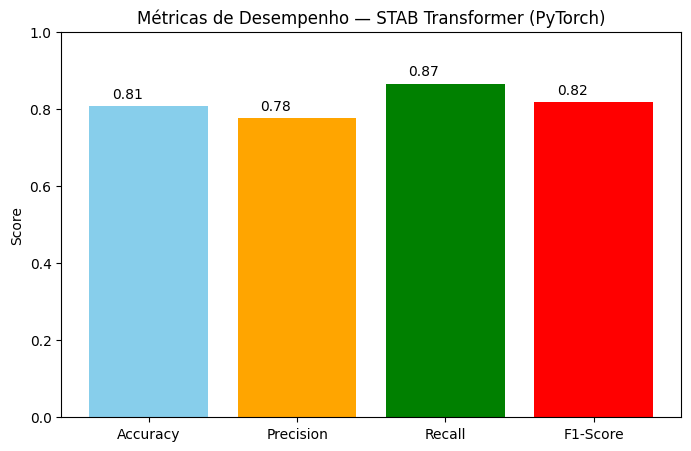

In [ ]:
model.eval()
X_test_tensor = torch.tensor(X_val_nn, dtype=torch.float32)
y_test_tensor = torch.tensor(y_val_nn.values, dtype=torch.float32)  # <-- Aqui está o fix

with torch.no_grad():
    y_pred_prob = model(X_test_tensor.to(device)).cpu().squeeze().numpy()
    y_pred = (y_pred_prob >= 0.5).astype(int)

acc = accuracy_score(y_test_nn, y_pred)
prec = precision_score(y_test_nn, y_pred)
rec = recall_score(y_test_nn, y_pred)
f1 = f1_score(y_test_nn, y_pred)

print(f"✅ Accuracy: {acc:.4f}")
print(f"✅ Precision: {prec:.4f}")
print(f"✅ Recall: {rec:.4f}")
print(f"✅ F1 Score: {f1:.4f}")

metrics_names = ['Accuracy', 'Precision', 'Recall', 'F1-Score']
metrics_values = [acc, prec, rec, f1]

plt.figure(figsize=(8, 5))
bars = plt.bar(metrics_names, metrics_values, color=['skyblue', 'orange', 'green', 'red'])
plt.ylim(0, 1)
plt.title('Métricas de Desempenho — STAB Transformer (PyTorch)')
plt.ylabel('Score')
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + 0.15, yval + 0.02, f'{yval:.2f}')
plt.show()



### Experimentação 6

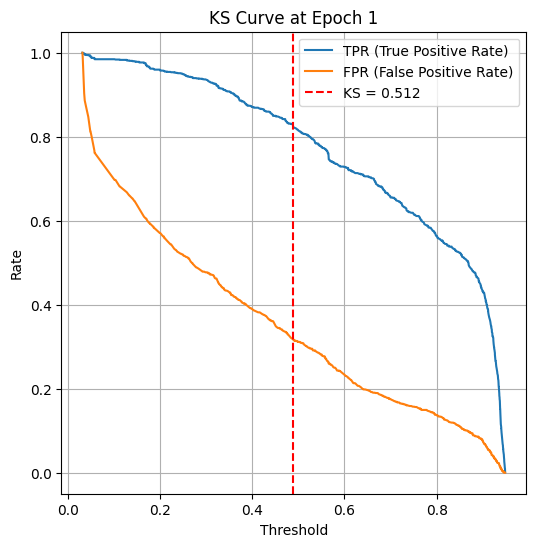

Epoch 000 — Train Loss: 0.5368 | Train Acc: 0.7431 | Val KS: 0.5120 | Val Acc: 0.7514 | Val Prec: 0.7233 | Val Recall: 0.8141 | Val F1: 0.7660
Epoch 010 — Train Loss: 0.4900 | Train Acc: 0.7654 | Val KS: 0.5112 | Val Acc: 0.7517 | Val Prec: 0.7531 | Val Recall: 0.7490 | Val F1: 0.7511
Epoch 020 — Train Loss: 0.4787 | Train Acc: 0.7648 | Val KS: 0.5275 | Val Acc: 0.7603 | Val Prec: 0.7320 | Val Recall: 0.8211 | Val F1: 0.7740


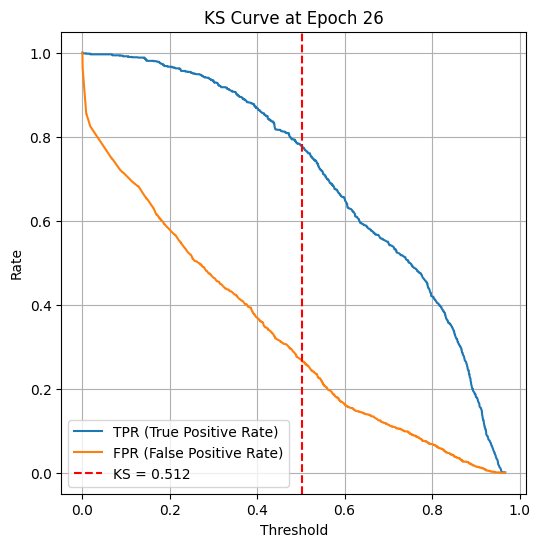

Epoch 030 — Train Loss: 0.4627 | Train Acc: 0.7718 | Val KS: 0.5236 | Val Acc: 0.7529 | Val Prec: 0.7696 | Val Recall: 0.7219 | Val F1: 0.7450
Epoch 040 — Train Loss: 0.4460 | Train Acc: 0.7755 | Val KS: 0.5236 | Val Acc: 0.7603 | Val Prec: 0.7366 | Val Recall: 0.8102 | Val F1: 0.7717


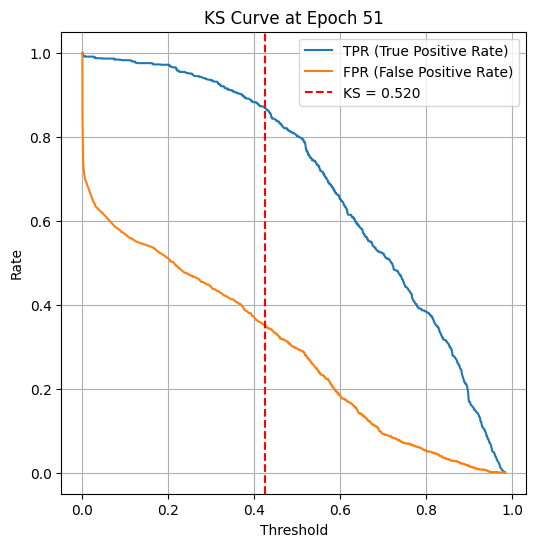

Epoch 050 — Train Loss: 0.4213 | Train Acc: 0.7921 | Val KS: 0.5198 | Val Acc: 0.7533 | Val Prec: 0.7309 | Val Recall: 0.8017 | Val F1: 0.7647
Epoch 060 — Train Loss: 0.3974 | Train Acc: 0.8115 | Val KS: 0.5507 | Val Acc: 0.7637 | Val Prec: 0.7379 | Val Recall: 0.8180 | Val F1: 0.7759
Epoch 070 — Train Loss: 0.3734 | Train Acc: 0.8196 | Val KS: 0.5562 | Val Acc: 0.7738 | Val Prec: 0.7523 | Val Recall: 0.8164 | Val F1: 0.7831


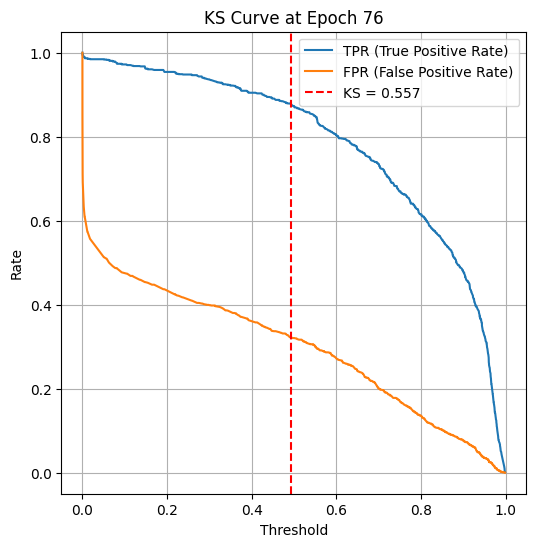

Epoch 080 — Train Loss: 0.3561 | Train Acc: 0.8289 | Val KS: 0.5445 | Val Acc: 0.7665 | Val Prec: 0.7281 | Val Recall: 0.8505 | Val F1: 0.7846
Epoch 090 — Train Loss: 0.3313 | Train Acc: 0.8464 | Val KS: 0.5608 | Val Acc: 0.7723 | Val Prec: 0.7249 | Val Recall: 0.8776 | Val F1: 0.7940


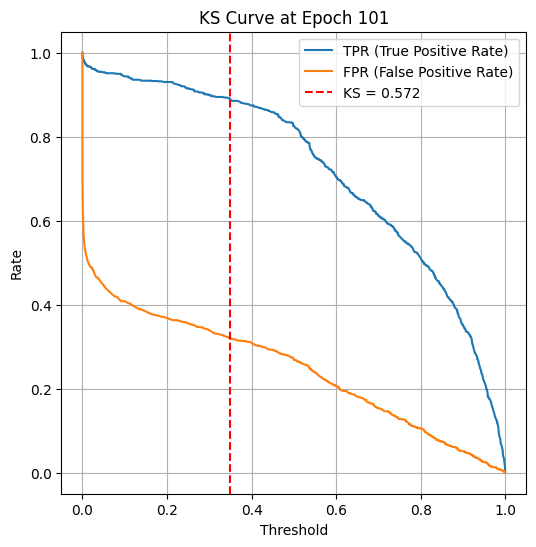

Epoch 100 — Train Loss: 0.3264 | Train Acc: 0.8450 | Val KS: 0.5724 | Val Acc: 0.7781 | Val Prec: 0.7542 | Val Recall: 0.8249 | Val F1: 0.7880
Epoch 110 — Train Loss: 0.3126 | Train Acc: 0.8549 | Val KS: 0.5825 | Val Acc: 0.7866 | Val Prec: 0.7396 | Val Recall: 0.8846 | Val F1: 0.8056
Epoch 120 — Train Loss: 0.3044 | Train Acc: 0.8588 | Val KS: 0.5910 | Val Acc: 0.7916 | Val Prec: 0.7642 | Val Recall: 0.8435 | Val F1: 0.8019


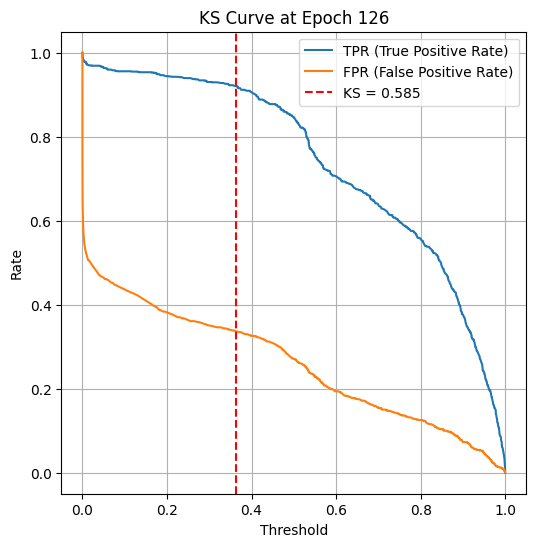

Epoch 130 — Train Loss: 0.2940 | Train Acc: 0.8640 | Val KS: 0.5964 | Val Acc: 0.7885 | Val Prec: 0.7610 | Val Recall: 0.8412 | Val F1: 0.7991
Epoch 140 — Train Loss: 0.2902 | Train Acc: 0.8644 | Val KS: 0.6003 | Val Acc: 0.7982 | Val Prec: 0.7550 | Val Recall: 0.8830 | Val F1: 0.8140


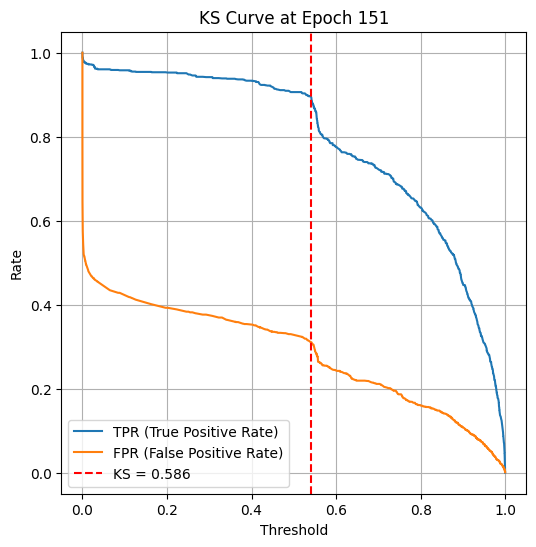

Epoch 150 — Train Loss: 0.2905 | Train Acc: 0.8646 | Val KS: 0.5856 | Val Acc: 0.7893 | Val Prec: 0.7345 | Val Recall: 0.9063 | Val F1: 0.8114
Epoch 160 — Train Loss: 0.2691 | Train Acc: 0.8727 | Val KS: 0.5864 | Val Acc: 0.7920 | Val Prec: 0.7395 | Val Recall: 0.9016 | Val F1: 0.8126
Epoch 170 — Train Loss: 0.2732 | Train Acc: 0.8704 | Val KS: 0.5817 | Val Acc: 0.7851 | Val Prec: 0.7450 | Val Recall: 0.8668 | Val F1: 0.8013


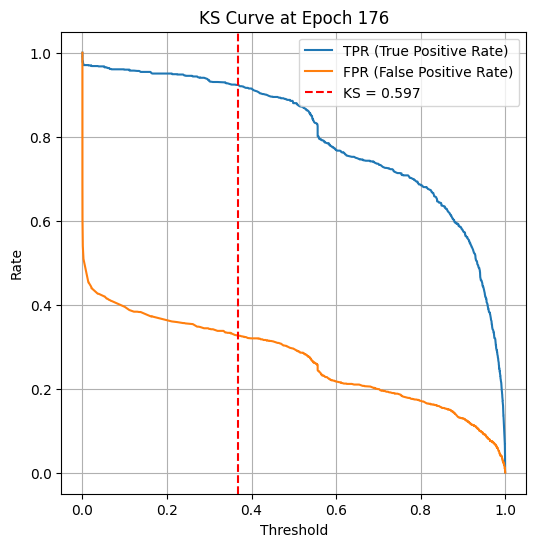

Epoch 180 — Train Loss: 0.2702 | Train Acc: 0.8760 | Val KS: 0.6011 | Val Acc: 0.7928 | Val Prec: 0.7477 | Val Recall: 0.8838 | Val F1: 0.8101
Epoch 190 — Train Loss: 0.2685 | Train Acc: 0.8710 | Val KS: 0.6057 | Val Acc: 0.7967 | Val Prec: 0.7526 | Val Recall: 0.8838 | Val F1: 0.8130


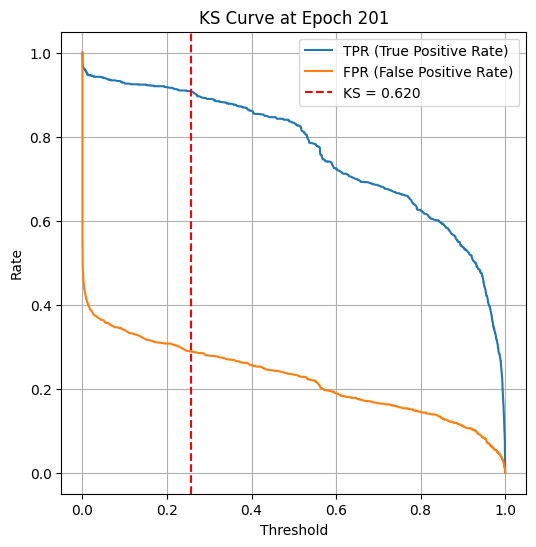

Epoch 200 — Train Loss: 0.2645 | Train Acc: 0.8760 | Val KS: 0.6204 | Val Acc: 0.8002 | Val Prec: 0.7814 | Val Recall: 0.8335 | Val F1: 0.8066
Epoch 210 — Train Loss: 0.2584 | Train Acc: 0.8793 | Val KS: 0.6135 | Val Acc: 0.7982 | Val Prec: 0.7670 | Val Recall: 0.8567 | Val F1: 0.8094
Epoch 220 — Train Loss: 0.2533 | Train Acc: 0.8787 | Val KS: 0.6181 | Val Acc: 0.8025 | Val Prec: 0.7602 | Val Recall: 0.8838 | Val F1: 0.8173


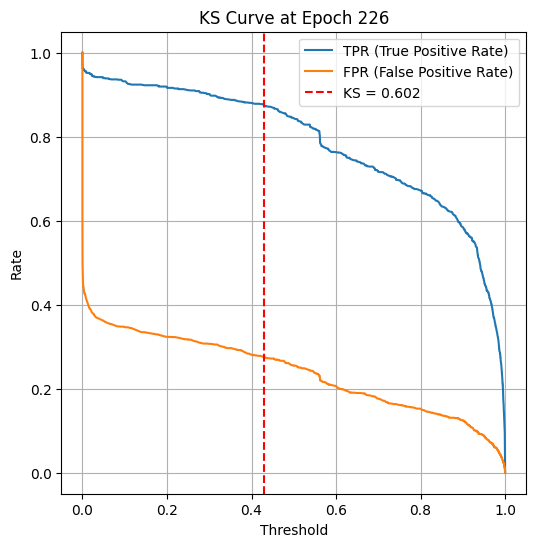

Epoch 230 — Train Loss: 0.2519 | Train Acc: 0.8822 | Val KS: 0.6088 | Val Acc: 0.8029 | Val Prec: 0.7559 | Val Recall: 0.8947 | Val F1: 0.8194
Epoch 240 — Train Loss: 0.2517 | Train Acc: 0.8840 | Val KS: 0.6220 | Val Acc: 0.7971 | Val Prec: 0.7706 | Val Recall: 0.8459 | Val F1: 0.8065


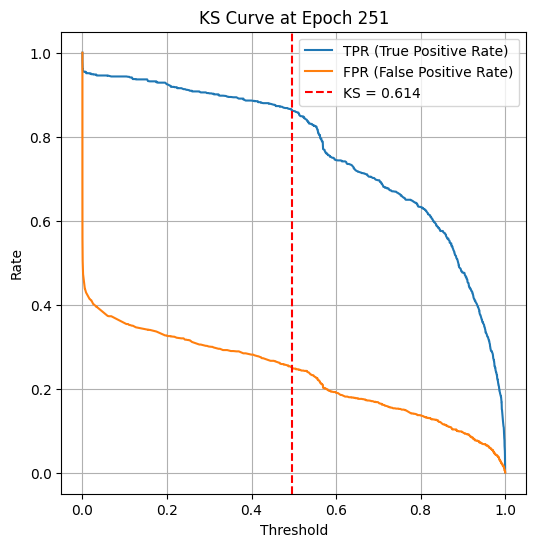

Epoch 250 — Train Loss: 0.2485 | Train Acc: 0.8851 | Val KS: 0.6143 | Val Acc: 0.8064 | Val Prec: 0.7764 | Val Recall: 0.8606 | Val F1: 0.8163
Epoch 260 — Train Loss: 0.2550 | Train Acc: 0.8812 | Val KS: 0.6228 | Val Acc: 0.8087 | Val Prec: 0.7709 | Val Recall: 0.8784 | Val F1: 0.8211
Epoch 270 — Train Loss: 0.2421 | Train Acc: 0.8907 | Val KS: 0.6181 | Val Acc: 0.8040 | Val Prec: 0.7834 | Val Recall: 0.8404 | Val F1: 0.8109


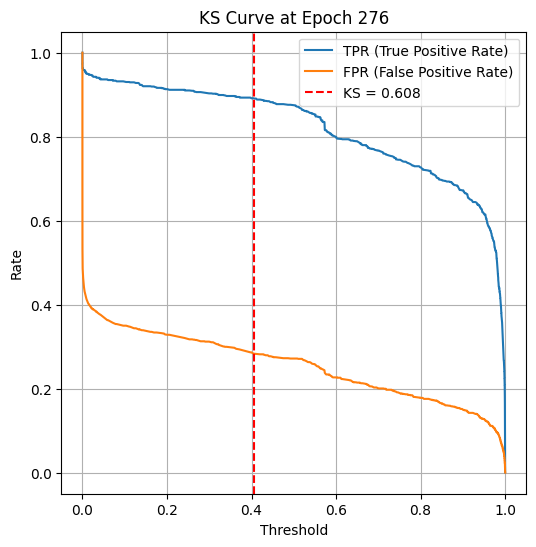

Epoch 280 — Train Loss: 0.2400 | Train Acc: 0.8873 | Val KS: 0.6150 | Val Acc: 0.7963 | Val Prec: 0.7726 | Val Recall: 0.8397 | Val F1: 0.8048
Epoch 290 — Train Loss: 0.2360 | Train Acc: 0.8925 | Val KS: 0.6228 | Val Acc: 0.8048 | Val Prec: 0.7809 | Val Recall: 0.8474 | Val F1: 0.8128


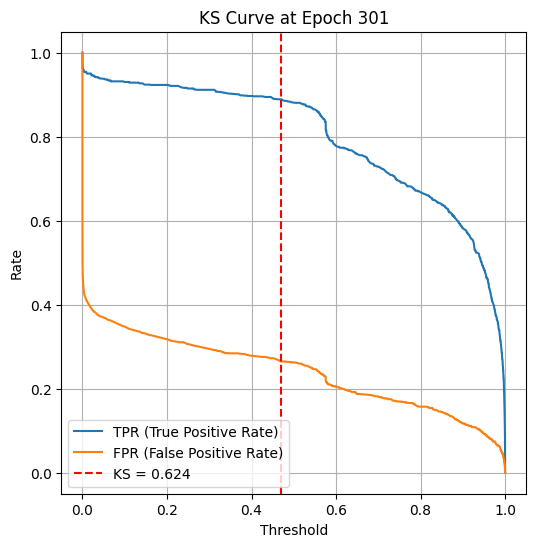

Epoch 300 — Train Loss: 0.2377 | Train Acc: 0.8913 | Val KS: 0.6243 | Val Acc: 0.8091 | Val Prec: 0.7703 | Val Recall: 0.8807 | Val F1: 0.8218
Epoch 310 — Train Loss: 0.2336 | Train Acc: 0.8923 | Val KS: 0.6104 | Val Acc: 0.8044 | Val Prec: 0.7582 | Val Recall: 0.8939 | Val F1: 0.8205
Epoch 320 — Train Loss: 0.2327 | Train Acc: 0.8884 | Val KS: 0.5980 | Val Acc: 0.7971 | Val Prec: 0.7531 | Val Recall: 0.8838 | Val F1: 0.8133


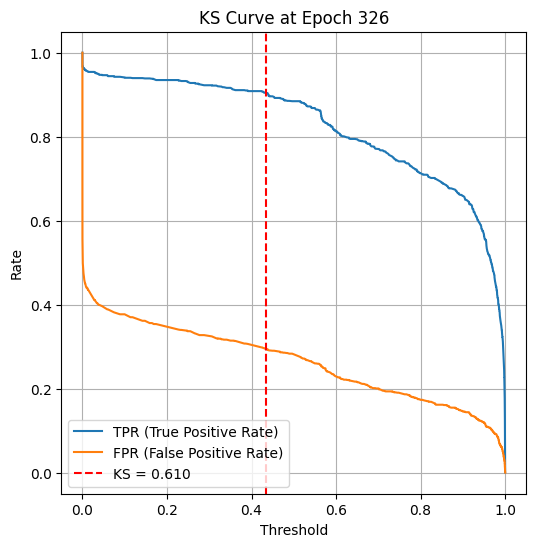

Epoch 330 — Train Loss: 0.2451 | Train Acc: 0.8876 | Val KS: 0.5988 | Val Acc: 0.7971 | Val Prec: 0.7515 | Val Recall: 0.8877 | Val F1: 0.8139
Epoch 340 — Train Loss: 0.2418 | Train Acc: 0.8938 | Val KS: 0.5902 | Val Acc: 0.7916 | Val Prec: 0.7421 | Val Recall: 0.8939 | Val F1: 0.8110


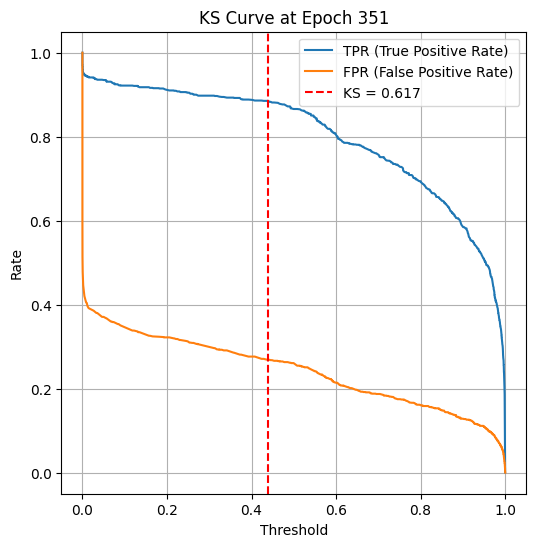

Epoch 350 — Train Loss: 0.2304 | Train Acc: 0.8966 | Val KS: 0.6166 | Val Acc: 0.8033 | Val Prec: 0.7694 | Val Recall: 0.8660 | Val F1: 0.8149
Epoch 360 — Train Loss: 0.2366 | Train Acc: 0.8952 | Val KS: 0.5933 | Val Acc: 0.7924 | Val Prec: 0.7479 | Val Recall: 0.8823 | Val F1: 0.8095
Epoch 370 — Train Loss: 0.2341 | Train Acc: 0.8929 | Val KS: 0.5918 | Val Acc: 0.7796 | Val Prec: 0.7911 | Val Recall: 0.7599 | Val F1: 0.7752


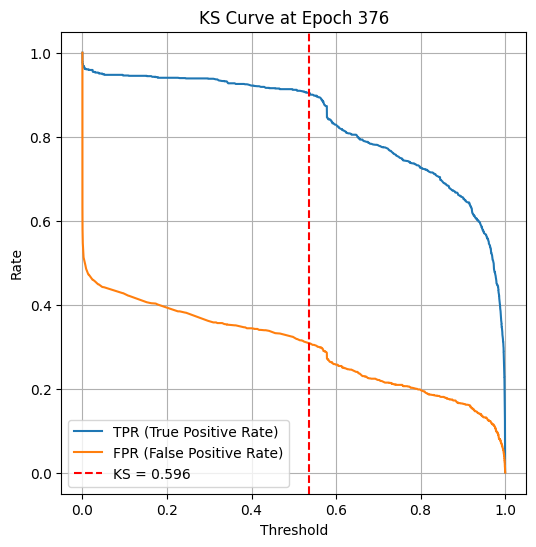

Epoch 380 — Train Loss: 0.2354 | Train Acc: 0.8919 | Val KS: 0.6065 | Val Acc: 0.7967 | Val Prec: 0.7736 | Val Recall: 0.8389 | Val F1: 0.8049
Epoch 390 — Train Loss: 0.2298 | Train Acc: 0.8962 | Val KS: 0.6057 | Val Acc: 0.8013 | Val Prec: 0.7694 | Val Recall: 0.8606 | Val F1: 0.8124


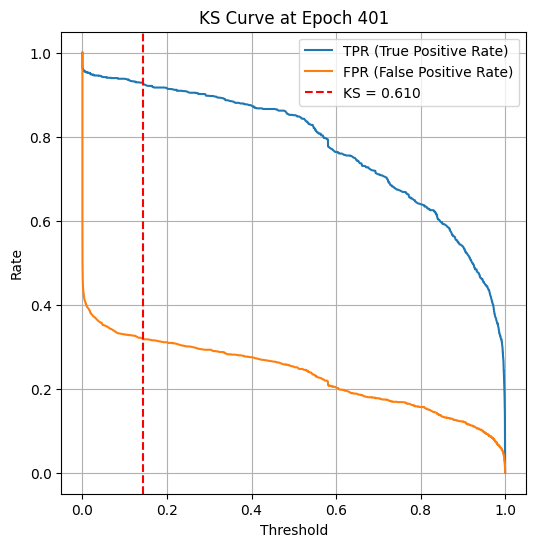

Epoch 400 — Train Loss: 0.2354 | Train Acc: 0.8942 | Val KS: 0.6104 | Val Acc: 0.7998 | Val Prec: 0.7718 | Val Recall: 0.8513 | Val F1: 0.8096
Epoch 410 — Train Loss: 0.2291 | Train Acc: 0.8987 | Val KS: 0.6290 | Val Acc: 0.8098 | Val Prec: 0.7770 | Val Recall: 0.8691 | Val F1: 0.8205
Epoch 420 — Train Loss: 0.2208 | Train Acc: 0.8973 | Val KS: 0.6065 | Val Acc: 0.7936 | Val Prec: 0.7707 | Val Recall: 0.8358 | Val F1: 0.8019


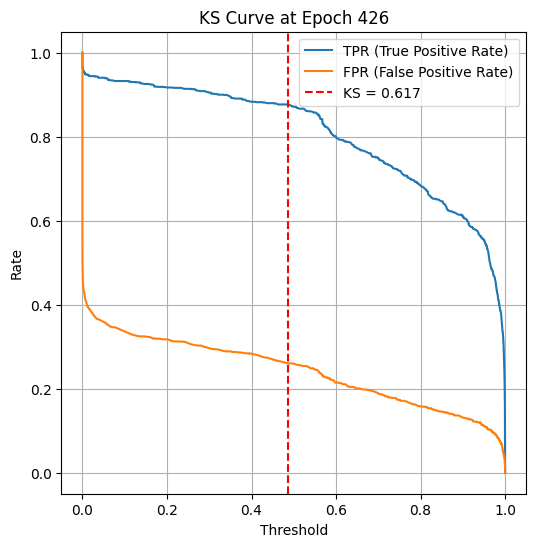

Epoch 430 — Train Loss: 0.2295 | Train Acc: 0.8966 | Val KS: 0.6197 | Val Acc: 0.8087 | Val Prec: 0.7606 | Val Recall: 0.9009 | Val F1: 0.8248
Epoch 440 — Train Loss: 0.2198 | Train Acc: 0.9002 | Val KS: 0.6081 | Val Acc: 0.7874 | Val Prec: 0.7997 | Val Recall: 0.7668 | Val F1: 0.7829


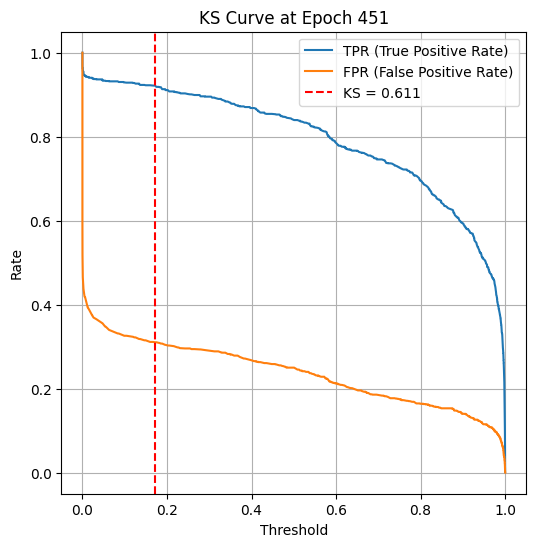

Epoch 450 — Train Loss: 0.2295 | Train Acc: 0.8981 | Val KS: 0.6112 | Val Acc: 0.7947 | Val Prec: 0.7704 | Val Recall: 0.8397 | Val F1: 0.8036
Epoch 460 — Train Loss: 0.2237 | Train Acc: 0.8973 | Val KS: 0.5895 | Val Acc: 0.7936 | Val Prec: 0.7414 | Val Recall: 0.9016 | Val F1: 0.8137
Epoch 470 — Train Loss: 0.2332 | Train Acc: 0.8969 | Val KS: 0.6104 | Val Acc: 0.8029 | Val Prec: 0.7614 | Val Recall: 0.8823 | Val F1: 0.8174


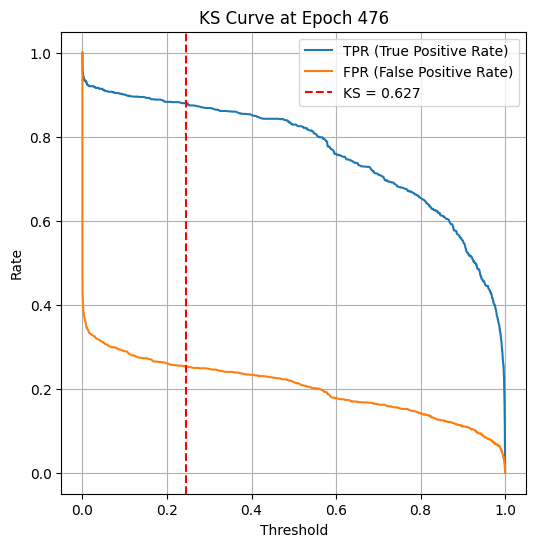

Epoch 480 — Train Loss: 0.2261 | Train Acc: 0.9004 | Val KS: 0.6135 | Val Acc: 0.8029 | Val Prec: 0.7494 | Val Recall: 0.9101 | Val F1: 0.8220
Epoch 490 — Train Loss: 0.2336 | Train Acc: 0.9000 | Val KS: 0.6026 | Val Acc: 0.7990 | Val Prec: 0.7587 | Val Recall: 0.8768 | Val F1: 0.8135


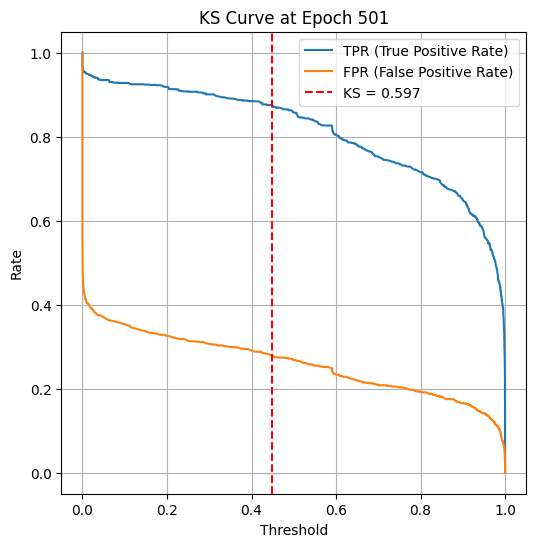

Epoch 500 — Train Loss: 0.2147 | Train Acc: 0.9059 | Val KS: 0.5972 | Val Acc: 0.7943 | Val Prec: 0.7613 | Val Recall: 0.8575 | Val F1: 0.8066
Epoch 510 — Train Loss: 0.2367 | Train Acc: 0.8989 | Val KS: 0.6003 | Val Acc: 0.7982 | Val Prec: 0.7615 | Val Recall: 0.8683 | Val F1: 0.8114
Epoch 520 — Train Loss: 0.2244 | Train Acc: 0.8985 | Val KS: 0.6197 | Val Acc: 0.8060 | Val Prec: 0.7644 | Val Recall: 0.8846 | Val F1: 0.8201


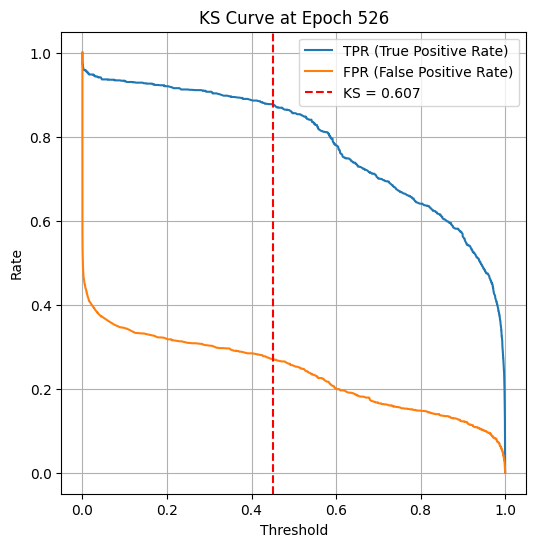

Epoch 530 — Train Loss: 0.2279 | Train Acc: 0.8987 | Val KS: 0.6011 | Val Acc: 0.7947 | Val Prec: 0.7663 | Val Recall: 0.8482 | Val F1: 0.8051
Epoch 540 — Train Loss: 0.2305 | Train Acc: 0.8948 | Val KS: 0.6088 | Val Acc: 0.8021 | Val Prec: 0.7754 | Val Recall: 0.8505 | Val F1: 0.8112


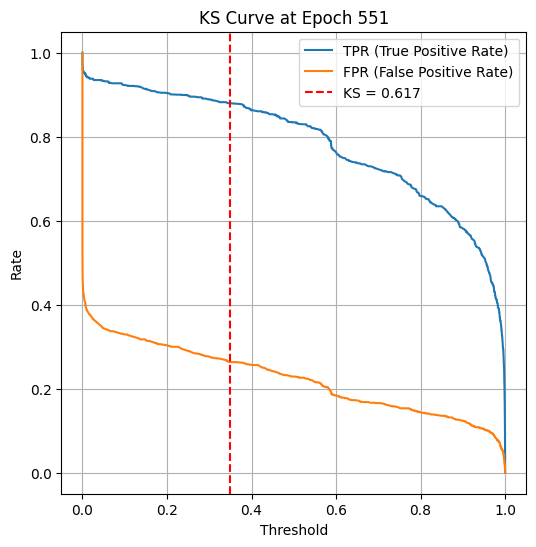

Epoch 550 — Train Loss: 0.2232 | Train Acc: 0.9055 | Val KS: 0.6166 | Val Acc: 0.8029 | Val Prec: 0.7850 | Val Recall: 0.8342 | Val F1: 0.8089
Epoch 560 — Train Loss: 0.2271 | Train Acc: 0.8958 | Val KS: 0.5879 | Val Acc: 0.7874 | Val Prec: 0.7259 | Val Recall: 0.9233 | Val F1: 0.8128
Epoch 570 — Train Loss: 0.2360 | Train Acc: 0.8952 | Val KS: 0.5926 | Val Acc: 0.7920 | Val Prec: 0.7572 | Val Recall: 0.8598 | Val F1: 0.8052


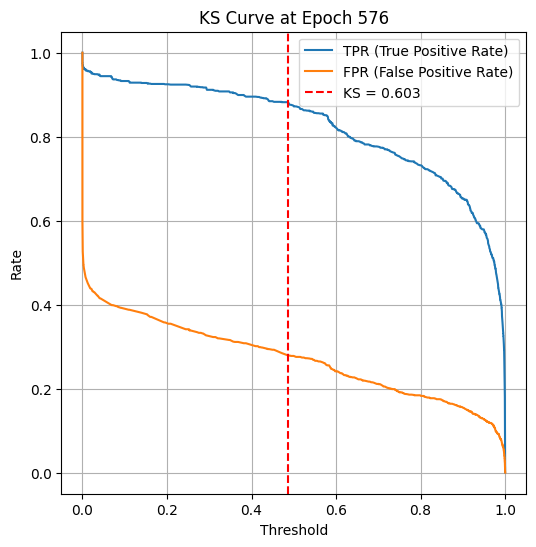

Epoch 580 — Train Loss: 0.2251 | Train Acc: 0.8967 | Val KS: 0.6158 | Val Acc: 0.8067 | Val Prec: 0.7633 | Val Recall: 0.8892 | Val F1: 0.8215
Epoch 590 — Train Loss: 0.2241 | Train Acc: 0.9010 | Val KS: 0.5918 | Val Acc: 0.7936 | Val Prec: 0.7639 | Val Recall: 0.8497 | Val F1: 0.8045


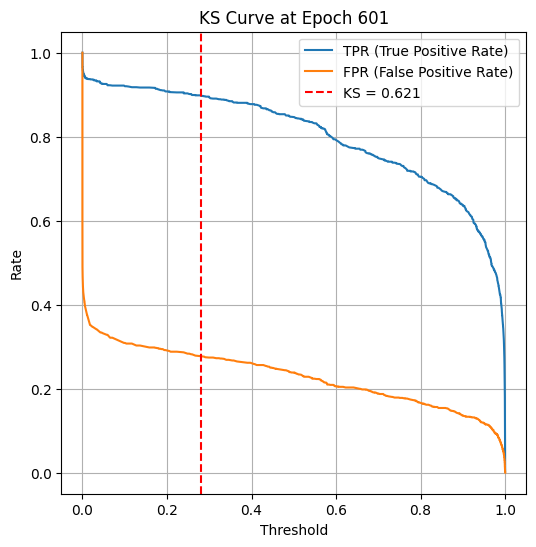

Epoch 600 — Train Loss: 0.2257 | Train Acc: 0.9004 | Val KS: 0.6212 | Val Acc: 0.8040 | Val Prec: 0.7802 | Val Recall: 0.8466 | Val F1: 0.8120
Epoch 610 — Train Loss: 0.2269 | Train Acc: 0.8969 | Val KS: 0.6189 | Val Acc: 0.8067 | Val Prec: 0.7793 | Val Recall: 0.8559 | Val F1: 0.8158
Epoch 620 — Train Loss: 0.2233 | Train Acc: 0.9002 | Val KS: 0.6135 | Val Acc: 0.7963 | Val Prec: 0.7625 | Val Recall: 0.8606 | Val F1: 0.8086


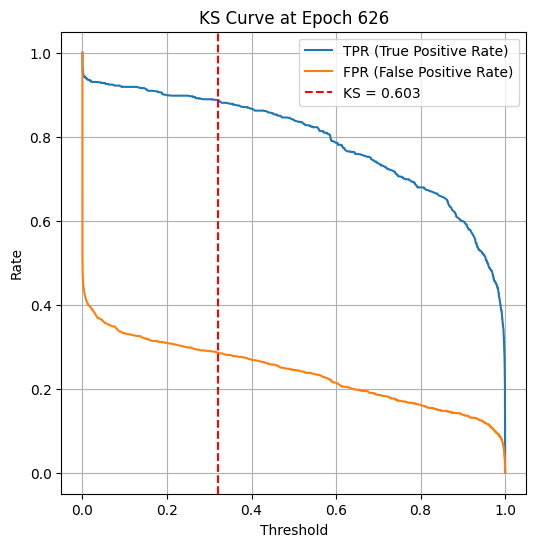

Epoch 630 — Train Loss: 0.2246 | Train Acc: 0.9028 | Val KS: 0.6011 | Val Acc: 0.7901 | Val Prec: 0.7865 | Val Recall: 0.7963 | Val F1: 0.7914
Epoch 640 — Train Loss: 0.2202 | Train Acc: 0.9000 | Val KS: 0.5809 | Val Acc: 0.7905 | Val Prec: 0.7432 | Val Recall: 0.8877 | Val F1: 0.8090


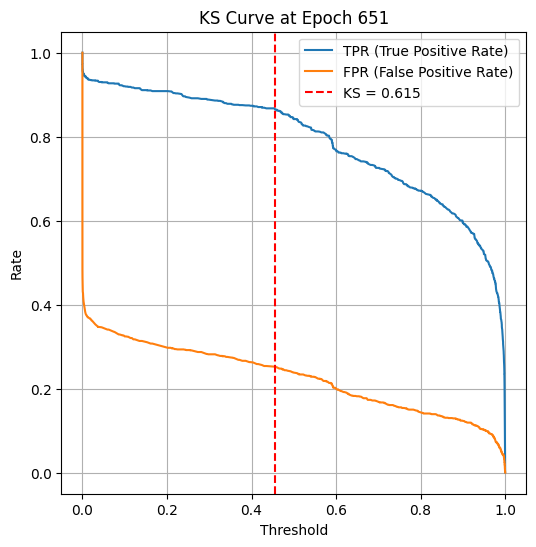

Epoch 650 — Train Loss: 0.2229 | Train Acc: 0.8987 | Val KS: 0.6150 | Val Acc: 0.8021 | Val Prec: 0.7798 | Val Recall: 0.8420 | Val F1: 0.8097
Epoch 660 — Train Loss: 0.2205 | Train Acc: 0.9006 | Val KS: 0.6119 | Val Acc: 0.8036 | Val Prec: 0.7812 | Val Recall: 0.8435 | Val F1: 0.8112
Epoch 670 — Train Loss: 0.2243 | Train Acc: 0.9008 | Val KS: 0.5647 | Val Acc: 0.7723 | Val Prec: 0.7685 | Val Recall: 0.7792 | Val F1: 0.7738


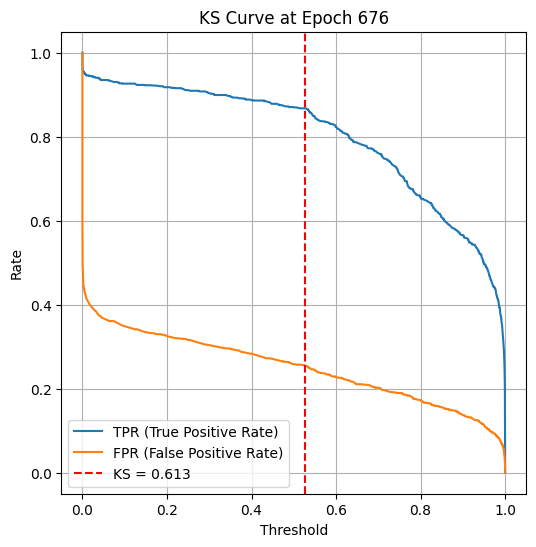

Epoch 680 — Train Loss: 0.2156 | Train Acc: 0.9016 | Val KS: 0.6150 | Val Acc: 0.8025 | Val Prec: 0.7655 | Val Recall: 0.8722 | Val F1: 0.8154
Epoch 690 — Train Loss: 0.2216 | Train Acc: 0.8981 | Val KS: 0.5840 | Val Acc: 0.7916 | Val Prec: 0.7602 | Val Recall: 0.8521 | Val F1: 0.8035


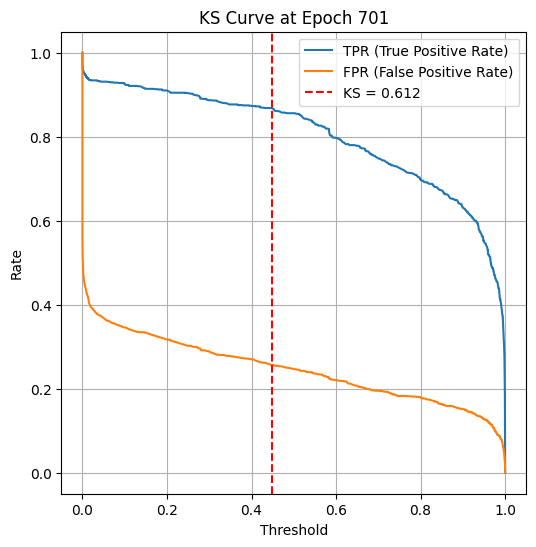

Epoch 700 — Train Loss: 0.2263 | Train Acc: 0.8997 | Val KS: 0.6119 | Val Acc: 0.8048 | Val Prec: 0.7765 | Val Recall: 0.8559 | Val F1: 0.8143
Epoch 710 — Train Loss: 0.2239 | Train Acc: 0.8981 | Val KS: 0.6119 | Val Acc: 0.8017 | Val Prec: 0.7829 | Val Recall: 0.8350 | Val F1: 0.8081
Epoch 720 — Train Loss: 0.2225 | Train Acc: 0.9024 | Val KS: 0.5964 | Val Acc: 0.7839 | Val Prec: 0.7754 | Val Recall: 0.7994 | Val F1: 0.7872


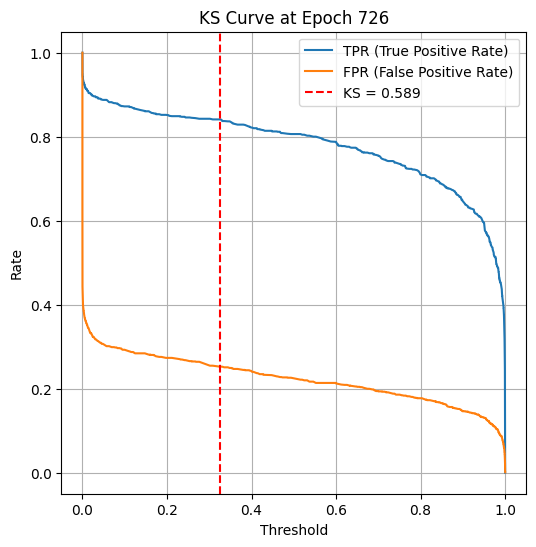

Epoch 730 — Train Loss: 0.2275 | Train Acc: 0.8987 | Val KS: 0.6050 | Val Acc: 0.8005 | Val Prec: 0.7597 | Val Recall: 0.8792 | Val F1: 0.8151
Epoch 740 — Train Loss: 0.2242 | Train Acc: 0.8958 | Val KS: 0.5980 | Val Acc: 0.7932 | Val Prec: 0.7671 | Val Recall: 0.8420 | Val F1: 0.8028


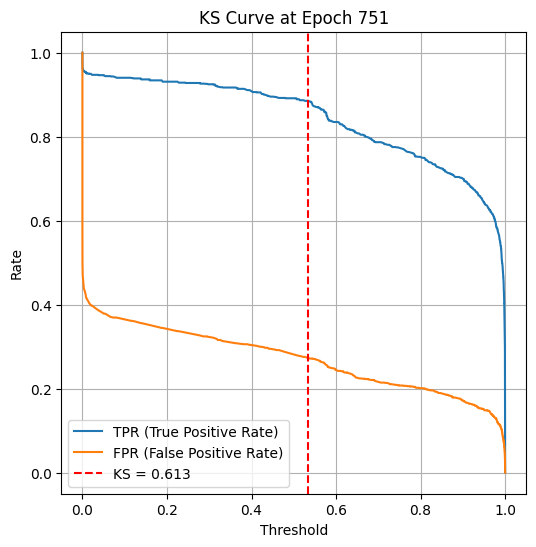

Epoch 750 — Train Loss: 0.2123 | Train Acc: 0.9057 | Val KS: 0.6127 | Val Acc: 0.8056 | Val Prec: 0.7607 | Val Recall: 0.8916 | Val F1: 0.8210
Epoch 760 — Train Loss: 0.2238 | Train Acc: 0.9010 | Val KS: 0.6034 | Val Acc: 0.7982 | Val Prec: 0.7477 | Val Recall: 0.9001 | Val F1: 0.8169
Epoch 770 — Train Loss: 0.2147 | Train Acc: 0.9039 | Val KS: 0.6313 | Val Acc: 0.7974 | Val Prec: 0.7874 | Val Recall: 0.8149 | Val F1: 0.8009


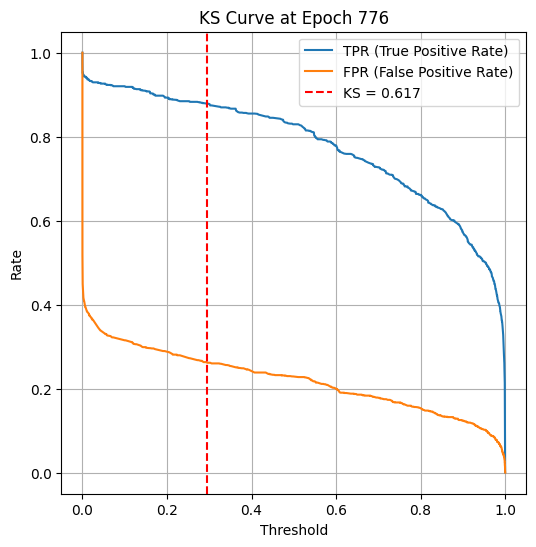

Epoch 780 — Train Loss: 0.2187 | Train Acc: 0.9002 | Val KS: 0.6174 | Val Acc: 0.8044 | Val Prec: 0.7670 | Val Recall: 0.8745 | Val F1: 0.8172
Epoch 790 — Train Loss: 0.2296 | Train Acc: 0.9041 | Val KS: 0.5910 | Val Acc: 0.7835 | Val Prec: 0.7802 | Val Recall: 0.7893 | Val F1: 0.7848


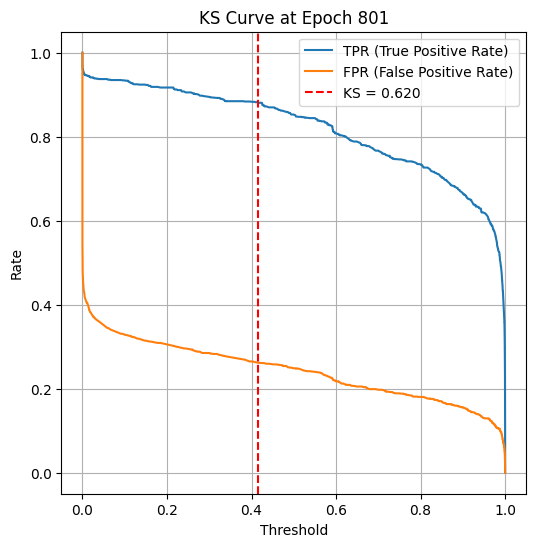

Epoch 800 — Train Loss: 0.2221 | Train Acc: 0.8975 | Val KS: 0.6204 | Val Acc: 0.8013 | Val Prec: 0.7739 | Val Recall: 0.8513 | Val F1: 0.8108
Epoch 810 — Train Loss: 0.2268 | Train Acc: 0.8977 | Val KS: 0.6011 | Val Acc: 0.7940 | Val Prec: 0.7612 | Val Recall: 0.8567 | Val F1: 0.8061
Epoch 820 — Train Loss: 0.2226 | Train Acc: 0.9047 | Val KS: 0.6259 | Val Acc: 0.8040 | Val Prec: 0.7850 | Val Recall: 0.8373 | Val F1: 0.8103


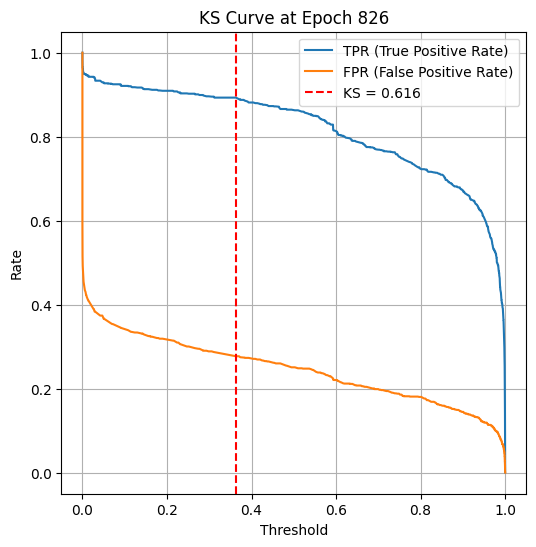

Epoch 830 — Train Loss: 0.2265 | Train Acc: 0.8998 | Val KS: 0.6042 | Val Acc: 0.7974 | Val Prec: 0.7557 | Val Recall: 0.8792 | Val F1: 0.8127
Epoch 840 — Train Loss: 0.2225 | Train Acc: 0.9028 | Val KS: 0.6057 | Val Acc: 0.7963 | Val Prec: 0.7936 | Val Recall: 0.8009 | Val F1: 0.7972


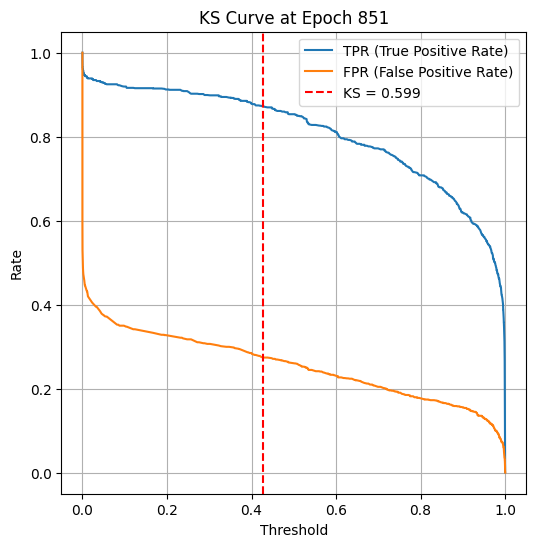

Epoch 850 — Train Loss: 0.2177 | Train Acc: 0.9055 | Val KS: 0.5988 | Val Acc: 0.7967 | Val Prec: 0.7663 | Val Recall: 0.8536 | Val F1: 0.8076
Epoch 860 — Train Loss: 0.2222 | Train Acc: 0.8977 | Val KS: 0.6011 | Val Acc: 0.7889 | Val Prec: 0.7747 | Val Recall: 0.8149 | Val F1: 0.7943
Epoch 870 — Train Loss: 0.2282 | Train Acc: 0.8993 | Val KS: 0.6034 | Val Acc: 0.7959 | Val Prec: 0.7500 | Val Recall: 0.8877 | Val F1: 0.8131


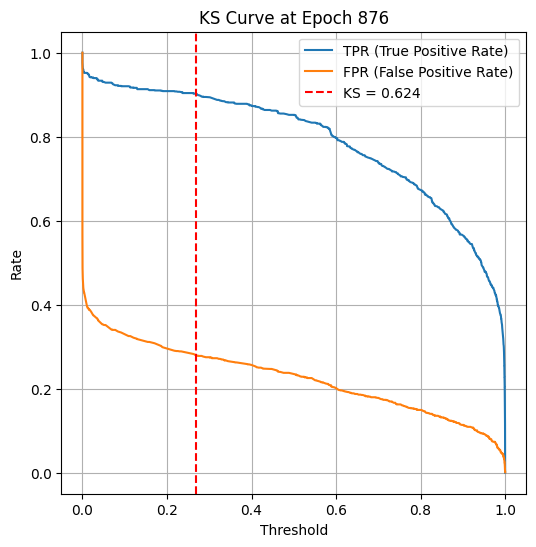

Epoch 880 — Train Loss: 0.2165 | Train Acc: 0.9041 | Val KS: 0.6081 | Val Acc: 0.8009 | Val Prec: 0.7821 | Val Recall: 0.8342 | Val F1: 0.8073
Epoch 890 — Train Loss: 0.2390 | Train Acc: 0.8954 | Val KS: 0.6266 | Val Acc: 0.8029 | Val Prec: 0.7935 | Val Recall: 0.8187 | Val F1: 0.8059


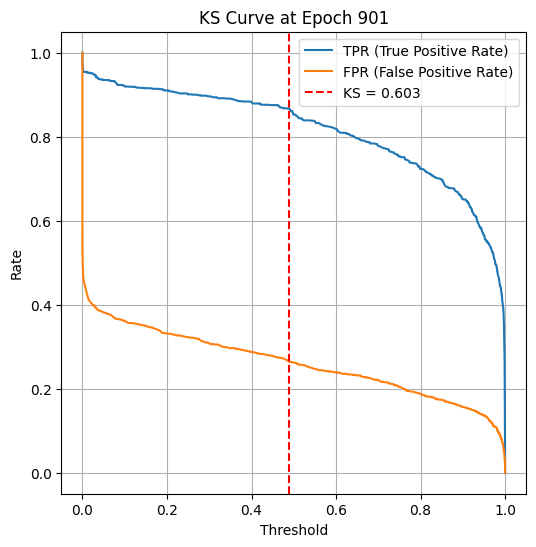

Epoch 900 — Train Loss: 0.2247 | Train Acc: 0.9008 | Val KS: 0.6026 | Val Acc: 0.7955 | Val Prec: 0.7651 | Val Recall: 0.8528 | Val F1: 0.8066
Epoch 910 — Train Loss: 0.2030 | Train Acc: 0.9107 | Val KS: 0.6112 | Val Acc: 0.7978 | Val Prec: 0.7788 | Val Recall: 0.8319 | Val F1: 0.8045
Epoch 920 — Train Loss: 0.2175 | Train Acc: 0.9062 | Val KS: 0.5972 | Val Acc: 0.7909 | Val Prec: 0.7393 | Val Recall: 0.8985 | Val F1: 0.8112


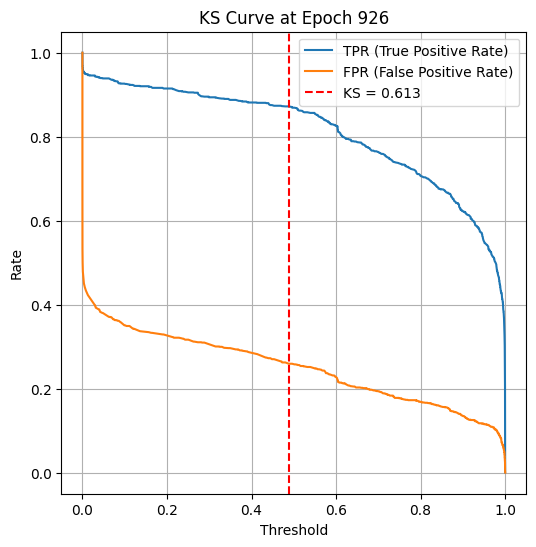

Epoch 930 — Train Loss: 0.2171 | Train Acc: 0.9037 | Val KS: 0.6050 | Val Acc: 0.8002 | Val Prec: 0.7631 | Val Recall: 0.8706 | Val F1: 0.8133
Epoch 940 — Train Loss: 0.2270 | Train Acc: 0.8981 | Val KS: 0.5755 | Val Acc: 0.7777 | Val Prec: 0.7581 | Val Recall: 0.8156 | Val F1: 0.7858


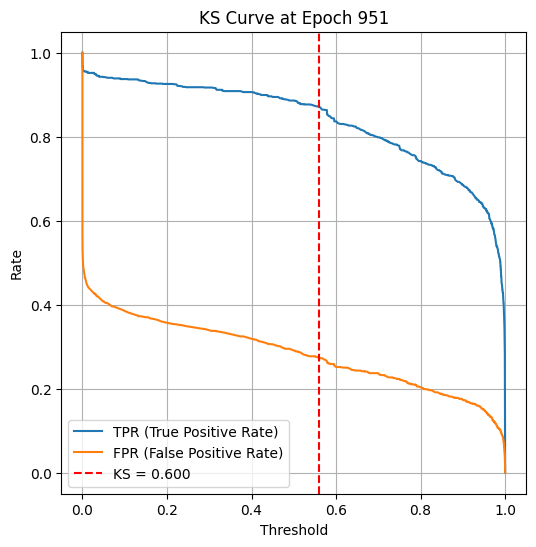

Epoch 950 — Train Loss: 0.2252 | Train Acc: 0.8993 | Val KS: 0.5995 | Val Acc: 0.7978 | Val Prec: 0.7531 | Val Recall: 0.8861 | Val F1: 0.8142
Epoch 960 — Train Loss: 0.2256 | Train Acc: 0.9035 | Val KS: 0.6266 | Val Acc: 0.8091 | Val Prec: 0.7858 | Val Recall: 0.8497 | Val F1: 0.8165
Epoch 970 — Train Loss: 0.2137 | Train Acc: 0.9043 | Val KS: 0.5747 | Val Acc: 0.7874 | Val Prec: 0.7444 | Val Recall: 0.8753 | Val F1: 0.8046


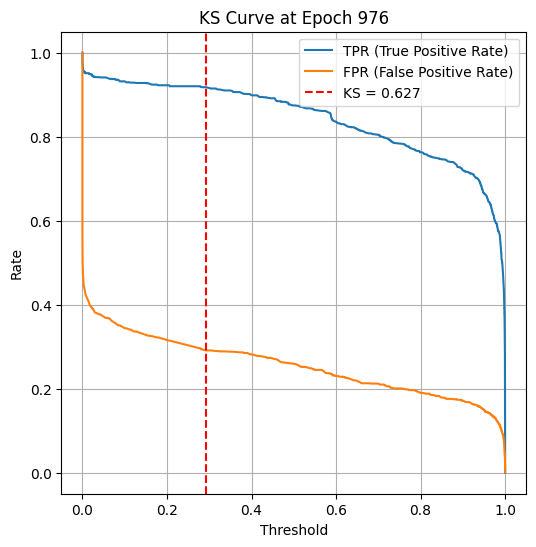

Epoch 980 — Train Loss: 0.2217 | Train Acc: 0.9041 | Val KS: 0.6065 | Val Acc: 0.7955 | Val Prec: 0.7413 | Val Recall: 0.9078 | Val F1: 0.8162
Epoch 990 — Train Loss: 0.2148 | Train Acc: 0.9095 | Val KS: 0.5941 | Val Acc: 0.7897 | Val Prec: 0.7548 | Val Recall: 0.8582 | Val F1: 0.8032


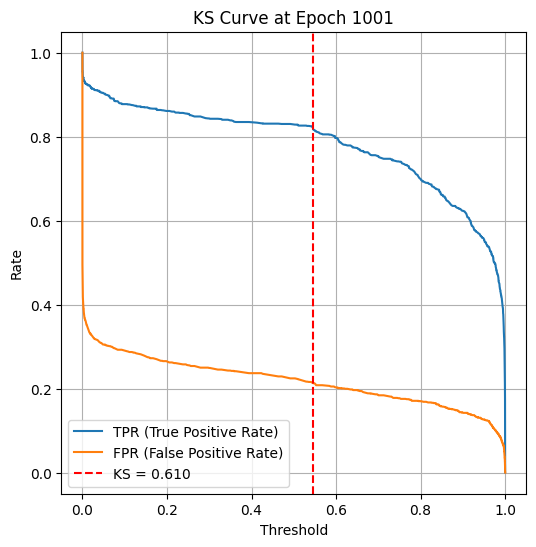

Epoch 1000 — Train Loss: 0.2075 | Train Acc: 0.9076 | Val KS: 0.6104 | Val Acc: 0.8021 | Val Prec: 0.7868 | Val Recall: 0.8288 | Val F1: 0.8072
Epoch 1010 — Train Loss: 0.2199 | Train Acc: 0.9041 | Val KS: 0.5988 | Val Acc: 0.7955 | Val Prec: 0.7447 | Val Recall: 0.8993 | Val F1: 0.8147
Epoch 1020 — Train Loss: 0.2083 | Train Acc: 0.9026 | Val KS: 0.6081 | Val Acc: 0.8009 | Val Prec: 0.7726 | Val Recall: 0.8528 | Val F1: 0.8108


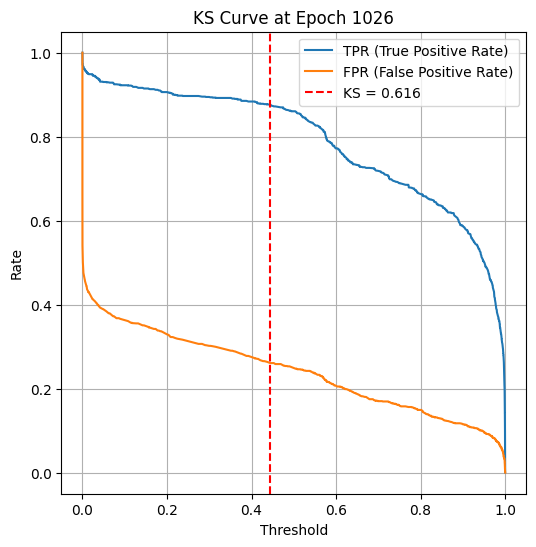

Epoch 1030 — Train Loss: 0.2153 | Train Acc: 0.9070 | Val KS: 0.6034 | Val Acc: 0.7986 | Val Prec: 0.7701 | Val Recall: 0.8513 | Val F1: 0.8087
Epoch 1040 — Train Loss: 0.2280 | Train Acc: 0.9014 | Val KS: 0.6220 | Val Acc: 0.8013 | Val Prec: 0.7783 | Val Recall: 0.8428 | Val F1: 0.8092


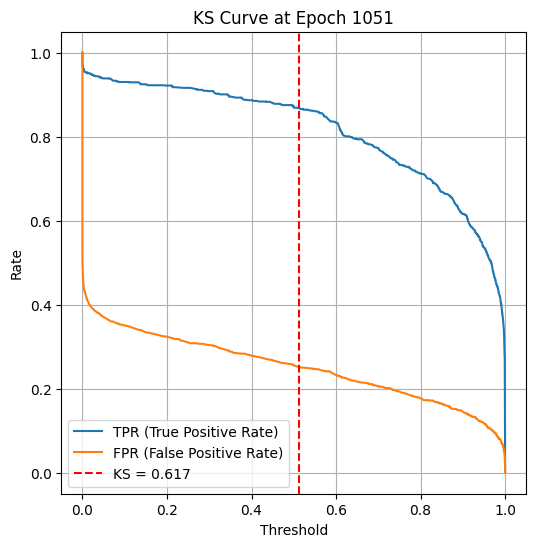

Epoch 1050 — Train Loss: 0.2197 | Train Acc: 0.8985 | Val KS: 0.6174 | Val Acc: 0.8067 | Val Prec: 0.7727 | Val Recall: 0.8691 | Val F1: 0.8181
Epoch 1060 — Train Loss: 0.2173 | Train Acc: 0.9057 | Val KS: 0.5833 | Val Acc: 0.7912 | Val Prec: 0.7565 | Val Recall: 0.8590 | Val F1: 0.8045
Epoch 1070 — Train Loss: 0.2159 | Train Acc: 0.9043 | Val KS: 0.6057 | Val Acc: 0.7986 | Val Prec: 0.7649 | Val Recall: 0.8621 | Val F1: 0.8106


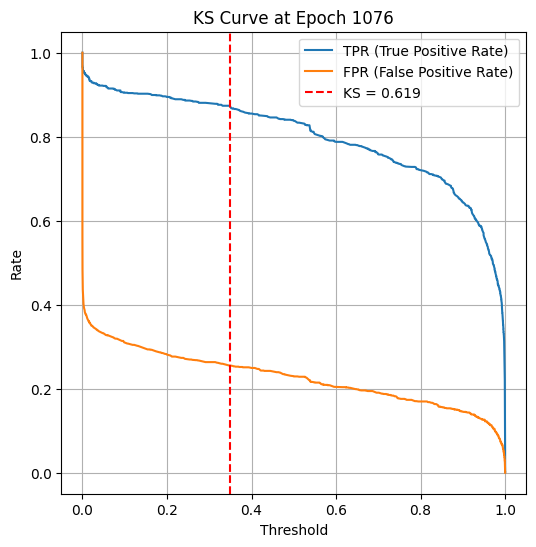

Epoch 1080 — Train Loss: 0.2254 | Train Acc: 0.8997 | Val KS: 0.6057 | Val Acc: 0.7943 | Val Prec: 0.7758 | Val Recall: 0.8280 | Val F1: 0.8010
Epoch 1090 — Train Loss: 0.2150 | Train Acc: 0.9057 | Val KS: 0.6042 | Val Acc: 0.8005 | Val Prec: 0.7767 | Val Recall: 0.8435 | Val F1: 0.8088


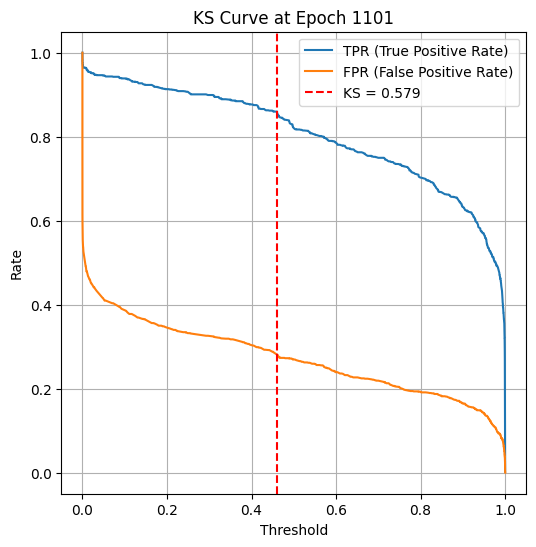

Epoch 1100 — Train Loss: 0.2156 | Train Acc: 0.9045 | Val KS: 0.5786 | Val Acc: 0.7758 | Val Prec: 0.7528 | Val Recall: 0.8211 | Val F1: 0.7855
Epoch 1110 — Train Loss: 0.2113 | Train Acc: 0.9086 | Val KS: 0.5980 | Val Acc: 0.7928 | Val Prec: 0.7564 | Val Recall: 0.8637 | Val F1: 0.8065
Epoch 1120 — Train Loss: 0.2235 | Train Acc: 0.9000 | Val KS: 0.6081 | Val Acc: 0.7967 | Val Prec: 0.7720 | Val Recall: 0.8420 | Val F1: 0.8055


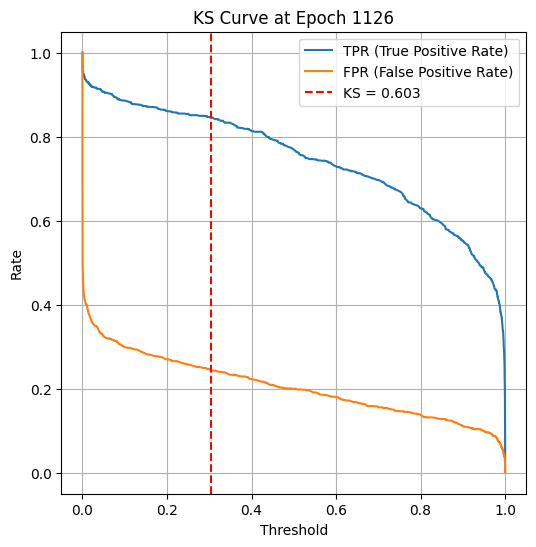

Epoch 1130 — Train Loss: 0.2254 | Train Acc: 0.9026 | Val KS: 0.6003 | Val Acc: 0.7967 | Val Prec: 0.7660 | Val Recall: 0.8544 | Val F1: 0.8078
Epoch 1140 — Train Loss: 0.2229 | Train Acc: 0.9064 | Val KS: 0.6143 | Val Acc: 0.8005 | Val Prec: 0.7870 | Val Recall: 0.8242 | Val F1: 0.8051


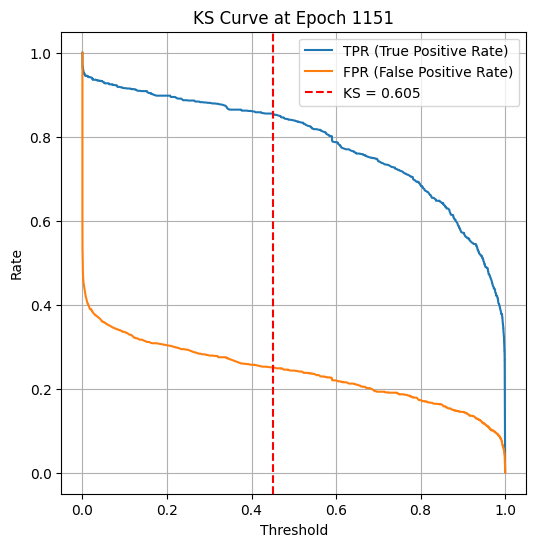

Epoch 1150 — Train Loss: 0.2133 | Train Acc: 0.9090 | Val KS: 0.6050 | Val Acc: 0.7978 | Val Prec: 0.7752 | Val Recall: 0.8389 | Val F1: 0.8058
Epoch 1160 — Train Loss: 0.2193 | Train Acc: 0.9028 | Val KS: 0.6135 | Val Acc: 0.8009 | Val Prec: 0.7749 | Val Recall: 0.8482 | Val F1: 0.8099
Epoch 1170 — Train Loss: 0.2175 | Train Acc: 0.9066 | Val KS: 0.5856 | Val Acc: 0.7889 | Val Prec: 0.7379 | Val Recall: 0.8962 | Val F1: 0.8094


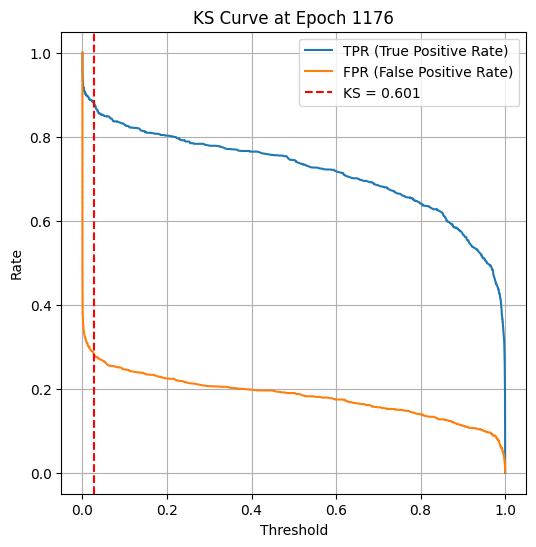

Epoch 1180 — Train Loss: 0.2183 | Train Acc: 0.9037 | Val KS: 0.6228 | Val Acc: 0.8087 | Val Prec: 0.7789 | Val Recall: 0.8621 | Val F1: 0.8184
Epoch 1190 — Train Loss: 0.2168 | Train Acc: 0.9047 | Val KS: 0.5988 | Val Acc: 0.7924 | Val Prec: 0.7587 | Val Recall: 0.8575 | Val F1: 0.8051


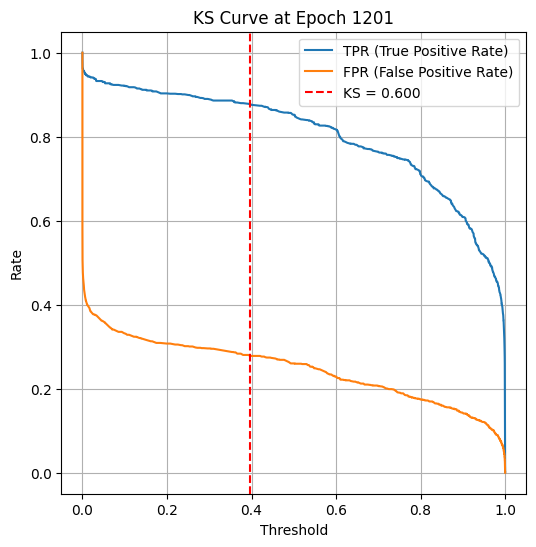

Epoch 1200 — Train Loss: 0.2322 | Train Acc: 0.8979 | Val KS: 0.5995 | Val Acc: 0.7959 | Val Prec: 0.7660 | Val Recall: 0.8521 | Val F1: 0.8067
Epoch 1210 — Train Loss: 0.2189 | Train Acc: 0.9068 | Val KS: 0.5995 | Val Acc: 0.7928 | Val Prec: 0.7484 | Val Recall: 0.8823 | Val F1: 0.8098
Epoch 1220 — Train Loss: 0.2174 | Train Acc: 0.9028 | Val KS: 0.5864 | Val Acc: 0.7854 | Val Prec: 0.7529 | Val Recall: 0.8497 | Val F1: 0.7984


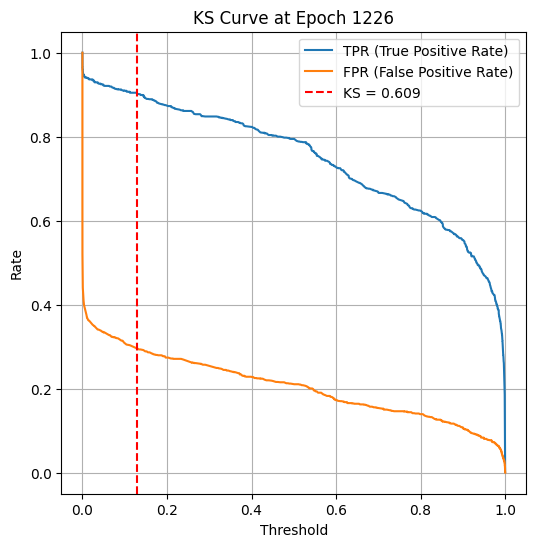

Epoch 1230 — Train Loss: 0.2178 | Train Acc: 0.9039 | Val KS: 0.6065 | Val Acc: 0.7990 | Val Prec: 0.7622 | Val Recall: 0.8691 | Val F1: 0.8122
Epoch 1240 — Train Loss: 0.2167 | Train Acc: 0.9018 | Val KS: 0.6096 | Val Acc: 0.7990 | Val Prec: 0.7619 | Val Recall: 0.8699 | Val F1: 0.8123


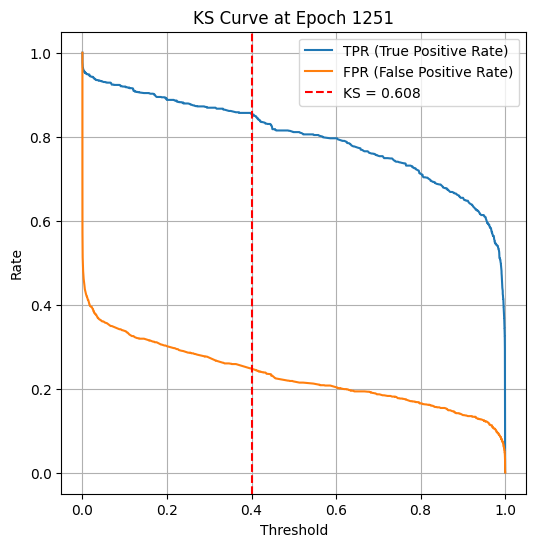

Epoch 1250 — Train Loss: 0.2134 | Train Acc: 0.9111 | Val KS: 0.6081 | Val Acc: 0.7971 | Val Prec: 0.7890 | Val Recall: 0.8110 | Val F1: 0.7998
Epoch 1260 — Train Loss: 0.2178 | Train Acc: 0.9035 | Val KS: 0.5988 | Val Acc: 0.7951 | Val Prec: 0.7567 | Val Recall: 0.8699 | Val F1: 0.8094
Epoch 1270 — Train Loss: 0.2145 | Train Acc: 0.9074 | Val KS: 0.6065 | Val Acc: 0.7998 | Val Prec: 0.7543 | Val Recall: 0.8892 | Val F1: 0.8162


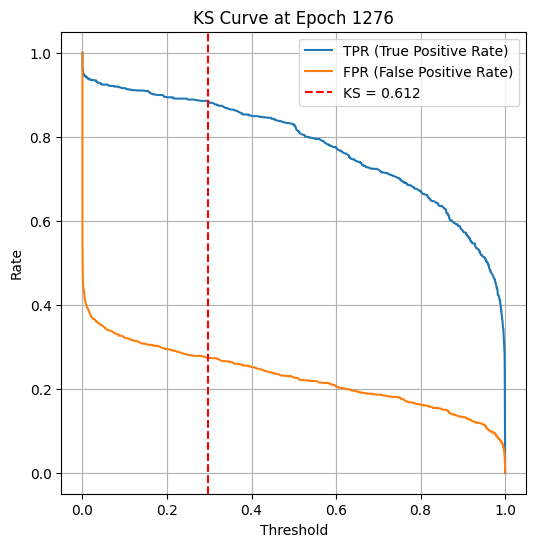

Epoch 1280 — Train Loss: 0.2184 | Train Acc: 0.9086 | Val KS: 0.5964 | Val Acc: 0.7901 | Val Prec: 0.7692 | Val Recall: 0.8288 | Val F1: 0.7979
Epoch 1290 — Train Loss: 0.2197 | Train Acc: 0.9039 | Val KS: 0.6158 | Val Acc: 0.8029 | Val Prec: 0.7631 | Val Recall: 0.8784 | Val F1: 0.8167


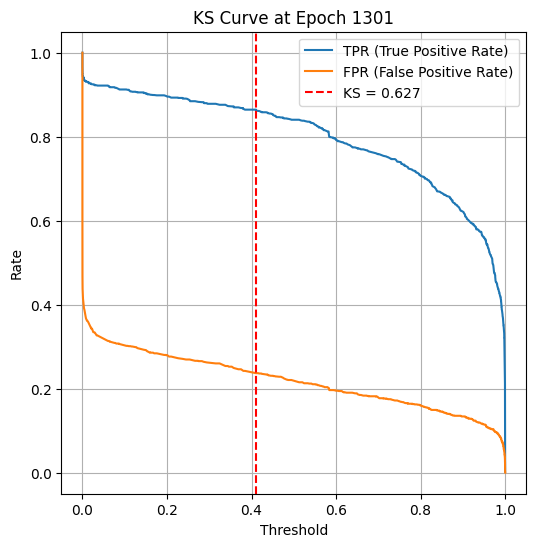

Epoch 1300 — Train Loss: 0.2182 | Train Acc: 0.9029 | Val KS: 0.6274 | Val Acc: 0.8114 | Val Prec: 0.7943 | Val Recall: 0.8404 | Val F1: 0.8167
Epoch 1310 — Train Loss: 0.2178 | Train Acc: 0.9062 | Val KS: 0.6104 | Val Acc: 0.8009 | Val Prec: 0.7666 | Val Recall: 0.8652 | Val F1: 0.8130
Epoch 1320 — Train Loss: 0.2042 | Train Acc: 0.9105 | Val KS: 0.6112 | Val Acc: 0.7959 | Val Prec: 0.7760 | Val Recall: 0.8319 | Val F1: 0.8030


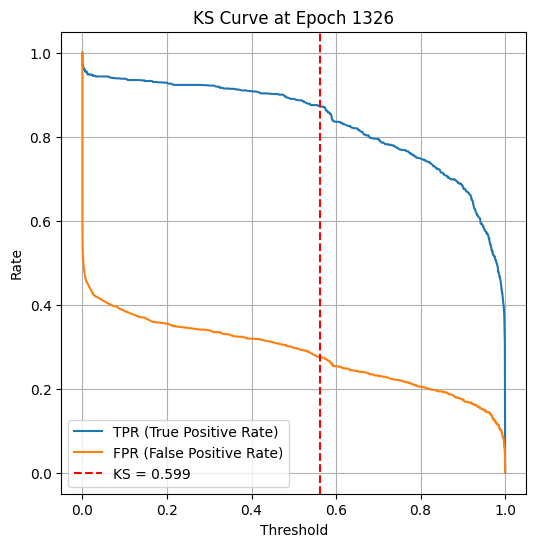

Epoch 1330 — Train Loss: 0.2107 | Train Acc: 0.9076 | Val KS: 0.6166 | Val Acc: 0.8013 | Val Prec: 0.7815 | Val Recall: 0.8366 | Val F1: 0.8081
Epoch 1340 — Train Loss: 0.2205 | Train Acc: 0.9072 | Val KS: 0.5453 | Val Acc: 0.7696 | Val Prec: 0.7099 | Val Recall: 0.9117 | Val F1: 0.7982


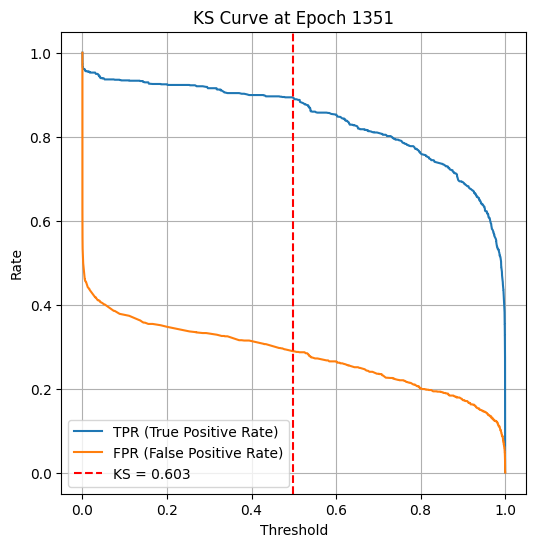

Epoch 1350 — Train Loss: 0.2197 | Train Acc: 0.9028 | Val KS: 0.6034 | Val Acc: 0.8009 | Val Prec: 0.7548 | Val Recall: 0.8916 | Val F1: 0.8175
Epoch 1360 — Train Loss: 0.2231 | Train Acc: 0.9014 | Val KS: 0.6088 | Val Acc: 0.8033 | Val Prec: 0.7732 | Val Recall: 0.8582 | Val F1: 0.8135
Epoch 1370 — Train Loss: 0.2168 | Train Acc: 0.9076 | Val KS: 0.5988 | Val Acc: 0.7947 | Val Prec: 0.7816 | Val Recall: 0.8180 | Val F1: 0.7994


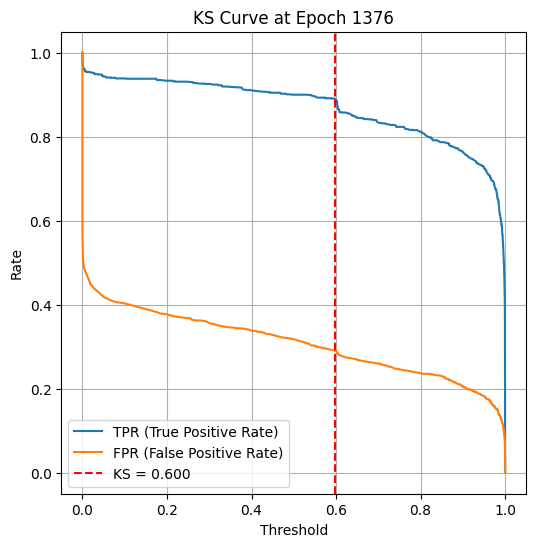

Epoch 1380 — Train Loss: 0.2128 | Train Acc: 0.9059 | Val KS: 0.6204 | Val Acc: 0.8002 | Val Prec: 0.7965 | Val Recall: 0.8064 | Val F1: 0.8014
Epoch 1390 — Train Loss: 0.2154 | Train Acc: 0.9051 | Val KS: 0.6065 | Val Acc: 0.7994 | Val Prec: 0.7476 | Val Recall: 0.9040 | Val F1: 0.8184


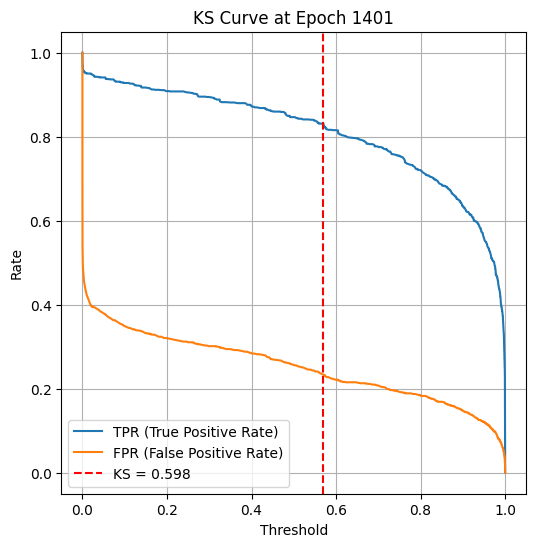

Epoch 1400 — Train Loss: 0.2099 | Train Acc: 0.9097 | Val KS: 0.5980 | Val Acc: 0.7951 | Val Prec: 0.7676 | Val Recall: 0.8466 | Val F1: 0.8052
Epoch 1410 — Train Loss: 0.2159 | Train Acc: 0.9051 | Val KS: 0.6150 | Val Acc: 0.7940 | Val Prec: 0.7877 | Val Recall: 0.8048 | Val F1: 0.7962
Epoch 1420 — Train Loss: 0.2198 | Train Acc: 0.9031 | Val KS: 0.6011 | Val Acc: 0.7974 | Val Prec: 0.7685 | Val Recall: 0.8513 | Val F1: 0.8078


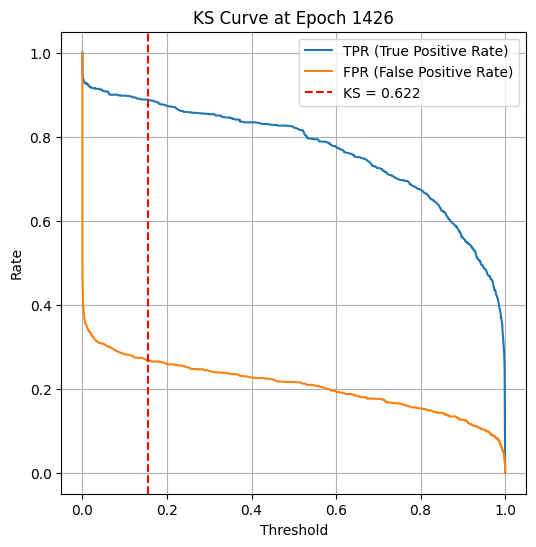

Epoch 1430 — Train Loss: 0.2167 | Train Acc: 0.9078 | Val KS: 0.6003 | Val Acc: 0.7967 | Val Prec: 0.7584 | Val Recall: 0.8706 | Val F1: 0.8107
Epoch 1440 — Train Loss: 0.2037 | Train Acc: 0.9120 | Val KS: 0.6174 | Val Acc: 0.7982 | Val Prec: 0.7895 | Val Recall: 0.8133 | Val F1: 0.8012


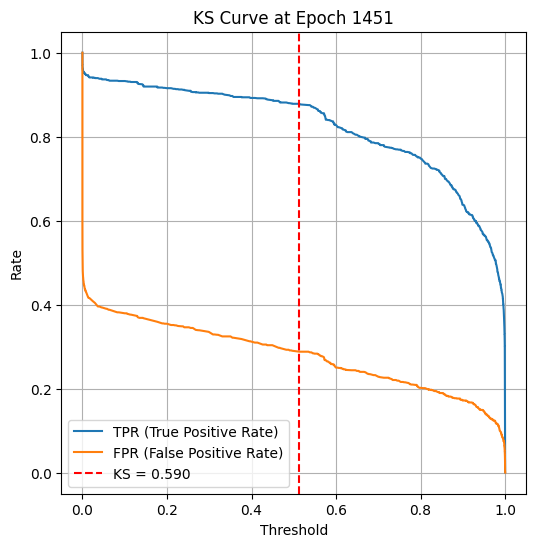

Epoch 1450 — Train Loss: 0.2158 | Train Acc: 0.9060 | Val KS: 0.5902 | Val Acc: 0.7943 | Val Prec: 0.7520 | Val Recall: 0.8784 | Val F1: 0.8103
Epoch 1460 — Train Loss: 0.2107 | Train Acc: 0.9084 | Val KS: 0.6259 | Val Acc: 0.8064 | Val Prec: 0.8083 | Val Recall: 0.8033 | Val F1: 0.8057
Epoch 1470 — Train Loss: 0.2171 | Train Acc: 0.9068 | Val KS: 0.6104 | Val Acc: 0.8048 | Val Prec: 0.7731 | Val Recall: 0.8629 | Val F1: 0.8155


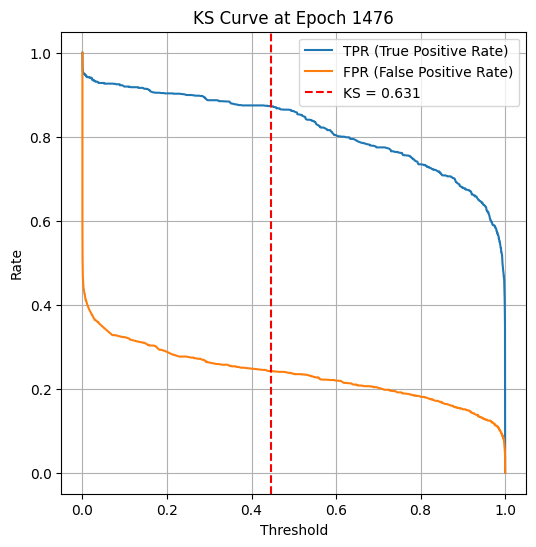

Epoch 1480 — Train Loss: 0.2154 | Train Acc: 0.9035 | Val KS: 0.6158 | Val Acc: 0.7974 | Val Prec: 0.7616 | Val Recall: 0.8660 | Val F1: 0.8104
Epoch 1490 — Train Loss: 0.2216 | Train Acc: 0.8993 | Val KS: 0.5957 | Val Acc: 0.7936 | Val Prec: 0.7533 | Val Recall: 0.8730 | Val F1: 0.8088


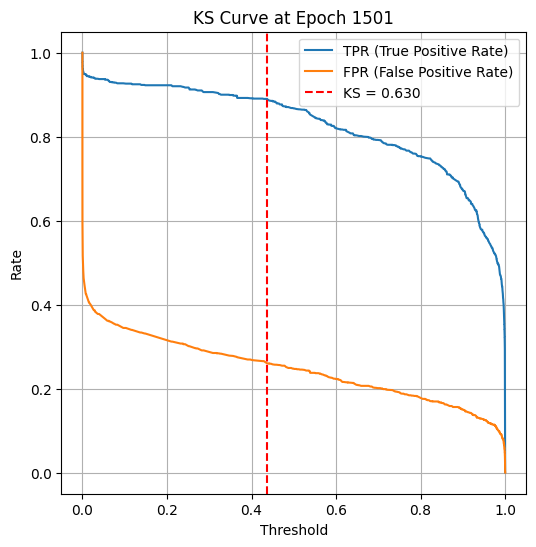

Epoch 1500 — Train Loss: 0.2162 | Train Acc: 0.9059 | Val KS: 0.6297 | Val Acc: 0.8102 | Val Prec: 0.7783 | Val Recall: 0.8675 | Val F1: 0.8205
Epoch 1510 — Train Loss: 0.2194 | Train Acc: 0.9070 | Val KS: 0.6344 | Val Acc: 0.8029 | Val Prec: 0.8022 | Val Recall: 0.8040 | Val F1: 0.8031
Epoch 1520 — Train Loss: 0.2170 | Train Acc: 0.9010 | Val KS: 0.6034 | Val Acc: 0.7943 | Val Prec: 0.7782 | Val Recall: 0.8234 | Val F1: 0.8002


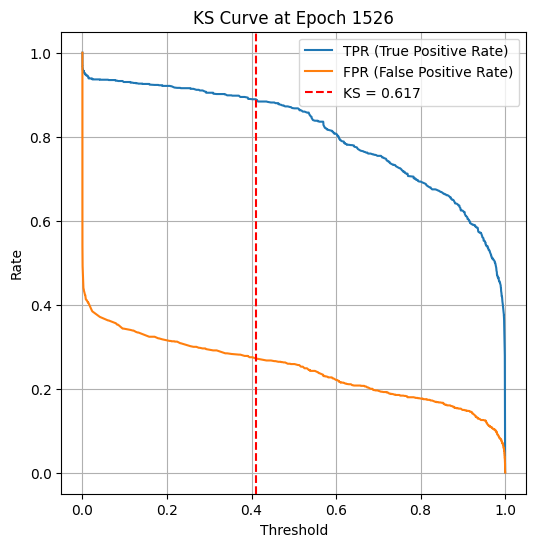

Epoch 1530 — Train Loss: 0.2236 | Train Acc: 0.9024 | Val KS: 0.6282 | Val Acc: 0.8102 | Val Prec: 0.7859 | Val Recall: 0.8528 | Val F1: 0.8180
Epoch 1540 — Train Loss: 0.2140 | Train Acc: 0.9041 | Val KS: 0.6065 | Val Acc: 0.8033 | Val Prec: 0.7694 | Val Recall: 0.8660 | Val F1: 0.8149


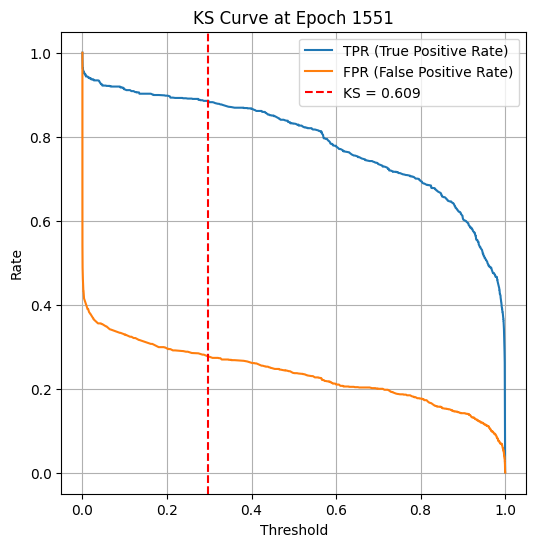

Epoch 1550 — Train Loss: 0.2109 | Train Acc: 0.9088 | Val KS: 0.6088 | Val Acc: 0.7971 | Val Prec: 0.7781 | Val Recall: 0.8311 | Val F1: 0.8037
Epoch 1560 — Train Loss: 0.2167 | Train Acc: 0.9045 | Val KS: 0.6158 | Val Acc: 0.8009 | Val Prec: 0.7641 | Val Recall: 0.8706 | Val F1: 0.8139
Epoch 1570 — Train Loss: 0.2200 | Train Acc: 0.9068 | Val KS: 0.6197 | Val Acc: 0.8091 | Val Prec: 0.7733 | Val Recall: 0.8745 | Val F1: 0.8208


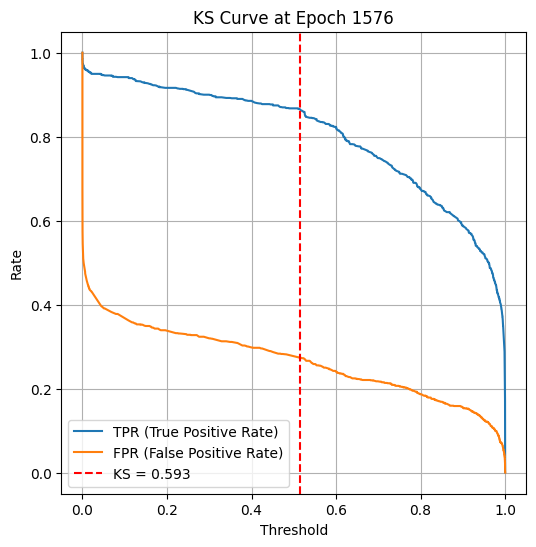

Epoch 1580 — Train Loss: 0.2117 | Train Acc: 0.9117 | Val KS: 0.6088 | Val Acc: 0.8036 | Val Prec: 0.7707 | Val Recall: 0.8644 | Val F1: 0.8149
Epoch 1590 — Train Loss: 0.2244 | Train Acc: 0.9026 | Val KS: 0.6019 | Val Acc: 0.7955 | Val Prec: 0.7505 | Val Recall: 0.8854 | Val F1: 0.8124


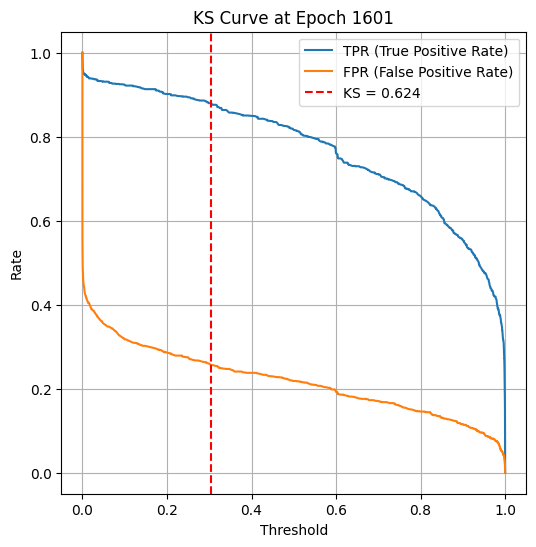

Epoch 1600 — Train Loss: 0.2232 | Train Acc: 0.9029 | Val KS: 0.6235 | Val Acc: 0.7982 | Val Prec: 0.7886 | Val Recall: 0.8149 | Val F1: 0.8015
Epoch 1610 — Train Loss: 0.2153 | Train Acc: 0.9068 | Val KS: 0.6003 | Val Acc: 0.7943 | Val Prec: 0.7613 | Val Recall: 0.8575 | Val F1: 0.8066
Epoch 1620 — Train Loss: 0.2227 | Train Acc: 0.9026 | Val KS: 0.6174 | Val Acc: 0.8033 | Val Prec: 0.7744 | Val Recall: 0.8559 | Val F1: 0.8131


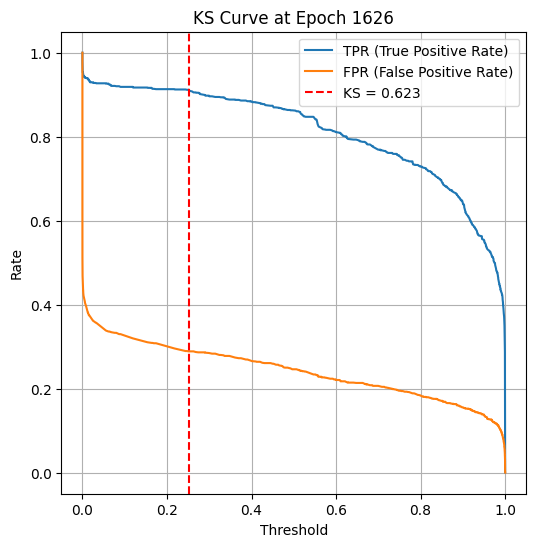

Epoch 1630 — Train Loss: 0.2176 | Train Acc: 0.9074 | Val KS: 0.6174 | Val Acc: 0.8040 | Val Prec: 0.7731 | Val Recall: 0.8606 | Val F1: 0.8145
Epoch 1640 — Train Loss: 0.2175 | Train Acc: 0.9066 | Val KS: 0.6189 | Val Acc: 0.8064 | Val Prec: 0.7696 | Val Recall: 0.8745 | Val F1: 0.8187


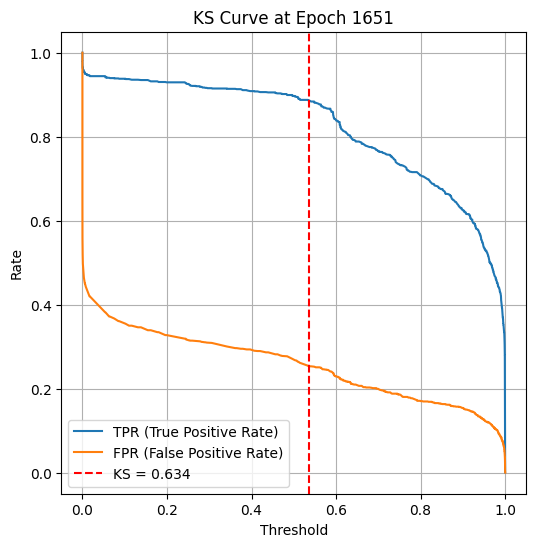

Epoch 1650 — Train Loss: 0.2166 | Train Acc: 0.9016 | Val KS: 0.6336 | Val Acc: 0.8141 | Val Prec: 0.7694 | Val Recall: 0.8970 | Val F1: 0.8283
Epoch 1660 — Train Loss: 0.2157 | Train Acc: 0.9057 | Val KS: 0.5809 | Val Acc: 0.7897 | Val Prec: 0.7444 | Val Recall: 0.8823 | Val F1: 0.8075
Epoch 1670 — Train Loss: 0.2201 | Train Acc: 0.9082 | Val KS: 0.6243 | Val Acc: 0.8095 | Val Prec: 0.7953 | Val Recall: 0.8335 | Val F1: 0.8139


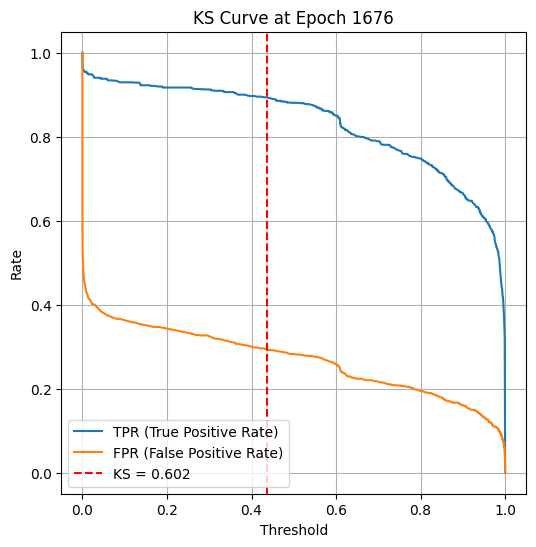

Epoch 1680 — Train Loss: 0.2164 | Train Acc: 0.9035 | Val KS: 0.6197 | Val Acc: 0.8060 | Val Prec: 0.7732 | Val Recall: 0.8660 | Val F1: 0.8170
Epoch 1690 — Train Loss: 0.2040 | Train Acc: 0.9113 | Val KS: 0.6282 | Val Acc: 0.8091 | Val Prec: 0.7834 | Val Recall: 0.8544 | Val F1: 0.8173


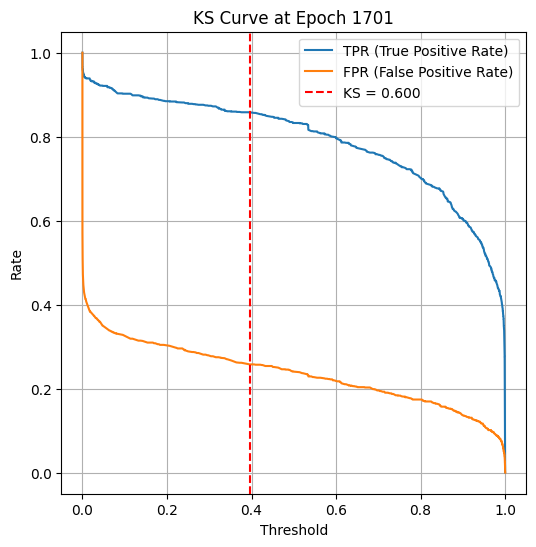

Epoch 1700 — Train Loss: 0.2121 | Train Acc: 0.9093 | Val KS: 0.6003 | Val Acc: 0.7963 | Val Prec: 0.7762 | Val Recall: 0.8327 | Val F1: 0.8034
Epoch 1710 — Train Loss: 0.2262 | Train Acc: 0.9016 | Val KS: 0.6290 | Val Acc: 0.8079 | Val Prec: 0.7951 | Val Recall: 0.8296 | Val F1: 0.8120
Epoch 1720 — Train Loss: 0.2149 | Train Acc: 0.9055 | Val KS: 0.6127 | Val Acc: 0.8017 | Val Prec: 0.7641 | Val Recall: 0.8730 | Val F1: 0.8149


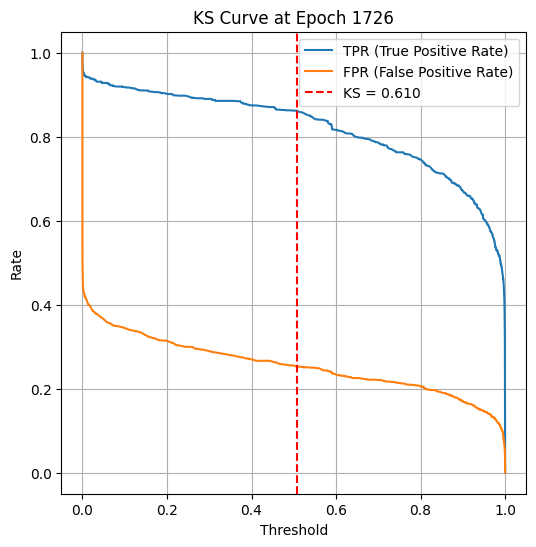

Epoch 1730 — Train Loss: 0.2138 | Train Acc: 0.9074 | Val KS: 0.6158 | Val Acc: 0.7963 | Val Prec: 0.7949 | Val Recall: 0.7986 | Val F1: 0.7968
Epoch 1740 — Train Loss: 0.2088 | Train Acc: 0.9120 | Val KS: 0.5771 | Val Acc: 0.7881 | Val Prec: 0.7348 | Val Recall: 0.9016 | Val F1: 0.8097


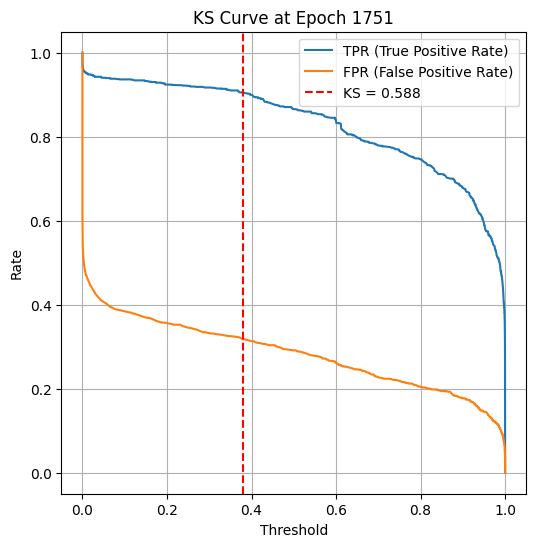

Epoch 1750 — Train Loss: 0.2017 | Train Acc: 0.9099 | Val KS: 0.5879 | Val Acc: 0.7870 | Val Prec: 0.7482 | Val Recall: 0.8652 | Val F1: 0.8024
Epoch 1760 — Train Loss: 0.2214 | Train Acc: 0.9074 | Val KS: 0.5988 | Val Acc: 0.7967 | Val Prec: 0.7481 | Val Recall: 0.8947 | Val F1: 0.8148
Epoch 1770 — Train Loss: 0.2260 | Train Acc: 0.9026 | Val KS: 0.6352 | Val Acc: 0.8153 | Val Prec: 0.7791 | Val Recall: 0.8799 | Val F1: 0.8265


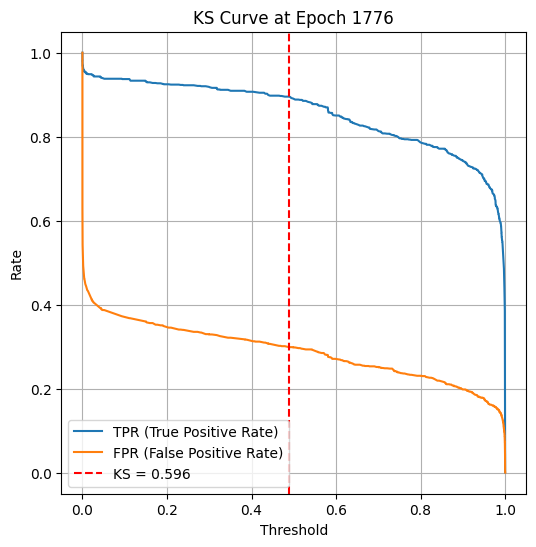

Epoch 1780 — Train Loss: 0.2166 | Train Acc: 0.9020 | Val KS: 0.6204 | Val Acc: 0.7998 | Val Prec: 0.7756 | Val Recall: 0.8435 | Val F1: 0.8082
Epoch 1790 — Train Loss: 0.2146 | Train Acc: 0.9047 | Val KS: 0.6228 | Val Acc: 0.8098 | Val Prec: 0.7801 | Val Recall: 0.8629 | Val F1: 0.8194


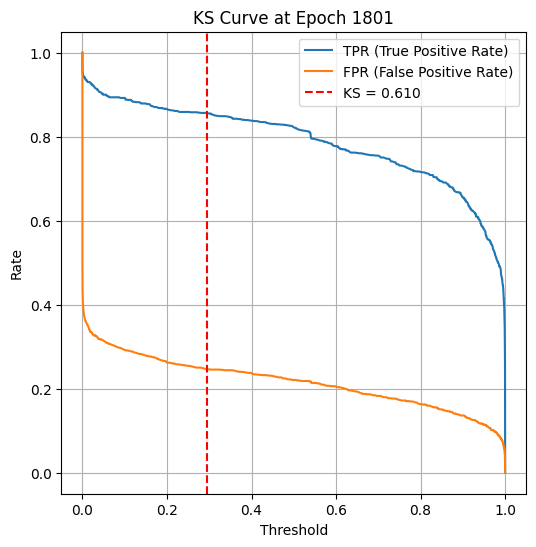

Epoch 1800 — Train Loss: 0.2167 | Train Acc: 0.9055 | Val KS: 0.6104 | Val Acc: 0.8013 | Val Prec: 0.7886 | Val Recall: 0.8234 | Val F1: 0.8056
Epoch 1810 — Train Loss: 0.2100 | Train Acc: 0.9074 | Val KS: 0.5941 | Val Acc: 0.7897 | Val Prec: 0.7503 | Val Recall: 0.8683 | Val F1: 0.8050
Epoch 1820 — Train Loss: 0.2104 | Train Acc: 0.9074 | Val KS: 0.6189 | Val Acc: 0.8056 | Val Prec: 0.7894 | Val Recall: 0.8335 | Val F1: 0.8109


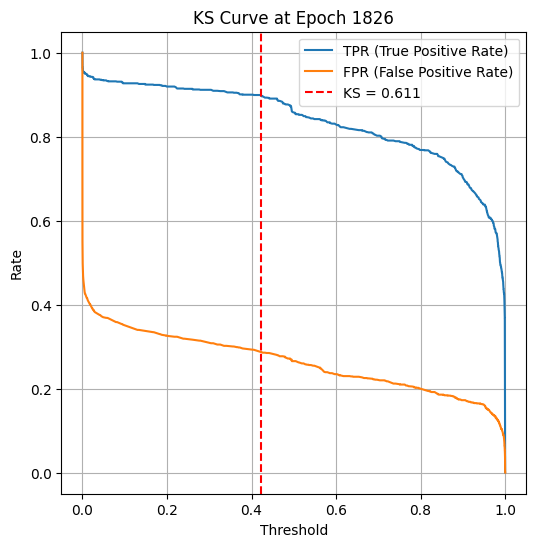

Epoch 1830 — Train Loss: 0.2069 | Train Acc: 0.9103 | Val KS: 0.6197 | Val Acc: 0.8048 | Val Prec: 0.7874 | Val Recall: 0.8350 | Val F1: 0.8105
Epoch 1840 — Train Loss: 0.2209 | Train Acc: 0.8991 | Val KS: 0.6174 | Val Acc: 0.7959 | Val Prec: 0.7851 | Val Recall: 0.8149 | Val F1: 0.7997


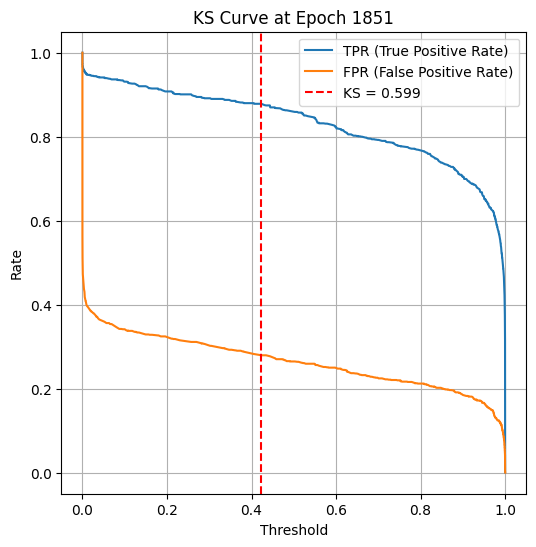

Epoch 1850 — Train Loss: 0.2079 | Train Acc: 0.9122 | Val KS: 0.5988 | Val Acc: 0.7971 | Val Prec: 0.7643 | Val Recall: 0.8590 | Val F1: 0.8089
Epoch 1860 — Train Loss: 0.2221 | Train Acc: 0.9074 | Val KS: 0.6011 | Val Acc: 0.7974 | Val Prec: 0.7484 | Val Recall: 0.8962 | Val F1: 0.8157
Epoch 1870 — Train Loss: 0.2121 | Train Acc: 0.9076 | Val KS: 0.6274 | Val Acc: 0.8052 | Val Prec: 0.7695 | Val Recall: 0.8714 | Val F1: 0.8173


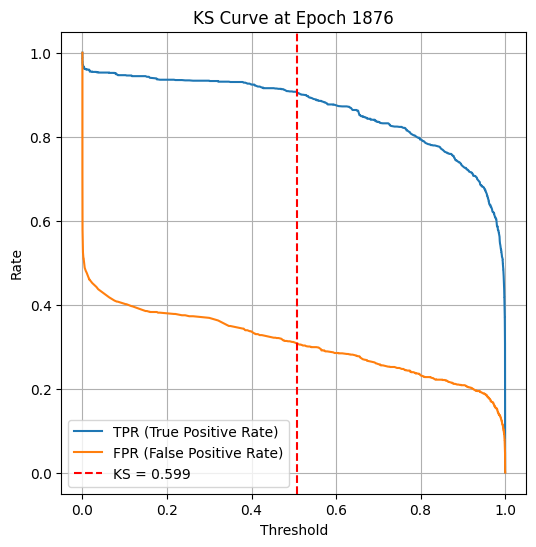

Epoch 1880 — Train Loss: 0.2197 | Train Acc: 0.9078 | Val KS: 0.6383 | Val Acc: 0.8133 | Val Prec: 0.7916 | Val Recall: 0.8505 | Val F1: 0.8200
Epoch 1890 — Train Loss: 0.2064 | Train Acc: 0.9090 | Val KS: 0.5964 | Val Acc: 0.7932 | Val Prec: 0.7431 | Val Recall: 0.8962 | Val F1: 0.8125


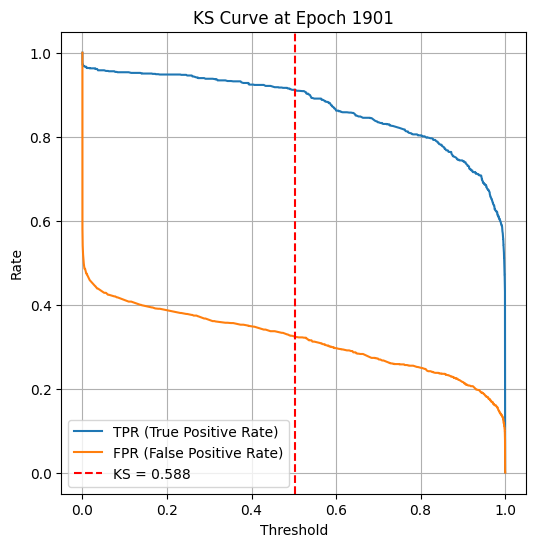

Epoch 1900 — Train Loss: 0.2115 | Train Acc: 0.9059 | Val KS: 0.5879 | Val Acc: 0.7940 | Val Prec: 0.7379 | Val Recall: 0.9117 | Val F1: 0.8157
Epoch 1910 — Train Loss: 0.2254 | Train Acc: 0.9004 | Val KS: 0.6073 | Val Acc: 0.8017 | Val Prec: 0.7780 | Val Recall: 0.8443 | Val F1: 0.8098
Epoch 1920 — Train Loss: 0.2167 | Train Acc: 0.9088 | Val KS: 0.6088 | Val Acc: 0.8029 | Val Prec: 0.7700 | Val Recall: 0.8637 | Val F1: 0.8142


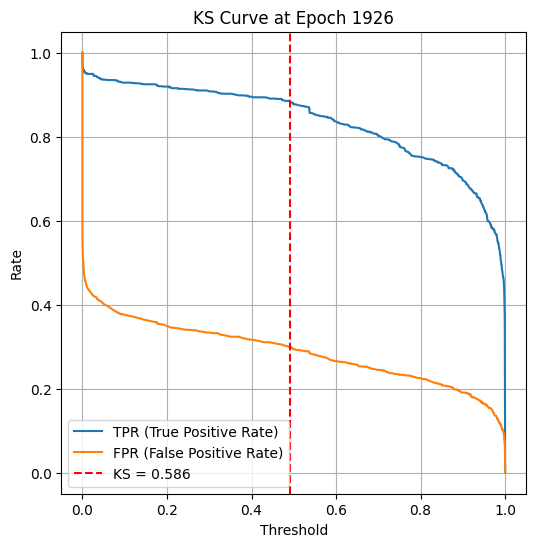

Epoch 1930 — Train Loss: 0.2060 | Train Acc: 0.9109 | Val KS: 0.6081 | Val Acc: 0.7947 | Val Prec: 0.7800 | Val Recall: 0.8211 | Val F1: 0.8000
Epoch 1940 — Train Loss: 0.2200 | Train Acc: 0.9037 | Val KS: 0.6042 | Val Acc: 0.7986 | Val Prec: 0.7492 | Val Recall: 0.8978 | Val F1: 0.8168


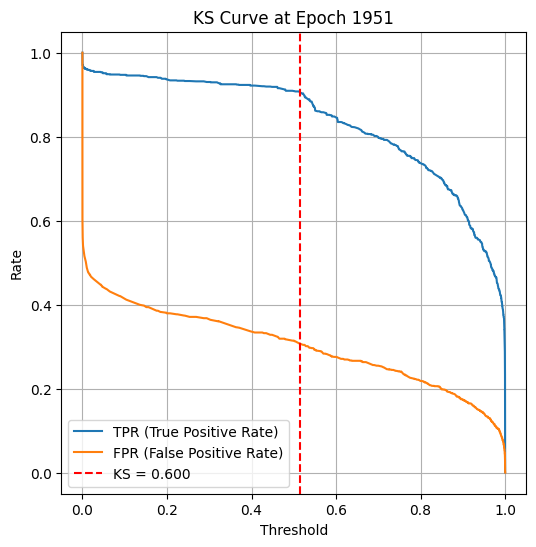

Epoch 1950 — Train Loss: 0.2059 | Train Acc: 0.9107 | Val KS: 0.6003 | Val Acc: 0.7971 | Val Prec: 0.7429 | Val Recall: 0.9086 | Val F1: 0.8174
Epoch 1960 — Train Loss: 0.2266 | Train Acc: 0.9004 | Val KS: 0.6104 | Val Acc: 0.7978 | Val Prec: 0.7596 | Val Recall: 0.8714 | Val F1: 0.8117
Epoch 1970 — Train Loss: 0.2212 | Train Acc: 0.9043 | Val KS: 0.6081 | Val Acc: 0.7940 | Val Prec: 0.7931 | Val Recall: 0.7955 | Val F1: 0.7943


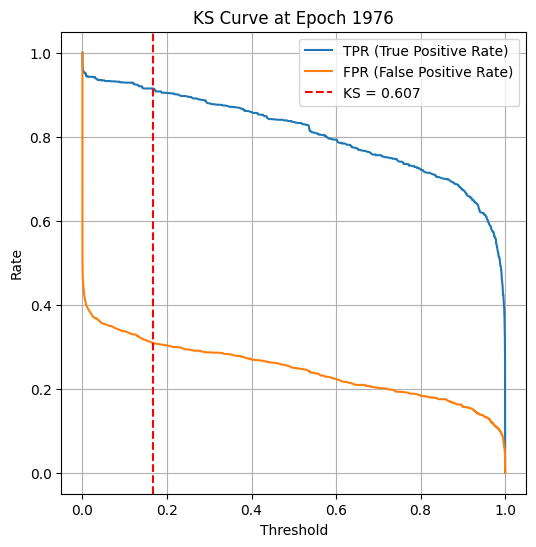

Epoch 1980 — Train Loss: 0.2110 | Train Acc: 0.9086 | Val KS: 0.6228 | Val Acc: 0.8013 | Val Prec: 0.7860 | Val Recall: 0.8280 | Val F1: 0.8065
Epoch 1990 — Train Loss: 0.2129 | Train Acc: 0.9084 | Val KS: 0.6088 | Val Acc: 0.8013 | Val Prec: 0.7920 | Val Recall: 0.8172 | Val F1: 0.8044
Epoch 1999 — Train Loss: 0.2197 | Train Acc: 0.9047 | Val KS: 0.6127 | Val Acc: 0.8048 | Val Prec: 0.7661 | Val Recall: 0.8776 | Val F1: 0.8181


In [ ]:

# Model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = STABTransformer(input_dim=X_train_tensor.shape[1], n_heads=32, n_layers=1, dropout=0.3).to(device)
optimizer = torch.optim.RMSprop(model.parameters(), lr=1e-3)
loss_fn = nn.BCELoss()


epochs=2000
for epoch in range(epochs):
    model.train()
    epoch_loss = 0

    all_preds = []
    all_targets = []

    for xb, yb in train_loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).squeeze()
        loss = loss_fn(pred, yb)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()

        preds_np = (pred > 0.5).detach().cpu().numpy()
        targets_np = yb.detach().cpu().numpy()

        all_preds.extend(preds_np)
        all_targets.extend(targets_np)

    # Training metrics
    acc = accuracy_score(all_targets, all_preds)
    prec = precision_score(all_targets, all_preds)
    rec = recall_score(all_targets, all_preds)
    f1 = f1_score(all_targets, all_preds)

    # Validation metrics
    ks_val, acc_val, prec_val, rec_val, f1_val = evaluate_validation(model, val_loader, device, epoch)

    if epoch % 10 == 0 or epoch == epochs - 1:
        print(f"Epoch {epoch:03d} — Train Loss: {epoch_loss/len(train_loader):.4f} | "
              f"Train Acc: {acc:.4f} | Val KS: {ks_val:.4f} | Val Acc: {acc_val:.4f} | "
              f"Val Prec: {prec_val:.4f} | Val Recall: {rec_val:.4f} | Val F1: {f1_val:.4f}")


✅ Accuracy: 0.8300
✅ Precision: 0.7922
✅ Recall: 0.8947
✅ F1 Score: 0.8403


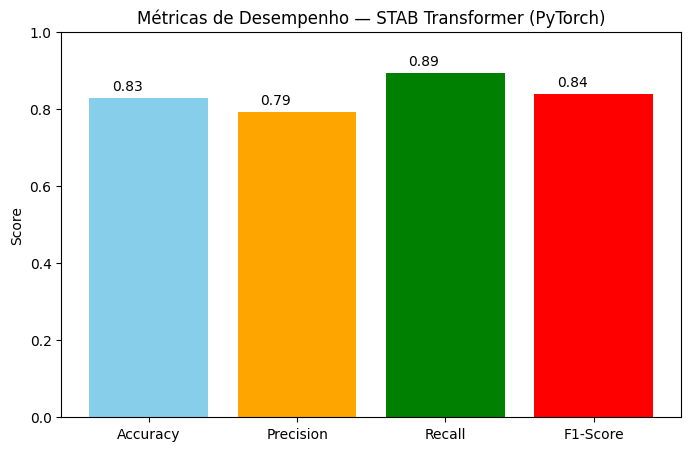

In [ ]:
model.eval()
X_test_tensor = torch.tensor(X_test_nn, dtype=torch.float32)
y_test_tensor = torch.tensor(y_test_nn.values, dtype=torch.float32)  # <-- Aqui está o fix

with torch.no_grad():
    y_pred_prob = model(X_test_tensor.to(device)).cpu().squeeze().numpy()
    y_pred = (y_pred_prob >= 0.5).astype(int)

acc = accuracy_score(y_test_nn, y_pred)
prec = precision_score(y_test_nn, y_pred)
rec = recall_score(y_test_nn, y_pred)
f1 = f1_score(y_test_nn, y_pred)

print(f"✅ Accuracy: {acc:.4f}")
print(f"✅ Precision: {prec:.4f}")
print(f"✅ Recall: {rec:.4f}")
print(f"✅ F1 Score: {f1:.4f}")

metrics_names = ['Accuracy', 'Precision', 'Recall', 'F1-Score']
metrics_values = [acc, prec, rec, f1]

plt.figure(figsize=(8, 5))
bars = plt.bar(metrics_names, metrics_values, color=['skyblue', 'orange', 'green', 'red'])
plt.ylim(0, 1)
plt.title('Métricas de Desempenho — STAB Transformer (PyTorch)')
plt.ylabel('Score')
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + 0.15, yval + 0.02, f'{yval:.2f}')
plt.show()



In [ ]:

torch.save(model.state_dict(), 'stab_transformer_16head_1layer_0.1droput_1000epochs.pt')
files.download('stab_transformer_16head_1layer_0.1droput_1000epochs.pt')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# 🌲 5. Modelagem com Árvores (Pessoa 3)

In [ ]:
from sklearn.metrics import classification_report, mean_squared_error, mean_absolute_error, roc_auc_score, f1_score, roc_curve, auc, confusion_matrix
from scipy.stats import ks_2samp
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns # Importar seaborn para a matriz de confusão

def avaliar_modelo(model, X, y):
    y_pred = model.predict(X)
    y_pred_prob = None

    # Check if the model has predict_proba method (for probability-based metrics like ROC AUC and KS)
    if hasattr(model, "predict_proba"):
        y_pred_prob = model.predict_proba(X)[:, 1]
    elif hasattr(model, "predict"): # Handle Keras/PyTorch models that might have predict
         y_pred_prob = model.predict(X)
         if isinstance(y_pred_prob, np.ndarray) and y_pred_prob.ndim > 1:
             y_pred_prob = y_pred_prob.squeeze() # Ensure 1D array

    print("📊 Classification Report:")
    # Handle cases where target names might not be available or are different
    try:
        print(classification_report(y, y_pred, target_names=["Não Churn", "Churn"]))
    except ValueError:
        print(classification_report(y, y_pred))


    # Calculate additional metrics
    mse = mean_squared_error(y, y_pred)
    mae = mean_absolute_error(y, y_pred)
    print(f"MSE: {mse:.4f}")
    print(f"MAE: {mae:.4f}")

    if y_pred_prob is not None:
        # Ensure y and y_pred_prob are compatible for metrics
        y_true_flat = np.asarray(y).ravel()
        y_pred_prob_flat = np.asarray(y_pred_prob).ravel()

        # ROC AUC
        roc_auc = roc_auc_score(y_true_flat, y_pred_prob_flat)
        print(f"ROC AUC: {roc_auc:.4f}")

        # Plot ROC Curve
        fpr, tpr, thresholds = roc_curve(y_true_flat, y_pred_prob_flat)
        plt.figure(figsize=(10, 6))
        plt.plot(fpr, tpr, color='blue', label=f'Curva ROC (AUC = {roc_auc:.2f})')
        plt.plot([0, 1], [0, 1], color='gray', linestyle='--', label='Linha Aleatória (AUC = 0.5)')
        plt.title("Curva ROC")
        plt.xlabel("Taxa de Falsos Positivos (FPR)")
        plt.ylabel("Taxa de Verdadeiros Positivos (TPR)")
        plt.legend(loc="lower right")
        plt.tight_layout()
        plt.show()


        # Calculate and Plot KS statistic
        try:
            # Ensure y_true_flat is integer type for KS calculation below
            y_true_int = y_true_flat.astype(int)

            # Sort by score
            order = np.argsort(y_pred_prob_flat)
            y_sorted = y_true_int[order]
            s_sorted = y_pred_prob_flat[order]

            # Totals
            n_pos = (y_sorted == 1).sum()
            n_neg = (y_sorted == 0).sum()

            if n_pos > 0 and n_neg > 0:
                # Cumulative CDFs
                cum_pos = np.cumsum(y_sorted == 1) / n_pos
                cum_neg = np.cumsum(y_sorted == 0) / n_neg

                # KS distance
                ks_diff = np.abs(cum_pos - cum_neg)
                ks_idx  = np.argmax(ks_diff)
                ks_val  = float(ks_diff[ks_idx])
                ks_thr  = float(s_sorted[ks_idx])

                print(f"KS: {ks_val:.4f}")

                # Plot (CDFs + KS annotation)
                plt.figure(figsize=(7, 5))
                plt.plot(s_sorted, cum_pos, label="CDF Positivos", linewidth=2)
                plt.plot(s_sorted, cum_neg, label="CDF Negativos", linewidth=2)
                plt.vlines(ks_thr, cum_neg[ks_idx], cum_pos[ks_idx], linestyles="--")
                plt.scatter([ks_thr, ks_thr], [cum_pos[ks_idx], cum_neg[ks_idx]])

                plt.title(f"KS Statistic | KS={ks_val:.3f} @thr={ks_thr:.4f}")
                plt.xlabel("Probabilidade prevista (score)")
                plt.ylabel("Fração cumulativa")
                plt.legend(loc="lower right")
                plt.tight_layout()
                plt.show()
            else:
                print("KS Statistic could not be calculated (not enough samples in one or both classes).")

        except ValueError:
            print("KS Statistic could not be calculated (perhaps only one class present).")

    f1 = f1_score(y, y_pred)
    print(f"F1 Score: {f1:.4f}")

    # Matriz de Confusão
    print("\nMatriz de Confusão:")
    cm = confusion_matrix(y, y_pred)
    plt.figure(figsize=(6, 4))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['Não Churn', 'Churn'], yticklabels=['Não Churn', 'Churn'])
    plt.xlabel('Predito')
    plt.ylabel('Real')
    plt.title('Matriz de Confusão')
    plt.show()

In [ ]:
print(y_train_trees.value_counts())
print(y_val_trees.value_counts())
print(y_test_trees.value_counts())

Churn
1    3365
0    3097
Name: count, dtype: int64
Churn
1    1121
0    1033
Name: count, dtype: int64
Churn
1    1121
0    1033
Name: count, dtype: int64


In [ ]:
#saving model
import pickle

def save_model(model, filename):
    with open(filename, 'wb') as file:
        pickle.dump(model, file)

[I 2025-08-11 22:26:04,533] A new study created in memory with name: no-name-84ae25ee-76cb-40c6-836d-b1971bcc71cb


Realizando otimização de hiperparâmetros para Random Forest com Optuna...
Starting Trial 0


[I 2025-08-11 22:26:05,204] Trial 0 finished with value: 0.5210351012484531 and parameters: {'n_estimators': 203, 'max_depth': 4, 'min_samples_split': 16, 'min_samples_leaf': 3, 'criterion': 'entropy'}. Best is trial 0 with value: 0.5210351012484531.


Trial 0 finished with KS: 0.5210
Starting Trial 1


[I 2025-08-11 22:26:05,501] Trial 1 finished with value: 0.5080574753042548 and parameters: {'n_estimators': 83, 'max_depth': 3, 'min_samples_split': 14, 'min_samples_leaf': 10, 'criterion': 'entropy'}. Best is trial 0 with value: 0.5210351012484531.


Trial 1 finished with KS: 0.5081
Starting Trial 2


[I 2025-08-11 22:26:06,079] Trial 2 finished with value: 0.5180549450644347 and parameters: {'n_estimators': 167, 'max_depth': 4, 'min_samples_split': 6, 'min_samples_leaf': 11, 'criterion': 'entropy'}. Best is trial 0 with value: 0.5210351012484531.


Trial 2 finished with KS: 0.5181
Starting Trial 3


[I 2025-08-11 22:26:06,525] Trial 3 finished with value: 0.5199150599355955 and parameters: {'n_estimators': 126, 'max_depth': 4, 'min_samples_split': 10, 'min_samples_leaf': 11, 'criterion': 'entropy'}. Best is trial 0 with value: 0.5210351012484531.


Trial 3 finished with KS: 0.5199
Starting Trial 4


[I 2025-08-11 22:26:06,746] Trial 4 finished with value: 0.49613685056818135 and parameters: {'n_estimators': 79, 'max_depth': 2, 'min_samples_split': 14, 'min_samples_leaf': 4, 'criterion': 'gini'}. Best is trial 0 with value: 0.5210351012484531.


Trial 4 finished with KS: 0.4961
Starting Trial 5


[I 2025-08-11 22:26:07,302] Trial 5 finished with value: 0.49435272924793155 and parameters: {'n_estimators': 209, 'max_depth': 2, 'min_samples_split': 13, 'min_samples_leaf': 8, 'criterion': 'gini'}. Best is trial 0 with value: 0.5210351012484531.


Trial 5 finished with KS: 0.4944
Starting Trial 6


[I 2025-08-11 22:26:07,959] Trial 6 finished with value: 0.5190989928263815 and parameters: {'n_estimators': 195, 'max_depth': 4, 'min_samples_split': 10, 'min_samples_leaf': 14, 'criterion': 'entropy'}. Best is trial 0 with value: 0.5210351012484531.


Trial 6 finished with KS: 0.5191
Starting Trial 7


[I 2025-08-11 22:26:09,146] Trial 7 finished with value: 0.5198390663846846 and parameters: {'n_estimators': 233, 'max_depth': 4, 'min_samples_split': 11, 'min_samples_leaf': 15, 'criterion': 'entropy'}. Best is trial 0 with value: 0.5210351012484531.


Trial 7 finished with KS: 0.5198
Starting Trial 8


[I 2025-08-11 22:26:10,435] Trial 8 finished with value: 0.5194029670300252 and parameters: {'n_estimators': 253, 'max_depth': 4, 'min_samples_split': 15, 'min_samples_leaf': 14, 'criterion': 'gini'}. Best is trial 0 with value: 0.5210351012484531.


Trial 8 finished with KS: 0.5194
Starting Trial 9


[I 2025-08-11 22:26:11,020] Trial 9 finished with value: 0.5220031554594889 and parameters: {'n_estimators': 167, 'max_depth': 4, 'min_samples_split': 18, 'min_samples_leaf': 3, 'criterion': 'entropy'}. Best is trial 9 with value: 0.5220031554594889.


Trial 9 finished with KS: 0.5220
Starting Trial 10


[I 2025-08-11 22:26:11,895] Trial 10 finished with value: 0.5139219321705745 and parameters: {'n_estimators': 295, 'max_depth': 3, 'min_samples_split': 20, 'min_samples_leaf': 6, 'criterion': 'gini'}. Best is trial 9 with value: 0.5220031554594889.


Trial 10 finished with KS: 0.5139
Starting Trial 11


[I 2025-08-11 22:26:12,384] Trial 11 finished with value: 0.5147379992797884 and parameters: {'n_estimators': 157, 'max_depth': 3, 'min_samples_split': 19, 'min_samples_leaf': 3, 'criterion': 'entropy'}. Best is trial 9 with value: 0.5220031554594889.


Trial 11 finished with KS: 0.5147
Starting Trial 12


[I 2025-08-11 22:26:12,835] Trial 12 finished with value: 0.5238632703306497 and parameters: {'n_estimators': 128, 'max_depth': 4, 'min_samples_split': 17, 'min_samples_leaf': 5, 'criterion': 'entropy'}. Best is trial 12 with value: 0.5238632703306497.


Trial 12 finished with KS: 0.5239
Starting Trial 13


[I 2025-08-11 22:26:13,236] Trial 13 finished with value: 0.5102578340283577 and parameters: {'n_estimators': 123, 'max_depth': 3, 'min_samples_split': 18, 'min_samples_leaf': 6, 'criterion': 'entropy'}. Best is trial 12 with value: 0.5238632703306497.
[I 2025-08-11 22:26:13,429] Trial 14 finished with value: 0.5026688416942071 and parameters: {'n_estimators': 51, 'max_depth': 3, 'min_samples_split': 17, 'min_samples_leaf': 5, 'criterion': 'entropy'}. Best is trial 12 with value: 0.5238632703306497.


Trial 13 finished with KS: 0.5103
Starting Trial 14
Trial 14 finished with KS: 0.5027
Starting Trial 15


[I 2025-08-11 22:26:13,921] Trial 15 finished with value: 0.5228952161196139 and parameters: {'n_estimators': 134, 'max_depth': 4, 'min_samples_split': 3, 'min_samples_leaf': 8, 'criterion': 'entropy'}. Best is trial 12 with value: 0.5238632703306497.


Trial 15 finished with KS: 0.5229
Starting Trial 16


[I 2025-08-11 22:26:14,387] Trial 16 finished with value: 0.5237872767797387 and parameters: {'n_estimators': 124, 'max_depth': 4, 'min_samples_split': 3, 'min_samples_leaf': 8, 'criterion': 'entropy'}. Best is trial 12 with value: 0.5238632703306497.


Trial 16 finished with KS: 0.5238
Starting Trial 17


[I 2025-08-11 22:26:14,737] Trial 17 finished with value: 0.5111697566392889 and parameters: {'n_estimators': 102, 'max_depth': 3, 'min_samples_split': 7, 'min_samples_leaf': 7, 'criterion': 'entropy'}. Best is trial 12 with value: 0.5238632703306497.


Trial 17 finished with KS: 0.5112
Starting Trial 18


[I 2025-08-11 22:26:15,162] Trial 18 finished with value: 0.4996489616085762 and parameters: {'n_estimators': 139, 'max_depth': 2, 'min_samples_split': 2, 'min_samples_leaf': 9, 'criterion': 'gini'}. Best is trial 12 with value: 0.5238632703306497.


Trial 18 finished with KS: 0.4996
Starting Trial 19


[I 2025-08-11 22:26:15,542] Trial 19 finished with value: 0.5258753723036322 and parameters: {'n_estimators': 103, 'max_depth': 4, 'min_samples_split': 5, 'min_samples_leaf': 5, 'criterion': 'entropy'}. Best is trial 19 with value: 0.5258753723036322.


Trial 19 finished with KS: 0.5259
Starting Trial 20


[I 2025-08-11 22:26:15,754] Trial 20 finished with value: 0.5214150690030078 and parameters: {'n_estimators': 50, 'max_depth': 4, 'min_samples_split': 7, 'min_samples_leaf': 5, 'criterion': 'entropy'}. Best is trial 19 with value: 0.5258753723036322.


Trial 20 finished with KS: 0.5214
Starting Trial 21


[I 2025-08-11 22:26:16,128] Trial 21 finished with value: 0.5261793465072759 and parameters: {'n_estimators': 98, 'max_depth': 4, 'min_samples_split': 4, 'min_samples_leaf': 6, 'criterion': 'entropy'}. Best is trial 21 with value: 0.5261793465072759.


Trial 21 finished with KS: 0.5262
Starting Trial 22


[I 2025-08-11 22:26:16,516] Trial 22 finished with value: 0.5269954136164899 and parameters: {'n_estimators': 105, 'max_depth': 4, 'min_samples_split': 5, 'min_samples_leaf': 5, 'criterion': 'entropy'}. Best is trial 22 with value: 0.5269954136164899.


Trial 22 finished with KS: 0.5270
Starting Trial 23


[I 2025-08-11 22:26:16,848] Trial 23 finished with value: 0.5240152574324716 and parameters: {'n_estimators': 90, 'max_depth': 4, 'min_samples_split': 5, 'min_samples_leaf': 6, 'criterion': 'entropy'}. Best is trial 22 with value: 0.5269954136164899.


Trial 23 finished with KS: 0.5240
Starting Trial 24


[I 2025-08-11 22:26:17,255] Trial 24 finished with value: 0.5258753723036322 and parameters: {'n_estimators': 103, 'max_depth': 4, 'min_samples_split': 5, 'min_samples_leaf': 4, 'criterion': 'entropy'}. Best is trial 22 with value: 0.5269954136164899.


Trial 24 finished with KS: 0.5259
Starting Trial 25


[I 2025-08-11 22:26:17,491] Trial 25 finished with value: 0.5053251617237755 and parameters: {'n_estimators': 67, 'max_depth': 3, 'min_samples_split': 8, 'min_samples_leaf': 7, 'criterion': 'entropy'}. Best is trial 22 with value: 0.5269954136164899.


Trial 25 finished with KS: 0.5053
Starting Trial 26


[I 2025-08-11 22:26:17,868] Trial 26 finished with value: 0.5246793374398636 and parameters: {'n_estimators': 110, 'max_depth': 4, 'min_samples_split': 4, 'min_samples_leaf': 4, 'criterion': 'gini'}. Best is trial 22 with value: 0.5269954136164899.


Trial 26 finished with KS: 0.5247
Starting Trial 27


[I 2025-08-11 22:26:18,383] Trial 27 finished with value: 0.5157060534908242 and parameters: {'n_estimators': 154, 'max_depth': 3, 'min_samples_split': 8, 'min_samples_leaf': 7, 'criterion': 'entropy'}. Best is trial 22 with value: 0.5269954136164899.


Trial 27 finished with KS: 0.5157
Starting Trial 28


[I 2025-08-11 22:26:18,639] Trial 28 finished with value: 0.5240912509833825 and parameters: {'n_estimators': 64, 'max_depth': 4, 'min_samples_split': 2, 'min_samples_leaf': 5, 'criterion': 'entropy'}. Best is trial 22 with value: 0.5269954136164899.


Trial 28 finished with KS: 0.5241
Starting Trial 29


[I 2025-08-11 22:26:19,289] Trial 29 finished with value: 0.5240912509833825 and parameters: {'n_estimators': 184, 'max_depth': 4, 'min_samples_split': 5, 'min_samples_leaf': 3, 'criterion': 'entropy'}. Best is trial 22 with value: 0.5269954136164899.


Trial 29 finished with KS: 0.5241
Starting Trial 30


[I 2025-08-11 22:26:19,632] Trial 30 finished with value: 0.5250593051944182 and parameters: {'n_estimators': 91, 'max_depth': 4, 'min_samples_split': 9, 'min_samples_leaf': 6, 'criterion': 'entropy'}. Best is trial 22 with value: 0.5269954136164899.


Trial 30 finished with KS: 0.5251
Starting Trial 31


[I 2025-08-11 22:26:20,006] Trial 31 finished with value: 0.5260273594054541 and parameters: {'n_estimators': 104, 'max_depth': 4, 'min_samples_split': 5, 'min_samples_leaf': 4, 'criterion': 'entropy'}. Best is trial 22 with value: 0.5269954136164899.


Trial 31 finished with KS: 0.5260
Starting Trial 32


[I 2025-08-11 22:26:20,422] Trial 32 finished with value: 0.5228952161196139 and parameters: {'n_estimators': 112, 'max_depth': 4, 'min_samples_split': 6, 'min_samples_leaf': 4, 'criterion': 'entropy'}. Best is trial 22 with value: 0.5269954136164899.


Trial 32 finished with KS: 0.5229
Starting Trial 33


[I 2025-08-11 22:26:20,899] Trial 33 finished with value: 0.5238632703306497 and parameters: {'n_estimators': 82, 'max_depth': 4, 'min_samples_split': 4, 'min_samples_leaf': 5, 'criterion': 'entropy'}. Best is trial 22 with value: 0.5269954136164899.


Trial 33 finished with KS: 0.5239
Starting Trial 34


[I 2025-08-11 22:26:21,703] Trial 34 finished with value: 0.5238632703306497 and parameters: {'n_estimators': 141, 'max_depth': 4, 'min_samples_split': 6, 'min_samples_leaf': 4, 'criterion': 'entropy'}. Best is trial 22 with value: 0.5269954136164899.


Trial 34 finished with KS: 0.5239
Starting Trial 35


[I 2025-08-11 22:26:22,117] Trial 35 finished with value: 0.5270714071674009 and parameters: {'n_estimators': 73, 'max_depth': 4, 'min_samples_split': 4, 'min_samples_leaf': 9, 'criterion': 'entropy'}. Best is trial 35 with value: 0.5270714071674009.


Trial 35 finished with KS: 0.5271
Starting Trial 36


[I 2025-08-11 22:26:22,563] Trial 36 finished with value: 0.525363279398062 and parameters: {'n_estimators': 70, 'max_depth': 4, 'min_samples_split': 3, 'min_samples_leaf': 11, 'criterion': 'entropy'}. Best is trial 35 with value: 0.5270714071674009.


Trial 36 finished with KS: 0.5254
Starting Trial 37


[I 2025-08-11 22:26:22,864] Trial 37 finished with value: 0.49644082477182505 and parameters: {'n_estimators': 88, 'max_depth': 2, 'min_samples_split': 4, 'min_samples_leaf': 10, 'criterion': 'gini'}. Best is trial 35 with value: 0.5270714071674009.


Trial 37 finished with KS: 0.4964
Starting Trial 38


[I 2025-08-11 22:26:23,144] Trial 38 finished with value: 0.526919420065579 and parameters: {'n_estimators': 71, 'max_depth': 4, 'min_samples_split': 12, 'min_samples_leaf': 12, 'criterion': 'entropy'}. Best is trial 35 with value: 0.5270714071674009.


Trial 38 finished with KS: 0.5269
Starting Trial 39


[I 2025-08-11 22:26:23,427] Trial 39 finished with value: 0.50486920041831 and parameters: {'n_estimators': 75, 'max_depth': 3, 'min_samples_split': 12, 'min_samples_leaf': 12, 'criterion': 'entropy'}. Best is trial 35 with value: 0.5270714071674009.


Trial 39 finished with KS: 0.5049
Starting Trial 40


[I 2025-08-11 22:26:23,644] Trial 40 finished with value: 0.5246793374398636 and parameters: {'n_estimators': 56, 'max_depth': 4, 'min_samples_split': 13, 'min_samples_leaf': 12, 'criterion': 'gini'}. Best is trial 35 with value: 0.5270714071674009.


Trial 40 finished with KS: 0.5247
Starting Trial 41


[I 2025-08-11 22:26:23,987] Trial 41 finished with value: 0.5240152574324716 and parameters: {'n_estimators': 93, 'max_depth': 4, 'min_samples_split': 11, 'min_samples_leaf': 13, 'criterion': 'entropy'}. Best is trial 35 with value: 0.5270714071674009.


Trial 41 finished with KS: 0.5240
Starting Trial 42


[I 2025-08-11 22:26:24,276] Trial 42 finished with value: 0.5270714071674009 and parameters: {'n_estimators': 75, 'max_depth': 4, 'min_samples_split': 9, 'min_samples_leaf': 9, 'criterion': 'entropy'}. Best is trial 35 with value: 0.5270714071674009.


Trial 42 finished with KS: 0.5271
Starting Trial 43


[I 2025-08-11 22:26:24,584] Trial 43 finished with value: 0.5270714071674009 and parameters: {'n_estimators': 75, 'max_depth': 4, 'min_samples_split': 10, 'min_samples_leaf': 9, 'criterion': 'entropy'}. Best is trial 35 with value: 0.5270714071674009.


Trial 43 finished with KS: 0.5271
Starting Trial 44


[I 2025-08-11 22:26:24,885] Trial 44 finished with value: 0.5240912509833825 and parameters: {'n_estimators': 78, 'max_depth': 4, 'min_samples_split': 10, 'min_samples_leaf': 10, 'criterion': 'entropy'}. Best is trial 35 with value: 0.5270714071674009.


Trial 44 finished with KS: 0.5241
Starting Trial 45


[I 2025-08-11 22:26:25,144] Trial 45 finished with value: 0.5262553400581869 and parameters: {'n_estimators': 63, 'max_depth': 4, 'min_samples_split': 12, 'min_samples_leaf': 9, 'criterion': 'entropy'}. Best is trial 35 with value: 0.5270714071674009.


Trial 45 finished with KS: 0.5263
Starting Trial 46


[I 2025-08-11 22:26:25,438] Trial 46 finished with value: 0.526103352956365 and parameters: {'n_estimators': 75, 'max_depth': 4, 'min_samples_split': 15, 'min_samples_leaf': 10, 'criterion': 'entropy'}. Best is trial 35 with value: 0.5270714071674009.


Trial 46 finished with KS: 0.5261
Starting Trial 47


[I 2025-08-11 22:26:26,212] Trial 47 finished with value: 0.5201430405883283 and parameters: {'n_estimators': 223, 'max_depth': 4, 'min_samples_split': 9, 'min_samples_leaf': 9, 'criterion': 'entropy'}. Best is trial 35 with value: 0.5270714071674009.


Trial 47 finished with KS: 0.5201
Starting Trial 48


[I 2025-08-11 22:26:26,458] Trial 48 finished with value: 0.5223071296631326 and parameters: {'n_estimators': 60, 'max_depth': 4, 'min_samples_split': 11, 'min_samples_leaf': 11, 'criterion': 'entropy'}. Best is trial 35 with value: 0.5270714071674009.


Trial 48 finished with KS: 0.5223
Starting Trial 49


[I 2025-08-11 22:26:26,836] Trial 49 finished with value: 0.5074495268969674 and parameters: {'n_estimators': 116, 'max_depth': 3, 'min_samples_split': 14, 'min_samples_leaf': 15, 'criterion': 'gini'}. Best is trial 35 with value: 0.5270714071674009.


Trial 49 finished with KS: 0.5074
Otimização de hiperparâmetros para Random Forest concluída.
Melhores hiperparâmetros para Random Forest: {'n_estimators': 73, 'max_depth': 4, 'min_samples_split': 4, 'min_samples_leaf': 9, 'criterion': 'entropy'}
Melhor KS score (CV) para Random Forest: 0.5271

Avaliação do melhor modelo Random Forest no conjunto de teste:
📊 Classification Report:
              precision    recall  f1-score   support

   Não Churn       0.79      0.67      0.73      1033
       Churn       0.73      0.84      0.78      1121

    accuracy                           0.76      2154
   macro avg       0.76      0.75      0.75      2154
weighted avg       0.76      0.76      0.76      2154

MSE: 0.2419
MAE: 0.2419
ROC AUC: 0.8350


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2732: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2732: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


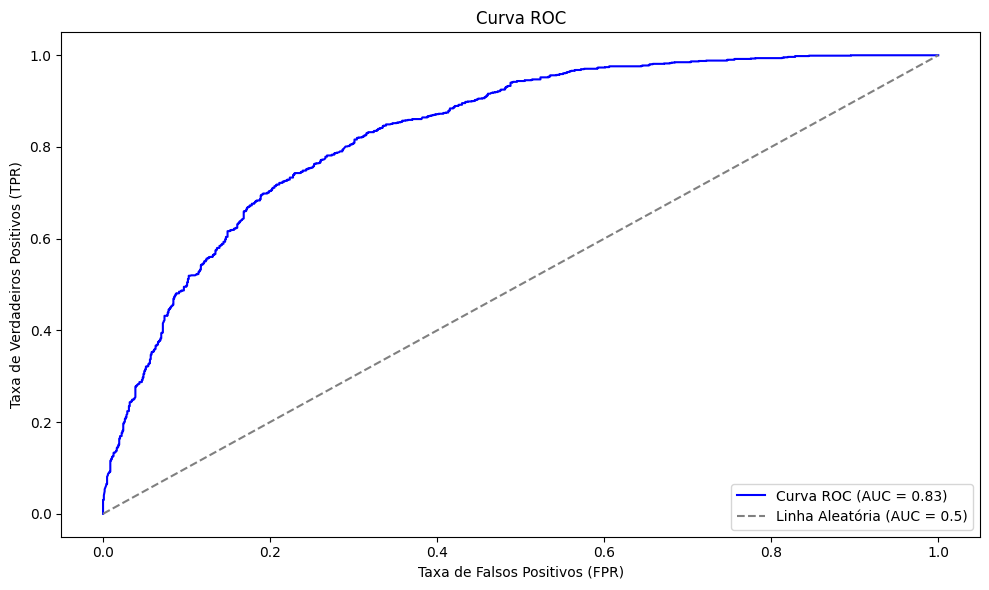

KS: 0.5158


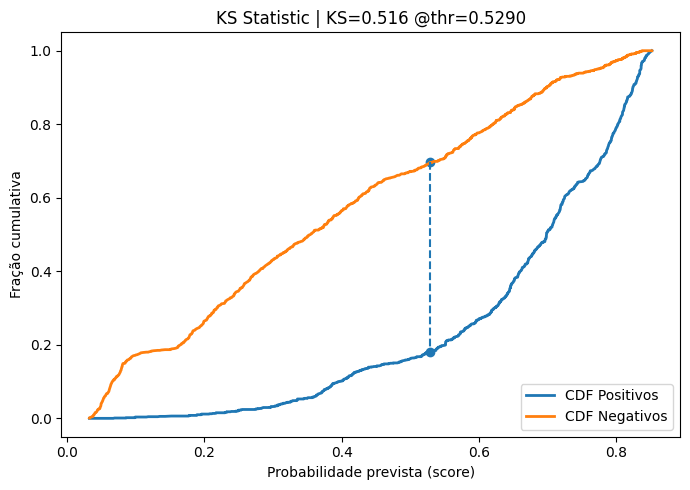

F1 Score: 0.7830

Matriz de Confusão:


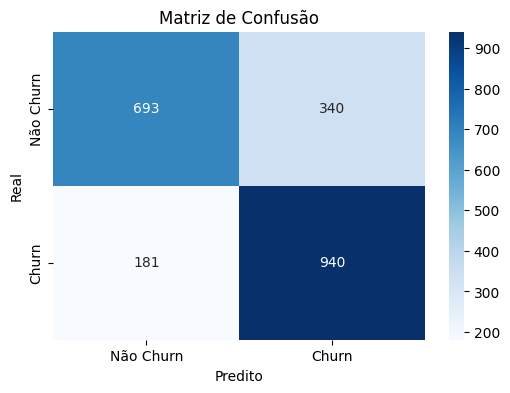

Modelo salvo em random_forest_best_without_kfold.pkl


In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score, StratifiedKFold
from sklearn.metrics import make_scorer
from scipy.stats import ks_2samp
import optuna
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

# Define a scorer for KS statistic (Optuna maximizes the objective function)
def ks_scorer_optuna(y_true, y_pred_prob):
    y_true = np.asarray(y_true)  # garante numpy
    y_pred_prob = np.asarray(y_pred_prob)

    if y_pred_prob.ndim == 2 and y_pred_prob.shape[1] == 2:
        y_pred_prob = y_pred_prob[:, 1]

    unique_classes, counts = np.unique(y_true, return_counts=True)
    print(f"  Fold y_true unique classes: {unique_classes}, counts: {counts}")

    if len(unique_classes) < 2:
        return -1.0

    if np.sum(y_true == unique_classes[0]) < 2 or np.sum(y_true == unique_classes[1]) < 2:
        return -1.0

    ks_statistic = ks_2samp(y_pred_prob[y_true == 0], y_pred_prob[y_true == 1]).statistic
    print(f"  Calculated KS: {ks_statistic:.4f}")
    return ks_statistic


# Objective function for Optuna - Random Forest
def objective_rf(trial):
    print(f"Starting Trial {trial.number}")

    # Hiperparâmetros sugeridos pelo Optuna
    n_estimators = trial.suggest_int('n_estimators', 50, 300)
    max_depth = trial.suggest_int('max_depth', 2, 4)
    min_samples_split = trial.suggest_int('min_samples_split', 2, 20)
    min_samples_leaf = trial.suggest_int('min_samples_leaf', 3, 15)
    criterion = trial.suggest_categorical('criterion', ['gini', 'entropy'])

    model = RandomForestClassifier(
        n_estimators=n_estimators,
        max_depth=max_depth,
        min_samples_split=min_samples_split,
        min_samples_leaf=min_samples_leaf,
        criterion=criterion,
        random_state=42,
        n_jobs=-1
    )

    model.fit(X_train_trees, y_train_trees)
    y_pred_prob = model.predict_proba(X_val_trees)[:, 1]  # prob da classe positiva

    # KS calculation
    ks_value = ks_2samp(y_pred_prob[y_val_trees == 0], y_pred_prob[y_val_trees == 1]).statistic
    print(f"Trial {trial.number} finished with KS: {ks_value:.4f}")
    return ks_value

print("Realizando otimização de hiperparâmetros para Random Forest com Optuna...")

# Combine training and validation data for Optuna
X_trainval_trees = np.vstack((X_train_trees, X_val_trees))
y_trainval_trees = np.concatenate((y_train_trees, y_val_trees))

study_rf = optuna.create_study(direction='maximize') # We want to maximize the KS score
study_rf.optimize(objective_rf, n_trials=50) # Run 50 trials (adjust as needed)

print("Otimização de hiperparâmetros para Random Forest concluída.")
print(f"Melhores hiperparâmetros para Random Forest: {study_rf.best_params}")
print(f"Melhor KS score (CV) para Random Forest: {study_rf.best_value:.4f}")

# Train the best model on the full training+validation data
best_rf_model = RandomForestClassifier(**study_rf.best_params, random_state=42, n_jobs=-1)
best_rf_model.fit(X_trainval_trees, y_trainval_trees)

# Evaluate the best model on the test set
print("\nAvaliação do melhor modelo Random Forest no conjunto de teste:")
avaliar_modelo(best_rf_model, X_test_trees, y_test_trees)

save_model(best_rf_model, "random_forest_best_without_kfold.pkl")
print("Modelo salvo em random_forest_best_without_kfold.pkl")

[I 2025-08-11 22:26:57,243] A new study created in memory with name: no-name-c3ff1653-67ed-4ed0-beca-8168318372c1


Realizando otimização de hiperparâmetros para Random Forest com Optuna...
Starting Trial 0
  Fold 1 KS: 0.5608
  Fold 2 KS: 0.5535
  Fold 3 KS: 0.5415
  Fold 4 KS: 0.5144


[I 2025-08-11 22:27:02,327] Trial 0 finished with value: 0.5409278630142811 and parameters: {'n_estimators': 257, 'max_depth': 4, 'min_samples_split': 10, 'min_samples_leaf': 3, 'criterion': 'entropy'}. Best is trial 0 with value: 0.5409278630142811.


  Fold 5 KS: 0.5344
Trial 0 finished with mean KS: 0.5409
Starting Trial 1
  Fold 1 KS: 0.5471
  Fold 2 KS: 0.5389
  Fold 3 KS: 0.5134
  Fold 4 KS: 0.4909


[I 2025-08-11 22:27:05,533] Trial 1 finished with value: 0.5204656055184455 and parameters: {'n_estimators': 243, 'max_depth': 2, 'min_samples_split': 13, 'min_samples_leaf': 6, 'criterion': 'gini'}. Best is trial 0 with value: 0.5409278630142811.


  Fold 5 KS: 0.5120
Trial 1 finished with mean KS: 0.5205
Starting Trial 2
  Fold 1 KS: 0.5482
  Fold 2 KS: 0.5365
  Fold 3 KS: 0.5128
  Fold 4 KS: 0.4894


[I 2025-08-11 22:27:08,571] Trial 2 finished with value: 0.5198661038646071 and parameters: {'n_estimators': 207, 'max_depth': 2, 'min_samples_split': 12, 'min_samples_leaf': 7, 'criterion': 'gini'}. Best is trial 0 with value: 0.5409278630142811.


  Fold 5 KS: 0.5125
Trial 2 finished with mean KS: 0.5199
Starting Trial 3
  Fold 1 KS: 0.5619
  Fold 2 KS: 0.5565
  Fold 3 KS: 0.5379
  Fold 4 KS: 0.5120


[I 2025-08-11 22:27:12,573] Trial 3 finished with value: 0.5409467800333936 and parameters: {'n_estimators': 209, 'max_depth': 4, 'min_samples_split': 20, 'min_samples_leaf': 3, 'criterion': 'gini'}. Best is trial 3 with value: 0.5409467800333936.


  Fold 5 KS: 0.5365
Trial 3 finished with mean KS: 0.5409
Starting Trial 4
  Fold 1 KS: 0.5586
  Fold 2 KS: 0.5499
  Fold 3 KS: 0.5360
  Fold 4 KS: 0.5002


[I 2025-08-11 22:27:16,744] Trial 4 finished with value: 0.5356789553284507 and parameters: {'n_estimators': 283, 'max_depth': 3, 'min_samples_split': 2, 'min_samples_leaf': 3, 'criterion': 'gini'}. Best is trial 3 with value: 0.5409467800333936.


  Fold 5 KS: 0.5337
Trial 4 finished with mean KS: 0.5357
Starting Trial 5
  Fold 1 KS: 0.5619
  Fold 2 KS: 0.5570
  Fold 3 KS: 0.5398
  Fold 4 KS: 0.5122


[I 2025-08-11 22:27:21,239] Trial 5 finished with value: 0.541723649933329 and parameters: {'n_estimators': 242, 'max_depth': 4, 'min_samples_split': 17, 'min_samples_leaf': 14, 'criterion': 'entropy'}. Best is trial 5 with value: 0.541723649933329.


  Fold 5 KS: 0.5377
Trial 5 finished with mean KS: 0.5417
Starting Trial 6
  Fold 1 KS: 0.5597
  Fold 2 KS: 0.5561
  Fold 3 KS: 0.5414
  Fold 4 KS: 0.5145


[I 2025-08-11 22:27:23,010] Trial 6 finished with value: 0.5420359202245749 and parameters: {'n_estimators': 81, 'max_depth': 4, 'min_samples_split': 15, 'min_samples_leaf': 11, 'criterion': 'gini'}. Best is trial 6 with value: 0.5420359202245749.


  Fold 5 KS: 0.5385
Trial 6 finished with mean KS: 0.5420
Starting Trial 7
  Fold 1 KS: 0.5577
  Fold 2 KS: 0.5466
  Fold 3 KS: 0.5315
  Fold 4 KS: 0.5003


[I 2025-08-11 22:27:25,126] Trial 7 finished with value: 0.5332132998992786 and parameters: {'n_estimators': 138, 'max_depth': 3, 'min_samples_split': 6, 'min_samples_leaf': 10, 'criterion': 'gini'}. Best is trial 6 with value: 0.5420359202245749.


  Fold 5 KS: 0.5299
Trial 7 finished with mean KS: 0.5332
Starting Trial 8
  Fold 1 KS: 0.5485
  Fold 2 KS: 0.5322
  Fold 3 KS: 0.5097
  Fold 4 KS: 0.4915


[I 2025-08-11 22:27:27,805] Trial 8 finished with value: 0.5179157661679207 and parameters: {'n_estimators': 192, 'max_depth': 2, 'min_samples_split': 6, 'min_samples_leaf': 11, 'criterion': 'entropy'}. Best is trial 6 with value: 0.5420359202245749.


  Fold 5 KS: 0.5077
Trial 8 finished with mean KS: 0.5179
Starting Trial 9
  Fold 1 KS: 0.5530
  Fold 2 KS: 0.5343
  Fold 3 KS: 0.5172
  Fold 4 KS: 0.4916


[I 2025-08-11 22:27:29,381] Trial 9 finished with value: 0.5217556517149651 and parameters: {'n_estimators': 114, 'max_depth': 2, 'min_samples_split': 9, 'min_samples_leaf': 11, 'criterion': 'gini'}. Best is trial 6 with value: 0.5420359202245749.


  Fold 5 KS: 0.5126
Trial 9 finished with mean KS: 0.5218
Starting Trial 10
  Fold 1 KS: 0.5611
  Fold 2 KS: 0.5485
  Fold 3 KS: 0.5471
  Fold 4 KS: 0.5166


[I 2025-08-11 22:27:30,453] Trial 10 finished with value: 0.5437990854818227 and parameters: {'n_estimators': 57, 'max_depth': 4, 'min_samples_split': 16, 'min_samples_leaf': 15, 'criterion': 'entropy'}. Best is trial 10 with value: 0.5437990854818227.


  Fold 5 KS: 0.5456
Trial 10 finished with mean KS: 0.5438
Starting Trial 11
  Fold 1 KS: 0.5612
  Fold 2 KS: 0.5487
  Fold 3 KS: 0.5479
  Fold 4 KS: 0.5161


[I 2025-08-11 22:27:31,463] Trial 11 finished with value: 0.5438951603242019 and parameters: {'n_estimators': 53, 'max_depth': 4, 'min_samples_split': 16, 'min_samples_leaf': 15, 'criterion': 'entropy'}. Best is trial 11 with value: 0.5438951603242019.


  Fold 5 KS: 0.5456
Trial 11 finished with mean KS: 0.5439
Starting Trial 12
  Fold 1 KS: 0.5539
  Fold 2 KS: 0.5447
  Fold 3 KS: 0.5321


[I 2025-08-11 22:27:32,366] Trial 12 finished with value: 0.5325317599683135 and parameters: {'n_estimators': 51, 'max_depth': 3, 'min_samples_split': 18, 'min_samples_leaf': 15, 'criterion': 'entropy'}. Best is trial 11 with value: 0.5438951603242019.


  Fold 4 KS: 0.5062
  Fold 5 KS: 0.5258
Trial 12 finished with mean KS: 0.5325
Starting Trial 13
  Fold 1 KS: 0.5617
  Fold 2 KS: 0.5496
  Fold 3 KS: 0.5496
  Fold 4 KS: 0.5139


[I 2025-08-11 22:27:33,833] Trial 13 finished with value: 0.5441355530368535 and parameters: {'n_estimators': 50, 'max_depth': 4, 'min_samples_split': 15, 'min_samples_leaf': 13, 'criterion': 'entropy'}. Best is trial 13 with value: 0.5441355530368535.


  Fold 5 KS: 0.5458
Trial 13 finished with mean KS: 0.5441
Starting Trial 14
  Fold 1 KS: 0.5609
  Fold 2 KS: 0.5538
  Fold 3 KS: 0.5488
  Fold 4 KS: 0.5138


[I 2025-08-11 22:27:36,369] Trial 14 finished with value: 0.5436261011073129 and parameters: {'n_estimators': 122, 'max_depth': 4, 'min_samples_split': 14, 'min_samples_leaf': 13, 'criterion': 'entropy'}. Best is trial 13 with value: 0.5441355530368535.


  Fold 5 KS: 0.5408
Trial 14 finished with mean KS: 0.5436
Starting Trial 15
  Fold 1 KS: 0.5553
  Fold 2 KS: 0.5477
  Fold 3 KS: 0.5309
  Fold 4 KS: 0.5042


[I 2025-08-11 22:27:37,836] Trial 15 finished with value: 0.5336319572311123 and parameters: {'n_estimators': 90, 'max_depth': 3, 'min_samples_split': 20, 'min_samples_leaf': 13, 'criterion': 'entropy'}. Best is trial 13 with value: 0.5441355530368535.


  Fold 5 KS: 0.5300
Trial 15 finished with mean KS: 0.5336
Starting Trial 16
  Fold 1 KS: 0.5630
  Fold 2 KS: 0.5574
  Fold 3 KS: 0.5414
  Fold 4 KS: 0.5123


[I 2025-08-11 22:27:40,618] Trial 16 finished with value: 0.5421795900128984 and parameters: {'n_estimators': 160, 'max_depth': 4, 'min_samples_split': 17, 'min_samples_leaf': 8, 'criterion': 'entropy'}. Best is trial 13 with value: 0.5441355530368535.


  Fold 5 KS: 0.5368
Trial 16 finished with mean KS: 0.5422
Starting Trial 17
  Fold 1 KS: 0.5554
  Fold 2 KS: 0.5479
  Fold 3 KS: 0.5322
  Fold 4 KS: 0.5013


[I 2025-08-11 22:27:42,032] Trial 17 finished with value: 0.5332003112067876 and parameters: {'n_estimators': 86, 'max_depth': 3, 'min_samples_split': 11, 'min_samples_leaf': 13, 'criterion': 'entropy'}. Best is trial 13 with value: 0.5441355530368535.


  Fold 5 KS: 0.5292
Trial 17 finished with mean KS: 0.5332
Starting Trial 18
  Fold 1 KS: 0.5623
  Fold 2 KS: 0.5530
  Fold 3 KS: 0.5415
  Fold 4 KS: 0.5116


[I 2025-08-11 22:27:44,668] Trial 18 finished with value: 0.5412997784876339 and parameters: {'n_estimators': 147, 'max_depth': 4, 'min_samples_split': 8, 'min_samples_leaf': 12, 'criterion': 'entropy'}. Best is trial 13 with value: 0.5441355530368535.


  Fold 5 KS: 0.5381
Trial 18 finished with mean KS: 0.5413
Starting Trial 19
  Fold 1 KS: 0.5605
  Fold 2 KS: 0.5524
  Fold 3 KS: 0.5443
  Fold 4 KS: 0.5152


[I 2025-08-11 22:27:46,544] Trial 19 finished with value: 0.5420208904947774 and parameters: {'n_estimators': 68, 'max_depth': 4, 'min_samples_split': 14, 'min_samples_leaf': 15, 'criterion': 'entropy'}. Best is trial 13 with value: 0.5441355530368535.


  Fold 5 KS: 0.5377
Trial 19 finished with mean KS: 0.5420
Starting Trial 20
  Fold 1 KS: 0.5529
  Fold 2 KS: 0.5490
  Fold 3 KS: 0.5320
  Fold 4 KS: 0.5016


[I 2025-08-11 22:27:48,470] Trial 20 finished with value: 0.5324242829717207 and parameters: {'n_estimators': 108, 'max_depth': 3, 'min_samples_split': 18, 'min_samples_leaf': 9, 'criterion': 'entropy'}. Best is trial 13 with value: 0.5441355530368535.


  Fold 5 KS: 0.5267
Trial 20 finished with mean KS: 0.5324
Starting Trial 21
  Fold 1 KS: 0.5606
  Fold 2 KS: 0.5486
  Fold 3 KS: 0.5497
  Fold 4 KS: 0.5139


[I 2025-08-11 22:27:49,447] Trial 21 finished with value: 0.5437282010677734 and parameters: {'n_estimators': 50, 'max_depth': 4, 'min_samples_split': 16, 'min_samples_leaf': 15, 'criterion': 'entropy'}. Best is trial 13 with value: 0.5441355530368535.


  Fold 5 KS: 0.5458
Trial 21 finished with mean KS: 0.5437
Starting Trial 22
  Fold 1 KS: 0.5600
  Fold 2 KS: 0.5523
  Fold 3 KS: 0.5485
  Fold 4 KS: 0.5198


[I 2025-08-11 22:27:50,689] Trial 22 finished with value: 0.5439021786068281 and parameters: {'n_estimators': 67, 'max_depth': 4, 'min_samples_split': 15, 'min_samples_leaf': 14, 'criterion': 'entropy'}. Best is trial 13 with value: 0.5441355530368535.


  Fold 5 KS: 0.5390
Trial 22 finished with mean KS: 0.5439
Starting Trial 23
  Fold 1 KS: 0.5608
  Fold 2 KS: 0.5532
  Fold 3 KS: 0.5462
  Fold 4 KS: 0.5177


[I 2025-08-11 22:27:52,108] Trial 23 finished with value: 0.5438264137389188 and parameters: {'n_estimators': 77, 'max_depth': 4, 'min_samples_split': 13, 'min_samples_leaf': 14, 'criterion': 'entropy'}. Best is trial 13 with value: 0.5441355530368535.


  Fold 5 KS: 0.5411
Trial 23 finished with mean KS: 0.5438
Starting Trial 24
  Fold 1 KS: 0.5614
  Fold 2 KS: 0.5539
  Fold 3 KS: 0.5467
  Fold 4 KS: 0.5135


[I 2025-08-11 22:27:53,895] Trial 24 finished with value: 0.5431087892302776 and parameters: {'n_estimators': 98, 'max_depth': 4, 'min_samples_split': 15, 'min_samples_leaf': 12, 'criterion': 'entropy'}. Best is trial 13 with value: 0.5441355530368535.


  Fold 5 KS: 0.5401
Trial 24 finished with mean KS: 0.5431
Starting Trial 25
  Fold 1 KS: 0.5607
  Fold 2 KS: 0.5538
  Fold 3 KS: 0.5426
  Fold 4 KS: 0.5157


[I 2025-08-11 22:27:56,233] Trial 25 finished with value: 0.5417077238304463 and parameters: {'n_estimators': 129, 'max_depth': 4, 'min_samples_split': 19, 'min_samples_leaf': 14, 'criterion': 'entropy'}. Best is trial 13 with value: 0.5441355530368535.


  Fold 5 KS: 0.5357
Trial 25 finished with mean KS: 0.5417
Starting Trial 26
  Fold 1 KS: 0.5519
  Fold 2 KS: 0.5443
  Fold 3 KS: 0.5301
  Fold 4 KS: 0.5051


[I 2025-08-11 22:27:57,565] Trial 26 finished with value: 0.5320255358235443 and parameters: {'n_estimators': 69, 'max_depth': 3, 'min_samples_split': 12, 'min_samples_leaf': 12, 'criterion': 'entropy'}. Best is trial 13 with value: 0.5441355530368535.


  Fold 5 KS: 0.5287
Trial 26 finished with mean KS: 0.5320
Starting Trial 27
  Fold 1 KS: 0.5606
  Fold 2 KS: 0.5552
  Fold 3 KS: 0.5479
  Fold 4 KS: 0.5163


[I 2025-08-11 22:28:00,081] Trial 27 finished with value: 0.5435435662479138 and parameters: {'n_estimators': 102, 'max_depth': 4, 'min_samples_split': 15, 'min_samples_leaf': 14, 'criterion': 'entropy'}. Best is trial 13 with value: 0.5441355530368535.


  Fold 5 KS: 0.5378
Trial 27 finished with mean KS: 0.5435
Starting Trial 28
  Fold 1 KS: 0.5600
  Fold 2 KS: 0.5458
  Fold 3 KS: 0.5320
  Fold 4 KS: 0.5035


[I 2025-08-11 22:28:01,232] Trial 28 finished with value: 0.534289288475698 and parameters: {'n_estimators': 66, 'max_depth': 3, 'min_samples_split': 17, 'min_samples_leaf': 5, 'criterion': 'entropy'}. Best is trial 13 with value: 0.5441355530368535.


  Fold 5 KS: 0.5301
Trial 28 finished with mean KS: 0.5343
Starting Trial 29
  Fold 1 KS: 0.5629
  Fold 2 KS: 0.5553
  Fold 3 KS: 0.5426
  Fold 4 KS: 0.5111


[I 2025-08-11 22:28:04,208] Trial 29 finished with value: 0.5414356736973278 and parameters: {'n_estimators': 171, 'max_depth': 4, 'min_samples_split': 10, 'min_samples_leaf': 13, 'criterion': 'entropy'}. Best is trial 13 with value: 0.5441355530368535.


  Fold 5 KS: 0.5352
Trial 29 finished with mean KS: 0.5414
Starting Trial 30
  Fold 1 KS: 0.5605
  Fold 2 KS: 0.5563
  Fold 3 KS: 0.5457
  Fold 4 KS: 0.5135


[I 2025-08-11 22:28:05,857] Trial 30 finished with value: 0.5430258545800657 and parameters: {'n_estimators': 90, 'max_depth': 4, 'min_samples_split': 13, 'min_samples_leaf': 9, 'criterion': 'entropy'}. Best is trial 13 with value: 0.5441355530368535.


  Fold 5 KS: 0.5392
Trial 30 finished with mean KS: 0.5430
Starting Trial 31
  Fold 1 KS: 0.5597
  Fold 2 KS: 0.5537
  Fold 3 KS: 0.5461
  Fold 4 KS: 0.5163


[I 2025-08-11 22:28:07,237] Trial 31 finished with value: 0.5431680231989772 and parameters: {'n_estimators': 74, 'max_depth': 4, 'min_samples_split': 14, 'min_samples_leaf': 14, 'criterion': 'entropy'}. Best is trial 13 with value: 0.5441355530368535.


  Fold 5 KS: 0.5400
Trial 31 finished with mean KS: 0.5432
Starting Trial 32
  Fold 1 KS: 0.5617
  Fold 2 KS: 0.5464
  Fold 3 KS: 0.5509
  Fold 4 KS: 0.5151


[I 2025-08-11 22:28:08,228] Trial 32 finished with value: 0.5441930489675991 and parameters: {'n_estimators': 52, 'max_depth': 4, 'min_samples_split': 12, 'min_samples_leaf': 14, 'criterion': 'entropy'}. Best is trial 32 with value: 0.5441930489675991.


  Fold 5 KS: 0.5468
Trial 32 finished with mean KS: 0.5442
Starting Trial 33
  Fold 1 KS: 0.5611
  Fold 2 KS: 0.5485
  Fold 3 KS: 0.5471
  Fold 4 KS: 0.5166


[I 2025-08-11 22:28:09,293] Trial 33 finished with value: 0.5437990854818227 and parameters: {'n_estimators': 57, 'max_depth': 4, 'min_samples_split': 11, 'min_samples_leaf': 15, 'criterion': 'entropy'}. Best is trial 32 with value: 0.5441930489675991.


  Fold 5 KS: 0.5456
Trial 33 finished with mean KS: 0.5438
Starting Trial 34
  Fold 1 KS: 0.5617
  Fold 2 KS: 0.5475
  Fold 3 KS: 0.5509
  Fold 4 KS: 0.5139


[I 2025-08-11 22:28:10,778] Trial 34 finished with value: 0.5439509182169939 and parameters: {'n_estimators': 51, 'max_depth': 4, 'min_samples_split': 12, 'min_samples_leaf': 13, 'criterion': 'entropy'}. Best is trial 32 with value: 0.5441930489675991.


  Fold 5 KS: 0.5458
Trial 34 finished with mean KS: 0.5440
Starting Trial 35
  Fold 1 KS: 0.5599
  Fold 2 KS: 0.5570
  Fold 3 KS: 0.5496
  Fold 4 KS: 0.5123


[I 2025-08-11 22:28:12,325] Trial 35 finished with value: 0.543503237875732 and parameters: {'n_estimators': 69, 'max_depth': 4, 'min_samples_split': 12, 'min_samples_leaf': 12, 'criterion': 'gini'}. Best is trial 32 with value: 0.5441930489675991.


  Fold 5 KS: 0.5387
Trial 35 finished with mean KS: 0.5435
Starting Trial 36
  Fold 1 KS: 0.5608
  Fold 2 KS: 0.5557
  Fold 3 KS: 0.5391
  Fold 4 KS: 0.5147


[I 2025-08-11 22:28:17,195] Trial 36 finished with value: 0.5408179998977858 and parameters: {'n_estimators': 284, 'max_depth': 4, 'min_samples_split': 8, 'min_samples_leaf': 10, 'criterion': 'entropy'}. Best is trial 32 with value: 0.5441930489675991.


  Fold 5 KS: 0.5338
Trial 36 finished with mean KS: 0.5408
Starting Trial 37
  Fold 1 KS: 0.5593
  Fold 2 KS: 0.5556
  Fold 3 KS: 0.5400
  Fold 4 KS: 0.5117


[I 2025-08-11 22:28:18,811] Trial 37 finished with value: 0.5409252286032423 and parameters: {'n_estimators': 95, 'max_depth': 4, 'min_samples_split': 10, 'min_samples_leaf': 13, 'criterion': 'gini'}. Best is trial 32 with value: 0.5441930489675991.


  Fold 5 KS: 0.5380
Trial 37 finished with mean KS: 0.5409
Starting Trial 38
  Fold 1 KS: 0.5619
  Fold 2 KS: 0.5552
  Fold 3 KS: 0.5411
  Fold 4 KS: 0.5112


[I 2025-08-11 22:28:23,671] Trial 38 finished with value: 0.5410893051574956 and parameters: {'n_estimators': 241, 'max_depth': 4, 'min_samples_split': 13, 'min_samples_leaf': 6, 'criterion': 'entropy'}. Best is trial 32 with value: 0.5441930489675991.


  Fold 5 KS: 0.5360
Trial 38 finished with mean KS: 0.5411
Starting Trial 39
  Fold 1 KS: 0.5583
  Fold 2 KS: 0.5490
  Fold 3 KS: 0.5354
  Fold 4 KS: 0.5014


[I 2025-08-11 22:28:27,853] Trial 39 finished with value: 0.5352425334571855 and parameters: {'n_estimators': 217, 'max_depth': 3, 'min_samples_split': 3, 'min_samples_leaf': 10, 'criterion': 'gini'}. Best is trial 32 with value: 0.5441930489675991.


  Fold 5 KS: 0.5321
Trial 39 finished with mean KS: 0.5352
Starting Trial 40
  Fold 1 KS: 0.5536
  Fold 2 KS: 0.5419
  Fold 3 KS: 0.5321
  Fold 4 KS: 0.5026


[I 2025-08-11 22:28:29,174] Trial 40 finished with value: 0.5321315038352654 and parameters: {'n_estimators': 80, 'max_depth': 3, 'min_samples_split': 12, 'min_samples_leaf': 11, 'criterion': 'entropy'}. Best is trial 32 with value: 0.5441930489675991.


  Fold 5 KS: 0.5304
Trial 40 finished with mean KS: 0.5321
Starting Trial 41
  Fold 1 KS: 0.5609
  Fold 2 KS: 0.5515
  Fold 3 KS: 0.5484
  Fold 4 KS: 0.5161


[I 2025-08-11 22:28:30,254] Trial 41 finished with value: 0.5436522847001878 and parameters: {'n_estimators': 59, 'max_depth': 4, 'min_samples_split': 16, 'min_samples_leaf': 14, 'criterion': 'entropy'}. Best is trial 32 with value: 0.5441930489675991.


  Fold 5 KS: 0.5413
Trial 41 finished with mean KS: 0.5437
Starting Trial 42
  Fold 1 KS: 0.5607
  Fold 2 KS: 0.5523
  Fold 3 KS: 0.5503
  Fold 4 KS: 0.5187


[I 2025-08-11 22:28:31,427] Trial 42 finished with value: 0.5445123375414713 and parameters: {'n_estimators': 62, 'max_depth': 4, 'min_samples_split': 14, 'min_samples_leaf': 14, 'criterion': 'entropy'}. Best is trial 42 with value: 0.5445123375414713.


  Fold 5 KS: 0.5405
Trial 42 finished with mean KS: 0.5445
Starting Trial 43
  Fold 1 KS: 0.5606
  Fold 2 KS: 0.5515
  Fold 3 KS: 0.5473
  Fold 4 KS: 0.5163


[I 2025-08-11 22:28:32,627] Trial 43 finished with value: 0.5427596780653521 and parameters: {'n_estimators': 65, 'max_depth': 4, 'min_samples_split': 14, 'min_samples_leaf': 13, 'criterion': 'entropy'}. Best is trial 42 with value: 0.5445123375414713.


  Fold 5 KS: 0.5380
Trial 43 finished with mean KS: 0.5428
Starting Trial 44
  Fold 1 KS: 0.5617
  Fold 2 KS: 0.5486
  Fold 3 KS: 0.5497
  Fold 4 KS: 0.5139


[I 2025-08-11 22:28:33,577] Trial 44 finished with value: 0.5439509182169939 and parameters: {'n_estimators': 50, 'max_depth': 4, 'min_samples_split': 15, 'min_samples_leaf': 14, 'criterion': 'entropy'}. Best is trial 42 with value: 0.5445123375414713.


  Fold 5 KS: 0.5458
Trial 44 finished with mean KS: 0.5440
Starting Trial 45
  Fold 1 KS: 0.5598
  Fold 2 KS: 0.5538
  Fold 3 KS: 0.5464
  Fold 4 KS: 0.5164


[I 2025-08-11 22:28:35,146] Trial 45 finished with value: 0.5437796718804377 and parameters: {'n_estimators': 81, 'max_depth': 4, 'min_samples_split': 13, 'min_samples_leaf': 12, 'criterion': 'entropy'}. Best is trial 42 with value: 0.5445123375414713.


  Fold 5 KS: 0.5424
Trial 45 finished with mean KS: 0.5438
Starting Trial 46
  Fold 1 KS: 0.5530
  Fold 2 KS: 0.5437
  Fold 3 KS: 0.5126


[I 2025-08-11 22:28:36,204] Trial 46 finished with value: 0.5210376274155113 and parameters: {'n_estimators': 50, 'max_depth': 2, 'min_samples_split': 11, 'min_samples_leaf': 14, 'criterion': 'gini'}. Best is trial 42 with value: 0.5445123375414713.


  Fold 4 KS: 0.4884
  Fold 5 KS: 0.5074
Trial 46 finished with mean KS: 0.5210
Starting Trial 47
  Fold 1 KS: 0.5619
  Fold 2 KS: 0.5524
  Fold 3 KS: 0.5427
  Fold 4 KS: 0.5141


[I 2025-08-11 22:28:38,605] Trial 47 finished with value: 0.5417530727335698 and parameters: {'n_estimators': 116, 'max_depth': 4, 'min_samples_split': 12, 'min_samples_leaf': 11, 'criterion': 'entropy'}. Best is trial 42 with value: 0.5445123375414713.


  Fold 5 KS: 0.5377
Trial 47 finished with mean KS: 0.5418
Starting Trial 48
  Fold 1 KS: 0.5609
  Fold 2 KS: 0.5490
  Fold 3 KS: 0.5494
  Fold 4 KS: 0.5144


[I 2025-08-11 22:28:39,693] Trial 48 finished with value: 0.54312969257848 and parameters: {'n_estimators': 60, 'max_depth': 4, 'min_samples_split': 9, 'min_samples_leaf': 13, 'criterion': 'entropy'}. Best is trial 42 with value: 0.5445123375414713.


  Fold 5 KS: 0.5420
Trial 48 finished with mean KS: 0.5431
Starting Trial 49
  Fold 1 KS: 0.5598
  Fold 2 KS: 0.5538
  Fold 3 KS: 0.5468
  Fold 4 KS: 0.5156


[I 2025-08-11 22:28:41,217] Trial 49 finished with value: 0.5435969265982084 and parameters: {'n_estimators': 85, 'max_depth': 4, 'min_samples_split': 14, 'min_samples_leaf': 4, 'criterion': 'entropy'}. Best is trial 42 with value: 0.5445123375414713.


  Fold 5 KS: 0.5420
Trial 49 finished with mean KS: 0.5436
Otimização de hiperparâmetros para Random Forest concluída.
Melhores hiperparâmetros para Random Forest: {'n_estimators': 62, 'max_depth': 4, 'min_samples_split': 14, 'min_samples_leaf': 14, 'criterion': 'entropy'}
Melhor KS score (CV) para Random Forest: 0.5445

Avaliação do melhor modelo Random Forest no conjunto de teste:
📊 Classification Report:
              precision    recall  f1-score   support

   Não Churn       0.80      0.67      0.73      1033
       Churn       0.73      0.84      0.78      1121

    accuracy                           0.76      2154
   macro avg       0.77      0.76      0.76      2154
weighted avg       0.76      0.76      0.76      2154

MSE: 0.2409
MAE: 0.2409
ROC AUC: 0.8351


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2732: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2732: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


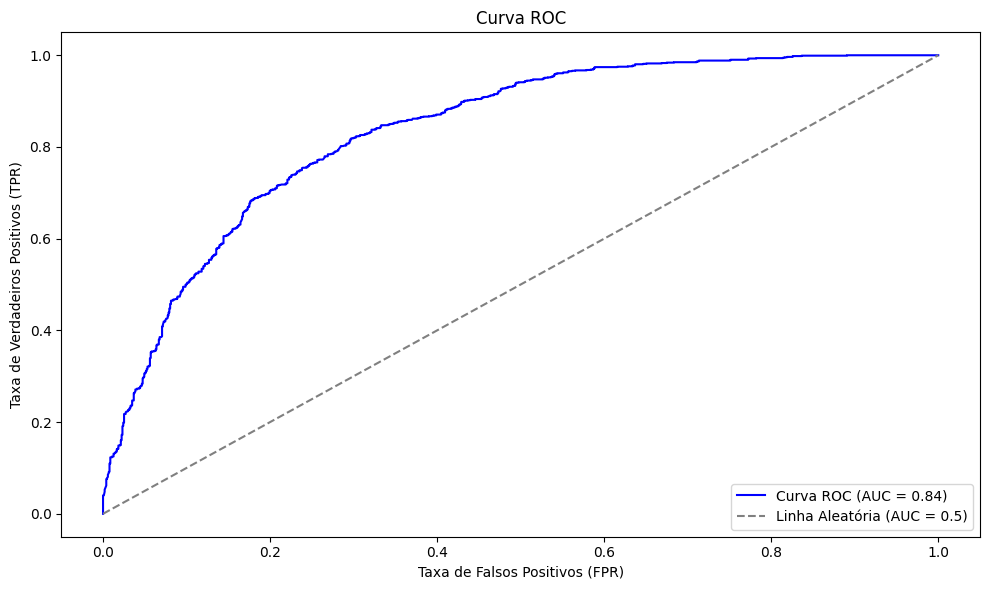

KS: 0.5217


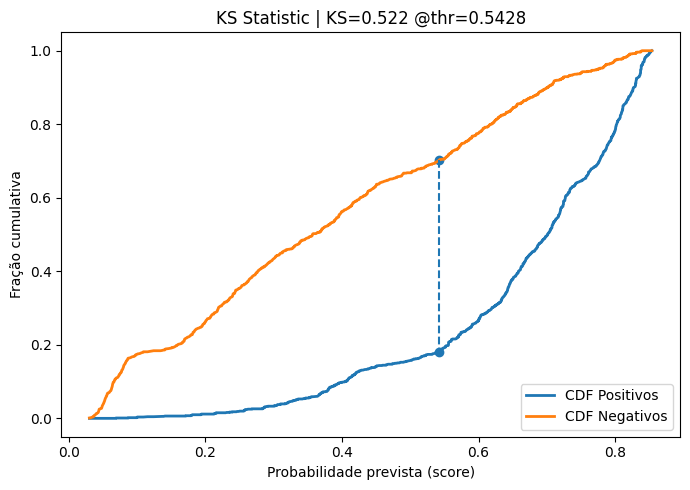

F1 Score: 0.7846

Matriz de Confusão:


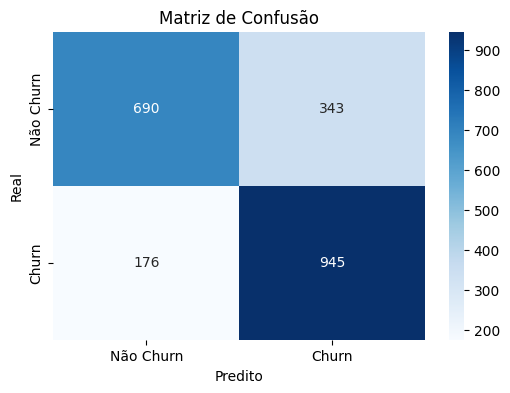

Modelo salvo em random_forest_best.pkl


In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score, StratifiedKFold
from sklearn.metrics import make_scorer
from scipy.stats import ks_2samp
import optuna
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

# Define a scorer for KS statistic (Optuna maximizes the objective function)
def ks_scorer_optuna(y_true, y_pred_prob):
    y_true = np.asarray(y_true)  # garante numpy
    y_pred_prob = np.asarray(y_pred_prob)

    if y_pred_prob.ndim == 2 and y_pred_prob.shape[1] == 2:
        y_pred_prob = y_pred_prob[:, 1]

    unique_classes, counts = np.unique(y_true, return_counts=True)
    print(f"  Fold y_true unique classes: {unique_classes}, counts: {counts}")

    if len(unique_classes) < 2:
        return -1.0

    if np.sum(y_true == unique_classes[0]) < 2 or np.sum(y_true == unique_classes[1]) < 2:
        return -1.0

    ks_statistic = ks_2samp(y_pred_prob[y_true == 0], y_pred_prob[y_true == 1]).statistic
    print(f"  Calculated KS: {ks_statistic:.4f}")
    return ks_statistic


# Objective function for Optuna - Random Forest
def objective_rf(trial):
    print(f"Starting Trial {trial.number}")

    # Hiperparâmetros sugeridos pelo Optuna
    n_estimators = trial.suggest_int('n_estimators', 50, 300)
    max_depth = trial.suggest_int('max_depth', 2, 4)
    min_samples_split = trial.suggest_int('min_samples_split', 2, 20)
    min_samples_leaf = trial.suggest_int('min_samples_leaf', 3, 15)
    criterion = trial.suggest_categorical('criterion', ['gini', 'entropy'])

    model = RandomForestClassifier(
        n_estimators=n_estimators,
        max_depth=max_depth,
        min_samples_split=min_samples_split,
        min_samples_leaf=min_samples_leaf,
        criterion=criterion,
        random_state=42,
        n_jobs=-1
    )

    skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
    ks_scores = []

    for fold, (train_idx, val_idx) in enumerate(skf.split(X_trainval_trees, y_trainval_trees), 1):
        X_tr, X_val = X_trainval_trees[train_idx], X_trainval_trees[val_idx]
        y_tr, y_val = y_trainval_trees[train_idx], y_trainval_trees[val_idx]

        model.fit(X_tr, y_tr)
        y_pred_prob = model.predict_proba(X_val)[:, 1]  # Probabilidade da classe positiva

        ks_value = ks_2samp(y_pred_prob[y_val == 0], y_pred_prob[y_val == 1]).statistic
        ks_scores.append(ks_value)

        print(f"  Fold {fold} KS: {ks_value:.4f}")

    mean_ks = np.mean(ks_scores)
    print(f"Trial {trial.number} finished with mean KS: {mean_ks:.4f}")
    return mean_ks

print("Realizando otimização de hiperparâmetros para Random Forest com Optuna...")

# Combine training and validation data for Optuna
X_trainval_trees = np.vstack((X_train_trees, X_val_trees))
y_trainval_trees = np.concatenate((y_train_trees, y_val_trees))

study_rf = optuna.create_study(direction='maximize') # We want to maximize the KS score
study_rf.optimize(objective_rf, n_trials=50) # Run 50 trials (adjust as needed)

print("Otimização de hiperparâmetros para Random Forest concluída.")
print(f"Melhores hiperparâmetros para Random Forest: {study_rf.best_params}")
print(f"Melhor KS score (CV) para Random Forest: {study_rf.best_value:.4f}")

# Train the best model on the full training+validation data
best_rf_model = RandomForestClassifier(**study_rf.best_params, random_state=42, n_jobs=-1)
best_rf_model.fit(X_trainval_trees, y_trainval_trees)

# Evaluate the best model on the test set
print("\nAvaliação do melhor modelo Random Forest no conjunto de teste:")
avaliar_modelo(best_rf_model, X_test_trees, y_test_trees)

save_model(best_rf_model, "random_forest_best.pkl")
print("Modelo salvo em random_forest_best.pkl")

[I 2025-08-11 22:36:58,044] A new study created in memory with name: no-name-bd9f2818-bcfa-4aeb-8322-d4c8038a6684


Realizando otimização de hiperparâmetros para Gradient Boosting com Optuna...
Starting Trial 0


[I 2025-08-11 22:36:59,821] Trial 0 finished with value: 0.5187786109242457 and parameters: {'n_estimators': 284, 'learning_rate': 0.0015867428191231867, 'max_depth': 3, 'min_samples_split': 10, 'min_samples_leaf': 15, 'subsample': 0.7749824679506994, 'max_features': 0.6254724361916781}. Best is trial 0 with value: 0.5187786109242457.


Trial 0 finished with KS: 0.5188
Starting Trial 1


[I 2025-08-11 22:37:02,100] Trial 1 finished with value: 0.5293114897931162 and parameters: {'n_estimators': 222, 'learning_rate': 0.001777580814066754, 'max_depth': 4, 'min_samples_split': 15, 'min_samples_leaf': 48, 'subsample': 0.6281593831207266, 'max_features': 0.6393244910510527}. Best is trial 1 with value: 0.5293114897931162.


Trial 1 finished with KS: 0.5293
Starting Trial 2


[I 2025-08-11 22:37:03,192] Trial 2 finished with value: 0.5342476163500125 and parameters: {'n_estimators': 217, 'learning_rate': 0.012001855031981415, 'max_depth': 3, 'min_samples_split': 9, 'min_samples_leaf': 23, 'subsample': 0.5183389017354758, 'max_features': 0.6515815373811111}. Best is trial 2 with value: 0.5342476163500125.


Trial 2 finished with KS: 0.5342
Starting Trial 3


[I 2025-08-11 22:37:04,051] Trial 3 finished with value: 0.48426544892758416 and parameters: {'n_estimators': 196, 'learning_rate': 0.0012742770227552468, 'max_depth': 2, 'min_samples_split': 7, 'min_samples_leaf': 42, 'subsample': 0.5391920274529453, 'max_features': 0.775457595691148}. Best is trial 2 with value: 0.5342476163500125.


Trial 3 finished with KS: 0.4843
Starting Trial 4


[I 2025-08-11 22:37:05,163] Trial 4 finished with value: 0.5241672445342934 and parameters: {'n_estimators': 185, 'learning_rate': 0.004872519010405529, 'max_depth': 3, 'min_samples_split': 18, 'min_samples_leaf': 32, 'subsample': 0.8606787356407986, 'max_features': 0.5581650395252186}. Best is trial 2 with value: 0.5342476163500125.


Trial 4 finished with KS: 0.5242
Starting Trial 5


[I 2025-08-11 22:37:05,920] Trial 5 finished with value: 0.5529610282618289 and parameters: {'n_estimators': 69, 'learning_rate': 0.08986178146761838, 'max_depth': 4, 'min_samples_split': 7, 'min_samples_leaf': 16, 'subsample': 0.6819484240521712, 'max_features': 0.9690279377211369}. Best is trial 5 with value: 0.5529610282618289.


Trial 5 finished with KS: 0.5530
Starting Trial 6


[I 2025-08-11 22:37:07,782] Trial 6 finished with value: 0.5271871246199243 and parameters: {'n_estimators': 181, 'learning_rate': 0.0074384198853318885, 'max_depth': 3, 'min_samples_split': 7, 'min_samples_leaf': 48, 'subsample': 0.7264155730913137, 'max_features': 0.8504557336930085}. Best is trial 5 with value: 0.5529610282618289.


Trial 6 finished with KS: 0.5272
Starting Trial 7


[I 2025-08-11 22:37:09,575] Trial 7 finished with value: 0.5321362046229986 and parameters: {'n_estimators': 207, 'learning_rate': 0.010591153186243816, 'max_depth': 3, 'min_samples_split': 2, 'min_samples_leaf': 22, 'subsample': 0.7769883884108999, 'max_features': 0.9265874888219073}. Best is trial 5 with value: 0.5529610282618289.


Trial 7 finished with KS: 0.5321
Starting Trial 8


[I 2025-08-11 22:37:10,463] Trial 8 finished with value: 0.550188990779737 and parameters: {'n_estimators': 136, 'learning_rate': 0.03577763328608341, 'max_depth': 3, 'min_samples_split': 13, 'min_samples_leaf': 40, 'subsample': 0.5139416590001116, 'max_features': 0.9971511038270794}. Best is trial 5 with value: 0.5529610282618289.


Trial 8 finished with KS: 0.5502
Starting Trial 9


[I 2025-08-11 22:37:11,744] Trial 9 finished with value: 0.48523350313862 and parameters: {'n_estimators': 275, 'learning_rate': 0.0014672568778398949, 'max_depth': 2, 'min_samples_split': 4, 'min_samples_leaf': 44, 'subsample': 0.5584420244524467, 'max_features': 0.8197087151830584}. Best is trial 5 with value: 0.5529610282618289.


Trial 9 finished with KS: 0.4852
Starting Trial 10


[I 2025-08-11 22:37:12,266] Trial 10 finished with value: 0.5619973523156012 and parameters: {'n_estimators': 50, 'learning_rate': 0.1285381531919918, 'max_depth': 4, 'min_samples_split': 20, 'min_samples_leaf': 10, 'subsample': 0.6575080942987052, 'max_features': 0.9205191431806685}. Best is trial 10 with value: 0.5619973523156012.


Trial 10 finished with KS: 0.5620
Starting Trial 11


[I 2025-08-11 22:37:12,796] Trial 11 finished with value: 0.5552408347891568 and parameters: {'n_estimators': 50, 'learning_rate': 0.16674374178121965, 'max_depth': 4, 'min_samples_split': 17, 'min_samples_leaf': 10, 'subsample': 0.6457100784433227, 'max_features': 0.9869627291154228}. Best is trial 10 with value: 0.5619973523156012.


Trial 11 finished with KS: 0.5552
Starting Trial 12


[I 2025-08-11 22:37:13,506] Trial 12 finished with value: 0.5668376233707803 and parameters: {'n_estimators': 75, 'learning_rate': 0.16874153561036542, 'max_depth': 4, 'min_samples_split': 20, 'min_samples_leaf': 10, 'subsample': 0.6425442046410506, 'max_features': 0.894888872233238}. Best is trial 12 with value: 0.5668376233707803.


Trial 12 finished with KS: 0.5668
Starting Trial 13


[I 2025-08-11 22:37:14,437] Trial 13 finished with value: 0.554689017981974 and parameters: {'n_estimators': 102, 'learning_rate': 0.050047158930932936, 'max_depth': 4, 'min_samples_split': 20, 'min_samples_leaf': 10, 'subsample': 0.6075176137882764, 'max_features': 0.8858349165556016}. Best is trial 12 with value: 0.5668376233707803.


Trial 13 finished with KS: 0.5547
Starting Trial 14


[I 2025-08-11 22:37:15,253] Trial 14 finished with value: 0.5627011562246058 and parameters: {'n_estimators': 108, 'learning_rate': 0.16889349627723396, 'max_depth': 4, 'min_samples_split': 20, 'min_samples_leaf': 26, 'subsample': 0.7095477143903929, 'max_features': 0.7334302646236616}. Best is trial 12 with value: 0.5668376233707803.


Trial 14 finished with KS: 0.5627
Starting Trial 15


[I 2025-08-11 22:37:16,306] Trial 15 finished with value: 0.5542891882766131 and parameters: {'n_estimators': 122, 'learning_rate': 0.029859914627292598, 'max_depth': 4, 'min_samples_split': 14, 'min_samples_leaf': 35, 'subsample': 0.7325591922517088, 'max_features': 0.7164104519015295}. Best is trial 12 with value: 0.5668376233707803.


Trial 15 finished with KS: 0.5543
Starting Trial 16


[I 2025-08-11 22:37:17,012] Trial 16 finished with value: 0.5566087187055535 and parameters: {'n_estimators': 93, 'learning_rate': 0.07066717557877396, 'max_depth': 4, 'min_samples_split': 17, 'min_samples_leaf': 24, 'subsample': 0.5857318295034012, 'max_features': 0.7118343513574694}. Best is trial 12 with value: 0.5668376233707803.


Trial 16 finished with KS: 0.5566
Starting Trial 17


[I 2025-08-11 22:37:18,621] Trial 17 finished with value: 0.575014702161412 and parameters: {'n_estimators': 144, 'learning_rate': 0.18043611196032366, 'max_depth': 4, 'min_samples_split': 12, 'min_samples_leaf': 27, 'subsample': 0.8919787882568216, 'max_features': 0.7818201007947161}. Best is trial 17 with value: 0.575014702161412.


Trial 17 finished with KS: 0.5750
Starting Trial 18


[I 2025-08-11 22:37:19,904] Trial 18 finished with value: 0.5117509345911417 and parameters: {'n_estimators': 150, 'learning_rate': 0.02217160741387858, 'max_depth': 2, 'min_samples_split': 12, 'min_samples_leaf': 18, 'subsample': 0.8952697289027826, 'max_features': 0.8011483625204991}. Best is trial 17 with value: 0.575014702161412.


Trial 18 finished with KS: 0.5118
Starting Trial 19


[I 2025-08-11 22:37:21,605] Trial 19 finished with value: 0.5711856634711954 and parameters: {'n_estimators': 153, 'learning_rate': 0.08285591702679153, 'max_depth': 4, 'min_samples_split': 15, 'min_samples_leaf': 29, 'subsample': 0.8171731664043529, 'max_features': 0.8532219260725147}. Best is trial 17 with value: 0.575014702161412.


Trial 19 finished with KS: 0.5712
Otimização de hiperparâmetros para Gradient Boosting concluída.
Melhores hiperparâmetros para Gradient Boosting: {'n_estimators': 144, 'learning_rate': 0.18043611196032366, 'max_depth': 4, 'min_samples_split': 12, 'min_samples_leaf': 27, 'subsample': 0.8919787882568216, 'max_features': 0.7818201007947161}
Melhor KS score (CV) para Gradient Boosting: 0.5750

Avaliação do melhor modelo Gradient Boosting no conjunto de teste:
📊 Classification Report:
              precision    recall  f1-score   support

   Não Churn       0.82      0.72      0.77      1033
       Churn       0.77      0.85      0.81      1121

    accuracy                           0.79      2154
   macro avg       0.79      0.79      0.79      2154
weighted avg       0.79      0.79      0.79      2154

MSE: 0.2117
MAE: 0.2117
ROC AUC: 0.8727


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2732: UserWarning: X has feature names, but GradientBoostingClassifier was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2732: UserWarning: X has feature names, but GradientBoostingClassifier was fitted without feature names
  warnings.warn(


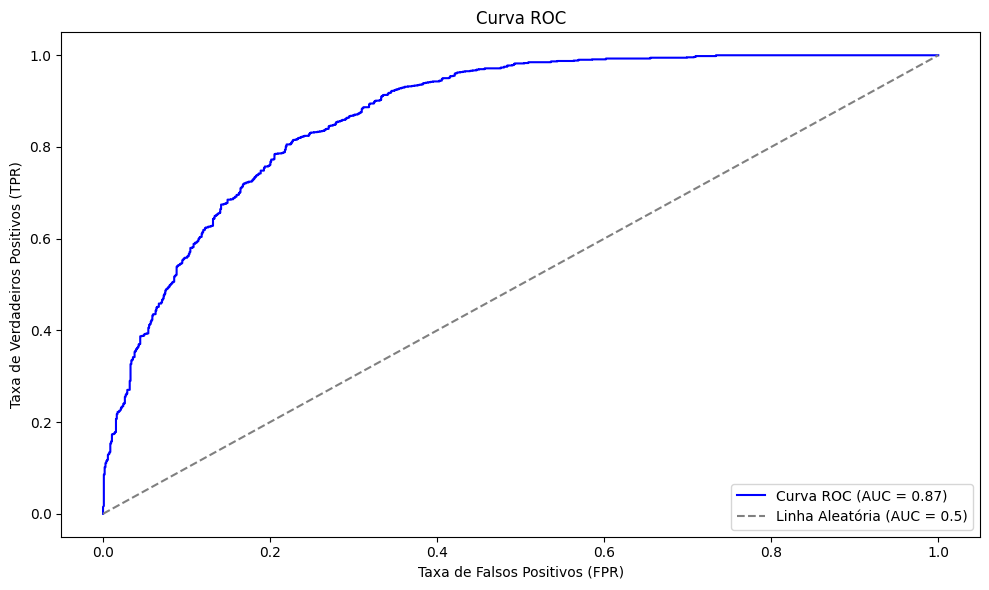

KS: 0.5879


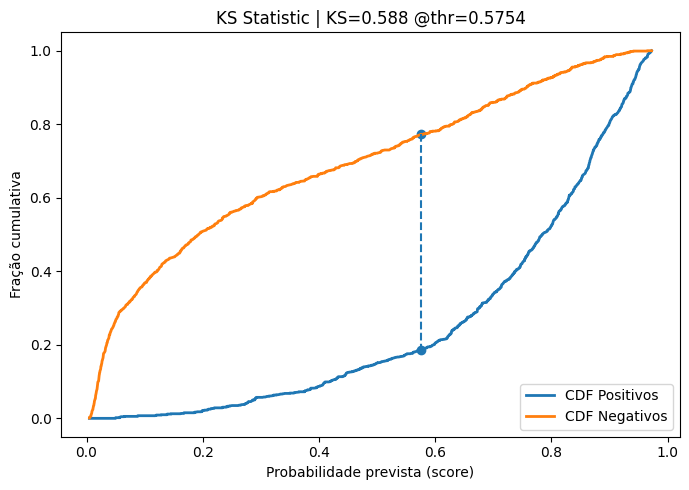

F1 Score: 0.8069

Matriz de Confusão:


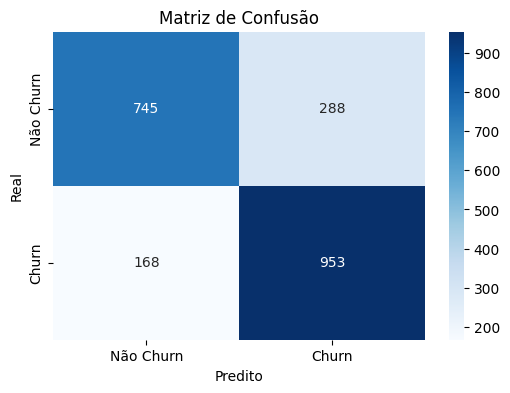


Matriz de Confusão (Teste):


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2732: UserWarning: X has feature names, but GradientBoostingClassifier was fitted without feature names
  warnings.warn(


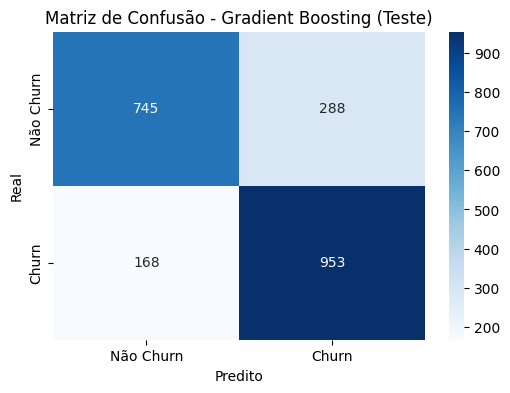

Modelo salvo em gradient_boosting_best_without_kfold.pkl


In [ ]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import StratifiedKFold
from scipy.stats import ks_2samp
import optuna
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

# Objective function for Optuna - Gradient Boosting (KS calculado manualmente)
def objective_gb(trial):
    print(f"Starting Trial {trial.number}")

    # Hiperparâmetros sugeridos pelo Optuna
    n_estimators = trial.suggest_int('n_estimators', 50, 300)
    learning_rate = trial.suggest_float('learning_rate', 0.001, 0.2, log=True)
    max_depth = trial.suggest_int('max_depth', 2, 4)
    min_samples_split = trial.suggest_int('min_samples_split', 2, 20)
    min_samples_leaf = trial.suggest_int('min_samples_leaf', 10, 50)
    subsample = trial.suggest_float('subsample', 0.5, 0.9)
    max_features = trial.suggest_float('max_features', 0.5, 1.0)

    model = GradientBoostingClassifier(
        n_estimators=n_estimators,
        learning_rate=learning_rate,
        n_iter_no_change=20,
        max_depth=max_depth,
        min_samples_split=min_samples_split,
        min_samples_leaf=min_samples_leaf,
        subsample=subsample,
        max_features=max_features,
        random_state=42
    )

    model.fit(X_train_trees, y_train_trees)
    y_pred_prob = model.predict_proba(X_val_trees)[:, 1]  # prob da classe positiva

    # KS calculation
    ks_value = ks_2samp(y_pred_prob[y_val_trees == 0], y_pred_prob[y_val_trees == 1]).statistic
    print(f"Trial {trial.number} finished with KS: {ks_value:.4f}")
    return ks_value

print("Realizando otimização de hiperparâmetros para Gradient Boosting com Optuna...")

# Combine training and validation data for Optuna
X_trainval_trees = np.vstack((X_train_trees, X_val_trees))
y_trainval_trees = np.concatenate((y_train_trees, y_val_trees))

study_gb = optuna.create_study(direction='maximize')  # Maximize KS score
study_gb.optimize(objective_gb, n_trials=20)  # Run 50 trials (adjust as needed)

print("Otimização de hiperparâmetros para Gradient Boosting concluída.")
print(f"Melhores hiperparâmetros para Gradient Boosting: {study_gb.best_params}")
print(f"Melhor KS score (CV) para Gradient Boosting: {study_gb.best_value:.4f}")

# Treinar o melhor modelo no conjunto de treino+validação
best_gb_model = GradientBoostingClassifier(**study_gb.best_params, random_state=42)
best_gb_model.fit(X_trainval_trees, y_trainval_trees)

# Avaliar no conjunto de teste
print("\nAvaliação do melhor modelo Gradient Boosting no conjunto de teste:")
avaliar_modelo(best_gb_model, X_test_trees, y_test_trees)

# Matriz de confusão
print("\nMatriz de Confusão (Teste):")
cm_gb_test = confusion_matrix(y_test_trees, best_gb_model.predict(X_test_trees))
plt.figure(figsize=(6, 4))
sns.heatmap(cm_gb_test, annot=True, fmt='d', cmap='Blues',
            xticklabels=['Não Churn', 'Churn'], yticklabels=['Não Churn', 'Churn'])
plt.xlabel('Predito')
plt.ylabel('Real')
plt.title('Matriz de Confusão - Gradient Boosting (Teste)')
plt.show()

save_model(best_gb_model, "gradient_boosting_best_without_kfold.pkl")
print("Modelo salvo em gradient_boosting_best_without_kfold.pkl")


[I 2025-08-11 22:37:38,110] A new study created in memory with name: no-name-b05b9f2e-29a1-4ac4-9e44-7b64c93c3e1a


Realizando otimização de hiperparâmetros para Gradient Boosting com Optuna...
Starting Trial 0
  Fold 1 KS: 0.5476
  Fold 2 KS: 0.5219
  Fold 3 KS: 0.5404
  Fold 4 KS: 0.4986


[I 2025-08-11 22:37:44,667] Trial 0 finished with value: 0.5270561931357312 and parameters: {'n_estimators': 138, 'learning_rate': 0.002549462086251167, 'max_depth': 3, 'min_samples_split': 13, 'min_samples_leaf': 27, 'subsample': 0.8779989947367759, 'max_features': 0.8304065030154338}. Best is trial 0 with value: 0.5270561931357312.


  Fold 5 KS: 0.5266
Trial 0 finished with mean KS: 0.5271
Starting Trial 1
  Fold 1 KS: 0.5368
  Fold 2 KS: 0.5321
  Fold 3 KS: 0.5206
  Fold 4 KS: 0.4917


[I 2025-08-11 22:37:48,044] Trial 1 finished with value: 0.5188993189001396 and parameters: {'n_estimators': 152, 'learning_rate': 0.002758003697589697, 'max_depth': 2, 'min_samples_split': 15, 'min_samples_leaf': 46, 'subsample': 0.8602996326969763, 'max_features': 0.5135838706391964}. Best is trial 0 with value: 0.5270561931357312.


  Fold 5 KS: 0.5133
Trial 1 finished with mean KS: 0.5189
Starting Trial 2
  Fold 1 KS: 0.5957
  Fold 2 KS: 0.5888
  Fold 3 KS: 0.5755
  Fold 4 KS: 0.5462


[I 2025-08-11 22:37:52,230] Trial 2 finished with value: 0.575853051542252 and parameters: {'n_estimators': 115, 'learning_rate': 0.15543880157115741, 'max_depth': 4, 'min_samples_split': 9, 'min_samples_leaf': 39, 'subsample': 0.6180604490669823, 'max_features': 0.8684413421782684}. Best is trial 2 with value: 0.575853051542252.


  Fold 5 KS: 0.5731
Trial 2 finished with mean KS: 0.5759
Starting Trial 3
  Fold 1 KS: 0.5689
  Fold 2 KS: 0.5737
  Fold 3 KS: 0.5713
  Fold 4 KS: 0.5150


[I 2025-08-11 22:37:56,558] Trial 3 finished with value: 0.5568381353831047 and parameters: {'n_estimators': 143, 'learning_rate': 0.13008490931161854, 'max_depth': 2, 'min_samples_split': 20, 'min_samples_leaf': 33, 'subsample': 0.8161913013263329, 'max_features': 0.7957614822939658}. Best is trial 2 with value: 0.575853051542252.


  Fold 5 KS: 0.5553
Trial 3 finished with mean KS: 0.5568
Starting Trial 4
  Fold 1 KS: 0.5864
  Fold 2 KS: 0.5803
  Fold 3 KS: 0.5809
  Fold 4 KS: 0.5378


[I 2025-08-11 22:38:01,684] Trial 4 finished with value: 0.5715321208561736 and parameters: {'n_estimators': 139, 'learning_rate': 0.10055205556762194, 'max_depth': 3, 'min_samples_split': 6, 'min_samples_leaf': 11, 'subsample': 0.7994418069248515, 'max_features': 0.781562874719986}. Best is trial 2 with value: 0.575853051542252.


  Fold 5 KS: 0.5722
Trial 4 finished with mean KS: 0.5715
Starting Trial 5
  Fold 1 KS: 0.5604
  Fold 2 KS: 0.5545
  Fold 3 KS: 0.5527
  Fold 4 KS: 0.5196


[I 2025-08-11 22:38:19,820] Trial 5 finished with value: 0.5465668775572221 and parameters: {'n_estimators': 298, 'learning_rate': 0.002814671262893595, 'max_depth': 4, 'min_samples_split': 14, 'min_samples_leaf': 36, 'subsample': 0.8693729532354006, 'max_features': 0.887359502280987}. Best is trial 2 with value: 0.575853051542252.


  Fold 5 KS: 0.5456
Trial 5 finished with mean KS: 0.5466
Starting Trial 6
  Fold 1 KS: 0.5448
  Fold 2 KS: 0.5433
  Fold 3 KS: 0.5371
  Fold 4 KS: 0.5061


[I 2025-08-11 22:38:25,752] Trial 6 finished with value: 0.5304075222859781 and parameters: {'n_estimators': 300, 'learning_rate': 0.005344680415552011, 'max_depth': 2, 'min_samples_split': 11, 'min_samples_leaf': 10, 'subsample': 0.5262787651603696, 'max_features': 0.5395369245384989}. Best is trial 2 with value: 0.575853051542252.


  Fold 5 KS: 0.5207
Trial 6 finished with mean KS: 0.5304
Starting Trial 7
  Fold 1 KS: 0.5614
  Fold 2 KS: 0.5545
  Fold 3 KS: 0.5493
  Fold 4 KS: 0.5129


[I 2025-08-11 22:38:30,683] Trial 7 finished with value: 0.5425762185703625 and parameters: {'n_estimators': 209, 'learning_rate': 0.022272443560407848, 'max_depth': 2, 'min_samples_split': 10, 'min_samples_leaf': 21, 'subsample': 0.7457230512880413, 'max_features': 0.631434428250032}. Best is trial 2 with value: 0.575853051542252.


  Fold 5 KS: 0.5348
Trial 7 finished with mean KS: 0.5426
Starting Trial 8
  Fold 1 KS: 0.5688
  Fold 2 KS: 0.5642
  Fold 3 KS: 0.5696
  Fold 4 KS: 0.5133


[I 2025-08-11 22:38:33,702] Trial 8 finished with value: 0.5535233681547524 and parameters: {'n_estimators': 85, 'learning_rate': 0.132827929778966, 'max_depth': 2, 'min_samples_split': 17, 'min_samples_leaf': 35, 'subsample': 0.6770206894874253, 'max_features': 0.8342139688531359}. Best is trial 2 with value: 0.575853051542252.


  Fold 5 KS: 0.5517
Trial 8 finished with mean KS: 0.5535
Starting Trial 9
  Fold 1 KS: 0.5408
  Fold 2 KS: 0.5372
  Fold 3 KS: 0.5182
  Fold 4 KS: 0.4980


[I 2025-08-11 22:38:39,158] Trial 9 finished with value: 0.5228832000800495 and parameters: {'n_estimators': 219, 'learning_rate': 0.0037215047598142337, 'max_depth': 2, 'min_samples_split': 18, 'min_samples_leaf': 50, 'subsample': 0.5432284561419863, 'max_features': 0.9323911468786423}. Best is trial 2 with value: 0.575853051542252.


  Fold 5 KS: 0.5202
Trial 9 finished with mean KS: 0.5229
Starting Trial 10
  Fold 1 KS: 0.5595
  Fold 2 KS: 0.5545
  Fold 3 KS: 0.5585
  Fold 4 KS: 0.5126


[I 2025-08-11 22:38:41,668] Trial 10 finished with value: 0.5466332187845483 and parameters: {'n_estimators': 51, 'learning_rate': 0.028657141622985632, 'max_depth': 4, 'min_samples_split': 2, 'min_samples_leaf': 42, 'subsample': 0.6286279468369099, 'max_features': 0.9906614275808427}. Best is trial 2 with value: 0.575853051542252.


  Fold 5 KS: 0.5480
Trial 10 finished with mean KS: 0.5466
Starting Trial 11
  Fold 1 KS: 0.5631
  Fold 2 KS: 0.5819
  Fold 3 KS: 0.5672
  Fold 4 KS: 0.5211


[I 2025-08-11 22:38:45,865] Trial 11 finished with value: 0.5584573939834874 and parameters: {'n_estimators': 104, 'learning_rate': 0.06371015943054638, 'max_depth': 3, 'min_samples_split': 6, 'min_samples_leaf': 20, 'subsample': 0.7581015860822099, 'max_features': 0.6671639269500181}. Best is trial 2 with value: 0.575853051542252.


  Fold 5 KS: 0.5590
Trial 11 finished with mean KS: 0.5585
Starting Trial 12
  Fold 1 KS: 0.6063
  Fold 2 KS: 0.6254
  Fold 3 KS: 0.6260
  Fold 4 KS: 0.5963


[I 2025-08-11 22:38:52,430] Trial 12 finished with value: 0.6043311364738002 and parameters: {'n_estimators': 193, 'learning_rate': 0.19384328837692924, 'max_depth': 4, 'min_samples_split': 7, 'min_samples_leaf': 14, 'subsample': 0.6442872309498736, 'max_features': 0.7254870985076752}. Best is trial 12 with value: 0.6043311364738002.


  Fold 5 KS: 0.5676
Trial 12 finished with mean KS: 0.6043
Starting Trial 13
  Fold 1 KS: 0.5677
  Fold 2 KS: 0.5956
  Fold 3 KS: 0.5942
  Fold 4 KS: 0.5561


[I 2025-08-11 22:38:56,388] Trial 13 finished with value: 0.5772351452147543 and parameters: {'n_estimators': 206, 'learning_rate': 0.19815435037644175, 'max_depth': 4, 'min_samples_split': 8, 'min_samples_leaf': 26, 'subsample': 0.6079257190403581, 'max_features': 0.7044126294501125}. Best is trial 12 with value: 0.6043311364738002.


  Fold 5 KS: 0.5726
Trial 13 finished with mean KS: 0.5772
Starting Trial 14
  Fold 1 KS: 0.5947
  Fold 2 KS: 0.5946
  Fold 3 KS: 0.5996
  Fold 4 KS: 0.5406


[I 2025-08-11 22:39:04,090] Trial 14 finished with value: 0.5810856766200091 and parameters: {'n_estimators': 205, 'learning_rate': 0.05418662147510385, 'max_depth': 4, 'min_samples_split': 6, 'min_samples_leaf': 18, 'subsample': 0.6001070072267147, 'max_features': 0.6965428920744592}. Best is trial 12 with value: 0.6043311364738002.


  Fold 5 KS: 0.5761
Trial 14 finished with mean KS: 0.5811
Starting Trial 15
  Fold 1 KS: 0.6022
  Fold 2 KS: 0.6037
  Fold 3 KS: 0.5797
  Fold 4 KS: 0.5524


[I 2025-08-11 22:39:12,838] Trial 15 finished with value: 0.5852774159570726 and parameters: {'n_estimators': 253, 'learning_rate': 0.04854058657815832, 'max_depth': 4, 'min_samples_split': 3, 'min_samples_leaf': 16, 'subsample': 0.6791261912886247, 'max_features': 0.6033110623586864}. Best is trial 12 with value: 0.6043311364738002.


  Fold 5 KS: 0.5883
Trial 15 finished with mean KS: 0.5853
Starting Trial 16
  Fold 1 KS: 0.5717
  Fold 2 KS: 0.5873
  Fold 3 KS: 0.5775
  Fold 4 KS: 0.5298


[I 2025-08-11 22:39:22,308] Trial 16 finished with value: 0.5658457356108568 and parameters: {'n_estimators': 244, 'learning_rate': 0.015142945485343466, 'max_depth': 4, 'min_samples_split': 2, 'min_samples_leaf': 16, 'subsample': 0.6944927327547129, 'max_features': 0.600460369749457}. Best is trial 12 with value: 0.6043311364738002.


  Fold 5 KS: 0.5629
Trial 16 finished with mean KS: 0.5658
Starting Trial 17
  Fold 1 KS: 0.5671
  Fold 2 KS: 0.5802
  Fold 3 KS: 0.5894
  Fold 4 KS: 0.5341


[I 2025-08-11 22:39:29,221] Trial 17 finished with value: 0.5670660498730081 and parameters: {'n_estimators': 256, 'learning_rate': 0.04659604189276029, 'max_depth': 3, 'min_samples_split': 4, 'min_samples_leaf': 14, 'subsample': 0.7255262583593477, 'max_features': 0.6057363028290677}. Best is trial 12 with value: 0.6043311364738002.


  Fold 5 KS: 0.5646
Trial 17 finished with mean KS: 0.5671
Starting Trial 18
  Fold 1 KS: 0.5576
  Fold 2 KS: 0.5545
  Fold 3 KS: 0.5538
  Fold 4 KS: 0.5206


[I 2025-08-11 22:39:37,081] Trial 18 finished with value: 0.5468271726380716 and parameters: {'n_estimators': 178, 'learning_rate': 0.001195825938095057, 'max_depth': 4, 'min_samples_split': 4, 'min_samples_leaf': 24, 'subsample': 0.6667276956712825, 'max_features': 0.7146737645234982}. Best is trial 12 with value: 0.6043311364738002.


  Fold 5 KS: 0.5477
Trial 18 finished with mean KS: 0.5468
Starting Trial 19
  Fold 1 KS: 0.5596
  Fold 2 KS: 0.5617
  Fold 3 KS: 0.5537
  Fold 4 KS: 0.5100


[I 2025-08-11 22:39:44,140] Trial 19 finished with value: 0.5456576546543114 and parameters: {'n_estimators': 271, 'learning_rate': 0.008589197358390937, 'max_depth': 3, 'min_samples_split': 4, 'min_samples_leaf': 30, 'subsample': 0.574389112654057, 'max_features': 0.5668221099272022}. Best is trial 12 with value: 0.6043311364738002.


  Fold 5 KS: 0.5433
Trial 19 finished with mean KS: 0.5457
Otimização de hiperparâmetros para Gradient Boosting concluída.
Melhores hiperparâmetros para Gradient Boosting: {'n_estimators': 193, 'learning_rate': 0.19384328837692924, 'max_depth': 4, 'min_samples_split': 7, 'min_samples_leaf': 14, 'subsample': 0.6442872309498736, 'max_features': 0.7254870985076752}
Melhor KS score (CV) para Gradient Boosting: 0.6043

Avaliação do melhor modelo Gradient Boosting no conjunto de teste:
📊 Classification Report:
              precision    recall  f1-score   support

   Não Churn       0.82      0.73      0.78      1033
       Churn       0.78      0.85      0.81      1121

    accuracy                           0.80      2154
   macro avg       0.80      0.79      0.79      2154
weighted avg       0.80      0.80      0.80      2154

MSE: 0.2038
MAE: 0.2038
ROC AUC: 0.8753


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2732: UserWarning: X has feature names, but GradientBoostingClassifier was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2732: UserWarning: X has feature names, but GradientBoostingClassifier was fitted without feature names
  warnings.warn(


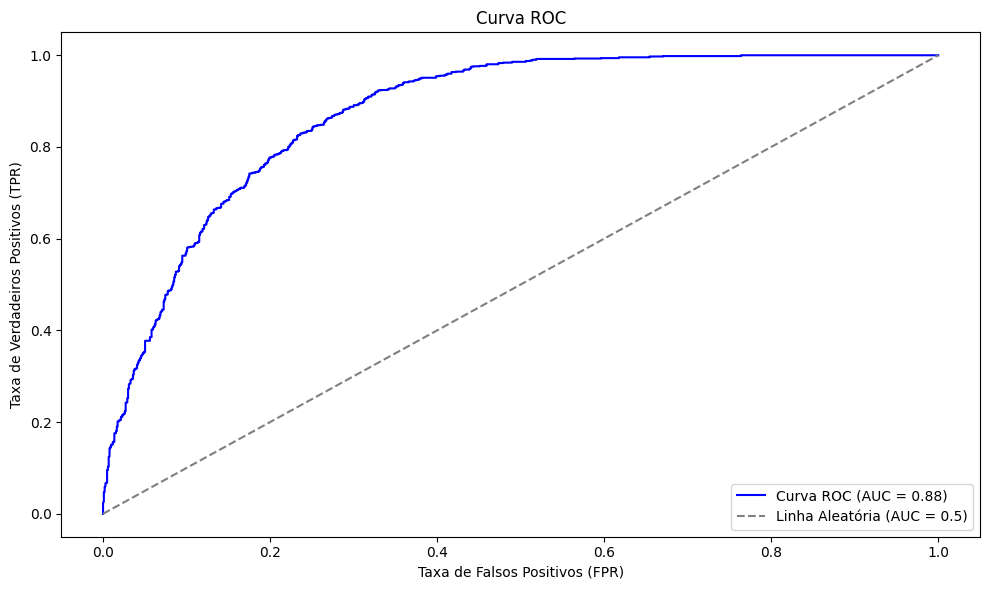

KS: 0.5941


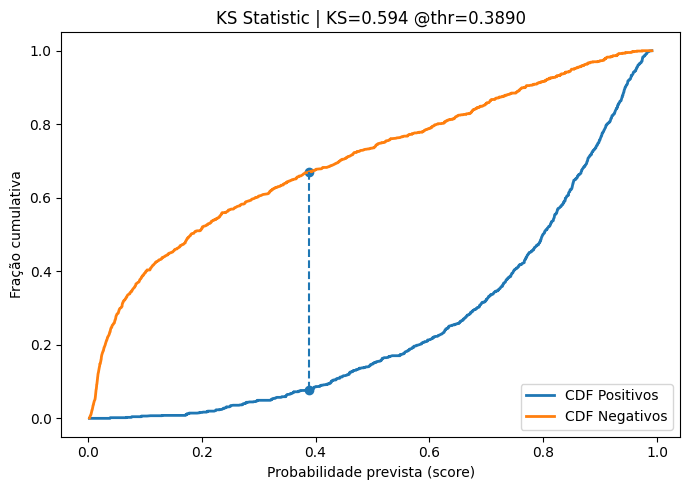

F1 Score: 0.8133

Matriz de Confusão:


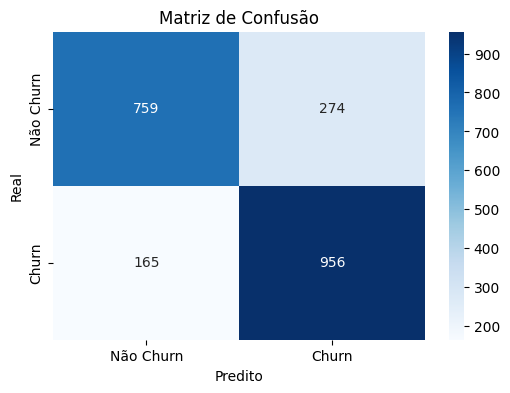

Modelo salvo em gradient_boosting_best.pkl


In [ ]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import StratifiedKFold
from scipy.stats import ks_2samp
import optuna
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix
import joblib

# Objective function for Optuna - Gradient Boosting (KS calculado manualmente)
def objective_gb(trial):
    print(f"Starting Trial {trial.number}")

    # Hiperparâmetros sugeridos pelo Optuna
    n_estimators = trial.suggest_int('n_estimators', 50, 300)
    learning_rate = trial.suggest_float('learning_rate', 0.001, 0.2, log=True)
    max_depth = trial.suggest_int('max_depth', 2, 4)
    min_samples_split = trial.suggest_int('min_samples_split', 2, 20)
    min_samples_leaf = trial.suggest_int('min_samples_leaf', 10, 50)
    subsample = trial.suggest_float('subsample', 0.5, 0.9)
    max_features = trial.suggest_float('max_features', 0.5, 1.0)

    model = GradientBoostingClassifier(
        n_estimators=n_estimators,
        learning_rate=learning_rate,
        n_iter_no_change=20,
        max_depth=max_depth,
        min_samples_split=min_samples_split,
        min_samples_leaf=min_samples_leaf,
        subsample=subsample,
        max_features=max_features,
        random_state=42
    )

    skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
    ks_scores = []

    for fold, (train_idx, val_idx) in enumerate(skf.split(X_trainval_trees, y_trainval_trees), 1):
        X_tr, X_val = X_trainval_trees[train_idx], X_trainval_trees[val_idx]
        y_tr, y_val = y_trainval_trees[train_idx], y_trainval_trees[val_idx]

        model.fit(X_tr, y_tr,)
        y_pred_prob = model.predict_proba(X_val)[:, 1]  # Probabilidade da classe positiva

        ks_value = ks_2samp(y_pred_prob[y_val == 0], y_pred_prob[y_val == 1]).statistic
        ks_scores.append(ks_value)

        print(f"  Fold {fold} KS: {ks_value:.4f}")

    mean_ks = np.mean(ks_scores)
    print(f"Trial {trial.number} finished with mean KS: {mean_ks:.4f}")
    return mean_ks

print("Realizando otimização de hiperparâmetros para Gradient Boosting com Optuna...")

# Combine training and validation data for Optuna
X_trainval_trees = np.vstack((X_train_trees, X_val_trees))
y_trainval_trees = np.concatenate((y_train_trees, y_val_trees))

study_gb = optuna.create_study(direction='maximize')  # Maximize KS score
study_gb.optimize(objective_gb, n_trials=20)  # Run 50 trials (adjust as needed)

print("Otimização de hiperparâmetros para Gradient Boosting concluída.")
print(f"Melhores hiperparâmetros para Gradient Boosting: {study_gb.best_params}")
print(f"Melhor KS score (CV) para Gradient Boosting: {study_gb.best_value:.4f}")

# Treinar o melhor modelo no conjunto de treino+validação
best_gb_model = GradientBoostingClassifier(**study_gb.best_params, random_state=42)
best_gb_model.fit(X_trainval_trees, y_trainval_trees)

# Avaliar no conjunto de teste
print("\nAvaliação do melhor modelo Gradient Boosting no conjunto de teste:")
avaliar_modelo(best_gb_model, X_test_trees, y_test_trees)

save_model(best_gb_model, "gradient_boosting_best.pkl")
print("Modelo salvo em gradient_boosting_best.pkl")


[I 2025-08-11 22:48:03,152] A new study created in memory with name: no-name-78539adc-1211-4e34-844b-8cdf2049e481


Realizando otimização de hiperparâmetros para XGBoost com Optuna...
Starting Trial 0


[I 2025-08-11 22:48:03,631] Trial 0 finished with value: 0.5522606786051384 and parameters: {'n_estimators': 151, 'max_depth': 6, 'learning_rate': 0.014714277725412393, 'subsample': 0.8492673604664631, 'colsample_bytree': 0.5018644133036636, 'min_child_weight': 3, 'gamma': 3.786376463112388}. Best is trial 0 with value: 0.5522606786051384.
[I 2025-08-11 22:48:03,817] Trial 1 finished with value: 0.5481008952558435 and parameters: {'n_estimators': 287, 'max_depth': 3, 'learning_rate': 0.17834014926010616, 'subsample': 0.8537034911410943, 'colsample_bytree': 0.6283696295693787, 'min_child_weight': 6, 'gamma': 2.170038502920881}. Best is trial 0 with value: 0.5522606786051384.


Trial 0 finished with KS: 0.5523
Starting Trial 1
Trial 1 finished with KS: 0.5481
Starting Trial 2


[I 2025-08-11 22:48:03,945] Trial 2 finished with value: 0.5548410050837959 and parameters: {'n_estimators': 90, 'max_depth': 5, 'learning_rate': 0.01046675486308848, 'subsample': 0.5793248320784826, 'colsample_bytree': 0.9412857019091481, 'min_child_weight': 8, 'gamma': 1.968810793345794}. Best is trial 2 with value: 0.5548410050837959.
[I 2025-08-11 22:48:04,130] Trial 3 finished with value: 0.5458608126301282 and parameters: {'n_estimators': 204, 'max_depth': 3, 'learning_rate': 0.02401770515958988, 'subsample': 0.8612542267117407, 'colsample_bytree': 0.5588659540608001, 'min_child_weight': 4, 'gamma': 0.6920280388511779}. Best is trial 2 with value: 0.5548410050837959.


Trial 2 finished with KS: 0.5548
Starting Trial 3
Trial 3 finished with KS: 0.5459
Starting Trial 4


[I 2025-08-11 22:48:04,280] Trial 4 finished with value: 0.5637616116850447 and parameters: {'n_estimators': 97, 'max_depth': 6, 'learning_rate': 0.01361321456343557, 'subsample': 0.7232395620143659, 'colsample_bytree': 0.7102131213246783, 'min_child_weight': 4, 'gamma': 2.8467669063169754}. Best is trial 4 with value: 0.5637616116850447.


Trial 4 finished with KS: 0.5638
Starting Trial 5


[I 2025-08-11 22:48:04,491] Trial 5 finished with value: 0.5621096155158105 and parameters: {'n_estimators': 271, 'max_depth': 4, 'learning_rate': 0.04705636596045997, 'subsample': 0.8606404880802072, 'colsample_bytree': 0.6176403470010822, 'min_child_weight': 6, 'gamma': 1.1342393160586255}. Best is trial 4 with value: 0.5637616116850447.
[I 2025-08-11 22:48:04,659] Trial 6 finished with value: 0.5695897989020658 and parameters: {'n_estimators': 164, 'max_depth': 5, 'learning_rate': 0.058281116590179434, 'subsample': 0.8818481169234271, 'colsample_bytree': 0.578847104475866, 'min_child_weight': 3, 'gamma': 0.7817836843225562}. Best is trial 6 with value: 0.5695897989020658.


Trial 5 finished with KS: 0.5621
Starting Trial 6
Trial 6 finished with KS: 0.5696
Starting Trial 7


[I 2025-08-11 22:48:05,081] Trial 7 finished with value: 0.5271672626691181 and parameters: {'n_estimators': 220, 'max_depth': 3, 'learning_rate': 0.01080309957157944, 'subsample': 0.7732604865190197, 'colsample_bytree': 0.935794224465943, 'min_child_weight': 8, 'gamma': 2.2673525894084294}. Best is trial 6 with value: 0.5695897989020658.


Trial 7 finished with KS: 0.5272
Starting Trial 8


[I 2025-08-11 22:48:06,401] Trial 8 finished with value: 0.5662296749634929 and parameters: {'n_estimators': 299, 'max_depth': 6, 'learning_rate': 0.020619618362352814, 'subsample': 0.7861166752895227, 'colsample_bytree': 0.7599163507256463, 'min_child_weight': 6, 'gamma': 0.8808160791391312}. Best is trial 6 with value: 0.5695897989020658.
[I 2025-08-11 22:48:06,592] Trial 9 finished with value: 0.5557693353932192 and parameters: {'n_estimators': 61, 'max_depth': 5, 'learning_rate': 0.04583523891843617, 'subsample': 0.6549421048837599, 'colsample_bytree': 0.7570439824377195, 'min_child_weight': 7, 'gamma': 1.0354889659383948}. Best is trial 6 with value: 0.5695897989020658.


Trial 8 finished with KS: 0.5662
Starting Trial 9
Trial 9 finished with KS: 0.5558
Starting Trial 10


[I 2025-08-11 22:48:07,034] Trial 10 finished with value: 0.5546294321295552 and parameters: {'n_estimators': 150, 'max_depth': 4, 'learning_rate': 0.13185931085366914, 'subsample': 0.5349986050753512, 'colsample_bytree': 0.8375501472978593, 'min_child_weight': 3, 'gamma': 4.891011213332352}. Best is trial 6 with value: 0.5695897989020658.


Trial 10 finished with KS: 0.5546
Starting Trial 11


[I 2025-08-11 22:48:07,344] Trial 11 finished with value: 0.5956676767476142 and parameters: {'n_estimators': 231, 'max_depth': 6, 'learning_rate': 0.0848546672883211, 'subsample': 0.7625616068498482, 'colsample_bytree': 0.804791769205741, 'min_child_weight': 5, 'gamma': 0.028865261980443258}. Best is trial 11 with value: 0.5956676767476142.


Trial 11 finished with KS: 0.5957
Starting Trial 12


[I 2025-08-11 22:48:07,618] Trial 12 finished with value: 0.587387833950637 and parameters: {'n_estimators': 238, 'max_depth': 5, 'learning_rate': 0.09897782565761586, 'subsample': 0.6716579622346245, 'colsample_bytree': 0.8374030587801429, 'min_child_weight': 4, 'gamma': 0.08753745306490388}. Best is trial 11 with value: 0.5956676767476142.


Trial 12 finished with KS: 0.5874
Starting Trial 13


[I 2025-08-11 22:48:07,926] Trial 13 finished with value: 0.5996884264412652 and parameters: {'n_estimators': 243, 'max_depth': 6, 'learning_rate': 0.09204117040222709, 'subsample': 0.655676474186504, 'colsample_bytree': 0.8480442450364271, 'min_child_weight': 5, 'gamma': 0.1282002119648803}. Best is trial 13 with value: 0.5996884264412652.


Trial 13 finished with KS: 0.5997
Starting Trial 14


[I 2025-08-11 22:48:08,264] Trial 14 finished with value: 0.6612837901438091 and parameters: {'n_estimators': 262, 'max_depth': 6, 'learning_rate': 0.28499602949869646, 'subsample': 0.6352242608411145, 'colsample_bytree': 0.8549043339154621, 'min_child_weight': 5, 'gamma': 0.004124183442567861}. Best is trial 14 with value: 0.6612837901438091.
[I 2025-08-11 22:48:08,462] Trial 15 finished with value: 0.5664740633147178 and parameters: {'n_estimators': 257, 'max_depth': 6, 'learning_rate': 0.19191210149830998, 'subsample': 0.6306675240224505, 'colsample_bytree': 0.8836626387587136, 'min_child_weight': 5, 'gamma': 3.255804290309202}. Best is trial 14 with value: 0.6612837901438091.


Trial 14 finished with KS: 0.6613
Starting Trial 15
Trial 15 finished with KS: 0.5665
Starting Trial 16


[I 2025-08-11 22:48:08,682] Trial 16 finished with value: 0.5935761269714066 and parameters: {'n_estimators': 192, 'max_depth': 6, 'learning_rate': 0.24866388584922045, 'subsample': 0.6012824092041612, 'colsample_bytree': 0.9835657496772527, 'min_child_weight': 5, 'gamma': 1.5572865829792382}. Best is trial 14 with value: 0.6612837901438091.


Trial 16 finished with KS: 0.5936
Starting Trial 17


[I 2025-08-11 22:48:08,920] Trial 17 finished with value: 0.5841468817169015 and parameters: {'n_estimators': 254, 'max_depth': 4, 'learning_rate': 0.2909329666006806, 'subsample': 0.7033506890186885, 'colsample_bytree': 0.6837423219629034, 'min_child_weight': 7, 'gamma': 0.29446483919037003}. Best is trial 14 with value: 0.6612837901438091.


Trial 17 finished with KS: 0.5841
Starting Trial 18


[I 2025-08-11 22:48:09,136] Trial 18 finished with value: 0.5593773019353312 and parameters: {'n_estimators': 184, 'max_depth': 5, 'learning_rate': 0.07747863079296827, 'subsample': 0.5358918682346921, 'colsample_bytree': 0.8858956992362026, 'min_child_weight': 5, 'gamma': 1.5818940574421365}. Best is trial 14 with value: 0.6612837901438091.


Trial 18 finished with KS: 0.5594
Starting Trial 19


[I 2025-08-11 22:48:09,353] Trial 19 finished with value: 0.5587892154788501 and parameters: {'n_estimators': 272, 'max_depth': 6, 'learning_rate': 0.14066978641433991, 'subsample': 0.5822279522351766, 'colsample_bytree': 0.8862132042378319, 'min_child_weight': 4, 'gamma': 4.11075977937457}. Best is trial 14 with value: 0.6612837901438091.


Trial 19 finished with KS: 0.5588
Starting Trial 20


[I 2025-08-11 22:48:09,615] Trial 20 finished with value: 0.5558850528457426 and parameters: {'n_estimators': 214, 'max_depth': 5, 'learning_rate': 0.029918943563772605, 'subsample': 0.7332263915657034, 'colsample_bytree': 0.7905925762243451, 'min_child_weight': 7, 'gamma': 0.42915099925765965}. Best is trial 14 with value: 0.6612837901438091.


Trial 20 finished with KS: 0.5559
Starting Trial 21


[I 2025-08-11 22:48:09,921] Trial 21 finished with value: 0.60287670132721 and parameters: {'n_estimators': 234, 'max_depth': 6, 'learning_rate': 0.08546394104031887, 'subsample': 0.7780205977826915, 'colsample_bytree': 0.8232684548189065, 'min_child_weight': 5, 'gamma': 0.06950974539038891}. Best is trial 14 with value: 0.6612837901438091.


Trial 21 finished with KS: 0.6029
Starting Trial 22


[I 2025-08-11 22:48:10,146] Trial 22 finished with value: 0.5952678470422533 and parameters: {'n_estimators': 247, 'max_depth': 6, 'learning_rate': 0.11304392251902394, 'subsample': 0.8045183842009219, 'colsample_bytree': 0.8427854715994652, 'min_child_weight': 5, 'gamma': 1.419344271413709}. Best is trial 14 with value: 0.6612837901438091.


Trial 22 finished with KS: 0.5953
Starting Trial 23


[I 2025-08-11 22:48:10,523] Trial 23 finished with value: 0.5989155374859779 and parameters: {'n_estimators': 277, 'max_depth': 6, 'learning_rate': 0.06796461843335048, 'subsample': 0.6663150732624663, 'colsample_bytree': 0.9212540006821771, 'min_child_weight': 6, 'gamma': 0.48982347838135154}. Best is trial 14 with value: 0.6612837901438091.


Trial 23 finished with KS: 0.5989
Starting Trial 24


[I 2025-08-11 22:48:10,840] Trial 24 finished with value: 0.5808791590277316 and parameters: {'n_estimators': 232, 'max_depth': 6, 'learning_rate': 0.03670153593687552, 'subsample': 0.6270005293255855, 'colsample_bytree': 0.7209015398933397, 'min_child_weight': 4, 'gamma': 0.10921388664670857}. Best is trial 14 with value: 0.6612837901438091.


Trial 24 finished with KS: 0.5809
Starting Trial 25


[I 2025-08-11 22:48:11,073] Trial 25 finished with value: 0.5829871165024314 and parameters: {'n_estimators': 205, 'max_depth': 5, 'learning_rate': 0.1956198024276363, 'subsample': 0.6977433789187591, 'colsample_bytree': 0.7964474326848459, 'min_child_weight': 5, 'gamma': 0.6139110357985145}. Best is trial 14 with value: 0.6612837901438091.


Trial 25 finished with KS: 0.5830
Starting Trial 26


[I 2025-08-11 22:48:11,331] Trial 26 finished with value: 0.5894793837268446 and parameters: {'n_estimators': 300, 'max_depth': 6, 'learning_rate': 0.1401822497303662, 'subsample': 0.817236952327083, 'colsample_bytree': 0.9693475198839502, 'min_child_weight': 6, 'gamma': 1.2957713612610626}. Best is trial 14 with value: 0.6612837901438091.


Trial 26 finished with KS: 0.5895
Starting Trial 27


[I 2025-08-11 22:48:11,653] Trial 27 finished with value: 0.5963352110073205 and parameters: {'n_estimators': 262, 'max_depth': 5, 'learning_rate': 0.09765774079452624, 'subsample': 0.7443190602301222, 'colsample_bytree': 0.8565080856523167, 'min_child_weight': 4, 'gamma': 0.014336636403356508}. Best is trial 14 with value: 0.6612837901438091.


Trial 27 finished with KS: 0.5963
Starting Trial 28


[I 2025-08-11 22:48:11,907] Trial 28 finished with value: 0.5734058841461045 and parameters: {'n_estimators': 227, 'max_depth': 6, 'learning_rate': 0.06302746704355548, 'subsample': 0.6873494157268405, 'colsample_bytree': 0.8076658521992183, 'min_child_weight': 5, 'gamma': 1.8302007509911158}. Best is trial 14 with value: 0.6612837901438091.
[I 2025-08-11 22:48:12,053] Trial 29 finished with value: 0.571810019576975 and parameters: {'n_estimators': 162, 'max_depth': 6, 'learning_rate': 0.21553693446367644, 'subsample': 0.5042084668766823, 'colsample_bytree': 0.8912504695263586, 'min_child_weight': 3, 'gamma': 3.759732196957854}. Best is trial 14 with value: 0.6612837901438091.


Trial 28 finished with KS: 0.5734
Starting Trial 29
Trial 29 finished with KS: 0.5718
Starting Trial 30


[I 2025-08-11 22:48:12,219] Trial 30 finished with value: 0.5778463254959227 and parameters: {'n_estimators': 147, 'max_depth': 4, 'learning_rate': 0.2978342317744421, 'subsample': 0.6337573482605582, 'colsample_bytree': 0.7641482952999644, 'min_child_weight': 6, 'gamma': 0.47616458629456}. Best is trial 14 with value: 0.6612837901438091.


Trial 30 finished with KS: 0.5778
Starting Trial 31


[I 2025-08-11 22:48:12,596] Trial 31 finished with value: 0.5939232793289769 and parameters: {'n_estimators': 277, 'max_depth': 6, 'learning_rate': 0.07592531255686144, 'subsample': 0.6598151612613236, 'colsample_bytree': 0.9342156373324008, 'min_child_weight': 6, 'gamma': 0.41136920113909664}. Best is trial 14 with value: 0.6612837901438091.


Trial 31 finished with KS: 0.5939
Starting Trial 32


[I 2025-08-11 22:48:12,945] Trial 32 finished with value: 0.5936357128238253 and parameters: {'n_estimators': 285, 'max_depth': 6, 'learning_rate': 0.06748965255206153, 'subsample': 0.7095470596286216, 'colsample_bytree': 0.9156715959343177, 'min_child_weight': 6, 'gamma': 0.8709807186228717}. Best is trial 14 with value: 0.6612837901438091.


Trial 32 finished with KS: 0.5936
Starting Trial 33


[I 2025-08-11 22:48:13,281] Trial 33 finished with value: 0.5763627241270025 and parameters: {'n_estimators': 248, 'max_depth': 6, 'learning_rate': 0.047442709277523455, 'subsample': 0.6103735524913861, 'colsample_bytree': 0.8558513214779715, 'min_child_weight': 7, 'gamma': 0.36790442724832056}. Best is trial 14 with value: 0.6612837901438091.


Trial 33 finished with KS: 0.5764
Starting Trial 34


[I 2025-08-11 22:48:13,640] Trial 34 finished with value: 0.6262257198445932 and parameters: {'n_estimators': 266, 'max_depth': 6, 'learning_rate': 0.16342531873845945, 'subsample': 0.6805292790810142, 'colsample_bytree': 0.9138127878497259, 'min_child_weight': 5, 'gamma': 0.6015008667808914}. Best is trial 14 with value: 0.6612837901438091.
[I 2025-08-11 22:48:13,827] Trial 35 finished with value: 0.5950761360388189 and parameters: {'n_estimators': 130, 'max_depth': 6, 'learning_rate': 0.14067161170297646, 'subsample': 0.8202633650599953, 'colsample_bytree': 0.9628261823485101, 'min_child_weight': 5, 'gamma': 0.7826509171493253}. Best is trial 14 with value: 0.6612837901438091.


Trial 34 finished with KS: 0.6262
Starting Trial 35
Trial 35 finished with KS: 0.5951
Starting Trial 36


[I 2025-08-11 22:48:14,011] Trial 36 finished with value: 0.5635172233338198 and parameters: {'n_estimators': 242, 'max_depth': 5, 'learning_rate': 0.16034002751139426, 'subsample': 0.7486468511050844, 'colsample_bytree': 0.9962528866821172, 'min_child_weight': 4, 'gamma': 2.825718654404209}. Best is trial 14 with value: 0.6612837901438091.


Trial 36 finished with KS: 0.5635
Starting Trial 37


[I 2025-08-11 22:48:14,231] Trial 37 finished with value: 0.5980830626782718 and parameters: {'n_estimators': 203, 'max_depth': 6, 'learning_rate': 0.23935794513179143, 'subsample': 0.6818477932147952, 'colsample_bytree': 0.820228662239564, 'min_child_weight': 5, 'gamma': 1.1373635514354385}. Best is trial 14 with value: 0.6612837901438091.


Trial 37 finished with KS: 0.5981
Starting Trial 38


[I 2025-08-11 22:48:14,446] Trial 38 finished with value: 0.5543125044797335 and parameters: {'n_estimators': 260, 'max_depth': 3, 'learning_rate': 0.11209735861103143, 'subsample': 0.646755067255112, 'colsample_bytree': 0.711540248366507, 'min_child_weight': 4, 'gamma': 0.23615314191514286}. Best is trial 14 with value: 0.6612837901438091.


Trial 38 finished with KS: 0.5543
Starting Trial 39


[I 2025-08-11 22:48:14,681] Trial 39 finished with value: 0.5636623019310134 and parameters: {'n_estimators': 286, 'max_depth': 5, 'learning_rate': 0.1685256172008502, 'subsample': 0.719551450593893, 'colsample_bytree': 0.5039246776427673, 'min_child_weight': 5, 'gamma': 1.925469410792608}. Best is trial 14 with value: 0.6612837901438091.


Trial 39 finished with KS: 0.5637
Starting Trial 40


[I 2025-08-11 22:48:14,956] Trial 40 finished with value: 0.6061806936656785 and parameters: {'n_estimators': 214, 'max_depth': 6, 'learning_rate': 0.09050167242255891, 'subsample': 0.5622299807148295, 'colsample_bytree': 0.6641609268826664, 'min_child_weight': 4, 'gamma': 0.7517029635318466}. Best is trial 14 with value: 0.6612837901438091.


Trial 40 finished with KS: 0.6062
Starting Trial 41


[I 2025-08-11 22:48:15,237] Trial 41 finished with value: 0.5929681785641191 and parameters: {'n_estimators': 219, 'max_depth': 6, 'learning_rate': 0.09895623887466785, 'subsample': 0.5673228491816201, 'colsample_bytree': 0.6857684249872501, 'min_child_weight': 4, 'gamma': 0.6491495079082483}. Best is trial 14 with value: 0.6612837901438091.


Trial 41 finished with KS: 0.5930
Starting Trial 42


[I 2025-08-11 22:48:15,491] Trial 42 finished with value: 0.6012117517117979 and parameters: {'n_estimators': 207, 'max_depth': 6, 'learning_rate': 0.12232257862656065, 'subsample': 0.5621217869777965, 'colsample_bytree': 0.6362779127901061, 'min_child_weight': 3, 'gamma': 1.0114729116743768}. Best is trial 14 with value: 0.6612837901438091.


Trial 42 finished with KS: 0.6012
Starting Trial 43


[I 2025-08-11 22:48:15,795] Trial 43 finished with value: 0.5969198432114875 and parameters: {'n_estimators': 193, 'max_depth': 6, 'learning_rate': 0.11071329804855305, 'subsample': 0.5524507818765495, 'colsample_bytree': 0.6342999392018112, 'min_child_weight': 3, 'gamma': 0.9320468023846704}. Best is trial 14 with value: 0.6612837901438091.


Trial 43 finished with KS: 0.5969
Starting Trial 44


[I 2025-08-11 22:48:16,060] Trial 44 finished with value: 0.6104130163135701 and parameters: {'n_estimators': 215, 'max_depth': 6, 'learning_rate': 0.12368809678429381, 'subsample': 0.5111150679171286, 'colsample_bytree': 0.6397603950635984, 'min_child_weight': 3, 'gamma': 1.1097402729138346}. Best is trial 14 with value: 0.6612837901438091.
[I 2025-08-11 22:48:16,233] Trial 45 finished with value: 0.5705578531131017 and parameters: {'n_estimators': 171, 'max_depth': 6, 'learning_rate': 0.1577631551272775, 'subsample': 0.5069377840521023, 'colsample_bytree': 0.5946899108281669, 'min_child_weight': 3, 'gamma': 2.339527545271163}. Best is trial 14 with value: 0.6612837901438091.


Trial 44 finished with KS: 0.6104
Starting Trial 45
Trial 45 finished with KS: 0.5706
Starting Trial 46


[I 2025-08-11 22:48:16,491] Trial 46 finished with value: 0.5557926515963395 and parameters: {'n_estimators': 231, 'max_depth': 5, 'learning_rate': 0.05604373080236441, 'subsample': 0.5976183014022295, 'colsample_bytree': 0.5392692877452867, 'min_child_weight': 4, 'gamma': 0.6450330373419858}. Best is trial 14 with value: 0.6612837901438091.


Trial 46 finished with KS: 0.5558
Starting Trial 47


[I 2025-08-11 22:48:16,772] Trial 47 finished with value: 0.6090287246986813 and parameters: {'n_estimators': 217, 'max_depth': 6, 'learning_rate': 0.23271644850786793, 'subsample': 0.5280562191427488, 'colsample_bytree': 0.6562483715519243, 'min_child_weight': 3, 'gamma': 1.158740515767669}. Best is trial 14 with value: 0.6612837901438091.


Trial 47 finished with KS: 0.6090
Starting Trial 48


[I 2025-08-11 22:48:17,004] Trial 48 finished with value: 0.6063162730690081 and parameters: {'n_estimators': 189, 'max_depth': 6, 'learning_rate': 0.23665283098273507, 'subsample': 0.5221365839127413, 'colsample_bytree': 0.6551221677851143, 'min_child_weight': 3, 'gamma': 1.19629783322747}. Best is trial 14 with value: 0.6612837901438091.


Trial 48 finished with KS: 0.6063
Starting Trial 49


[I 2025-08-11 22:48:17,343] Trial 49 finished with value: 0.578698662254435 and parameters: {'n_estimators': 130, 'max_depth': 5, 'learning_rate': 0.25530895932563846, 'subsample': 0.5250777151775399, 'colsample_bytree': 0.6004955664664614, 'min_child_weight': 3, 'gamma': 1.7328665470487596}. Best is trial 14 with value: 0.6612837901438091.


Trial 49 finished with KS: 0.5787
Otimização de hiperparâmetros para XGBoost concluída.
Melhores hiperparâmetros para XGBoost: {'n_estimators': 262, 'max_depth': 6, 'learning_rate': 0.28499602949869646, 'subsample': 0.6352242608411145, 'colsample_bytree': 0.8549043339154621, 'min_child_weight': 5, 'gamma': 0.004124183442567861}
Melhor KS score (CV) para XGBoost: 0.6613


/usr/local/lib/python3.11/dist-packages/xgboost/training.py:183: UserWarning: [22:48:17] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)



Avaliação do melhor modelo XGBoost no conjunto de teste:
📊 Classification Report:
              precision    recall  f1-score   support

   Não Churn       0.92      0.77      0.84      1033
       Churn       0.82      0.93      0.87      1121

    accuracy                           0.86      2154
   macro avg       0.87      0.85      0.86      2154
weighted avg       0.86      0.86      0.86      2154

MSE: 0.1430
MAE: 0.1430
ROC AUC: 0.9051


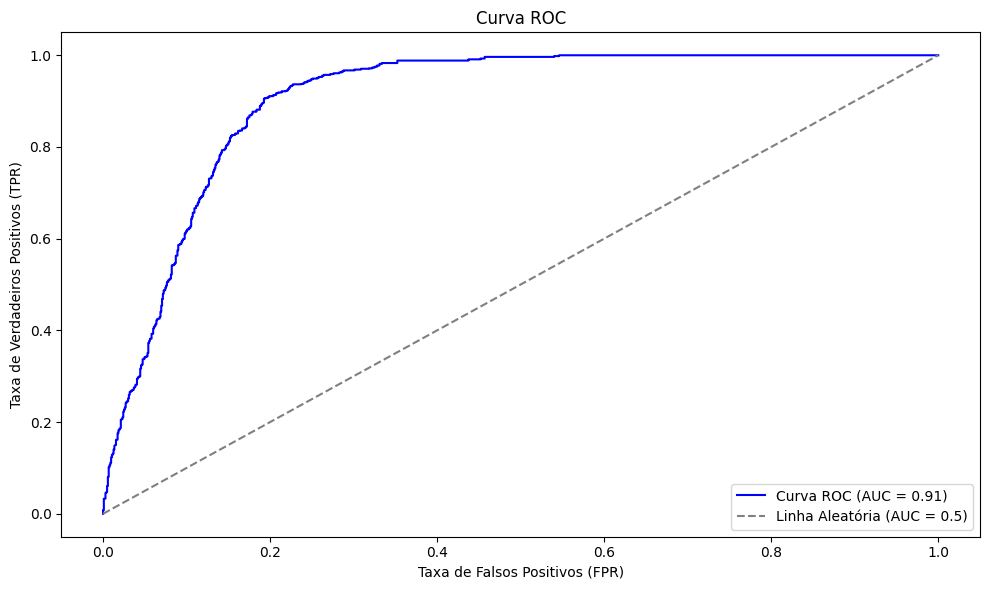

KS: 0.7128


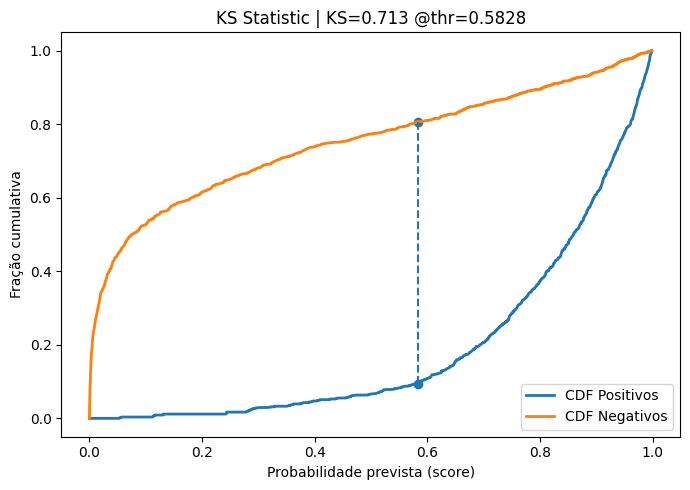

F1 Score: 0.8718

Matriz de Confusão:


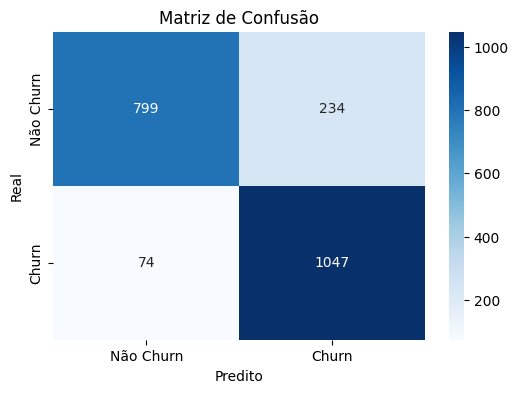

Modelo salvo em xgboost_best_without_kfold.pkl


In [ ]:
from xgboost import XGBClassifier
from sklearn.model_selection import StratifiedKFold
from scipy.stats import ks_2samp
import optuna
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

# Objective function for Optuna - XGBoost
def objective_xgb(trial):
    print(f"Starting Trial {trial.number}")

    # Hiperparâmetros sugeridos pelo Optuna
    n_estimators = trial.suggest_int('n_estimators', 50, 300)
    max_depth = trial.suggest_int('max_depth', 3, 6)
    learning_rate = trial.suggest_float('learning_rate', 0.01, 0.3, log=True)
    subsample = trial.suggest_float('subsample', 0.5, 0.9)
    colsample_bytree = trial.suggest_float('colsample_bytree', 0.5, 1.0)
    min_child_weight = trial.suggest_int('min_child_weight', 3, 8)
    gamma = trial.suggest_float('gamma', 0.0, 5.0)

    model = XGBClassifier(
        n_estimators=n_estimators,
        max_depth=max_depth,
        learning_rate=learning_rate,
        subsample=subsample,
        colsample_bytree=colsample_bytree,
        min_child_weight=min_child_weight,
        gamma=gamma,
        objective='binary:logistic',
        eval_metric='logloss',
        random_state=42,
        n_jobs=-1
    )

    model.fit(X_train_trees, y_train_trees)
    y_pred_prob = model.predict_proba(X_val_trees)[:, 1]  # prob da classe positiva

    # KS calculation
    ks_value = ks_2samp(y_pred_prob[y_val_trees == 0], y_pred_prob[y_val_trees == 1]).statistic
    print(f"Trial {trial.number} finished with KS: {ks_value:.4f}")
    return ks_value

print("Realizando otimização de hiperparâmetros para XGBoost com Optuna...")

study_xgb = optuna.create_study(direction='maximize')
study_xgb.optimize(objective_xgb, n_trials=50)

print("Otimização de hiperparâmetros para XGBoost concluída.")
print(f"Melhores hiperparâmetros para XGBoost: {study_xgb.best_params}")
print(f"Melhor KS score (CV) para XGBoost: {study_xgb.best_value:.4f}")

# Treinar o melhor modelo no conjunto de treino+validação
best_xgb_model = XGBClassifier(**study_xgb.best_params,
                                objective='binary:logistic',
                                eval_metric='logloss',
                                use_label_encoder=False,
                                random_state=42,
                                n_jobs=-1)
best_xgb_model.fit(X_trainval_trees, y_trainval_trees)

# Avaliar no conjunto de teste
print("\nAvaliação do melhor modelo XGBoost no conjunto de teste:")
avaliar_modelo(best_xgb_model, X_test_trees, y_test_trees)

save_model(best_xgb_model, "xgboost_best_without_kfold.pkl")
print("Modelo salvo em xgboost_best_without_kfold.pkl")


[I 2025-08-11 22:50:31,657] A new study created in memory with name: no-name-965195c7-b6ca-4d08-85c6-1e028051b2cb


Realizando otimização de hiperparâmetros para XGBoost com Optuna...
Starting Trial 0
  Fold 1 KS: 0.5720
  Fold 2 KS: 0.5900
  Fold 3 KS: 0.5781
  Fold 4 KS: 0.5344


[I 2025-08-11 22:50:33,074] Trial 0 finished with value: 0.5684057242373193 and parameters: {'n_estimators': 218, 'max_depth': 5, 'learning_rate': 0.01047735850272671, 'subsample': 0.531000688432147, 'colsample_bytree': 0.8776889763075832, 'min_child_weight': 3, 'gamma': 0.3112895068620153}. Best is trial 0 with value: 0.5684057242373193.


  Fold 5 KS: 0.5675
Trial 0 finished with mean KS: 0.5684
Starting Trial 1
  Fold 1 KS: 0.5658
  Fold 2 KS: 0.5720
  Fold 3 KS: 0.5769


[I 2025-08-11 22:50:33,705] Trial 1 finished with value: 0.5591521402374309 and parameters: {'n_estimators': 261, 'max_depth': 4, 'learning_rate': 0.2408276295939601, 'subsample': 0.8215265659336586, 'colsample_bytree': 0.5912178266268935, 'min_child_weight': 5, 'gamma': 4.034084257630608}. Best is trial 0 with value: 0.5684057242373193.


  Fold 4 KS: 0.5220
  Fold 5 KS: 0.5590
Trial 1 finished with mean KS: 0.5592
Starting Trial 2
  Fold 1 KS: 0.5746
  Fold 2 KS: 0.5874
  Fold 3 KS: 0.5912
  Fold 4 KS: 0.5338


[I 2025-08-11 22:50:35,796] Trial 2 finished with value: 0.5719839253552919 and parameters: {'n_estimators': 219, 'max_depth': 6, 'learning_rate': 0.031954478087653955, 'subsample': 0.7764235092434009, 'colsample_bytree': 0.521713225989651, 'min_child_weight': 4, 'gamma': 3.6594110791165835}. Best is trial 2 with value: 0.5719839253552919.


  Fold 5 KS: 0.5730
Trial 2 finished with mean KS: 0.5720
Starting Trial 3
  Fold 1 KS: 0.5582
  Fold 2 KS: 0.5702
  Fold 3 KS: 0.5595


[I 2025-08-11 22:50:36,780] Trial 3 finished with value: 0.5508865782102139 and parameters: {'n_estimators': 102, 'max_depth': 4, 'learning_rate': 0.011284337047616015, 'subsample': 0.5993553385015792, 'colsample_bytree': 0.7829082402487939, 'min_child_weight': 5, 'gamma': 4.381511801753055}. Best is trial 2 with value: 0.5719839253552919.


  Fold 4 KS: 0.5209
  Fold 5 KS: 0.5456
Trial 3 finished with mean KS: 0.5509
Starting Trial 4
  Fold 1 KS: 0.5805
  Fold 2 KS: 0.5748
  Fold 3 KS: 0.5904
  Fold 4 KS: 0.5486


[I 2025-08-11 22:50:37,509] Trial 4 finished with value: 0.5734704858701031 and parameters: {'n_estimators': 184, 'max_depth': 3, 'learning_rate': 0.27289852487331684, 'subsample': 0.6151674704917246, 'colsample_bytree': 0.5951057050398907, 'min_child_weight': 8, 'gamma': 0.5209918629929755}. Best is trial 4 with value: 0.5734704858701031.


  Fold 5 KS: 0.5731
Trial 4 finished with mean KS: 0.5735
Starting Trial 5
  Fold 1 KS: 0.5795
  Fold 2 KS: 0.5896
  Fold 3 KS: 0.5916


[I 2025-08-11 22:50:38,226] Trial 5 finished with value: 0.5734259010784426 and parameters: {'n_estimators': 168, 'max_depth': 5, 'learning_rate': 0.06249666060102614, 'subsample': 0.8860751451962637, 'colsample_bytree': 0.5514398730840735, 'min_child_weight': 7, 'gamma': 1.7196776096022055}. Best is trial 4 with value: 0.5734704858701031.


  Fold 4 KS: 0.5341
  Fold 5 KS: 0.5723
Trial 5 finished with mean KS: 0.5734
Starting Trial 6
  Fold 1 KS: 0.6002
  Fold 2 KS: 0.6300
  Fold 3 KS: 0.6118
  Fold 4 KS: 0.5803


[I 2025-08-11 22:50:38,937] Trial 6 finished with value: 0.6048588687630987 and parameters: {'n_estimators': 98, 'max_depth': 6, 'learning_rate': 0.08067810774782505, 'subsample': 0.5718472528159422, 'colsample_bytree': 0.7867860192404207, 'min_child_weight': 3, 'gamma': 0.23205534184163212}. Best is trial 6 with value: 0.6048588687630987.


  Fold 5 KS: 0.6020
Trial 6 finished with mean KS: 0.6049
Starting Trial 7
  Fold 1 KS: 0.5601
  Fold 2 KS: 0.5665
  Fold 3 KS: 0.5566


[I 2025-08-11 22:50:39,455] Trial 7 finished with value: 0.5516832615023469 and parameters: {'n_estimators': 93, 'max_depth': 4, 'learning_rate': 0.017126388130340637, 'subsample': 0.7669029502166176, 'colsample_bytree': 0.9192110055095856, 'min_child_weight': 8, 'gamma': 2.1530724738334923}. Best is trial 6 with value: 0.6048588687630987.


  Fold 4 KS: 0.5221
  Fold 5 KS: 0.5531
Trial 7 finished with mean KS: 0.5517
Starting Trial 8
  Fold 1 KS: 0.5688
  Fold 2 KS: 0.5771
  Fold 3 KS: 0.5692
  Fold 4 KS: 0.5244


[I 2025-08-11 22:50:40,042] Trial 8 finished with value: 0.5586278100777694 and parameters: {'n_estimators': 85, 'max_depth': 5, 'learning_rate': 0.012563082792668366, 'subsample': 0.6937133401390111, 'colsample_bytree': 0.7451393456660349, 'min_child_weight': 6, 'gamma': 4.477305431938857}. Best is trial 6 with value: 0.6048588687630987.


  Fold 5 KS: 0.5538
Trial 8 finished with mean KS: 0.5586
Starting Trial 9
  Fold 1 KS: 0.6042
  Fold 2 KS: 0.6262
  Fold 3 KS: 0.6155
  Fold 4 KS: 0.5895


[I 2025-08-11 22:50:41,037] Trial 9 finished with value: 0.6104963550831138 and parameters: {'n_estimators': 226, 'max_depth': 5, 'learning_rate': 0.21247331724851823, 'subsample': 0.6510972199236991, 'colsample_bytree': 0.5020265360008223, 'min_child_weight': 6, 'gamma': 0.8016623791047994}. Best is trial 9 with value: 0.6104963550831138.


  Fold 5 KS: 0.6170
Trial 9 finished with mean KS: 0.6105
Starting Trial 10
  Fold 1 KS: 0.5907
  Fold 2 KS: 0.5811
  Fold 3 KS: 0.5863
  Fold 4 KS: 0.5557


[I 2025-08-11 22:50:42,018] Trial 10 finished with value: 0.5793929881705385 and parameters: {'n_estimators': 299, 'max_depth': 3, 'learning_rate': 0.13649113062452942, 'subsample': 0.6689836515047939, 'colsample_bytree': 0.6893633914981092, 'min_child_weight': 6, 'gamma': 1.4512782326270914}. Best is trial 9 with value: 0.6104963550831138.


  Fold 5 KS: 0.5831
Trial 10 finished with mean KS: 0.5794
Starting Trial 11
  Fold 1 KS: 0.6235
  Fold 2 KS: 0.6227
  Fold 3 KS: 0.6171


[I 2025-08-11 22:50:43,016] Trial 11 finished with value: 0.6186840222291147 and parameters: {'n_estimators': 142, 'max_depth': 6, 'learning_rate': 0.09558243816187567, 'subsample': 0.5295423719075988, 'colsample_bytree': 0.8338939680370379, 'min_child_weight': 3, 'gamma': 0.07715554241329386}. Best is trial 11 with value: 0.6186840222291147.


  Fold 4 KS: 0.6078
  Fold 5 KS: 0.6224
Trial 11 finished with mean KS: 0.6187
Starting Trial 12
  Fold 1 KS: 0.6182
  Fold 2 KS: 0.6188
  Fold 3 KS: 0.6170


[I 2025-08-11 22:50:44,056] Trial 12 finished with value: 0.6173182454324696 and parameters: {'n_estimators': 154, 'max_depth': 6, 'learning_rate': 0.1274331307278082, 'subsample': 0.503051790526766, 'colsample_bytree': 0.9734719547380613, 'min_child_weight': 4, 'gamma': 0.8792021472088438}. Best is trial 11 with value: 0.6186840222291147.


  Fold 4 KS: 0.6056
  Fold 5 KS: 0.6269
Trial 12 finished with mean KS: 0.6173
Starting Trial 13
  Fold 1 KS: 0.5927
  Fold 2 KS: 0.6062
  Fold 3 KS: 0.5892
  Fold 4 KS: 0.5568


[I 2025-08-11 22:50:44,716] Trial 13 finished with value: 0.5832059019656776 and parameters: {'n_estimators': 142, 'max_depth': 6, 'learning_rate': 0.1146063848595655, 'subsample': 0.5189645472322568, 'colsample_bytree': 0.9973581149802728, 'min_child_weight': 4, 'gamma': 2.9666639109557016}. Best is trial 11 with value: 0.6186840222291147.


  Fold 5 KS: 0.5712
Trial 13 finished with mean KS: 0.5832
Starting Trial 14
  Fold 1 KS: 0.5921
  Fold 2 KS: 0.6055
  Fold 3 KS: 0.6083


[I 2025-08-11 22:50:45,732] Trial 14 finished with value: 0.5893937240862284 and parameters: {'n_estimators': 139, 'max_depth': 6, 'learning_rate': 0.03794287390271866, 'subsample': 0.5040308083249745, 'colsample_bytree': 0.8847944464607036, 'min_child_weight': 4, 'gamma': 1.1091867550527845}. Best is trial 11 with value: 0.6186840222291147.


  Fold 4 KS: 0.5566
  Fold 5 KS: 0.5844
Trial 14 finished with mean KS: 0.5894
Starting Trial 15
  Fold 1 KS: 0.6357
  Fold 2 KS: 0.6405
  Fold 3 KS: 0.6301
  Fold 4 KS: 0.6148


[I 2025-08-11 22:50:47,022] Trial 15 finished with value: 0.6329894098299447 and parameters: {'n_estimators': 142, 'max_depth': 6, 'learning_rate': 0.12984402716110238, 'subsample': 0.566776637086746, 'colsample_bytree': 0.99242193419588, 'min_child_weight': 3, 'gamma': 0.1148679745653195}. Best is trial 15 with value: 0.6329894098299447.


  Fold 5 KS: 0.6439
Trial 15 finished with mean KS: 0.6330
Starting Trial 16
  Fold 1 KS: 0.6118
  Fold 2 KS: 0.6151
  Fold 3 KS: 0.6124


[I 2025-08-11 22:50:49,200] Trial 16 finished with value: 0.6104790131796843 and parameters: {'n_estimators': 123, 'max_depth': 6, 'learning_rate': 0.09093571377313248, 'subsample': 0.5690000445551537, 'colsample_bytree': 0.8366625552236139, 'min_child_weight': 3, 'gamma': 0.06001517783520095}. Best is trial 15 with value: 0.6329894098299447.


  Fold 4 KS: 0.5960
  Fold 5 KS: 0.6171
Trial 16 finished with mean KS: 0.6105
Starting Trial 17
  Fold 1 KS: 0.5798
  Fold 2 KS: 0.5983
  Fold 3 KS: 0.5883
  Fold 4 KS: 0.5424


[I 2025-08-11 22:50:50,460] Trial 17 finished with value: 0.5782012478294891 and parameters: {'n_estimators': 55, 'max_depth': 5, 'learning_rate': 0.17758426334069866, 'subsample': 0.6303262283446457, 'colsample_bytree': 0.9466599150998976, 'min_child_weight': 3, 'gamma': 2.799888035475495}. Best is trial 15 with value: 0.6329894098299447.


  Fold 5 KS: 0.5822
Trial 17 finished with mean KS: 0.5782
Starting Trial 18
  Fold 1 KS: 0.5862
  Fold 2 KS: 0.6012
  Fold 3 KS: 0.6002


[I 2025-08-11 22:50:51,506] Trial 18 finished with value: 0.5886635220985034 and parameters: {'n_estimators': 190, 'max_depth': 6, 'learning_rate': 0.046296311434907506, 'subsample': 0.5697166808893942, 'colsample_bytree': 0.6775172242470595, 'min_child_weight': 5, 'gamma': 1.9787523471348736}. Best is trial 15 with value: 0.6329894098299447.


  Fold 4 KS: 0.5645
  Fold 5 KS: 0.5911
Trial 18 finished with mean KS: 0.5887
Starting Trial 19
  Fold 1 KS: 0.5822
  Fold 2 KS: 0.5952
  Fold 3 KS: 0.5874
  Fold 4 KS: 0.5409


[I 2025-08-11 22:50:52,360] Trial 19 finished with value: 0.5757024602627621 and parameters: {'n_estimators': 127, 'max_depth': 5, 'learning_rate': 0.025068616262788078, 'subsample': 0.7333988579310206, 'colsample_bytree': 0.8524450404120554, 'min_child_weight': 3, 'gamma': 1.3278934218230847}. Best is trial 15 with value: 0.6329894098299447.


  Fold 5 KS: 0.5728
Trial 19 finished with mean KS: 0.5757
Starting Trial 20
  Fold 1 KS: 0.5854
  Fold 2 KS: 0.5890


[I 2025-08-11 22:50:52,793] Trial 20 finished with value: 0.5732294222303134 and parameters: {'n_estimators': 53, 'max_depth': 6, 'learning_rate': 0.06604805259402981, 'subsample': 0.5548644841162242, 'colsample_bytree': 0.9344648428020992, 'min_child_weight': 4, 'gamma': 3.4642954265104553}. Best is trial 15 with value: 0.6329894098299447.


  Fold 3 KS: 0.5871
  Fold 4 KS: 0.5347
  Fold 5 KS: 0.5699
Trial 20 finished with mean KS: 0.5732
Starting Trial 21
  Fold 1 KS: 0.6300
  Fold 2 KS: 0.6277
  Fold 3 KS: 0.6119
  Fold 4 KS: 0.5930


[I 2025-08-11 22:50:53,958] Trial 21 finished with value: 0.6160974081357213 and parameters: {'n_estimators': 161, 'max_depth': 6, 'learning_rate': 0.11182907322895658, 'subsample': 0.5081360400800132, 'colsample_bytree': 0.9912186968063362, 'min_child_weight': 4, 'gamma': 0.8239466006421252}. Best is trial 15 with value: 0.6329894098299447.


  Fold 5 KS: 0.6179
Trial 21 finished with mean KS: 0.6161
Starting Trial 22
  Fold 1 KS: 0.6350
  Fold 2 KS: 0.6345
  Fold 3 KS: 0.6399
  Fold 4 KS: 0.6292
  Fold 5 KS: 0.6624
Trial 22 finished with mean KS: 0.6402


[I 2025-08-11 22:50:55,008] Trial 22 finished with value: 0.6402102956186131 and parameters: {'n_estimators': 155, 'max_depth': 6, 'learning_rate': 0.16759297667272766, 'subsample': 0.5421091920357153, 'colsample_bytree': 0.9612297931718937, 'min_child_weight': 3, 'gamma': 0.6696188784705467}. Best is trial 22 with value: 0.6402102956186131.


Starting Trial 23
  Fold 1 KS: 0.6429
  Fold 2 KS: 0.6561
  Fold 3 KS: 0.6508
  Fold 4 KS: 0.6477


[I 2025-08-11 22:50:56,216] Trial 23 finished with value: 0.6521096537343236 and parameters: {'n_estimators': 190, 'max_depth': 6, 'learning_rate': 0.16408421306512622, 'subsample': 0.5983856855775926, 'colsample_bytree': 0.9045427140448874, 'min_child_weight': 3, 'gamma': 0.582656199948326}. Best is trial 23 with value: 0.6521096537343236.


  Fold 5 KS: 0.6630
Trial 23 finished with mean KS: 0.6521
Starting Trial 24
  Fold 1 KS: 0.5747
  Fold 2 KS: 0.5750
  Fold 3 KS: 0.5792


[I 2025-08-11 22:50:56,849] Trial 24 finished with value: 0.5658771994484042 and parameters: {'n_estimators': 194, 'max_depth': 5, 'learning_rate': 0.14708870906041766, 'subsample': 0.6122305530088951, 'colsample_bytree': 0.9195557550059134, 'min_child_weight': 3, 'gamma': 4.95282190702077}. Best is trial 23 with value: 0.6521096537343236.


  Fold 4 KS: 0.5378
  Fold 5 KS: 0.5628
Trial 24 finished with mean KS: 0.5659
Starting Trial 25
  Fold 1 KS: 0.6590
  Fold 2 KS: 0.6468
  Fold 3 KS: 0.6528
  Fold 4 KS: 0.6678


[I 2025-08-11 22:50:58,130] Trial 25 finished with value: 0.6572639763245924 and parameters: {'n_estimators': 203, 'max_depth': 6, 'learning_rate': 0.19372924949711648, 'subsample': 0.5947647917891374, 'colsample_bytree': 0.9651873602127483, 'min_child_weight': 4, 'gamma': 0.5833692613771561}. Best is trial 25 with value: 0.6572639763245924.


  Fold 5 KS: 0.6600
Trial 25 finished with mean KS: 0.6573
Starting Trial 26
  Fold 1 KS: 0.6546
  Fold 2 KS: 0.6579
  Fold 3 KS: 0.6768
  Fold 4 KS: 0.6594


[I 2025-08-11 22:51:00,987] Trial 26 finished with value: 0.6609168956400912 and parameters: {'n_estimators': 252, 'max_depth': 5, 'learning_rate': 0.29189205887078723, 'subsample': 0.6598546620762025, 'colsample_bytree': 0.893185774729816, 'min_child_weight': 4, 'gamma': 0.5784582910796998}. Best is trial 26 with value: 0.6609168956400912.


  Fold 5 KS: 0.6560
Trial 26 finished with mean KS: 0.6609
Starting Trial 27
  Fold 1 KS: 0.6274
  Fold 2 KS: 0.6399
  Fold 3 KS: 0.6381
  Fold 4 KS: 0.6306


[I 2025-08-11 22:51:02,074] Trial 27 finished with value: 0.6355818235954722 and parameters: {'n_estimators': 250, 'max_depth': 5, 'learning_rate': 0.2821623188589258, 'subsample': 0.6835913117286347, 'colsample_bytree': 0.8902386460461876, 'min_child_weight': 5, 'gamma': 1.2553545180680103}. Best is trial 26 with value: 0.6609168956400912.


  Fold 5 KS: 0.6419
Trial 27 finished with mean KS: 0.6356
Starting Trial 28
  Fold 1 KS: 0.6066
  Fold 2 KS: 0.5937
  Fold 3 KS: 0.5992
  Fold 4 KS: 0.5799


[I 2025-08-11 22:51:02,989] Trial 28 finished with value: 0.5952850577330098 and parameters: {'n_estimators': 259, 'max_depth': 4, 'learning_rate': 0.19988131921365604, 'subsample': 0.7234506425960738, 'colsample_bytree': 0.8123170693212237, 'min_child_weight': 4, 'gamma': 1.6140357343564893}. Best is trial 26 with value: 0.6609168956400912.


  Fold 5 KS: 0.5971
Trial 28 finished with mean KS: 0.5953
Starting Trial 29
  Fold 1 KS: 0.6545
  Fold 2 KS: 0.6445
  Fold 3 KS: 0.6362
  Fold 4 KS: 0.6385


[I 2025-08-11 22:51:04,261] Trial 29 finished with value: 0.642776006363804 and parameters: {'n_estimators': 234, 'max_depth': 5, 'learning_rate': 0.23089676948939647, 'subsample': 0.6512781634228528, 'colsample_bytree': 0.8781080973974167, 'min_child_weight': 5, 'gamma': 0.45294232132156415}. Best is trial 26 with value: 0.6609168956400912.


  Fold 5 KS: 0.6403
Trial 29 finished with mean KS: 0.6428
Starting Trial 30
  Fold 1 KS: 0.5954
  Fold 2 KS: 0.5933
  Fold 3 KS: 0.5955


[I 2025-08-11 22:51:05,059] Trial 30 finished with value: 0.5920048841331377 and parameters: {'n_estimators': 202, 'max_depth': 4, 'learning_rate': 0.2827391648455336, 'subsample': 0.5993369852333927, 'colsample_bytree': 0.9064988959230275, 'min_child_weight': 4, 'gamma': 2.089524883805041}. Best is trial 26 with value: 0.6609168956400912.


  Fold 4 KS: 0.5756
  Fold 5 KS: 0.6003
Trial 30 finished with mean KS: 0.5920
Starting Trial 31
  Fold 1 KS: 0.6325
  Fold 2 KS: 0.6269
  Fold 3 KS: 0.6508
  Fold 4 KS: 0.6411


[I 2025-08-11 22:51:06,307] Trial 31 finished with value: 0.6390339529351465 and parameters: {'n_estimators': 237, 'max_depth': 5, 'learning_rate': 0.20591327240148607, 'subsample': 0.6476247461627518, 'colsample_bytree': 0.8732819030896881, 'min_child_weight': 5, 'gamma': 0.47017581943446657}. Best is trial 26 with value: 0.6609168956400912.


  Fold 5 KS: 0.6439
Trial 31 finished with mean KS: 0.6390
Starting Trial 32
  Fold 1 KS: 0.6312
  Fold 2 KS: 0.6304
  Fold 3 KS: 0.6418
  Fold 4 KS: 0.6219


[I 2025-08-11 22:51:07,588] Trial 32 finished with value: 0.6346005794297503 and parameters: {'n_estimators': 284, 'max_depth': 5, 'learning_rate': 0.22260404180082077, 'subsample': 0.6506157565498499, 'colsample_bytree': 0.8610673482470426, 'min_child_weight': 5, 'gamma': 1.0945069954400222}. Best is trial 26 with value: 0.6609168956400912.


  Fold 5 KS: 0.6478
Trial 32 finished with mean KS: 0.6346
Starting Trial 33
  Fold 1 KS: 0.6300
  Fold 2 KS: 0.6324
  Fold 3 KS: 0.6311
  Fold 4 KS: 0.6235


[I 2025-08-11 22:51:08,747] Trial 33 finished with value: 0.632161988335619 and parameters: {'n_estimators': 211, 'max_depth': 5, 'learning_rate': 0.16610638602773922, 'subsample': 0.6288962693507523, 'colsample_bytree': 0.9565360829940176, 'min_child_weight': 4, 'gamma': 0.4891506541155354}. Best is trial 26 with value: 0.6609168956400912.


  Fold 5 KS: 0.6439
Trial 33 finished with mean KS: 0.6322
Starting Trial 34
  Fold 1 KS: 0.6141
  Fold 2 KS: 0.6110
  Fold 3 KS: 0.6310
  Fold 4 KS: 0.6047


[I 2025-08-11 22:51:09,714] Trial 34 finished with value: 0.6159095683762799 and parameters: {'n_estimators': 235, 'max_depth': 4, 'learning_rate': 0.29752813090700164, 'subsample': 0.7189969405404071, 'colsample_bytree': 0.8084194857698075, 'min_child_weight': 5, 'gamma': 0.965168092861737}. Best is trial 26 with value: 0.6609168956400912.


  Fold 5 KS: 0.6188
Trial 34 finished with mean KS: 0.6159
Starting Trial 35
  Fold 1 KS: 0.6375
  Fold 2 KS: 0.6431
  Fold 3 KS: 0.6425
  Fold 4 KS: 0.6253


[I 2025-08-11 22:51:10,823] Trial 35 finished with value: 0.640097181872157 and parameters: {'n_estimators': 210, 'max_depth': 5, 'learning_rate': 0.23959554645287762, 'subsample': 0.5895529275036278, 'colsample_bytree': 0.7318618208610063, 'min_child_weight': 4, 'gamma': 0.3842792184876651}. Best is trial 26 with value: 0.6609168956400912.


  Fold 5 KS: 0.6521
Trial 35 finished with mean KS: 0.6401
Starting Trial 36
  Fold 1 KS: 0.6188
  Fold 2 KS: 0.5984
  Fold 3 KS: 0.5997
  Fold 4 KS: 0.5898


[I 2025-08-11 22:51:13,495] Trial 36 finished with value: 0.603417055962219 and parameters: {'n_estimators': 248, 'max_depth': 4, 'learning_rate': 0.17596580010296914, 'subsample': 0.6710940814682987, 'colsample_bytree': 0.90090316341532, 'min_child_weight': 7, 'gamma': 0.5722331553968797}. Best is trial 26 with value: 0.6609168956400912.


  Fold 5 KS: 0.6103
Trial 36 finished with mean KS: 0.6034
Starting Trial 37
  Fold 1 KS: 0.5737
  Fold 2 KS: 0.5798
  Fold 3 KS: 0.5953


[I 2025-08-11 22:51:14,121] Trial 37 finished with value: 0.5775504418923922 and parameters: {'n_estimators': 178, 'max_depth': 3, 'learning_rate': 0.24508028746038393, 'subsample': 0.7558961460399238, 'colsample_bytree': 0.9430466211084629, 'min_child_weight': 5, 'gamma': 1.7830822074220603}. Best is trial 26 with value: 0.6609168956400912.


  Fold 4 KS: 0.5587
  Fold 5 KS: 0.5802
Trial 37 finished with mean KS: 0.5776
Starting Trial 38
  Fold 1 KS: 0.5876
  Fold 2 KS: 0.6041
  Fold 3 KS: 0.5983
  Fold 4 KS: 0.5703


[I 2025-08-11 22:51:14,985] Trial 38 finished with value: 0.5917987604068028 and parameters: {'n_estimators': 285, 'max_depth': 6, 'learning_rate': 0.15816591828833118, 'subsample': 0.8214022714849052, 'colsample_bytree': 0.7748904986540486, 'min_child_weight': 4, 'gamma': 2.3752927844040514}. Best is trial 26 with value: 0.6609168956400912.


  Fold 5 KS: 0.5987
Trial 38 finished with mean KS: 0.5918
Starting Trial 39
  Fold 1 KS: 0.6411
  Fold 2 KS: 0.6511
  Fold 3 KS: 0.6603
  Fold 4 KS: 0.6568


[I 2025-08-11 22:51:16,372] Trial 39 finished with value: 0.6527751707709462 and parameters: {'n_estimators': 224, 'max_depth': 6, 'learning_rate': 0.19402532043113674, 'subsample': 0.6318071817063076, 'colsample_bytree': 0.9294169041229036, 'min_child_weight': 6, 'gamma': 0.33286369266673116}. Best is trial 26 with value: 0.6609168956400912.


  Fold 5 KS: 0.6545
Trial 39 finished with mean KS: 0.6528
Starting Trial 40
  Fold 1 KS: 0.6133
  Fold 2 KS: 0.6290
  Fold 3 KS: 0.6181
  Fold 4 KS: 0.6112


[I 2025-08-11 22:51:17,970] Trial 40 finished with value: 0.6211102877424336 and parameters: {'n_estimators': 273, 'max_depth': 6, 'learning_rate': 0.09938168411622025, 'subsample': 0.6205457030899247, 'colsample_bytree': 0.9278785283560118, 'min_child_weight': 7, 'gamma': 0.34209828491061106}. Best is trial 26 with value: 0.6609168956400912.


  Fold 5 KS: 0.6339
Trial 40 finished with mean KS: 0.6211
Starting Trial 41
  Fold 1 KS: 0.6519
  Fold 2 KS: 0.6464
  Fold 3 KS: 0.6772
  Fold 4 KS: 0.6496


[I 2025-08-11 22:51:19,309] Trial 41 finished with value: 0.6563966262488977 and parameters: {'n_estimators': 223, 'max_depth': 6, 'learning_rate': 0.24709361202975327, 'subsample': 0.643249515534054, 'colsample_bytree': 0.8720499005058185, 'min_child_weight': 6, 'gamma': 0.7007621829340905}. Best is trial 26 with value: 0.6609168956400912.


  Fold 5 KS: 0.6568
Trial 41 finished with mean KS: 0.6564
Starting Trial 42
  Fold 1 KS: 0.6354
  Fold 2 KS: 0.6476
  Fold 3 KS: 0.6469
  Fold 4 KS: 0.6338


[I 2025-08-11 22:51:20,612] Trial 42 finished with value: 0.6423985737772373 and parameters: {'n_estimators': 216, 'max_depth': 6, 'learning_rate': 0.2050947284750453, 'subsample': 0.587248037533497, 'colsample_bytree': 0.908290087020853, 'min_child_weight': 6, 'gamma': 0.6526904286792026}. Best is trial 26 with value: 0.6609168956400912.


  Fold 5 KS: 0.6483
Trial 42 finished with mean KS: 0.6424
Starting Trial 43
  Fold 1 KS: 0.6442
  Fold 2 KS: 0.6624
  Fold 3 KS: 0.6578
  Fold 4 KS: 0.6399


[I 2025-08-11 22:51:21,758] Trial 43 finished with value: 0.6514258984211864 and parameters: {'n_estimators': 223, 'max_depth': 6, 'learning_rate': 0.2550230714980785, 'subsample': 0.6995856890882042, 'colsample_bytree': 0.9706712925232694, 'min_child_weight': 6, 'gamma': 1.0704734785481467}. Best is trial 26 with value: 0.6609168956400912.


  Fold 5 KS: 0.6528
Trial 43 finished with mean KS: 0.6514
Starting Trial 44
  Fold 1 KS: 0.5944
  Fold 2 KS: 0.6097
  Fold 3 KS: 0.6229
  Fold 4 KS: 0.5813


[I 2025-08-11 22:51:22,745] Trial 44 finished with value: 0.6036225165768752 and parameters: {'n_estimators': 196, 'max_depth': 6, 'learning_rate': 0.19101338543151897, 'subsample': 0.6084995422888628, 'colsample_bytree': 0.844384756852196, 'min_child_weight': 7, 'gamma': 1.518167105729633}. Best is trial 26 with value: 0.6609168956400912.


  Fold 5 KS: 0.6098
Trial 44 finished with mean KS: 0.6036
Starting Trial 45
  Fold 1 KS: 0.6617
  Fold 2 KS: 0.6486
  Fold 3 KS: 0.6714
  Fold 4 KS: 0.6604


[I 2025-08-11 22:51:25,418] Trial 45 finished with value: 0.6579778878887846 and parameters: {'n_estimators': 176, 'max_depth': 6, 'learning_rate': 0.2971370638517474, 'subsample': 0.67265795184076, 'colsample_bytree': 0.8172207751054463, 'min_child_weight': 6, 'gamma': 0.02497809515347882}. Best is trial 26 with value: 0.6609168956400912.


  Fold 5 KS: 0.6479
Trial 45 finished with mean KS: 0.6580
Starting Trial 46
  Fold 1 KS: 0.6344
  Fold 2 KS: 0.6545
  Fold 3 KS: 0.6586


[I 2025-08-11 22:51:26,466] Trial 46 finished with value: 0.6495954991706625 and parameters: {'n_estimators': 172, 'max_depth': 6, 'learning_rate': 0.2535395568681001, 'subsample': 0.6775605924581456, 'colsample_bytree': 0.8203259190591746, 'min_child_weight': 6, 'gamma': 0.008214643808994365}. Best is trial 26 with value: 0.6609168956400912.


  Fold 4 KS: 0.6481
  Fold 5 KS: 0.6524
Trial 46 finished with mean KS: 0.6496
Starting Trial 47
  Fold 1 KS: 0.6475
  Fold 2 KS: 0.6482
  Fold 3 KS: 0.6484
  Fold 4 KS: 0.6454


[I 2025-08-11 22:51:27,668] Trial 47 finished with value: 0.6495717984891503 and parameters: {'n_estimators': 204, 'max_depth': 6, 'learning_rate': 0.27032543106881046, 'subsample': 0.6658064179856815, 'colsample_bytree': 0.8648887594752115, 'min_child_weight': 7, 'gamma': 0.25609988084257834}. Best is trial 26 with value: 0.6609168956400912.


  Fold 5 KS: 0.6584
Trial 47 finished with mean KS: 0.6496
Starting Trial 48
  Fold 1 KS: 0.6161
  Fold 2 KS: 0.6253
  Fold 3 KS: 0.6312
  Fold 4 KS: 0.6060


[I 2025-08-11 22:51:29,107] Trial 48 finished with value: 0.6200347843256919 and parameters: {'n_estimators': 247, 'max_depth': 6, 'learning_rate': 0.07829102247241575, 'subsample': 0.6376763264540108, 'colsample_bytree': 0.7868854205166946, 'min_child_weight': 6, 'gamma': 0.8078167961332114}. Best is trial 26 with value: 0.6609168956400912.


  Fold 5 KS: 0.6215
Trial 48 finished with mean KS: 0.6200
Starting Trial 49
  Fold 1 KS: 0.5907
  Fold 2 KS: 0.6114
  Fold 3 KS: 0.6018
  Fold 4 KS: 0.5584


[I 2025-08-11 22:51:30,850] Trial 49 finished with value: 0.59030102679086 and parameters: {'n_estimators': 266, 'max_depth': 6, 'learning_rate': 0.01933323577841895, 'subsample': 0.7126036968169783, 'colsample_bytree': 0.6975719075625104, 'min_child_weight': 6, 'gamma': 0.21877592412353808}. Best is trial 26 with value: 0.6609168956400912.


  Fold 5 KS: 0.5892
Trial 49 finished with mean KS: 0.5903
Otimização de hiperparâmetros para XGBoost concluída.
Melhores hiperparâmetros para XGBoost: {'n_estimators': 252, 'max_depth': 5, 'learning_rate': 0.29189205887078723, 'subsample': 0.6598546620762025, 'colsample_bytree': 0.893185774729816, 'min_child_weight': 4, 'gamma': 0.5784582910796998}
Melhor KS score (CV) para XGBoost: 0.6609


/usr/local/lib/python3.11/dist-packages/xgboost/training.py:183: UserWarning: [22:51:30] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)



Avaliação do melhor modelo XGBoost no conjunto de teste:
📊 Classification Report:
              precision    recall  f1-score   support

   Não Churn       0.89      0.76      0.82      1033
       Churn       0.80      0.92      0.86      1121

    accuracy                           0.84      2154
   macro avg       0.85      0.84      0.84      2154
weighted avg       0.85      0.84      0.84      2154

MSE: 0.1592
MAE: 0.1592
ROC AUC: 0.8877


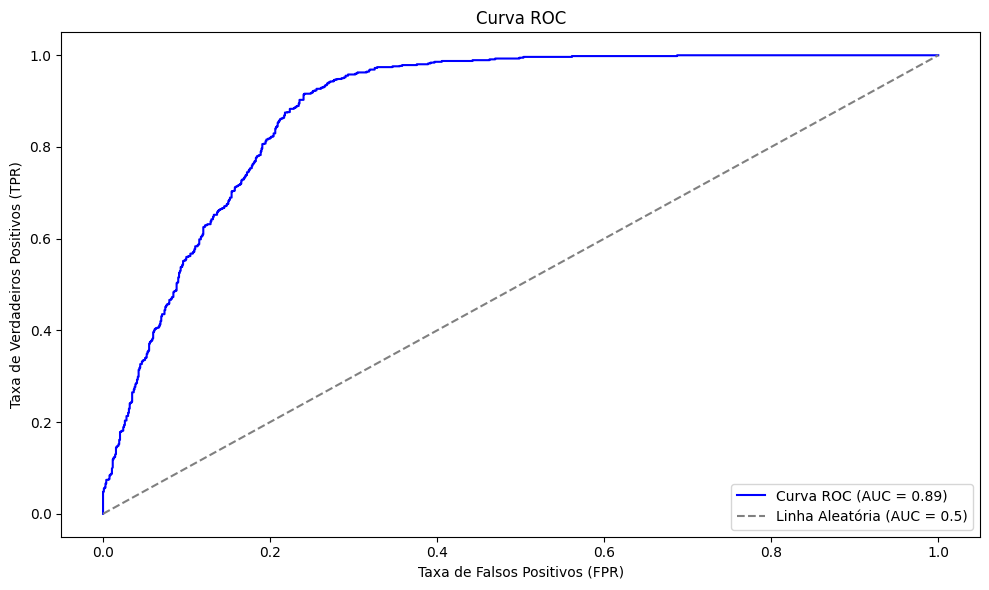

KS: 0.6751


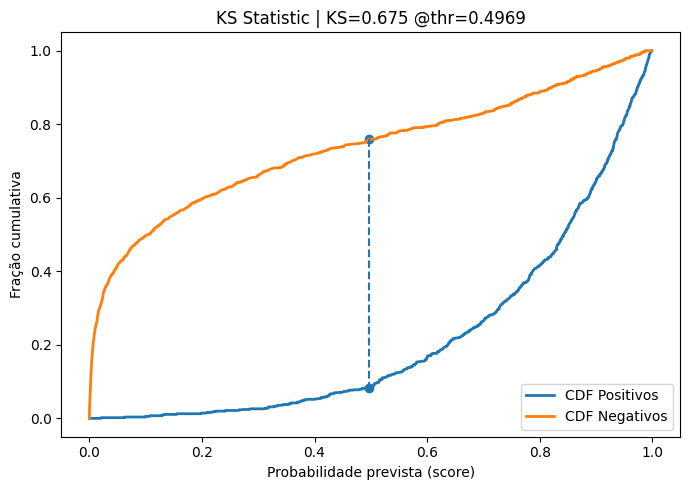

F1 Score: 0.8569

Matriz de Confusão:


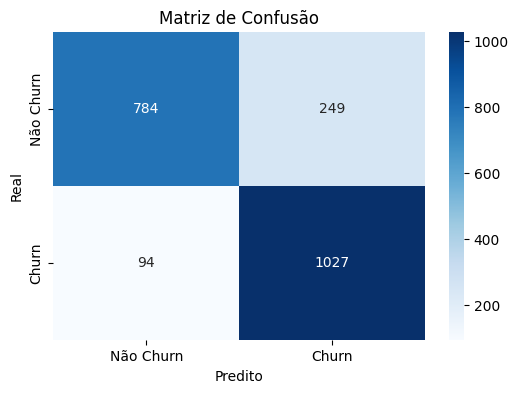

Modelo salvo em xgboost_best.pkl


In [ ]:
from xgboost import XGBClassifier
from sklearn.model_selection import StratifiedKFold
from scipy.stats import ks_2samp
import optuna
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

# Objective function for Optuna - XGBoost
def objective_xgb(trial):
    print(f"Starting Trial {trial.number}")

    # Hiperparâmetros sugeridos pelo Optuna
    n_estimators = trial.suggest_int('n_estimators', 50, 300)
    max_depth = trial.suggest_int('max_depth', 3, 6)
    learning_rate = trial.suggest_float('learning_rate', 0.01, 0.3, log=True)
    subsample = trial.suggest_float('subsample', 0.5, 0.9)
    colsample_bytree = trial.suggest_float('colsample_bytree', 0.5, 1.0)
    min_child_weight = trial.suggest_int('min_child_weight', 3, 8)
    gamma = trial.suggest_float('gamma', 0.0, 5.0)

    model = XGBClassifier(
        n_estimators=n_estimators,
        max_depth=max_depth,
        learning_rate=learning_rate,
        subsample=subsample,
        colsample_bytree=colsample_bytree,
        min_child_weight=min_child_weight,
        gamma=gamma,
        objective='binary:logistic',
        eval_metric='logloss',
        random_state=42,
        n_jobs=-1
    )

    skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
    ks_scores = []

    for fold, (train_idx, val_idx) in enumerate(skf.split(X_trainval_trees, y_trainval_trees), 1):
        X_tr, X_val = X_trainval_trees[train_idx], X_trainval_trees[val_idx]
        y_tr, y_val = y_trainval_trees[train_idx], y_trainval_trees[val_idx]

        model.fit(X_tr, y_tr)
        y_pred_prob = model.predict_proba(X_val)[:, 1]  # Probabilidade da classe positiva

        ks_value = ks_2samp(y_pred_prob[y_val == 0], y_pred_prob[y_val == 1]).statistic
        ks_scores.append(ks_value)

        print(f"  Fold {fold} KS: {ks_value:.4f}")

    mean_ks = np.mean(ks_scores)
    print(f"Trial {trial.number} finished with mean KS: {mean_ks:.4f}")
    return mean_ks

print("Realizando otimização de hiperparâmetros para XGBoost com Optuna...")

study_xgb = optuna.create_study(direction='maximize')
study_xgb.optimize(objective_xgb, n_trials=50)

print("Otimização de hiperparâmetros para XGBoost concluída.")
print(f"Melhores hiperparâmetros para XGBoost: {study_xgb.best_params}")
print(f"Melhor KS score (CV) para XGBoost: {study_xgb.best_value:.4f}")

# Treinar o melhor modelo no conjunto de treino+validação
best_xgb_model = XGBClassifier(**study_xgb.best_params,
                                objective='binary:logistic',
                                eval_metric='logloss',
                                use_label_encoder=False,
                                random_state=42,
                                n_jobs=-1)
best_xgb_model.fit(X_trainval_trees, y_trainval_trees)

# Avaliar no conjunto de teste
print("\nAvaliação do melhor modelo XGBoost no conjunto de teste:")
avaliar_modelo(best_xgb_model, X_test_trees, y_test_trees)

save_model(best_xgb_model, "xgboost_best.pkl")
print("Modelo salvo em xgboost_best.pkl")


# 📊 6. Avaliação (Pessoa 4)

##Métricas

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
from sklearn.metrics import mean_squared_error, log_loss, confusion_matrix, roc_auc_score, precision_score, recall_score, f1_score, roc_curve, auc

In [ ]:
# Plot Gráfico KS
def plot_ks_distribution(y_true, y_pred_prob):
    y_true = np.asarray(y_true).ravel()       # garante vetor 1D
    y_pred_prob = np.asarray(y_pred_prob).ravel()

    plt.figure(figsize=(10, 6))
    plt.hist(y_true, bins=20, alpha=0.5, label="Real", color='blue')
    plt.hist(y_pred_prob, bins=20, alpha=0.5, label="Predito", color='red')

    plt.title("Distribuição das Previsões Reais vs. Previsões do Modelo")
    plt.xlabel("Valor")
    plt.ylabel("Frequência")
    plt.legend(loc="best")

    ks_stat, p_value = stats.ks_2samp(y_true, y_pred_prob)

    # forçar a ser float antes de formatar
    ks_stat = float(ks_stat)
    p_value = float(p_value)

    plt.text(0.95, 0.95, f"KS Stat: {ks_stat:.3f}\nP-Value: {p_value:.3f}",
             ha='right', va='top', transform=plt.gca().transAxes,
             fontsize=12, color='black')

    plt.tight_layout()
    plt.show()

In [ ]:
# MSE
def calculate_mse(y_true, y_pred):
    mse = mean_squared_error(y_true, y_pred)
    return mse

In [ ]:
# Cross Entropy
def cross_entropy(y_true, y_pred_prob):
    return log_loss(y_true, y_pred_prob)

In [ ]:
# Matriz de Confusão
def confusion_matrix_metrics(y_true, y_pred):
    cm = confusion_matrix(y_true, y_pred)
    return cm

In [ ]:
def plot_confusion_matrix(y_true, y_pred, title, decimals=8):
    cm = confusion_matrix(y_true, y_pred)
    cm_percent = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    fmt_str = f".{decimals}f"
    plt.figure(figsize=(4, 3))
    sns.heatmap(cm_percent, annot=True, fmt=fmt_str, cmap="Blues",
                xticklabels=["Negativo", "Positivo"],
                yticklabels=["Negativo", "Positivo"])
    plt.xlabel("Predito")
    plt.ylabel("Verdadeiro")
    plt.title(title + " (%)")
    plt.tight_layout()
    plt.show()

In [ ]:
# ROC
def auc_roc(y_true, y_pred_prob):
    auc = roc_auc_score(y_true, y_pred_prob)
    return auc

In [ ]:
# Plot Curva ROC
def plot_roc_curve(y_true, y_pred_prob):
    fpr, tpr, thresholds = roc_curve(y_true, y_pred_prob)

    roc_auc = auc(fpr, tpr)

    plt.figure(figsize=(10, 6))
    plt.plot(fpr, tpr, color='blue', label=f'Curva ROC (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='gray', linestyle='--', label='Linha Aleatória (AUC = 0.5)')

    plt.title("Curva ROC")
    plt.xlabel("Taxa de Falsos Positivos (FPR)")
    plt.ylabel("Taxa de Verdadeiros Positivos (TPR)")
    plt.legend(loc="lower right")

    plt.tight_layout()
    plt.show()

In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

def classification_metrics(y_true, y_pred):
    accuracy  = accuracy_score(y_true, y_pred)
    precision = precision_score(y_true, y_pred)
    recall    = recall_score(y_true, y_pred)
    f1        = f1_score(y_true, y_pred)
    return accuracy, precision, recall, f1

In [ ]:
def ks_score_and_plot(y_true, y_pred_prob, title="KS Statistic"):
    # vetor 1D
    y_true = np.asarray(y_true).ravel().astype(int)
    scores = np.asarray(y_pred_prob).ravel().astype(float)

    # ordena por score (crescente)
    order = np.argsort(scores)
    y_sorted = y_true[order]
    s_sorted = scores[order]

    # totais
    n_pos = (y_sorted == 1).sum()
    n_neg = (y_sorted == 0).sum()
    if n_pos == 0 or n_neg == 0:
        raise ValueError("KS requer ao menos um positivo e um negativo.")

    # CDFs cumulativas
    cum_pos = np.cumsum(y_sorted == 1) / n_pos
    cum_neg = np.cumsum(y_sorted == 0) / n_neg

    # distância KS ponto a ponto
    ks_diff = np.abs(cum_pos - cum_neg)
    ks_idx  = np.argmax(ks_diff)
    ks_val  = float(ks_diff[ks_idx])
    ks_thr  = float(s_sorted[ks_idx])

    # Plot (CDFs + anotação do KS)
    plt.figure(figsize=(7, 5))
    plt.plot(s_sorted, cum_pos, label="CDF Positivos", linewidth=2)
    plt.plot(s_sorted, cum_neg, label="CDF Negativos", linewidth=2)
    plt.vlines(ks_thr, cum_neg[ks_idx], cum_pos[ks_idx], linestyles="--")
    plt.scatter([ks_thr, ks_thr], [cum_pos[ks_idx], cum_neg[ks_idx]])

    plt.title(f"{title} | KS={ks_val:.3f} @thr={ks_thr:.4f}")
    plt.xlabel("Probabilidade prevista (score)")
    plt.ylabel("Fração cumulativa")
    plt.legend(loc="lower right")
    plt.tight_layout()
    plt.show()

    return ks_val, ks_thr

In [ ]:
# Avaliação do Modelo
def evaluate_model_keras(model, X_train, X_val, X_test, y_train, y_val, y_test):

    y_train_pred_prob = model.predict(X_train).squeeze()
    y_val_pred_prob   = model.predict(X_val).squeeze()
    y_test_pred_prob  = model.predict(X_test).squeeze()

    # Classes (0 ou 1)
    y_train_pred = (y_train_pred_prob >= 0.5).astype(int)
    y_val_pred   = (y_val_pred_prob   >= 0.5).astype(int)
    y_test_pred  = (y_test_pred_prob  >= 0.5).astype(int)

    # MSE
    mse_train = calculate_mse(y_train, y_train_pred)
    mse_val = calculate_mse(y_val, y_val_pred)
    mse_test = calculate_mse(y_test, y_test_pred)

    # Cross-Entropy
    ce_train = cross_entropy(y_train, y_train_pred_prob)
    ce_val = cross_entropy(y_val, y_val_pred_prob)
    ce_test = cross_entropy(y_test, y_test_pred_prob)

    # Métricas de classificação
    accuracy_train, precision_train, recall_train, f1_train = classification_metrics(y_train, y_train_pred)
    accuracy_val, precision_val, recall_val, f1_val = classification_metrics(y_val, y_val_pred)
    accuracy_test, precision_test, recall_test, f1_test = classification_metrics(y_test, y_test_pred)

    # AUC-ROC
    auc_train = auc_roc(y_train, y_train_pred_prob)
    auc_val = auc_roc(y_val, y_val_pred_prob)
    auc_test = auc_roc(y_test, y_test_pred_prob)

    # Matriz de Confusão
    cm_train = confusion_matrix_metrics(y_train, y_train_pred)
    cm_val = confusion_matrix_metrics(y_val, y_val_pred)
    cm_test = confusion_matrix_metrics(y_test, y_test_pred)

    # Printando todos os resultados
    print('\n')
    print(f'MSE Train: {mse_train}')
    print(f'MSE Val: {mse_val}')
    print(f'MSE Test: {mse_test}')
    print('\n')

    print('\n')
    print(f'Cross-Entropy Train: {ce_train}')
    print(f'Cross-Entropy Val: {ce_val}')
    print(f'Cross-Entropy Test: {ce_test}')
    print('\n')

    print('\n')
    print(f'Accuracy Train: {accuracy_train}')
    print(f'Accuracy Val: {accuracy_val}')
    print(f'Accuracy Test: {accuracy_test}')
    print('\n')

    print('\n')
    print(f'Precision Train: {precision_train}')
    print(f'Precision Val: {precision_val}')
    print(f'Precision Test: {precision_test}')
    print('\n')

    print('\n')
    print(f'Recall Train: {recall_train}')
    print(f'Recall Val: {recall_val}')
    print(f'Recall Test: {recall_test}')
    print('\n')

    print('\n')
    print(f'F1 Train: {f1_train}')
    print(f'F1 Val: {f1_val}')
    print(f'F1 Test: {f1_test}')
    print('\n')

    print('\n')
    print(f'AUC Train: {auc_train}')
    print(f'AUC Val: {auc_val}')
    print(f'AUC Test: {auc_test}')
    print('\n')

    print('\n')
    print(f'Confusion Matrix Train: \n{cm_train}')
    print(f'Confusion Matrix Val: \n{cm_val}')
    print(f'Confusion Matrix Test: \n{cm_test}')
    print('\n')


    print('\n')
    plot_confusion_matrix(y_train, y_train_pred, "Matriz de Confusão - Treino")
    print('\n')
    plot_confusion_matrix(y_val,   y_val_pred,   "Matriz de Confusão - Validação")
    print('\n')
    plot_confusion_matrix(y_test,  y_test_pred,  "Matriz de Confusão - Teste")
    print('\n')

    # Plotando a curva ROC
    print('\n')
    plot_roc_curve(y_test, y_test_pred_prob)
    print('\n')

    # Plotando a curva KS
    print('\n')
    plot_ks_distribution(y_test, y_test_pred_prob)
    print('\n')

    print('\n')
    ks_train, thr_train = ks_score_and_plot(y_train_nn, y_train_pred_prob, "KS - Treino")
    print('\n')
    ks_val,   thr_val   = ks_score_and_plot(y_val_nn,   y_val_pred_prob,   "KS - Validação")
    print('\n')
    ks_test,  thr_test  = ks_score_and_plot(y_test_nn,  y_test_pred_prob,  "KS - Teste")
    print('\n')

In [ ]:
# Avaliação do Modelo
def evaluate_model_trees(model, X_train, X_val, X_test, y_train, y_val, y_test):

    y_train_pred_prob = model.predict_proba(X_train)[:, 1]
    y_val_pred_prob   = model.predict_proba(X_val)[:, 1]
    y_test_pred_prob  = model.predict_proba(X_test)[:, 1]

    # Classes (0 ou 1)
    y_train_pred = (y_train_pred_prob >= 0.5).astype(int)
    y_val_pred   = (y_val_pred_prob   >= 0.5).astype(int)
    y_test_pred  = (y_test_pred_prob  >= 0.5).astype(int)

    # MSE
    mse_train = calculate_mse(y_train, y_train_pred)
    mse_val = calculate_mse(y_val, y_val_pred)
    mse_test = calculate_mse(y_test, y_test_pred)

    # Cross-Entropy
    ce_train = cross_entropy(y_train, y_train_pred_prob)
    ce_val = cross_entropy(y_val, y_val_pred_prob)
    ce_test = cross_entropy(y_test, y_test_pred_prob)

    # Métricas de classificação
    accuracy_train, precision_train, recall_train, f1_train = classification_metrics(y_train, y_train_pred)
    accuracy_val, precision_val, recall_val, f1_val = classification_metrics(y_val, y_val_pred)
    accuracy_test, precision_test, recall_test, f1_test = classification_metrics(y_test, y_test_pred)

    # AUC-ROC
    auc_train = auc_roc(y_train, y_train_pred_prob)
    auc_val = auc_roc(y_val, y_val_pred_prob)
    auc_test = auc_roc(y_test, y_test_pred_prob)

    # Matriz de Confusão
    cm_train = confusion_matrix_metrics(y_train, y_train_pred)
    cm_val = confusion_matrix_metrics(y_val, y_val_pred)
    cm_test = confusion_matrix_metrics(y_test, y_test_pred)

    # Printando todos os resultados
    print('\n')
    print(f'MSE Train: {mse_train}')
    print(f'MSE Val: {mse_val}')
    print(f'MSE Test: {mse_test}')
    print('\n')

    print('\n')
    print(f'Cross-Entropy Train: {ce_train}')
    print(f'Cross-Entropy Val: {ce_val}')
    print(f'Cross-Entropy Test: {ce_test}')
    print('\n')

    print('\n')
    print(f'Accuracy Train: {accuracy_train}')
    print(f'Accuracy Val: {accuracy_val}')
    print(f'Accuracy Test: {accuracy_test}')
    print('\n')

    print('\n')
    print(f'Precision Train: {precision_train}')
    print(f'Precision Val: {precision_val}')
    print(f'Precision Test: {precision_test}')
    print('\n')

    print('\n')
    print(f'Recall Train: {recall_train}')
    print(f'Recall Val: {recall_val}')
    print(f'Recall Test: {recall_test}')
    print('\n')

    print('\n')
    print(f'F1 Train: {f1_train}')
    print(f'F1 Val: {f1_val}')
    print(f'F1 Test: {f1_test}')
    print('\n')

    print('\n')
    print(f'AUC Train: {auc_train}')
    print(f'AUC Val: {auc_val}')
    print(f'AUC Test: {auc_test}')
    print('\n')

    print('\n')
    print(f'Confusion Matrix Train: \n{cm_train}')
    print(f'Confusion Matrix Val: \n{cm_val}')
    print(f'Confusion Matrix Test: \n{cm_test}')
    print('\n')


    print('\n')
    plot_confusion_matrix(y_train, y_train_pred, "Matriz de Confusão - Treino")
    print('\n')
    plot_confusion_matrix(y_val,   y_val_pred,   "Matriz de Confusão - Validação")
    print('\n')
    plot_confusion_matrix(y_test,  y_test_pred,  "Matriz de Confusão - Teste")
    print('\n')

    # Plotando a curva ROC
    print('\n')
    plot_roc_curve(y_test, y_test_pred_prob)
    print('\n')

    # Plotando a curva KS
    print('\n')
    plot_ks_distribution(y_test, y_test_pred_prob)
    print('\n')

    print('\n')
    ks_train, thr_train = ks_score_and_plot(y_train_nn, y_train_pred_prob, "KS - Treino")
    print('\n')
    ks_val,   thr_val   = ks_score_and_plot(y_val_nn,   y_val_pred_prob,   "KS - Validação")
    print('\n')
    ks_test,  thr_test  = ks_score_and_plot(y_test_nn,  y_test_pred_prob,  "KS - Teste")
    print('\n')

In [ ]:
import torch, torch.nn as nn
from collections import OrderedDict
import numpy as np

# 1) Classe igual à do treino
class STABTransformer(nn.Module):
    def __init__(self, input_dim, d_model=64, n_heads=4, n_layers=2, dropout=0.1):
        super().__init__()
        self.input_proj = nn.Linear(input_dim, d_model)
        enc_layer = nn.TransformerEncoderLayer(d_model=d_model, nhead=n_heads,
                                               dropout=dropout, batch_first=True)
        self.encoder = nn.TransformerEncoder(enc_layer, num_layers=n_layers)
        self.head = nn.Sequential(
            nn.Linear(d_model, 64), nn.ReLU(), nn.Dropout(dropout),
            nn.Linear(64, 1), nn.Sigmoid()  # BCELoss no treino ⇒ saída já é prob
        )
    def forward(self, x):
        x = self.input_proj(x).unsqueeze(1)   # (B,1,d_model)
        x = self.encoder(x).squeeze(1)        # (B,d_model)
        return self.head(x)                   # (B,1)

# 2) Carregar pesos do TAB_PATH3 com os MESMOS hparams do treino
def load_stab_from_state(path, input_dim, d_model=64, n_heads=4, n_layers=2, dropout=0.1):
    ckpt = torch.load(path, map_location="cpu")
    state = ckpt.get("model_state_dict", ckpt.get("state_dict", ckpt)) if isinstance(ckpt, dict) else ckpt
    model = STABTransformer(input_dim=input_dim, d_model=d_model,
                            n_heads=n_heads, n_layers=n_layers, dropout=dropout)
    new_state = OrderedDict((k.replace("module.", ""), v) for k, v in state.items())
    model.load_state_dict(new_state, strict=True)  # se acusar mismatch, confirme hparams
    model.eval()
    return model

# 3) Instanciar com os hparams usados em TAB_PATH3
input_dim = X_train_nn.shape[1]  # 45

# 4) Helper mínimo para o seu evaluate_model aceitar PyTorch
import numpy as np
def _predict_probs(model, X):
    X = np.asarray(X, dtype=np.float32)

    # PyTorch primeiro
    if isinstance(model, nn.Module):
        model.eval()
        with torch.no_grad():
            out = model(torch.tensor(X, dtype=torch.float32)).cpu().numpy().squeeze()
        # se por algum motivo vier fora de [0,1], aplica sigmoid
        if out.min() < 0.0 or out.max() > 1.0:
            out = 1.0 / (1.0 + np.exp(-out))
        return out.astype(np.float32)

    # scikit-learn
    if hasattr(model, "predict_proba"):
        proba = model.predict_proba(X)
        return np.asarray(proba[:, 1], dtype=np.float32).squeeze()

    # Keras/sklearn com predict
    if hasattr(model, "predict"):
        out = model.predict(X)
        out = np.asarray(out).squeeze()
        if out.min() < 0.0 or out.max() > 1.0:
            out = 1.0 / (1.0 + np.exp(-out))
        return out.astype(np.float32)

    raise TypeError("Modelo não reconhecido: passe um nn.Module, Keras ou sklearn.")

In [ ]:
def evaluate_model_pytorch(model, X_train, X_val, X_test, y_train, y_val, y_test):

    # >>> alteração mínima: usar _predict_probs <<<
    y_train_pred_prob = _predict_probs(model, X_train)
    y_val_pred_prob   = _predict_probs(model, X_val)
    y_test_pred_prob  = _predict_probs(model, X_test)

    # Classes (0 ou 1)
    y_train_pred = (y_train_pred_prob >= 0.5).astype(int)
    y_val_pred   = (y_val_pred_prob   >= 0.5).astype(int)
    y_test_pred  = (y_test_pred_prob  >= 0.5).astype(int)

    # MSE
    mse_train = calculate_mse(y_train, y_train_pred)
    mse_val = calculate_mse(y_val, y_val_pred)
    mse_test = calculate_mse(y_test, y_test_pred)

    # Cross-Entropy
    ce_train = cross_entropy(y_train, y_train_pred_prob)
    ce_val = cross_entropy(y_val, y_val_pred_prob)
    ce_test = cross_entropy(y_test, y_test_pred_prob)

    # Métricas de classificação
    accuracy_train, precision_train, recall_train, f1_train = classification_metrics(y_train, y_train_pred)
    accuracy_val, precision_val, recall_val, f1_val = classification_metrics(y_val, y_val_pred)
    accuracy_test, precision_test, recall_test, f1_test = classification_metrics(y_test, y_test_pred)

    # AUC-ROC
    auc_train = auc_roc(y_train, y_train_pred_prob)
    auc_val = auc_roc(y_val, y_val_pred_prob)
    auc_test = auc_roc(y_test, y_test_pred_prob)

    # Matriz de Confusão
    cm_train = confusion_matrix_metrics(y_train, y_train_pred)
    cm_val = confusion_matrix_metrics(y_val, y_val_pred)
    cm_test = confusion_matrix_metrics(y_test, y_test_pred)

    # Printando todos os resultados
    print('\n')
    print(f'MSE Train: {mse_train}')
    print(f'MSE Val: {mse_val}')
    print(f'MSE Test: {mse_test}')
    print('\n')

    print('\n')
    print(f'Cross-Entropy Train: {ce_train}')
    print(f'Cross-Entropy Val: {ce_val}')
    print(f'Cross-Entropy Test: {ce_test}')
    print('\n')

    print('\n')
    print(f'Accuracy Train: {accuracy_train}')
    print(f'Accuracy Val: {accuracy_val}')
    print(f'Accuracy Test: {accuracy_test}')
    print('\n')

    print('\n')
    print(f'Precision Train: {precision_train}')
    print(f'Precision Val: {precision_val}')
    print(f'Precision Test: {precision_test}')
    print('\n')

    print('\n')
    print(f'Recall Train: {recall_train}')
    print(f'Recall Val: {recall_val}')
    print(f'Recall Test: {recall_test}')
    print('\n')

    print('\n')
    print(f'F1 Train: {f1_train}')
    print(f'F1 Val: {f1_val}')
    print(f'F1 Test: {f1_test}')
    print('\n')

    print('\n')
    print(f'AUC Train: {auc_train}')
    print(f'AUC Val: {auc_val}')
    print(f'AUC Test: {auc_test}')
    print('\n')

    print('\n')
    print(f'Confusion Matrix Train: \n{cm_train}')
    print(f'Confusion Matrix Val: \n{cm_val}')
    print(f'Confusion Matrix Test: \n{cm_test}')
    print('\n')


    print('\n')
    plot_confusion_matrix(y_train, y_train_pred, "Matriz de Confusão - Treino")
    print('\n')
    plot_confusion_matrix(y_val,   y_val_pred,   "Matriz de Confusão - Validação")
    print('\n')
    plot_confusion_matrix(y_test,  y_test_pred,  "Matriz de Confusão - Teste")
    print('\n')

    # Plotando a curva ROC
    print('\n')
    plot_roc_curve(y_test, y_test_pred_prob)
    print('\n')

    # Plotando a curva KS
    print('\n')
    plot_ks_distribution(y_test, y_test_pred_prob)
    print('\n')

    print('\n')
    ks_train, thr_train = ks_score_and_plot(y_train_nn, y_train_pred_prob, "KS - Treino")
    print('\n')
    ks_val,   thr_val   = ks_score_and_plot(y_val_nn,   y_val_pred_prob,   "KS - Validação")
    print('\n')
    ks_test,  thr_test  = ks_score_and_plot(y_test_nn,  y_test_pred_prob,  "KS - Teste")
    print('\n')

##Avaliação

###Conectando ao Drive e Importando as Bibliotecas Necessárias

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

GB1_PATH = "/content/drive/MyDrive/RN/gradient_boosting_best.pkl"
GB2_PATH = "/content/drive/MyDrive/RN/gradient_boosting_best_without_kfold.pkl"
RF1_PATH = "/content/drive/MyDrive/RN/random_forest_best.pkl"
RF2_PATH = "/content/drive/MyDrive/RN/random_forest_best_without_kfold.pkl"
XGB1_PATH = "/content/drive/MyDrive/RN/xgboost_best.pkl"
XGB2_PATH = "/content/drive/MyDrive/RN/xgboost_best_without_kfold.pkl"

NN1_PATH = "/content/drive/MyDrive/RN/nn_1camada_adam_crossentropy.h5"
NN2_PATH = "/content/drive/MyDrive/RN/nn_2camada_0.3dropout_500epochs(2).h5"
NN3_PATH = "/content/drive/MyDrive/RN/nn_3camada_0.3dropout_500epochs(2).h5"
TAB_PATH = "/content/drive/MyDrive/RN/exp1.pkl"
STAB1_PATH = "/content/drive/MyDrive/RN/stab_transformer_4head_2layer_0.1droput(6).pt"
STAB2_PATH = "/content/drive/MyDrive/RN/stab_transformer_8head_3layer_0.3droput_500epochs.pt"
STAB3_PATH = "/content/drive/MyDrive/RN/stab_transformer_16head_1layer_0.1droput_1000epochs.pt"

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import joblib #para arquivos .joblib/.pkl joblib.load($PATH)
import torch, torch.nn as nn #para arquivos .pth/.pt torch.load($PATH, map_location="cpu")
from tensorflow.keras.models import load_model #para arquivos .h5 load_model($PATH)

###Modelo de chamada de função de avaliação

In [ ]:
'''model_torch = load_stab_from_state(   #para arquivos .pth/.pt torch.load($PATH, map_location="cpu")
    $PATH,
    input_dim=input_dim,
    d_model=64,
    n_heads=4,
    n_layers=2,
    dropout=0.1
)

evaluate_model_pytorch(
    model_torch,
    X_train_nn.astype("float32"),
    X_val_nn.astype("float32"),
    X_test_nn.astype("float32"),
    np.asarray(y_train_nn).ravel().astype(int),
    np.asarray(y_val_nn  ).ravel().astype(int),
    np.asarray(y_test_nn ).ravel().astype(int)
)

In [ ]:
'''model = load_model($PATH) #para arquivos .h5 load_model($PATH)
evaluate_model_keras(model, X_train_nn.astype("float32"),
                        X_val_nn.astype("float32"),
                        X_test_nn.astype("float32"),
                        np.asarray(y_train_nn).reshape(-1,1).astype("float32"),
                        np.asarray(y_val_nn  ).reshape(-1,1).astype("float32"),
                        np.asarray(y_test_nn ).reshape(-1,1).astype("float32"))

In [ ]:
'''model = joblib.load($PATH)  #para arquivos .joblib/.pkl joblib.load($PATH)
evaluate_model_trees(model, X_train_trees,
                        X_val_trees,
                        X_test_trees,
                        y_train_trees,
                        y_val_trees,
                        y_test_trees)

###GB, RF, XGB


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2732: UserWarning: X has feature names, but GradientBoostingClassifier was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2732: UserWarning: X has feature names, but GradientBoostingClassifier was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2732: UserWarning: X has feature names, but GradientBoostingClassifier was fitted without feature names
  warnings.warn(




MSE Train: 0.15710964742347927
MSE Val: 0.13361735089078233
MSE Test: 0.12664601084430674




Cross-Entropy Train: 0.36411175464566653
Cross-Entropy Val: 0.32810092349945086
Cross-Entropy Test: 0.3187674524686785




Accuracy Train: 0.8428903525765207
Accuracy Val: 0.8663826491092177
Accuracy Test: 0.8733539891556933




Precision Train: 0.8070784177654406
Precision Val: 0.8427536231884057
Precision Test: 0.8418439716312057




Recall Train: 0.9012010848508331
Recall Val: 0.900852052672347
Recall Test: 0.919442292796282




F1 Train: 0.8515467691744463
F1 Val: 0.8708348932983901
F1 Test: 0.8789337282487968




AUC Train: 0.9175938642609442
AUC Val: 0.9406944100280737
AUC Test: 0.9434336864702964




Confusion Matrix Train: 
[[2025  556]
 [ 255 2326]]
Confusion Matrix Val: 
[[1074  217]
 [ 128 1163]]
Confusion Matrix Test: 
[[1068  223]
 [ 104 1187]]






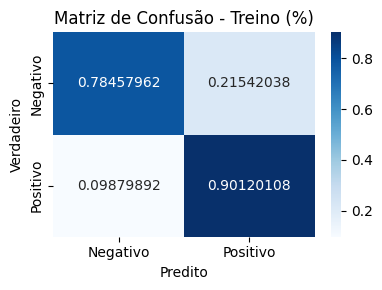

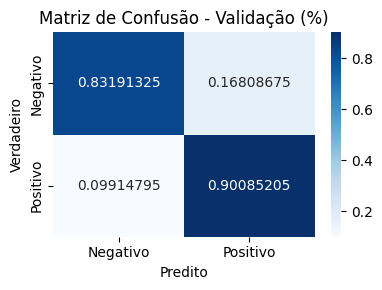

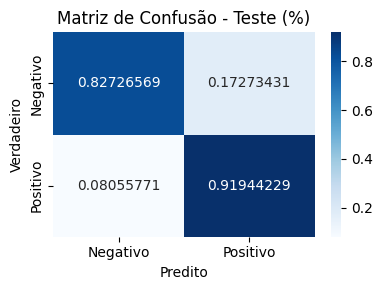

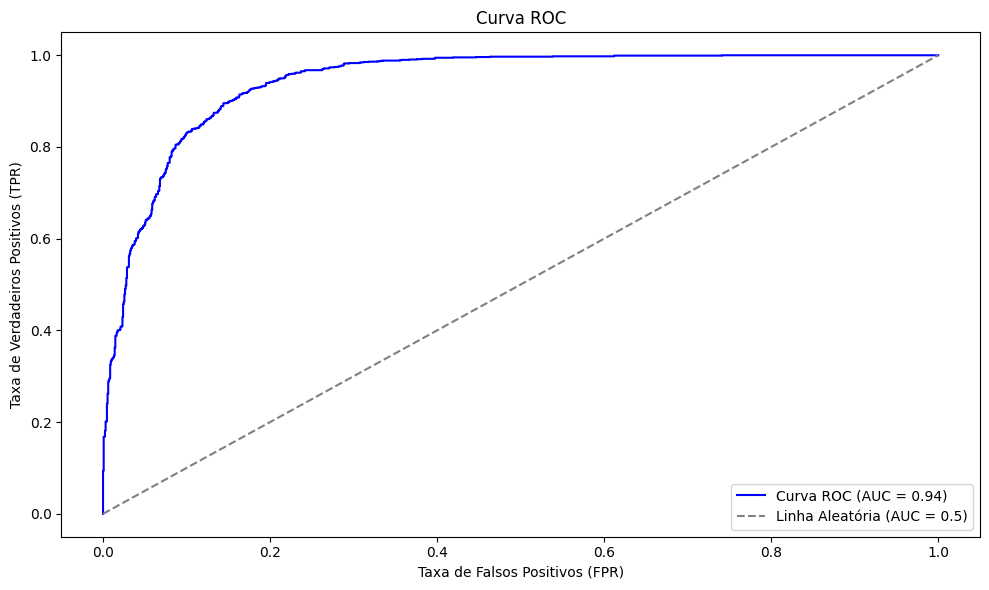

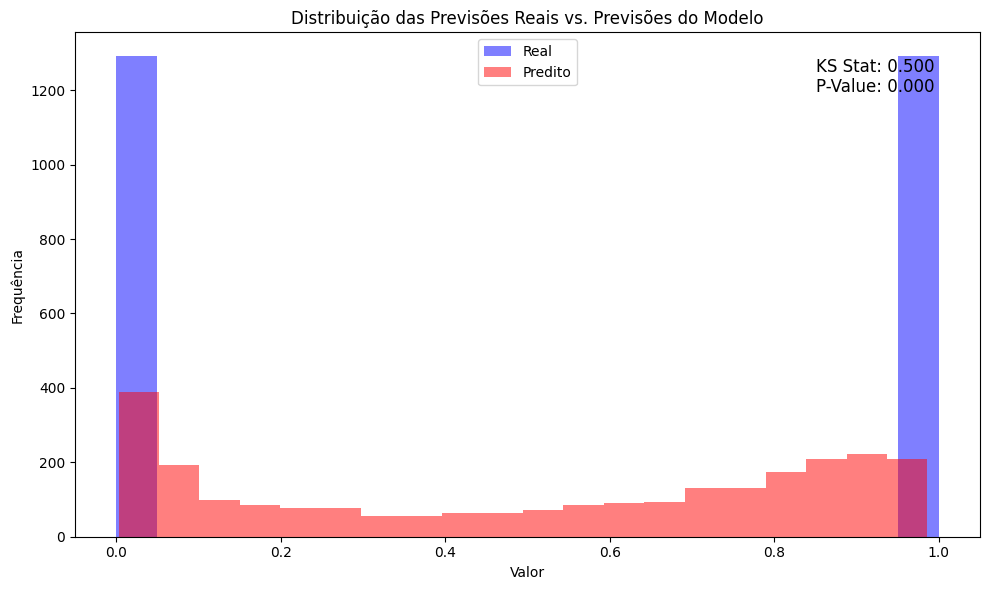

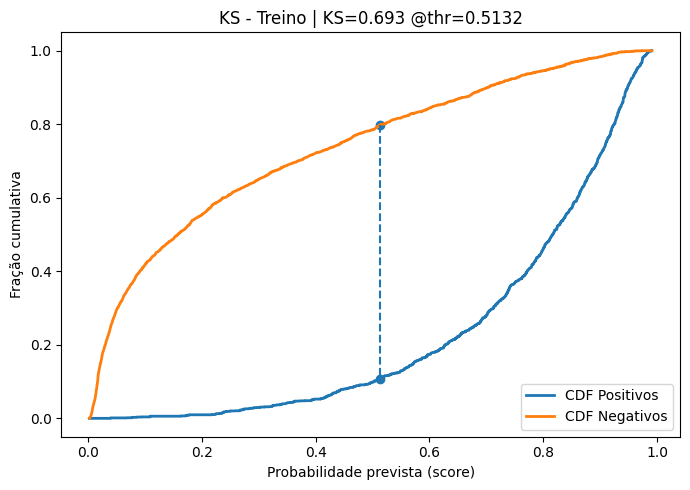

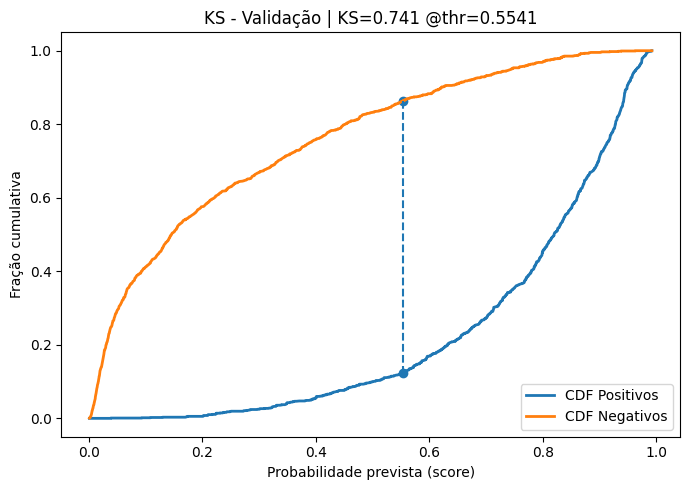

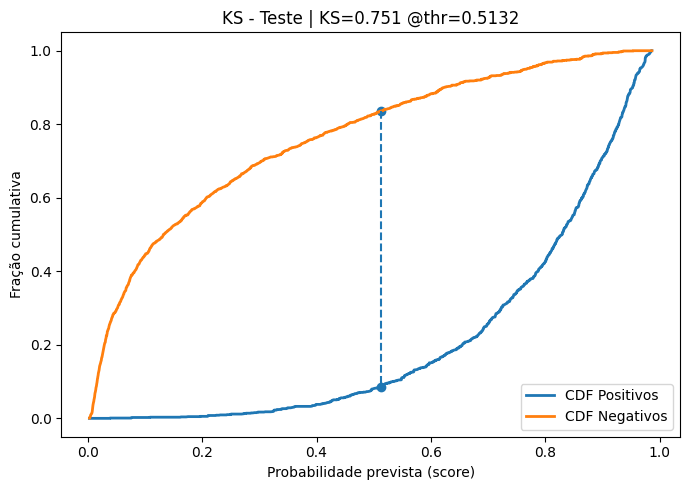

In [ ]:
model = joblib.load(GB1_PATH)
evaluate_model_trees(model, X_train_trees,
                        X_val_trees,
                        X_test_trees,
                        y_train_trees,
                        y_val_trees,
                        y_test_trees)



MSE Train: 0.17822549399457574
MSE Val: 0.16150271107668474
MSE Test: 0.15453137103020914




Cross-Entropy Train: 0.38967181334905965
Cross-Entropy Val: 0.36400030709058284
Cross-Entropy Test: 0.3505654622325574




Accuracy Train: 0.8217745060054242
Accuracy Val: 0.8384972889233152
Accuracy Test: 0.8454686289697909




Precision Train: 0.7872708405396057
Precision Val: 0.8134863701578192
Precision Test: 0.8101529902642559




Recall Train: 0.8818287485470748
Recall Val: 0.8783888458559257
Recall Test: 0.9024012393493416




F1 Train: 0.8318713450292398
F1 Val: 0.8446927374301676
F1 Test: 0.8537925980212532




AUC Train: 0.9045737928392459
AUC Val: 0.9214147758329277
AUC Test: 0.9294262069346204




Confusion Matrix Train: 
[[1966  615]
 [ 305 2276]]
Confusion Matrix Val: 
[[1031  260]
 [ 157 1134]]
Confusion Matrix Test: 
[[1018  273]
 [ 126 1165]]






/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2732: UserWarning: X has feature names, but GradientBoostingClassifier was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2732: UserWarning: X has feature names, but GradientBoostingClassifier was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2732: UserWarning: X has feature names, but GradientBoostingClassifier was fitted without feature names
  warnings.warn(


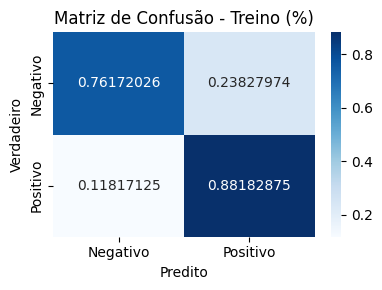

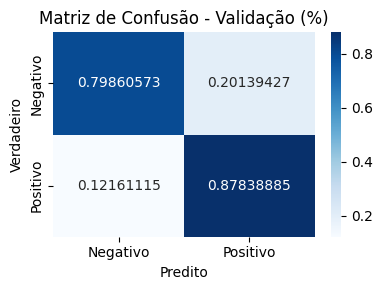

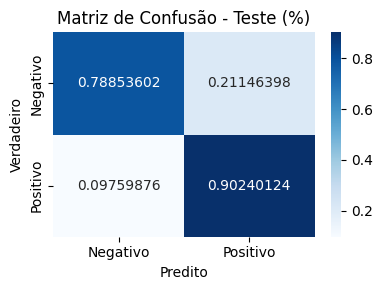

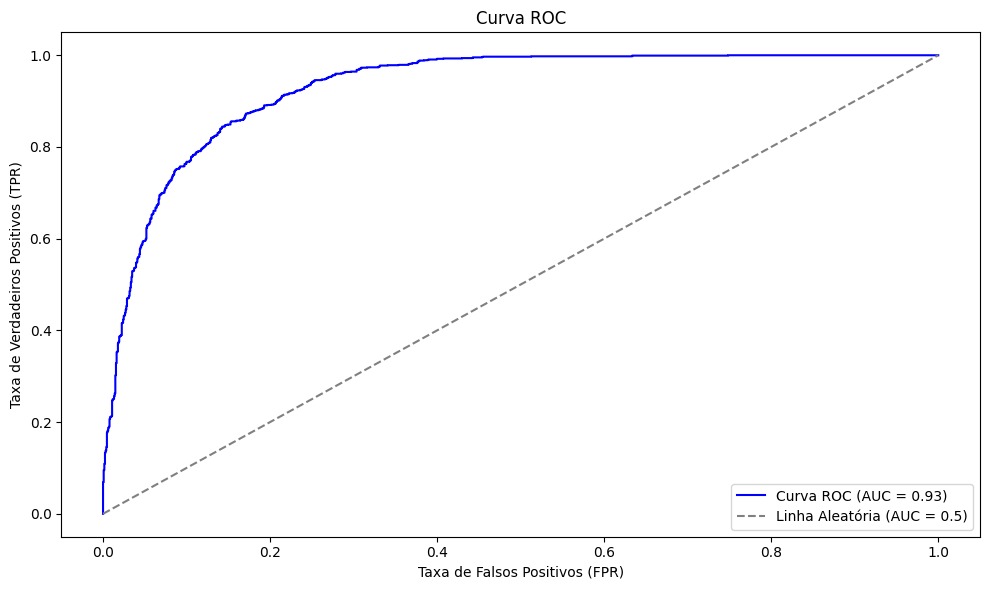

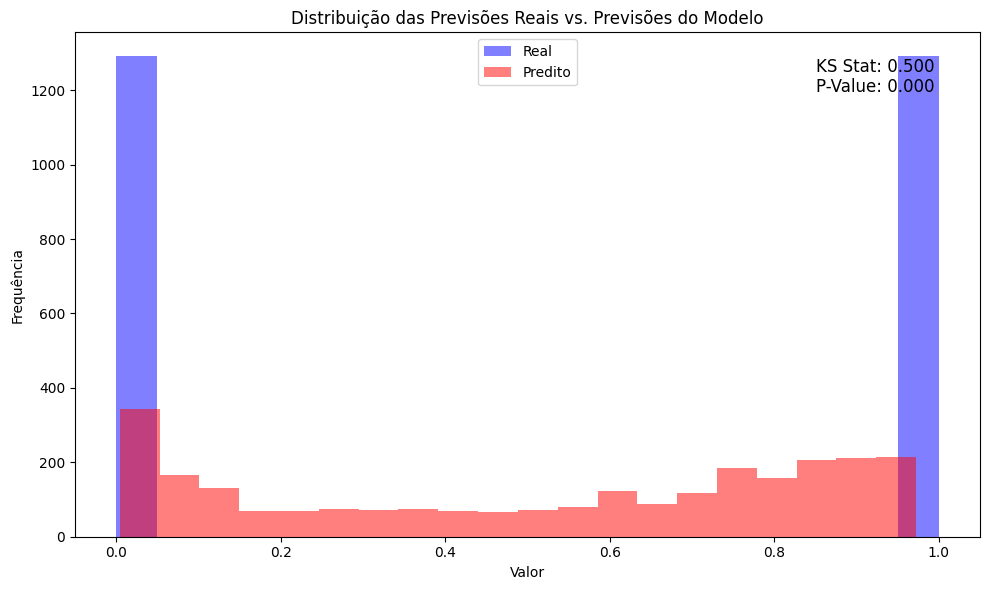

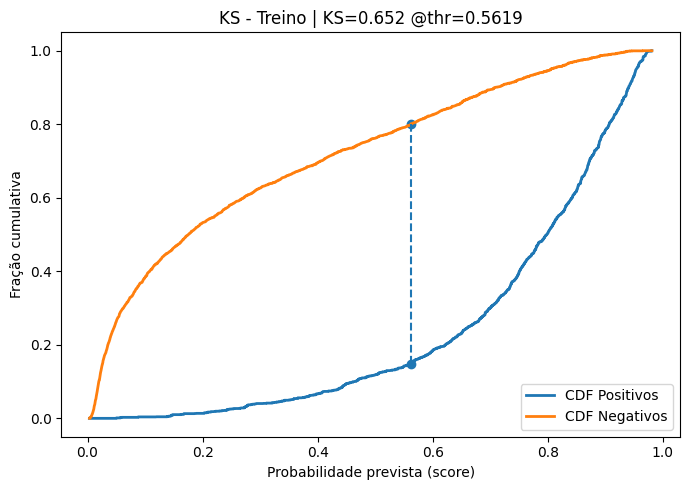

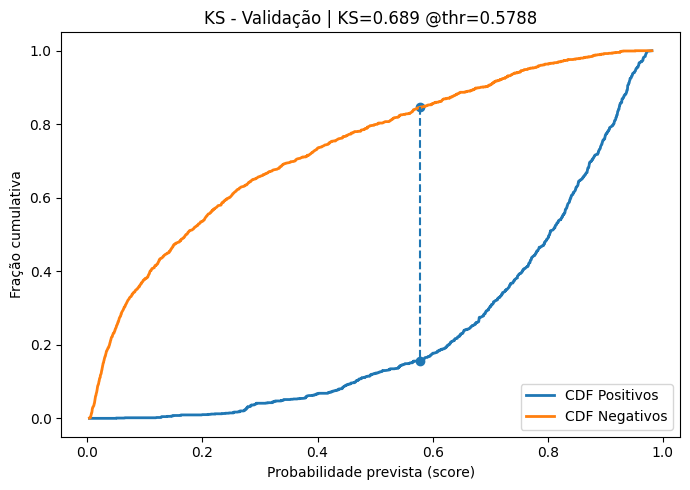

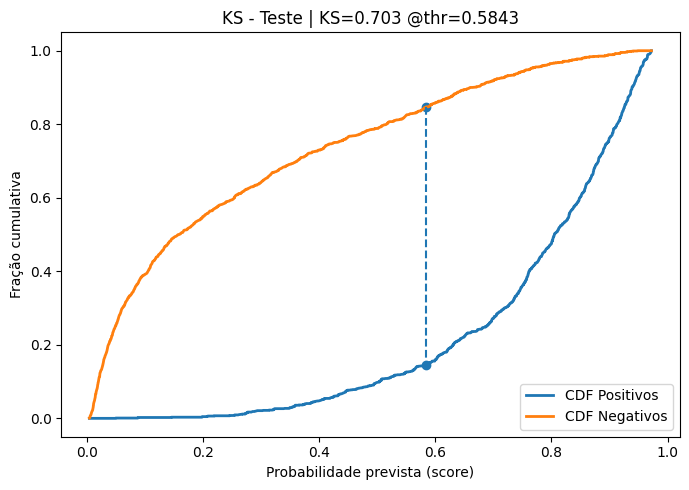

In [ ]:
model = joblib.load(GB2_PATH)
evaluate_model_trees(model, X_train_trees,
                        X_val_trees,
                        X_test_trees,
                        y_train_trees,
                        y_val_trees,
                        y_test_trees)



MSE Train: 0.24176675707090275
MSE Val: 0.23896204492641362
MSE Test: 0.21804802478698684




Cross-Entropy Train: 0.5037720408091036
Cross-Entropy Val: 0.5006936105901679
Cross-Entropy Test: 0.48289846316808216




Accuracy Train: 0.7582332429290972
Accuracy Val: 0.7610379550735864
Accuracy Test: 0.7819519752130132




Precision Train: 0.7238831037957676
Precision Val: 0.728629579375848
Precision Test: 0.7413793103448276




Recall Train: 0.8349476946919798
Recall Val: 0.8319132455460883
Recall Test: 0.8659953524399691




F1 Train: 0.7754587981288233
F1 Val: 0.7768535262206149
F1 Test: 0.7988567345480528




AUC Train: 0.8400641381201793
AUC Val: 0.8446325361601889
AUC Test: 0.8626377813150807




Confusion Matrix Train: 
[[1759  822]
 [ 426 2155]]
Confusion Matrix Val: 
[[ 891  400]
 [ 217 1074]]
Confusion Matrix Test: 
[[ 901  390]
 [ 173 1118]]






/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2732: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2732: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2732: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


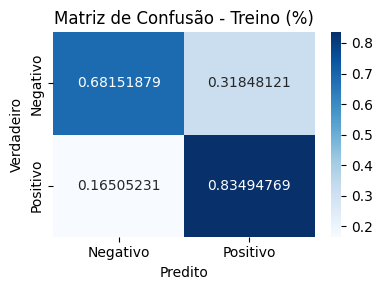

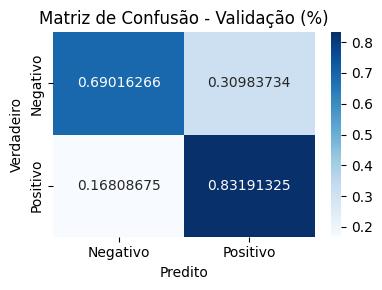

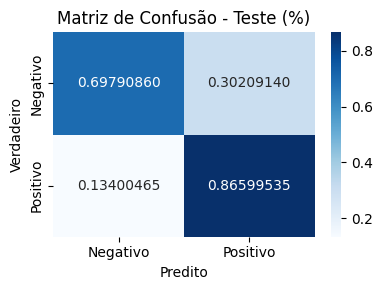

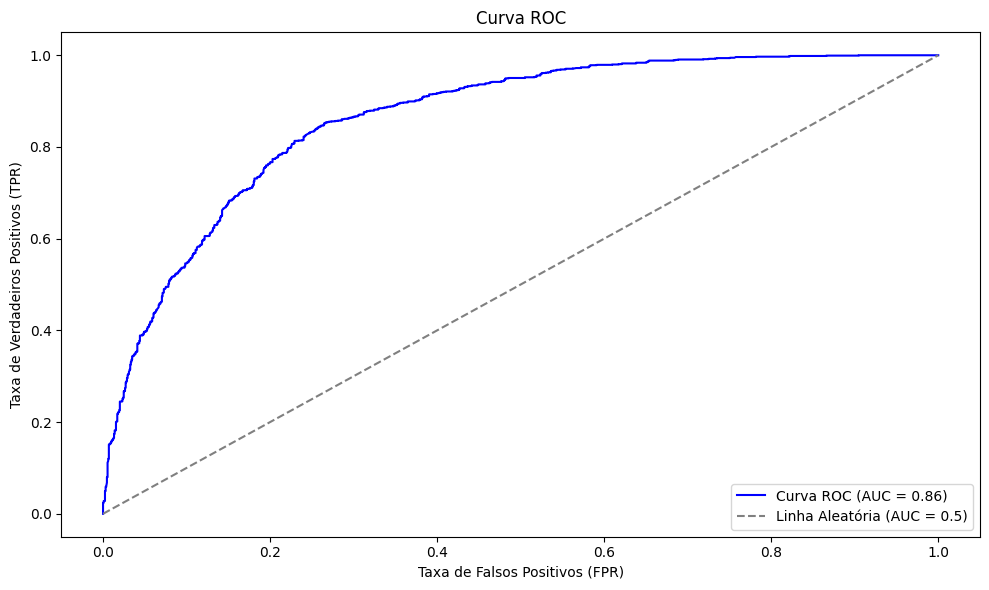

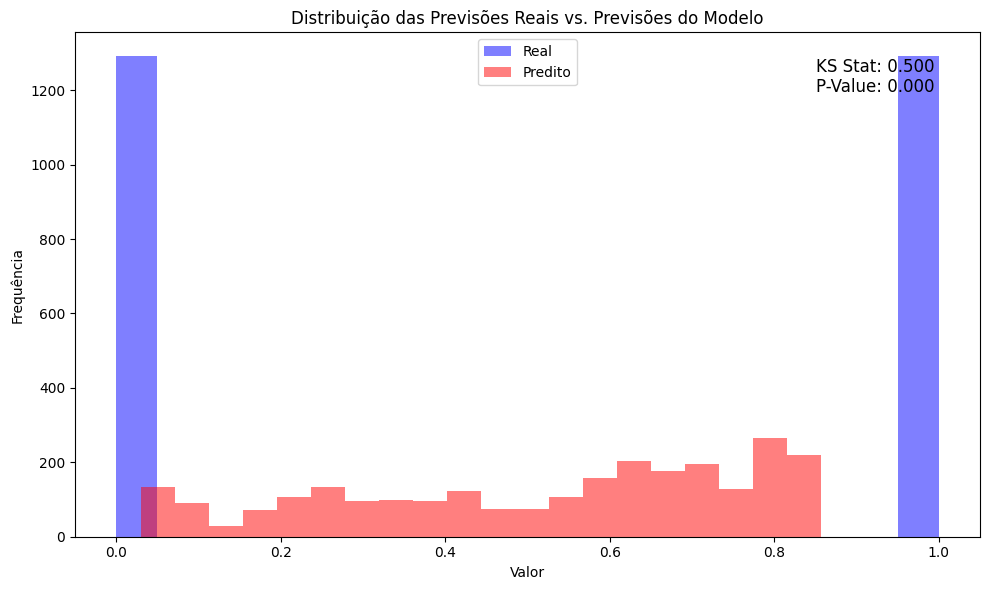

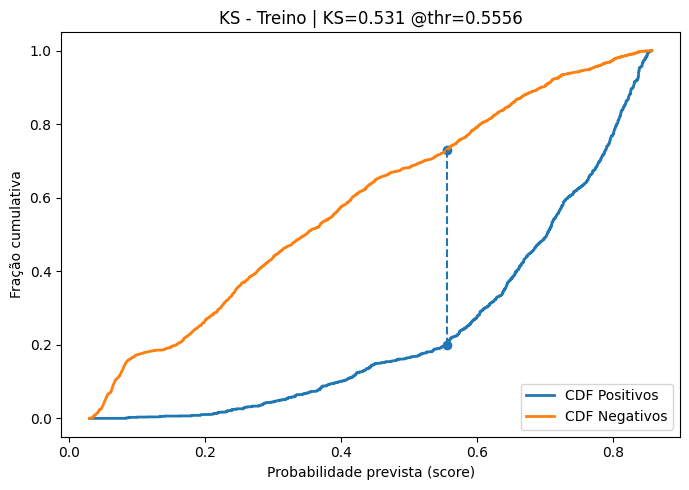

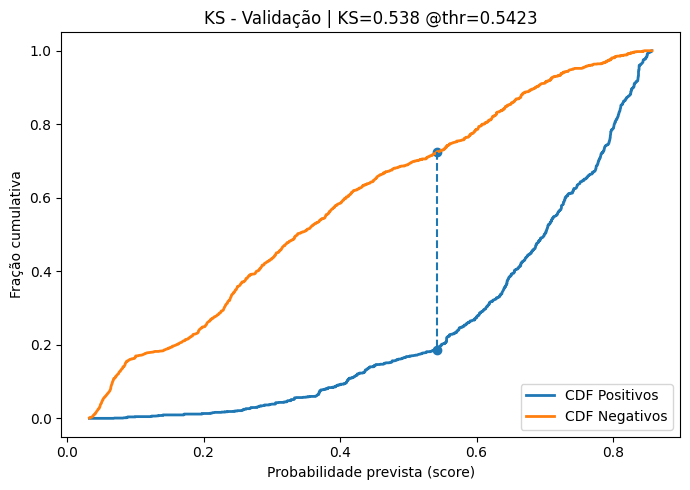

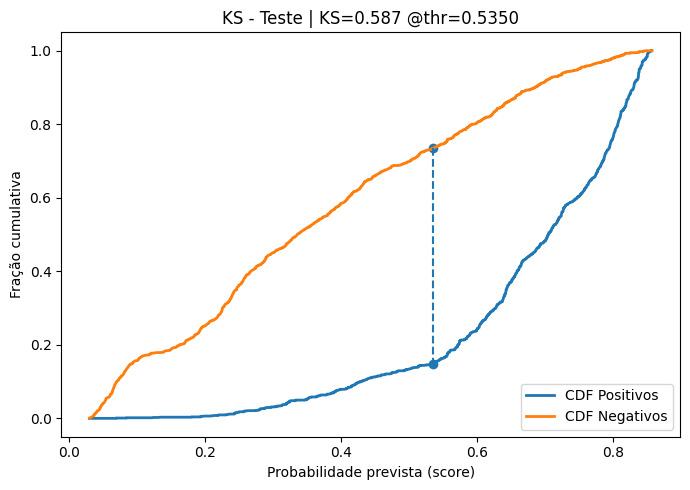

In [ ]:
model = joblib.load(RF1_PATH)
evaluate_model_trees(model, X_train_trees,
                        X_val_trees,
                        X_test_trees,
                        y_train_trees,
                        y_val_trees,
                        y_test_trees)



MSE Train: 0.2413793103448276
MSE Val: 0.23741285824941905
MSE Test: 0.21727343144848954




Cross-Entropy Train: 0.5038656266983689
Cross-Entropy Val: 0.5011564843041063
Cross-Entropy Test: 0.48308422478128554




Accuracy Train: 0.7586206896551724
Accuracy Val: 0.762587141750581
Accuracy Test: 0.7827265685515105




Precision Train: 0.7260413139180495
Precision Val: 0.7318741450068399
Precision Test: 0.7446380697050938




Recall Train: 0.8306857807051531
Recall Val: 0.8288148721920992
Recall Test: 0.860573199070488




F1 Train: 0.7748464040477051
F1 Val: 0.777333817653469
F1 Test: 0.7984189723320159




AUC Train: 0.8403013948232253
AUC Val: 0.8444006381545118
AUC Test: 0.8628675793388177




Confusion Matrix Train: 
[[1772  809]
 [ 437 2144]]
Confusion Matrix Val: 
[[ 899  392]
 [ 221 1070]]
Confusion Matrix Test: 
[[ 910  381]
 [ 180 1111]]






/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2732: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2732: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2732: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


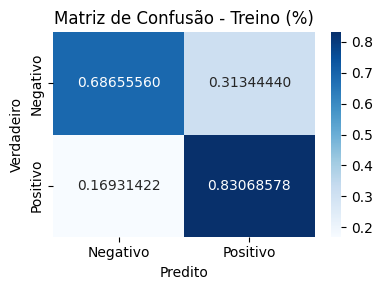

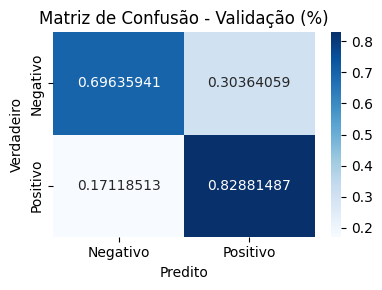

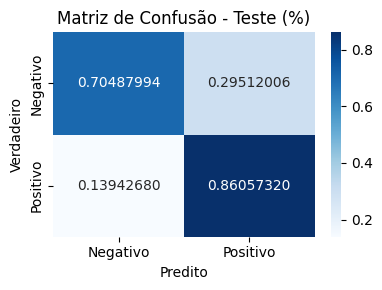

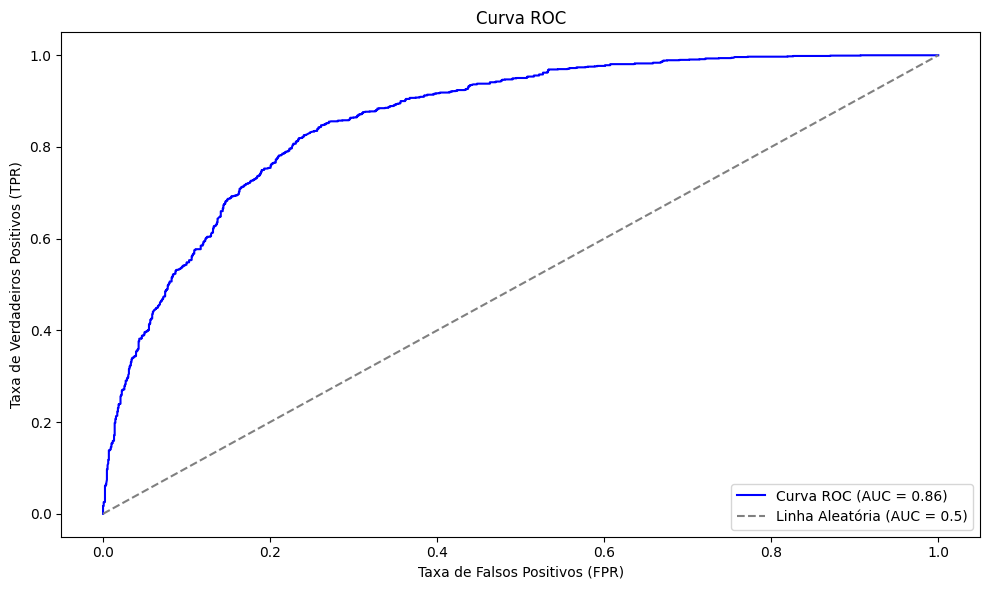

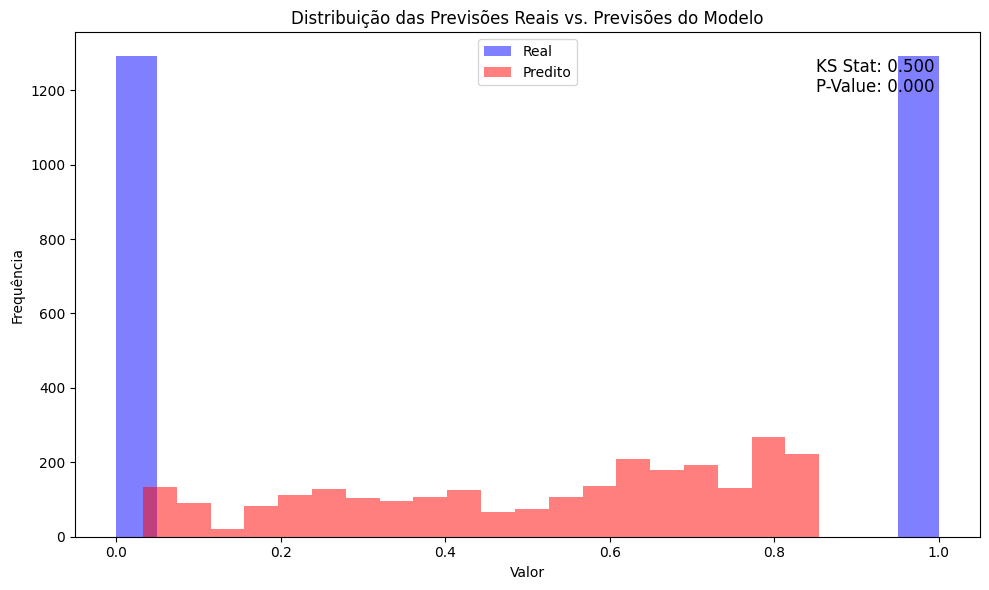

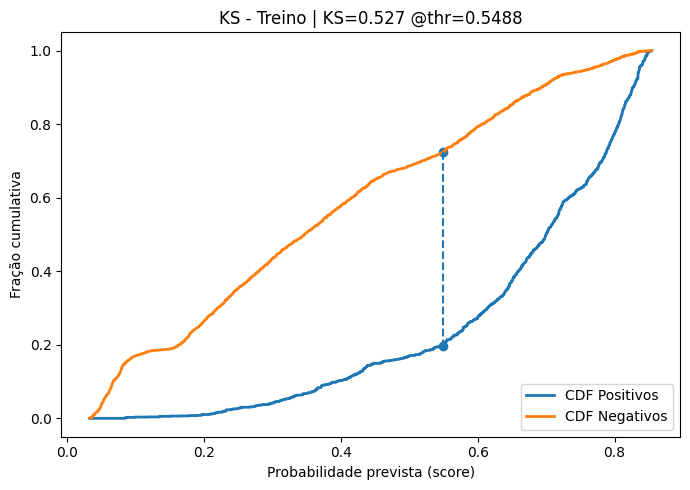

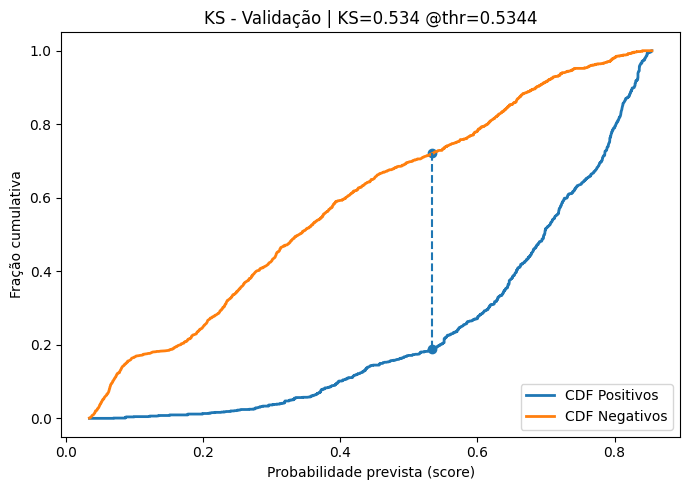

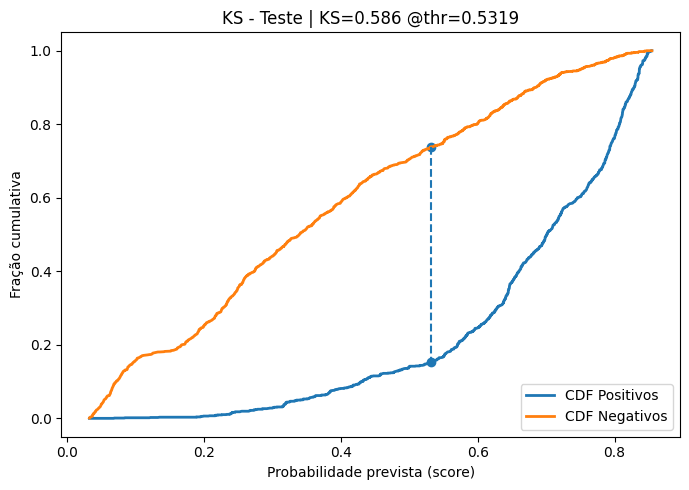

In [ ]:
model = joblib.load(RF2_PATH)
evaluate_model_trees(model, X_train_trees,
                        X_val_trees,
                        X_test_trees,
                        y_train_trees,
                        y_val_trees,
                        y_test_trees)



MSE Train: 0.10228593568384348
MSE Val: 0.06622773044151821
MSE Test: 0.07358636715724244




Cross-Entropy Train: 0.293344363498021
Cross-Entropy Val: 0.23149183412787114
Cross-Entropy Test: 0.22901547673967196




Accuracy Train: 0.8977140643161565
Accuracy Val: 0.9337722695584818
Accuracy Test: 0.9264136328427576




Precision Train: 0.8543320676561961
Precision Val: 0.9040404040404041
Precision Test: 0.8957584471603163




Recall Train: 0.9589306470360326
Recall Val: 0.9705654531371031
Recall Test: 0.965143299767622




F1 Train: 0.9036144578313253
F1 Val: 0.9361225252147927
F1 Test: 0.9291573452647278




AUC Train: 0.9451092619282477
AUC Val: 0.9781391880029833
AUC Test: 0.9773723945974064




Confusion Matrix Train: 
[[2159  422]
 [ 106 2475]]
Confusion Matrix Val: 
[[1158  133]
 [  38 1253]]
Confusion Matrix Test: 
[[1146  145]
 [  45 1246]]






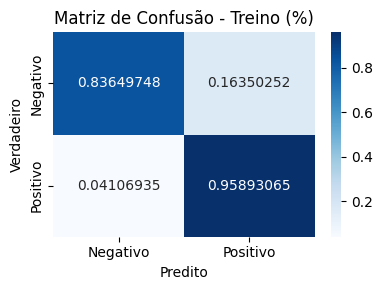

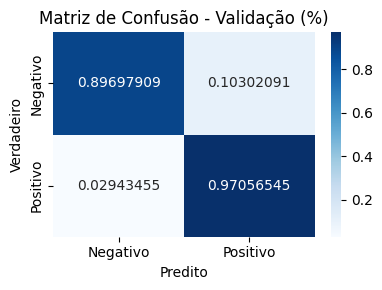

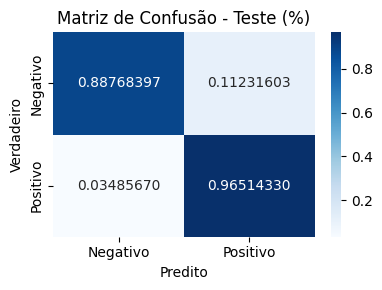

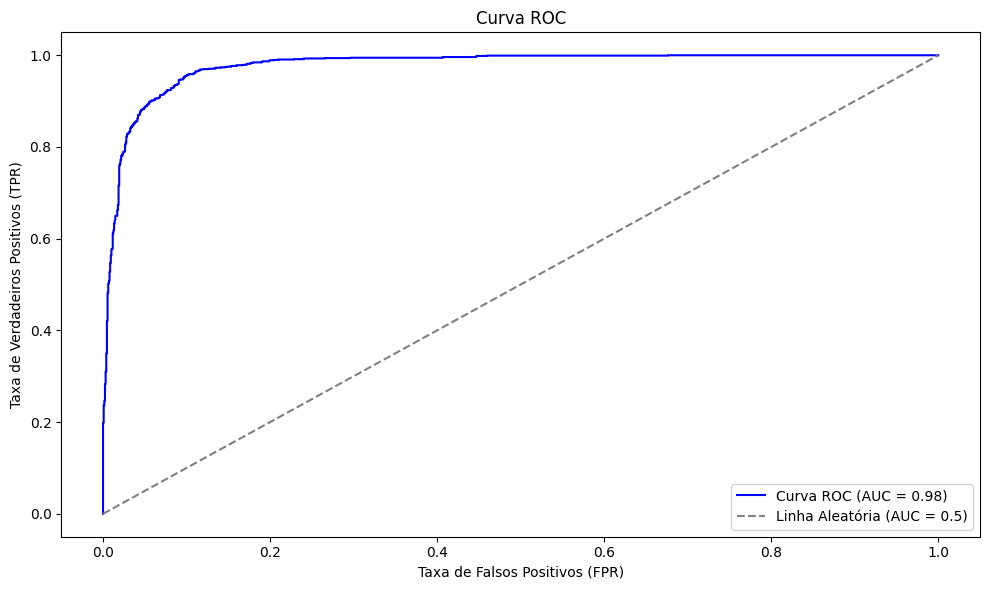

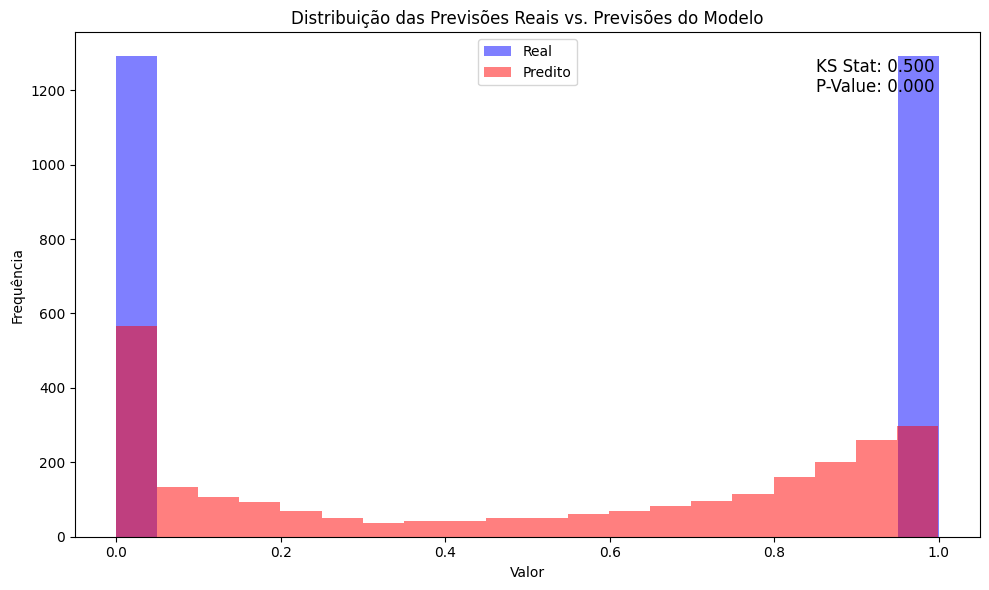

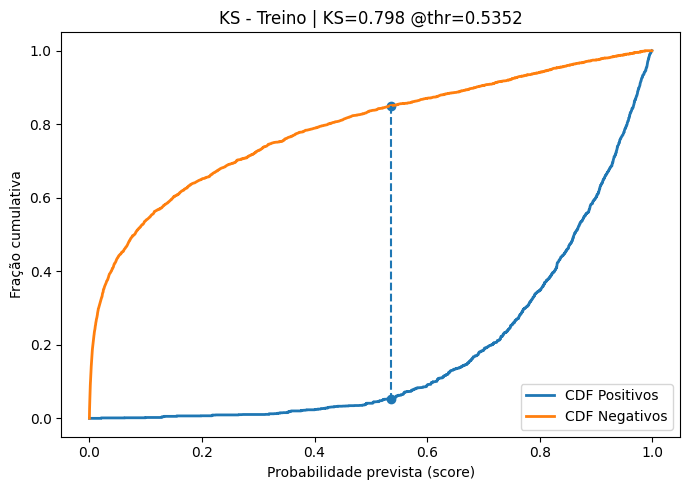

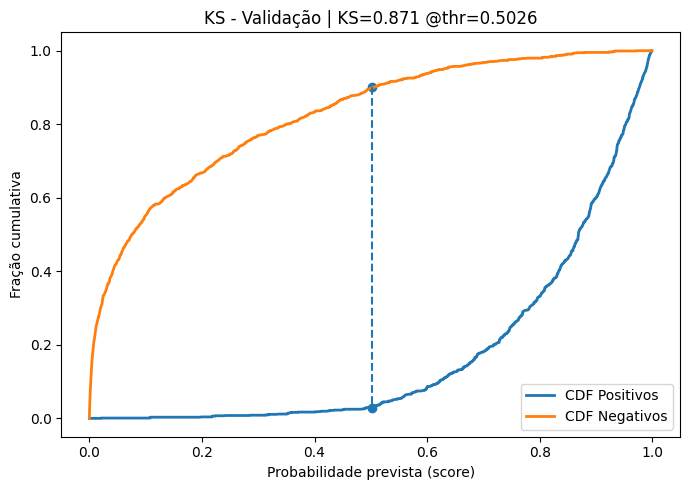

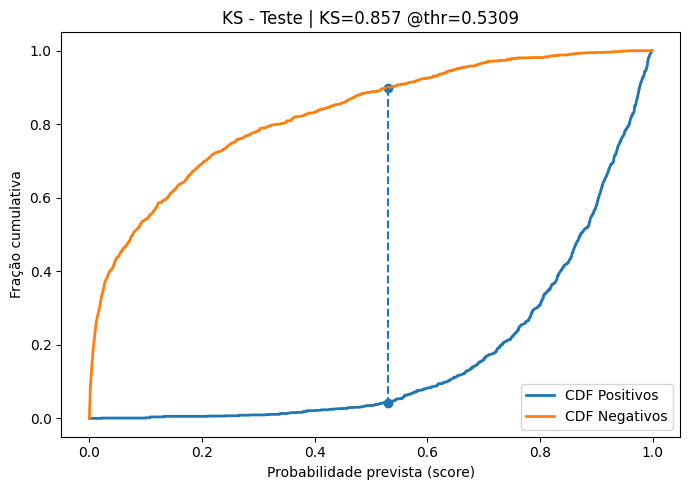

In [ ]:
model = joblib.load(XGB1_PATH)
evaluate_model_trees(model, X_train_trees,
                        X_val_trees,
                        X_test_trees,
                        y_train_trees,
                        y_val_trees,
                        y_test_trees)



MSE Train: 0.08620689655172414
MSE Val: 0.046475600309837335
MSE Test: 0.054221533694810226




Cross-Entropy Train: 0.2534789615323564
Cross-Entropy Val: 0.1922411299025634
Cross-Entropy Test: 0.1863770763945763




Accuracy Train: 0.9137931034482759
Accuracy Val: 0.9535243996901627
Accuracy Test: 0.9457784663051898




Precision Train: 0.8723849372384938
Precision Val: 0.9353159851301115
Precision Test: 0.9222303741746148




Recall Train: 0.969391708640062
Recall Val: 0.9744384198295895
Recall Test: 0.9736638264910922




F1 Train: 0.9183336391998532
F1 Val: 0.9544764795144158
F1 Test: 0.947249434815373




AUC Train: 0.9602340952818716
AUC Val: 0.9871055108926063
AUC Test: 0.9877679051960152




Confusion Matrix Train: 
[[2215  366]
 [  79 2502]]
Confusion Matrix Val: 
[[1204   87]
 [  33 1258]]
Confusion Matrix Test: 
[[1185  106]
 [  34 1257]]






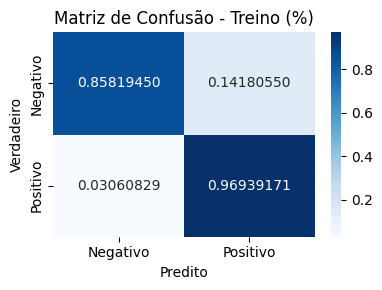

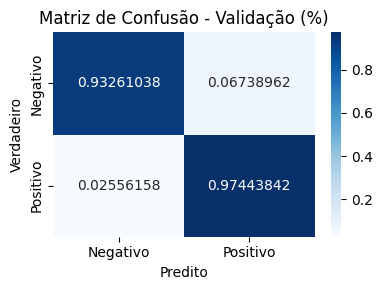

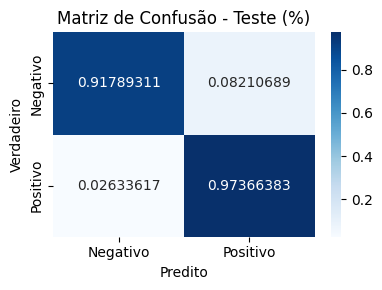

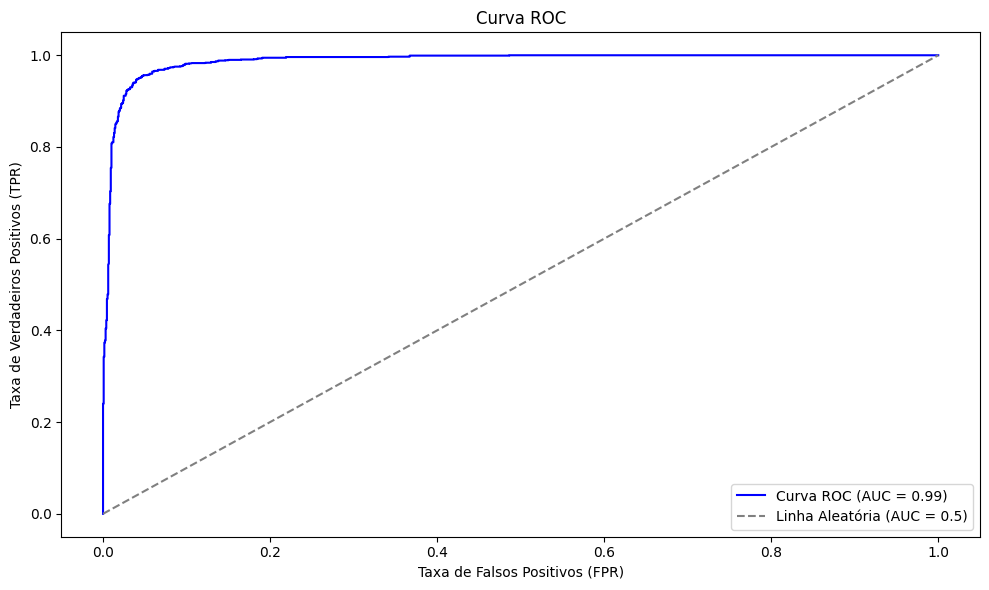

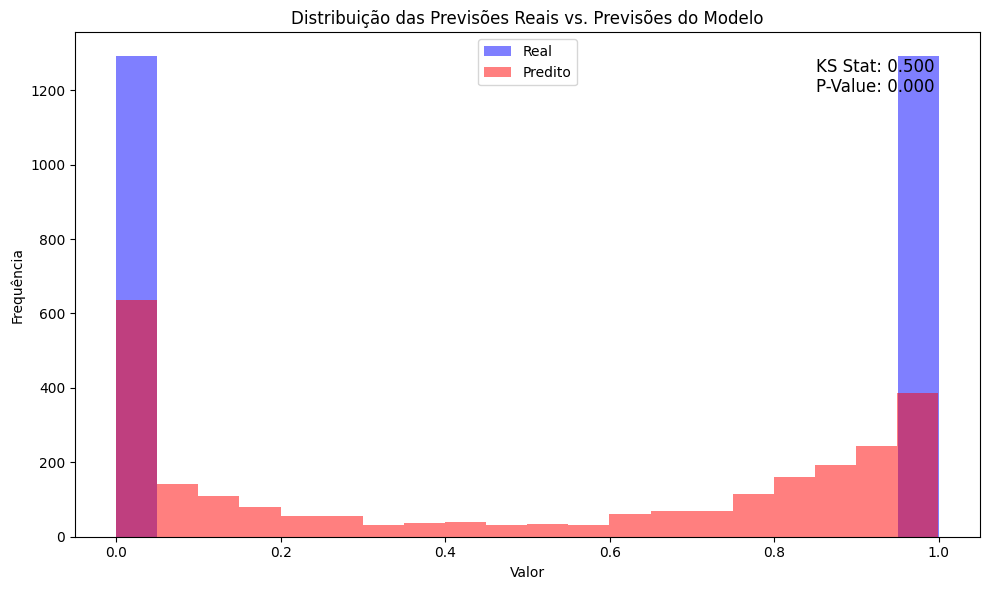

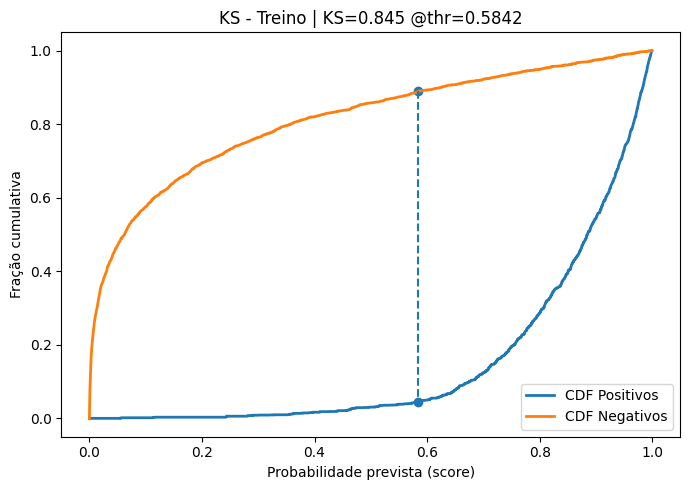

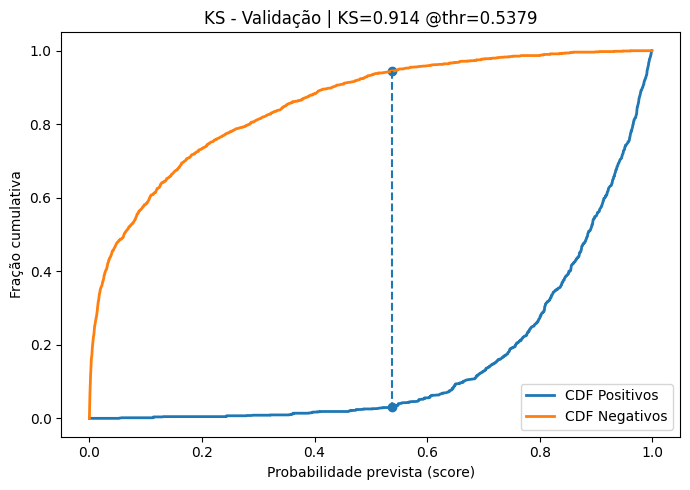

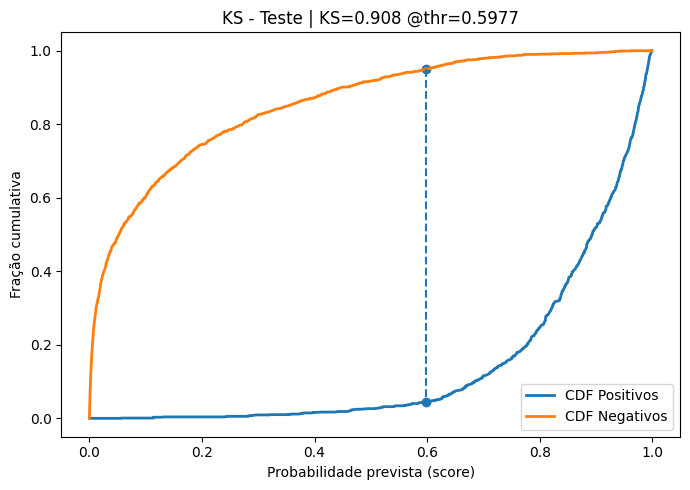

In [ ]:
model = joblib.load(XGB2_PATH)
evaluate_model_trees(model, X_train_trees,
                        X_val_trees,
                        X_test_trees,
                        y_train_trees,
                        y_val_trees,
                        y_test_trees)

###NNs

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


MSE Train: 0.24060441553592682
MSE Val: 0.23160341382026672
MSE Test: 0.2075910121202469




Cross-Entropy Train: 0.48238741082630066
Cross-Entropy Val: 0.47719054344531786
Cross-Entropy Test: 0.44879208770889006




Accuracy Train: 0.7593955831073227
Accuracy Val: 0.7683965917893106
Accuracy Test: 0.7924089852827265




Precision Train: 0.7340090877315624
Precision Val: 0.7452229299363057
Precision Test: 0.761970853573907




Recall Train: 0.8136381247578458
Recall Val: 0.8156467854376452
Recall Test: 0.8505034856700232




F1 Train: 0.7717750826901875
F1 Val: 0.7788461538461539
F1 Test: 0.8038067349926794




AUC Train: 0.8469801597553487
AUC Val: 0.8497648920219286
AUC Test: 0.86965832093844




Confusion Matrix Train: 
[[1820  761]
 [ 481 2100]]
Confusion Matrix Val: 
[[ 931  360]
 [ 238 1053]]
Confusion Matrix Test: 
[[ 948  343]
 [ 193 1098]]






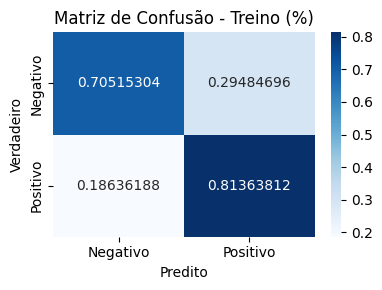

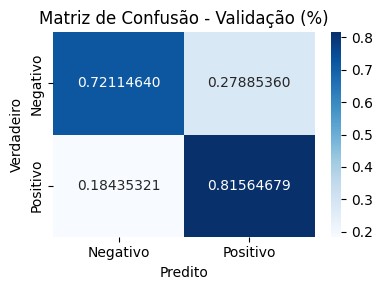

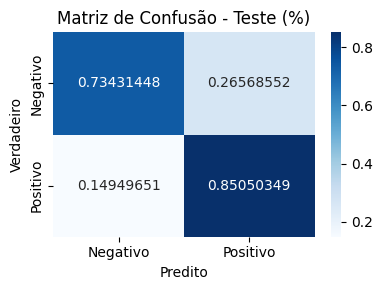

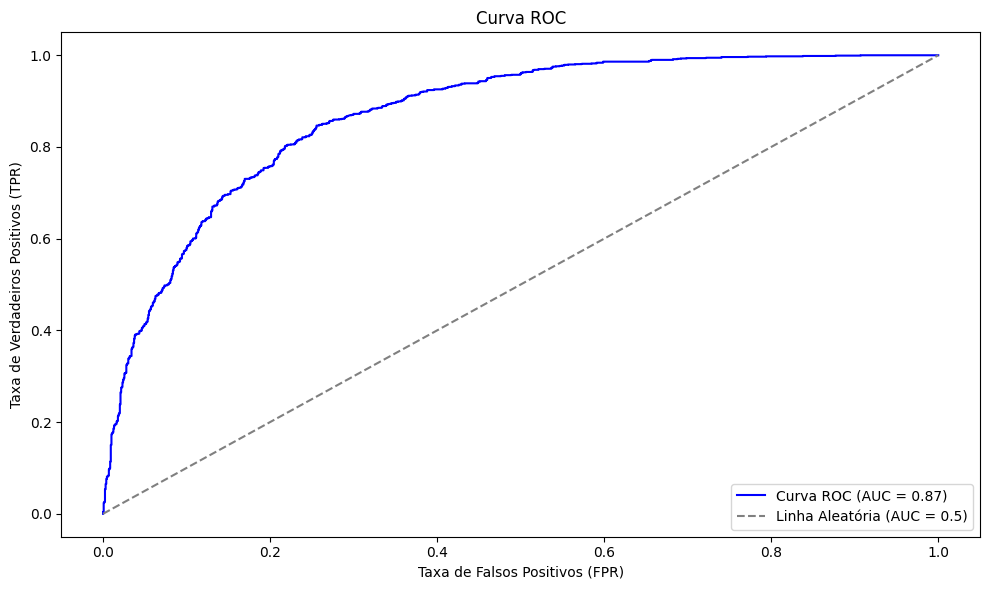

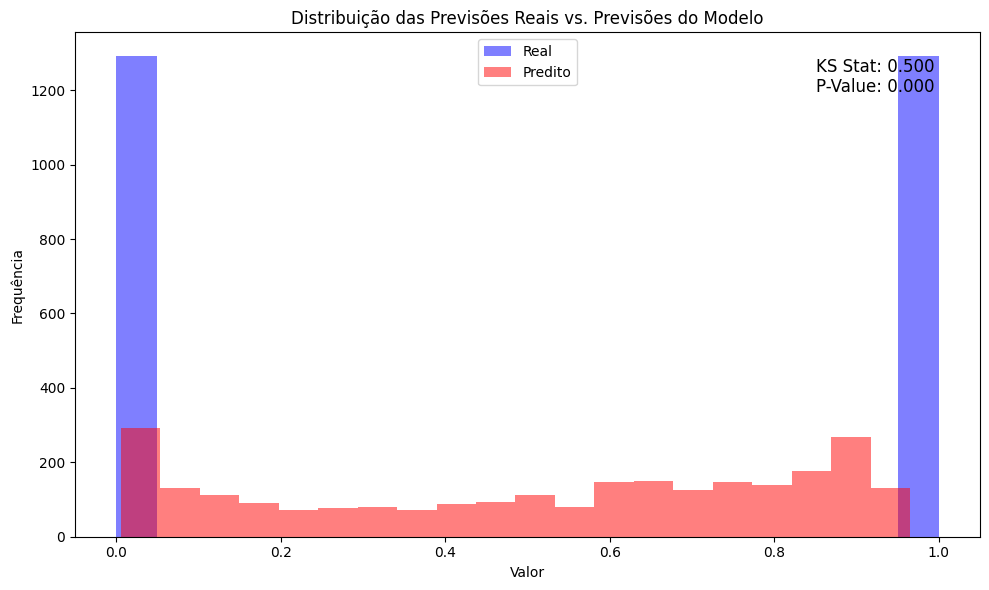

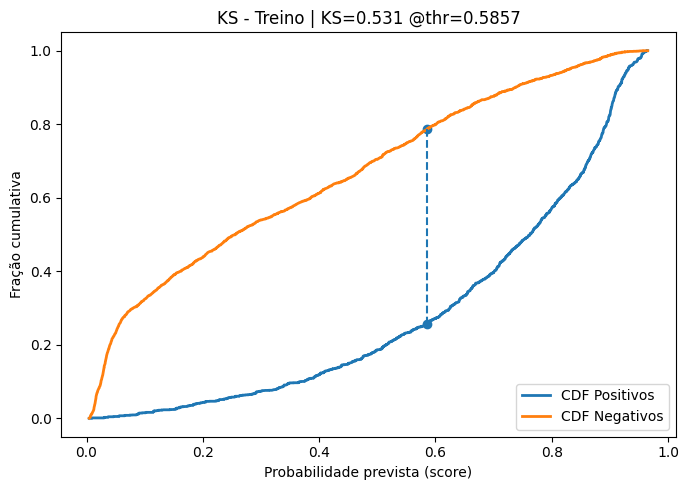

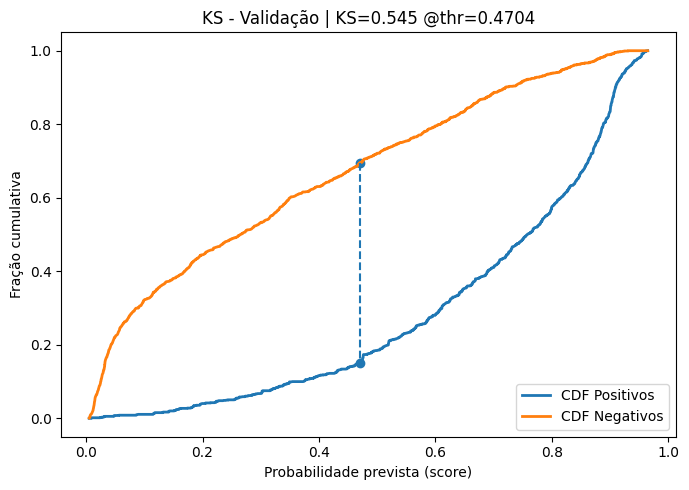

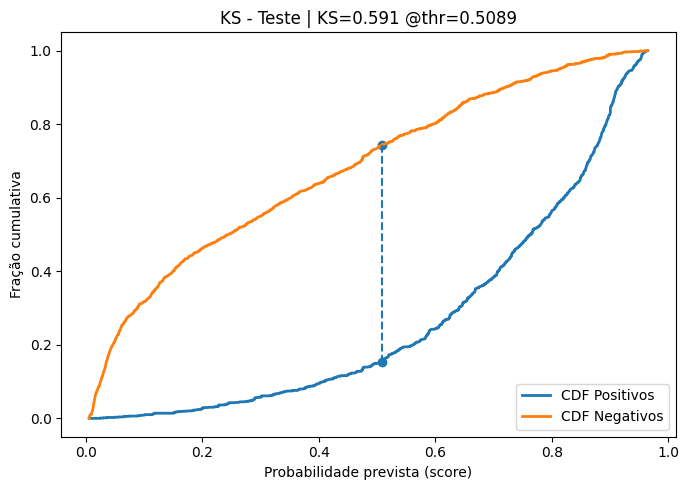

In [ ]:
model = load_model(NN1_PATH) #para arquivos .h5 load_model($PATH)
evaluate_model_keras(model, X_train_nn.astype("float32"),
                        X_val_nn.astype("float32"),
                        X_test_nn.astype("float32"),
                        np.asarray(y_train_nn).reshape(-1,1).astype("float32"),
                        np.asarray(y_val_nn  ).reshape(-1,1).astype("float32"),
                        np.asarray(y_test_nn ).reshape(-1,1).astype("float32"))

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


MSE Train: 0.2222006916999817
MSE Val: 0.2195972055196762
MSE Test: 0.19054995477199554




Cross-Entropy Train: 0.46196967521892673
Cross-Entropy Val: 0.4533284250592572
Cross-Entropy Test: 0.42008509351111295




Accuracy Train: 0.777799302595893
Accuracy Val: 0.7804027885360186
Accuracy Test: 0.8094500387296669




Precision Train: 0.7452120383036935
Precision Val: 0.7527932960893855
Precision Test: 0.7753273604410751




Recall Train: 0.8442464161177838
Recall Val: 0.8350116189000775
Recall Test: 0.87141750580945




F1 Train: 0.7916439600363306
F1 Val: 0.7917737789203085
F1 Test: 0.8205689277899344




AUC Train: 0.8612363528608384
AUC Val: 0.8635827731881507
AUC Test: 0.8881180621846653




Confusion Matrix Train: 
[[1836  745]
 [ 402 2179]]
Confusion Matrix Val: 
[[ 937  354]
 [ 213 1078]]
Confusion Matrix Test: 
[[ 965  326]
 [ 166 1125]]






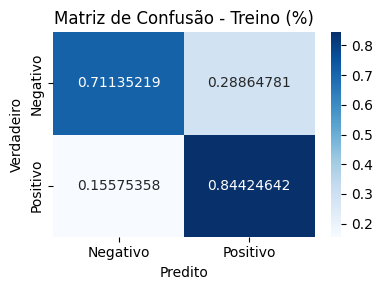

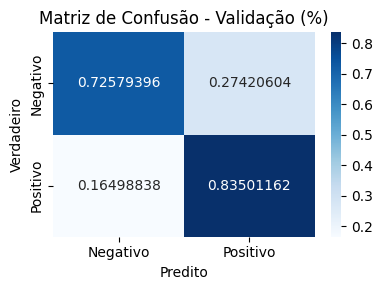

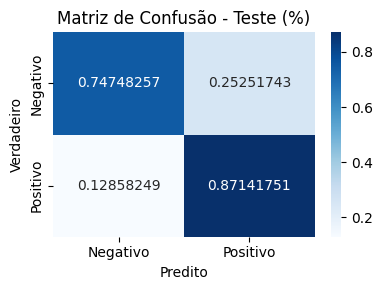

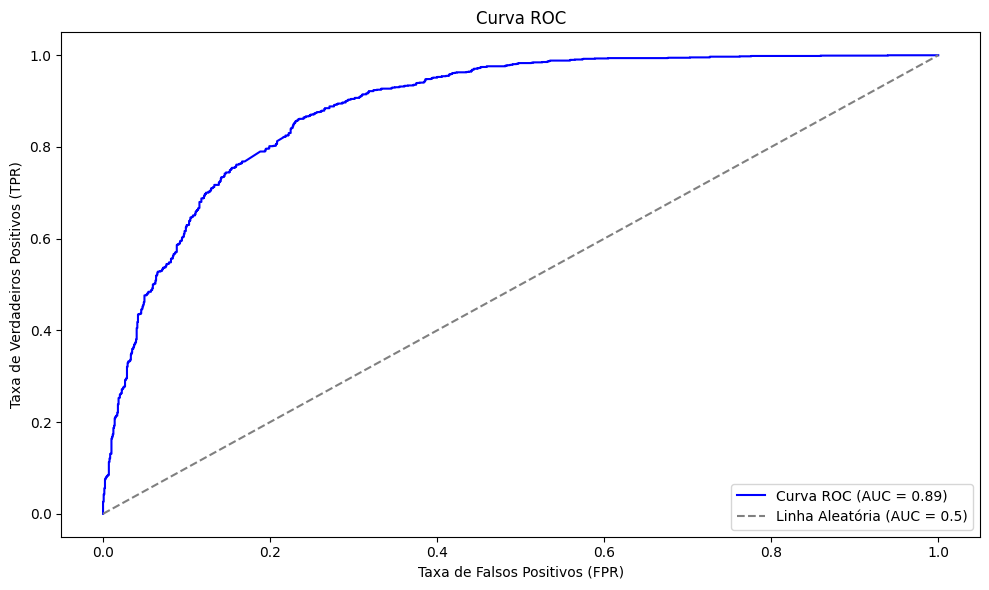

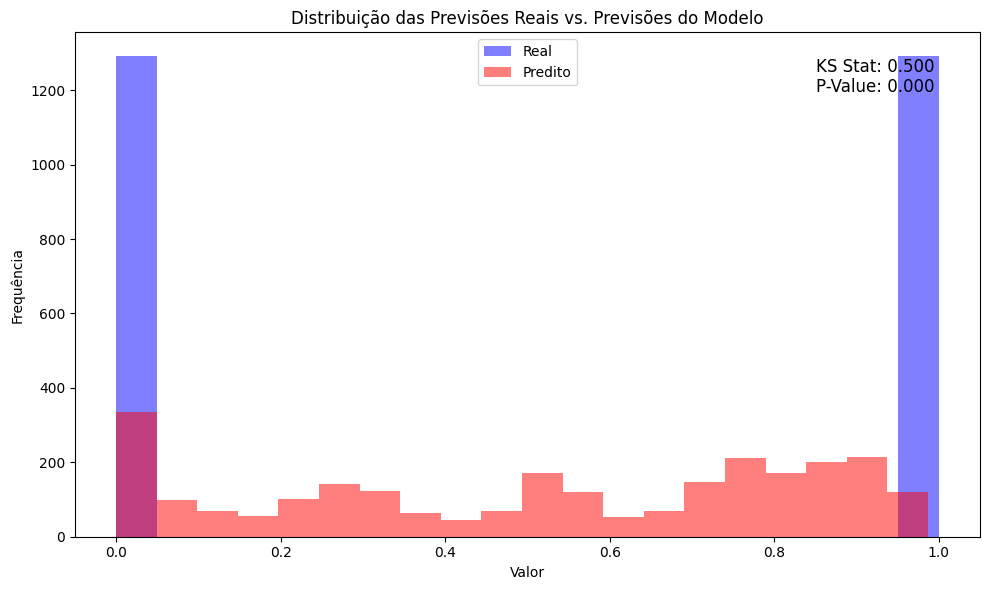

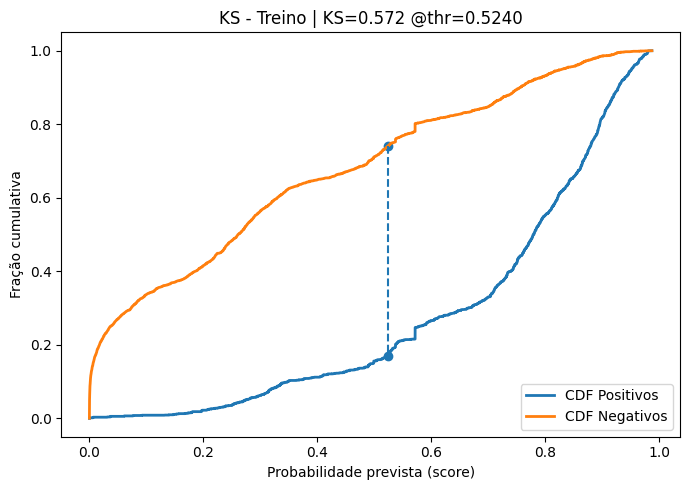

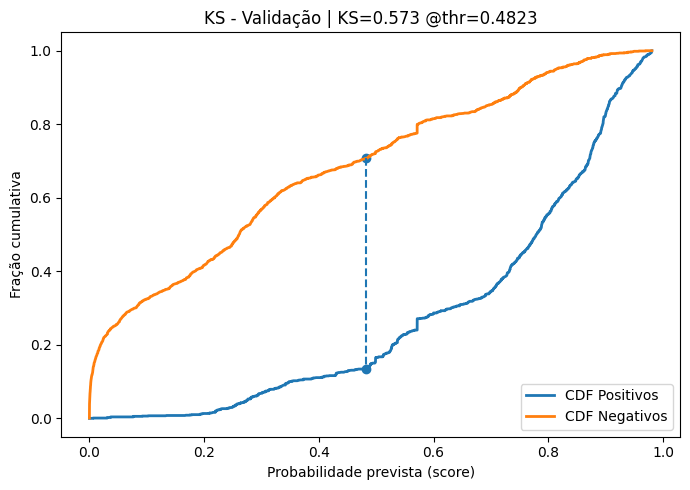

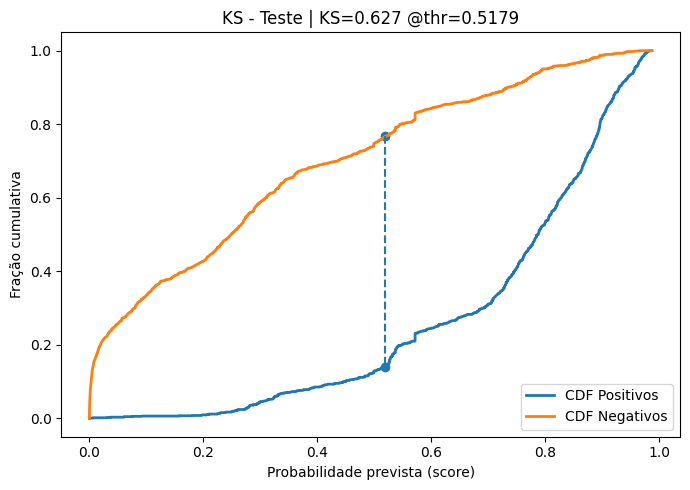

In [ ]:
model = load_model(NN2_PATH) #para arquivos .h5 load_model($PATH)
evaluate_model_keras(model, X_train_nn.astype("float32"),
                        X_val_nn.astype("float32"),
                        X_test_nn.astype("float32"),
                        np.asarray(y_train_nn).reshape(-1,1).astype("float32"),
                        np.asarray(y_val_nn  ).reshape(-1,1).astype("float32"),
                        np.asarray(y_test_nn ).reshape(-1,1).astype("float32"))

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


MSE Train: 0.24680356681346893
MSE Val: 0.24825716018676758
MSE Test: 0.22192099690437317




Cross-Entropy Train: 0.4987457231366531
Cross-Entropy Val: 0.498912995486127
Cross-Entropy Test: 0.470305030882322




Accuracy Train: 0.75319643549012
Accuracy Val: 0.7517428350116189
Accuracy Test: 0.7780790085205267




Precision Train: 0.7103315094946894
Precision Val: 0.7102199223803364
Precision Test: 0.730719794344473




Recall Train: 0.8550949244478884
Recall Val: 0.8505034856700232
Recall Test: 0.8807126258714175




F1 Train: 0.7760196905766527
F1 Val: 0.7740571025731406
F1 Test: 0.7987355110642782




AUC Train: 0.8397768931336065
AUC Val: 0.8409839675378792
AUC Test: 0.8640348693001241




Confusion Matrix Train: 
[[1681  900]
 [ 374 2207]]
Confusion Matrix Val: 
[[ 843  448]
 [ 193 1098]]
Confusion Matrix Test: 
[[ 872  419]
 [ 154 1137]]






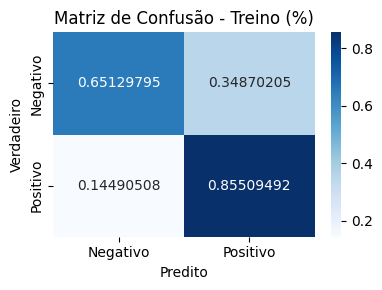

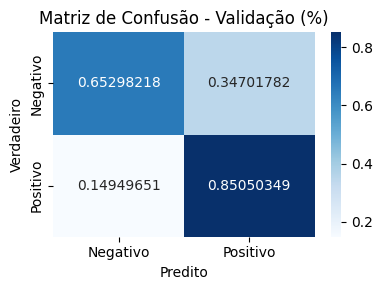

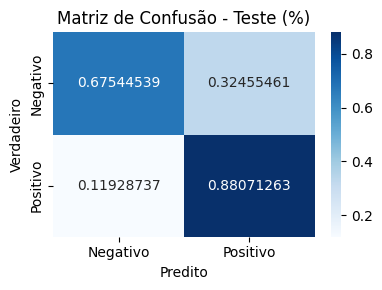

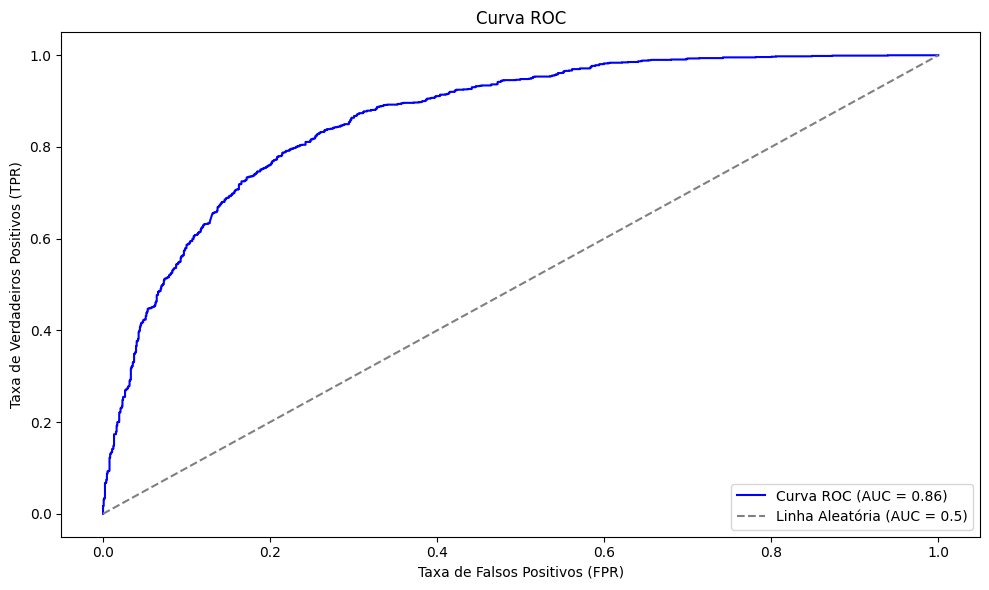

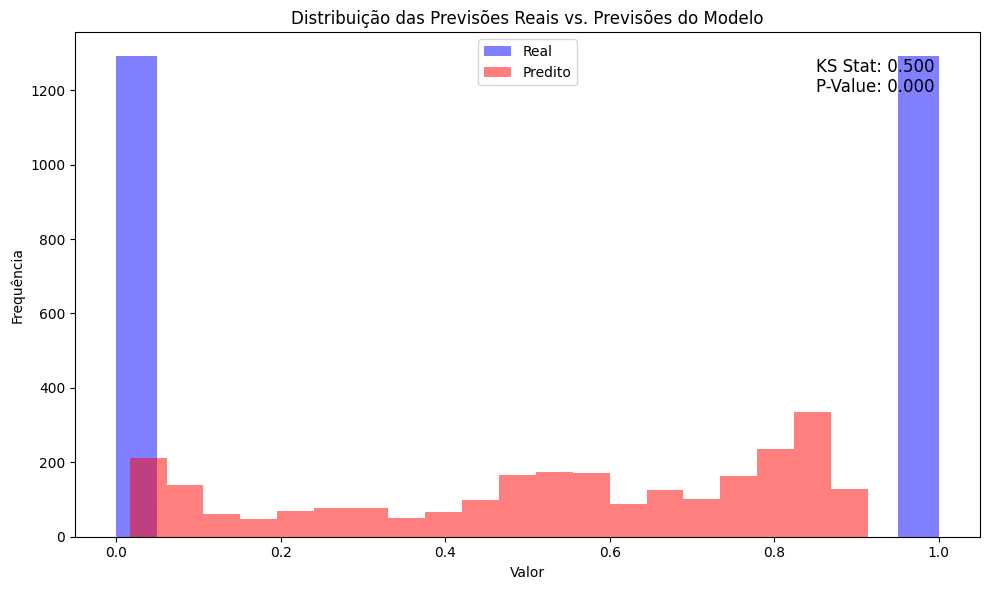

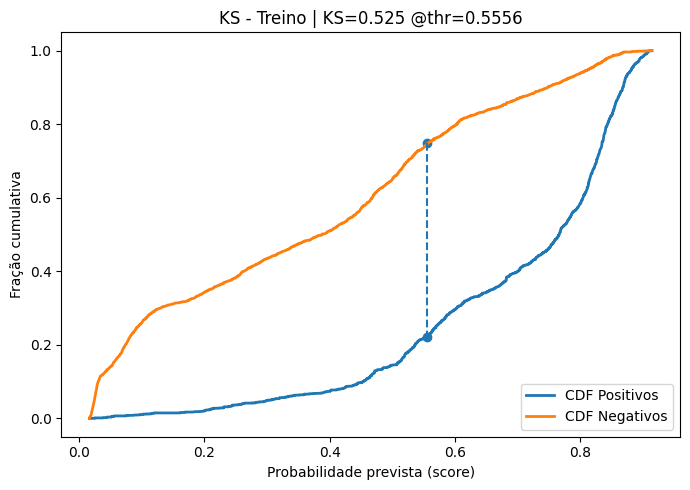

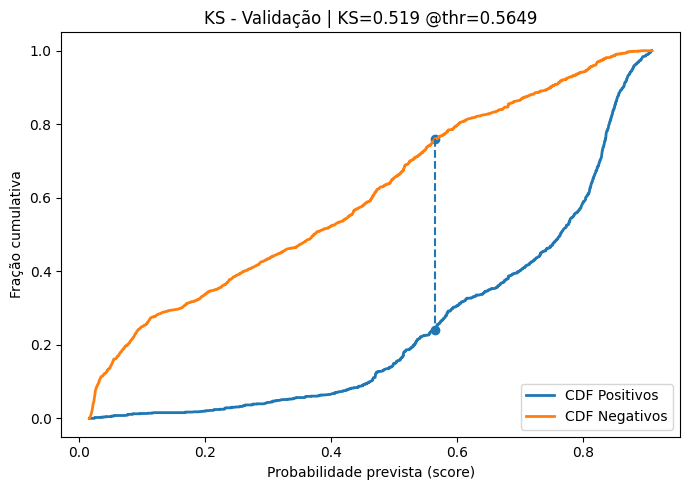

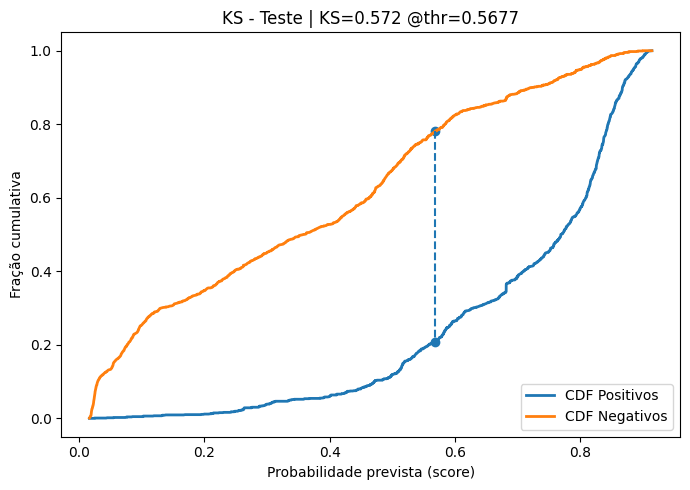

In [ ]:
model = load_model(NN3_PATH) #para arquivos .h5 load_model($PATH)
evaluate_model_keras(model, X_train_nn.astype("float32"),
                        X_val_nn.astype("float32"),
                        X_test_nn.astype("float32"),
                        np.asarray(y_train_nn).reshape(-1,1).astype("float32"),
                        np.asarray(y_val_nn  ).reshape(-1,1).astype("float32"),
                        np.asarray(y_test_nn ).reshape(-1,1).astype("float32"))

###TAB



MSE Train: 0.03777605579232855
MSE Val: 0.13206816421378775
MSE Test: 0.12354763749031758




Cross-Entropy Train: 0.13861784613787345
Cross-Entropy Val: 0.33439135472107034
Cross-Entropy Test: 0.3018135331070751




Accuracy Train: 0.9622239442076714
Accuracy Val: 0.8679318357862122
Accuracy Test: 0.8764523625096824




Precision Train: 0.9454817027632562
Precision Val: 0.8528974739970282
Precision Test: 0.8542274052478134




Recall Train: 0.9810151104223169
Recall Val: 0.8892331525948877
Recall Test: 0.9078233927188226




F1 Train: 0.9629207073588134
F1 Val: 0.8706863860447478
F1 Test: 0.8802102891475779




AUC Train: 0.9948781524330409
AUC Val: 0.9342906651002802
AUC Test: 0.946361061294873




Confusion Matrix Train: 
[[2435  146]
 [  49 2532]]
Confusion Matrix Val: 
[[1093  198]
 [ 143 1148]]
Confusion Matrix Test: 
[[1091  200]
 [ 119 1172]]






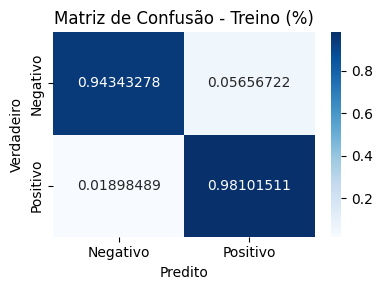

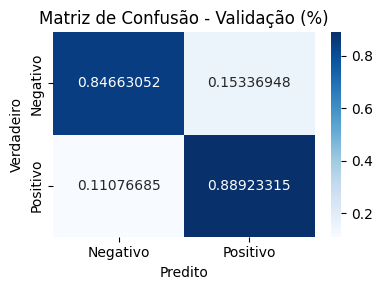

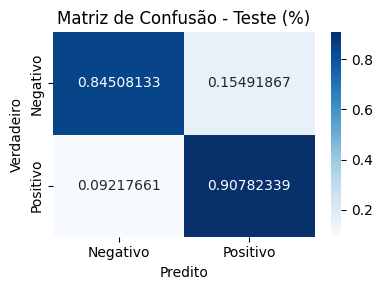

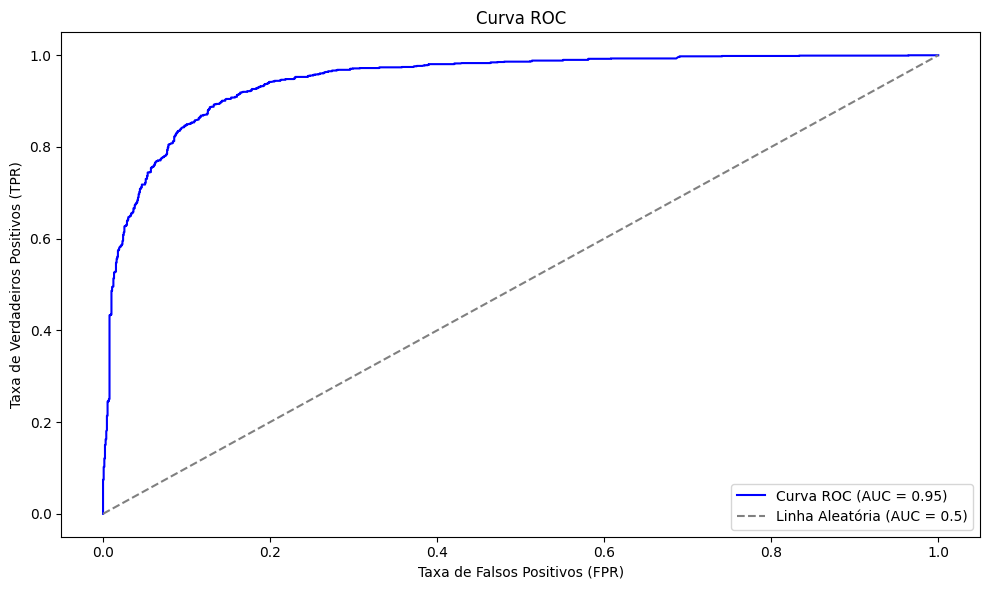

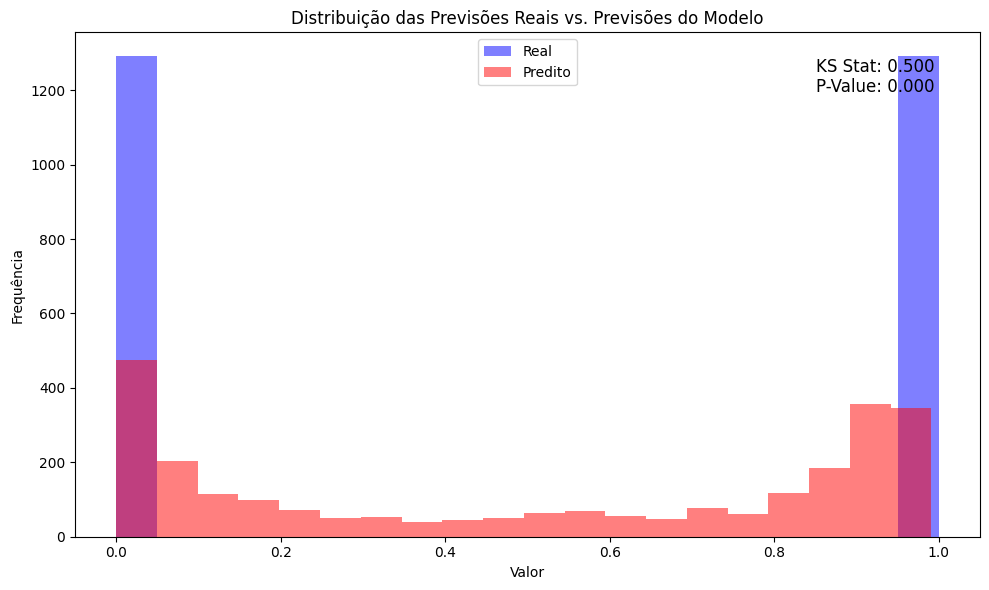

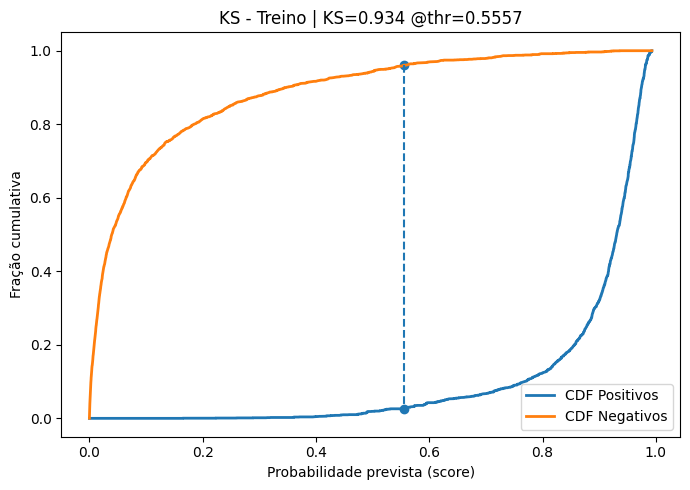

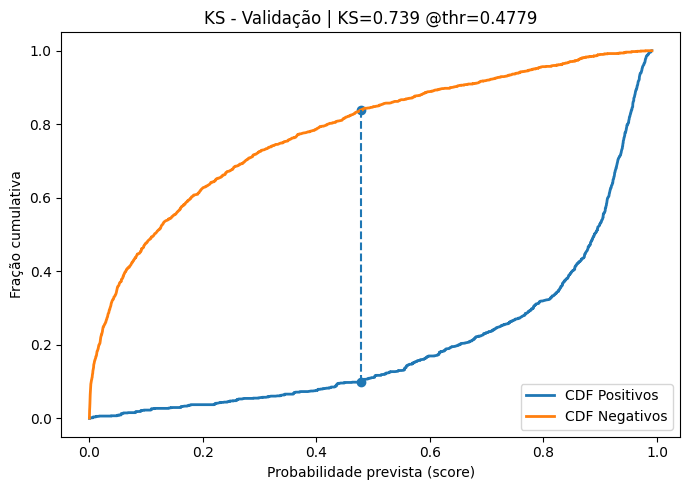

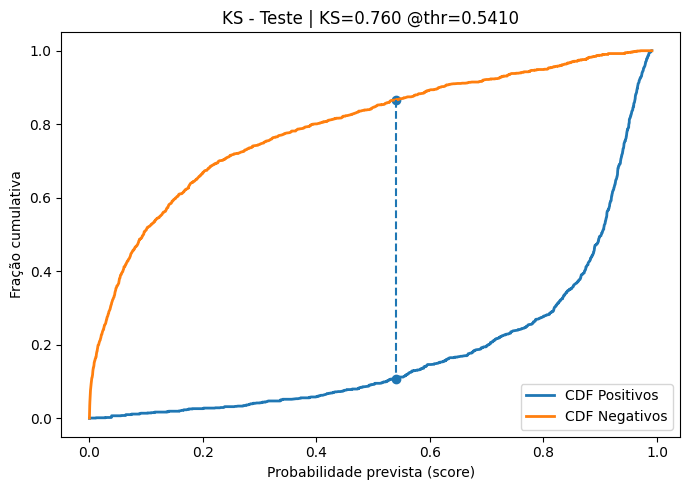

In [ ]:
model = joblib.load(TAB_PATH)
evaluate_model_trees(model, X_train_nn,
                        X_val_nn,
                        X_test_nn,
                        y_train_nn,
                        y_val_nn,
                        y_test_nn)

###STAB



MSE Train: 0.1524602867105773
MSE Val: 0.13787761425251743
MSE Test: 0.12161115414407436




Cross-Entropy Train: 0.40753793599478816
Cross-Entropy Val: 0.34703968417734915
Cross-Entropy Test: 0.2958793110152022




Accuracy Train: 0.8475397132894227
Accuracy Val: 0.8621223857474826
Accuracy Test: 0.8783888458559257




Precision Train: 0.8088842975206612
Precision Val: 0.8322672352523098
Precision Test: 0.8516918646508279




Recall Train: 0.9101123595505618
Recall Val: 0.9070487993803253
Recall Test: 0.9163439194422928




F1 Train: 0.856517775752051
F1 Val: 0.8680504077094143
F1 Test: 0.8828358208955224




AUC Train: 0.9070308745953088
AUC Val: 0.9280384188695977
AUC Test: 0.9433538871565705




Confusion Matrix Train: 
[[2026  555]
 [ 232 2349]]
Confusion Matrix Val: 
[[1055  236]
 [ 120 1171]]
Confusion Matrix Test: 
[[1085  206]
 [ 108 1183]]






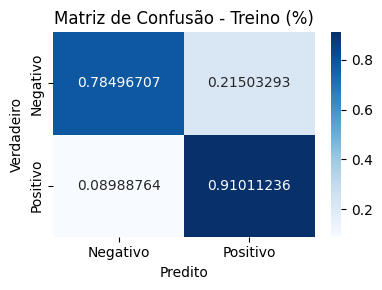

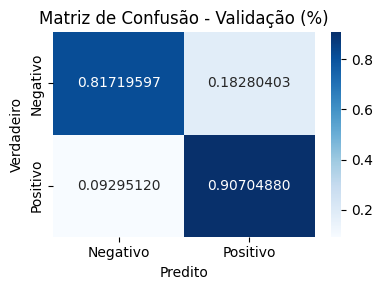

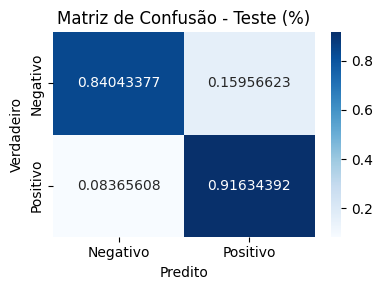

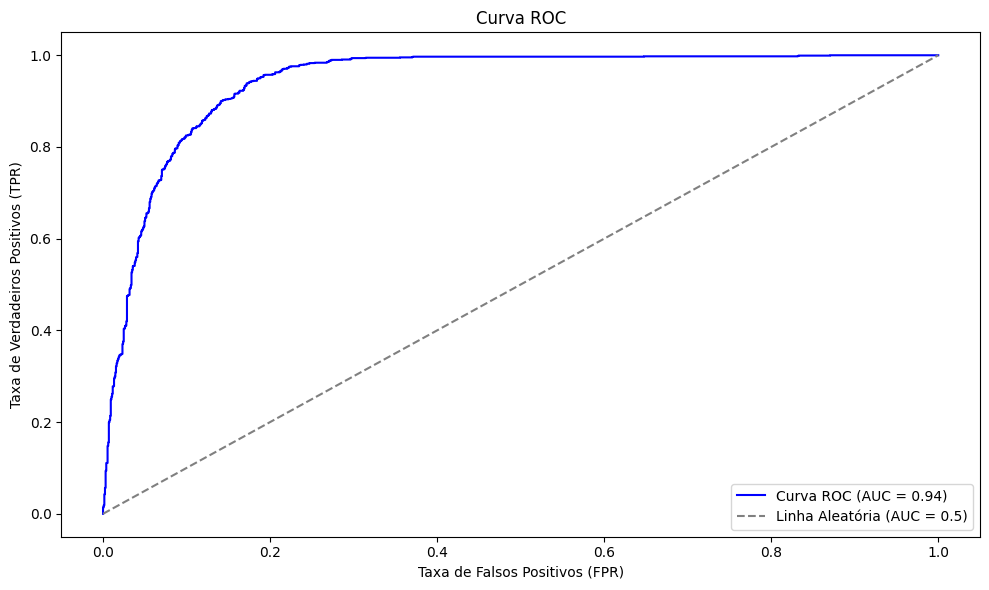

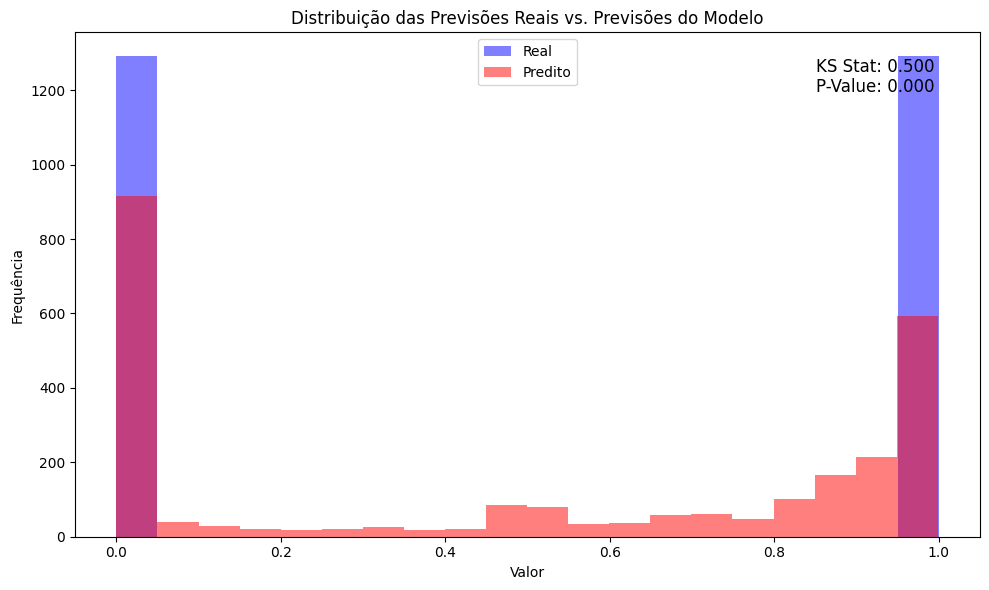

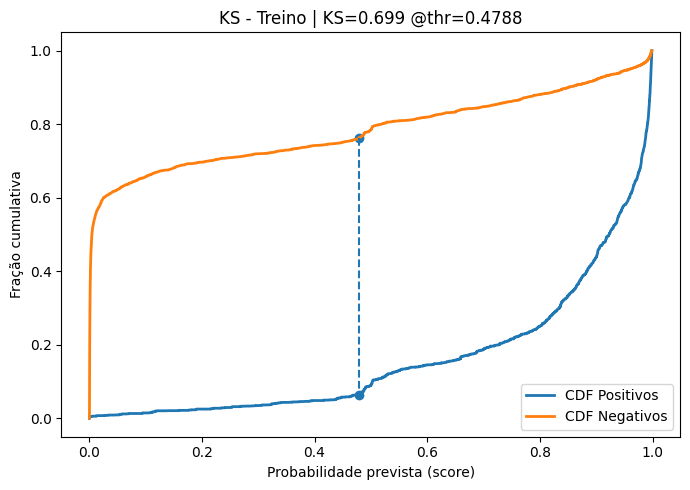

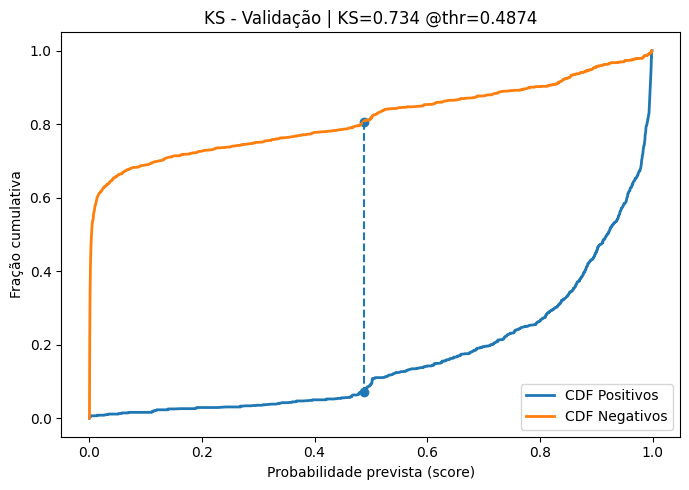

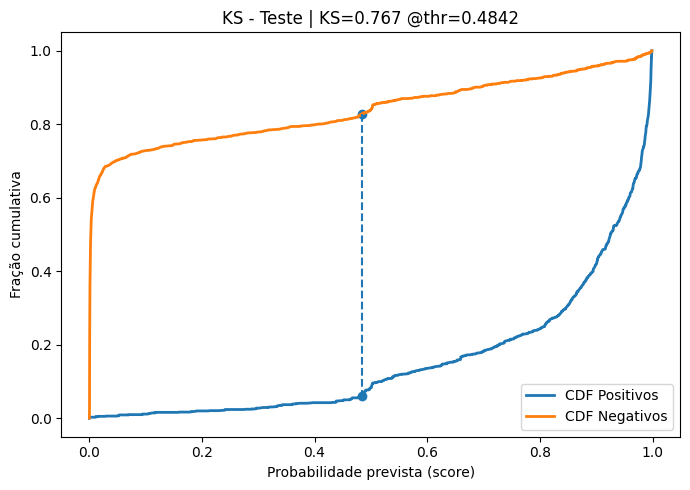

In [ ]:
model_torch = load_stab_from_state(   #para arquivos .pth/.pt torch.load($PATH, map_location="cpu")
    STAB1_PATH,
    input_dim=input_dim,
    d_model=64,
    n_heads=4,
    n_layers=2,
    dropout=0.1
)

evaluate_model_pytorch(
    model_torch,
    X_train_nn.astype("float32"),
    X_val_nn.astype("float32"),
    X_test_nn.astype("float32"),
    np.asarray(y_train_nn).ravel().astype(int),
    np.asarray(y_val_nn  ).ravel().astype(int),
    np.asarray(y_test_nn ).ravel().astype(int)
)



MSE Train: 0.13618752421542038
MSE Val: 0.1158017041053447
MSE Test: 0.10069713400464755




Cross-Entropy Train: 0.4459308385685281
Cross-Entropy Val: 0.348843229948442
Cross-Entropy Test: 0.2954546349875123




Accuracy Train: 0.8638124757845796
Accuracy Val: 0.8841982958946553
Accuracy Test: 0.8993028659953525




Precision Train: 0.8021235521235521
Precision Val: 0.8333333333333334
Precision Test: 0.8490182802979012




Recall Train: 0.9659046881053855
Recall Val: 0.9604957397366383
Recall Test: 0.9713400464756003




F1 Train: 0.8764281947618211
F1 Val: 0.8924073407700611
F1 Test: 0.9060693641618497




AUC Train: 0.9191315669105184
AUC Val: 0.9444521777112717
AUC Test: 0.9551392858021421




Confusion Matrix Train: 
[[1966  615]
 [  88 2493]]
Confusion Matrix Val: 
[[1043  248]
 [  51 1240]]
Confusion Matrix Test: 
[[1068  223]
 [  37 1254]]






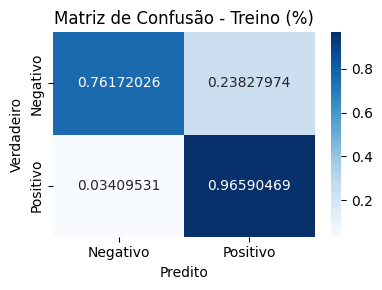

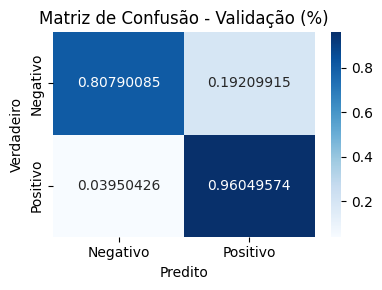

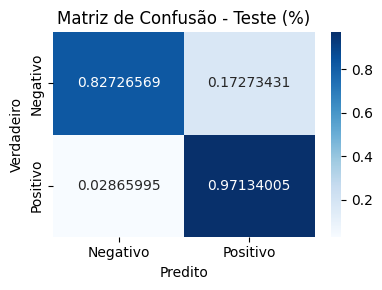

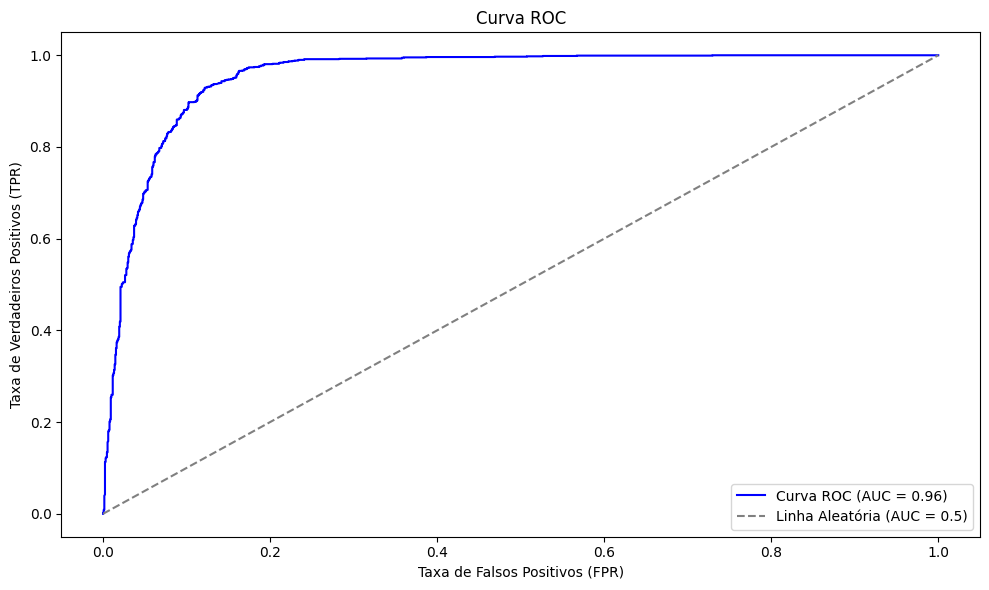

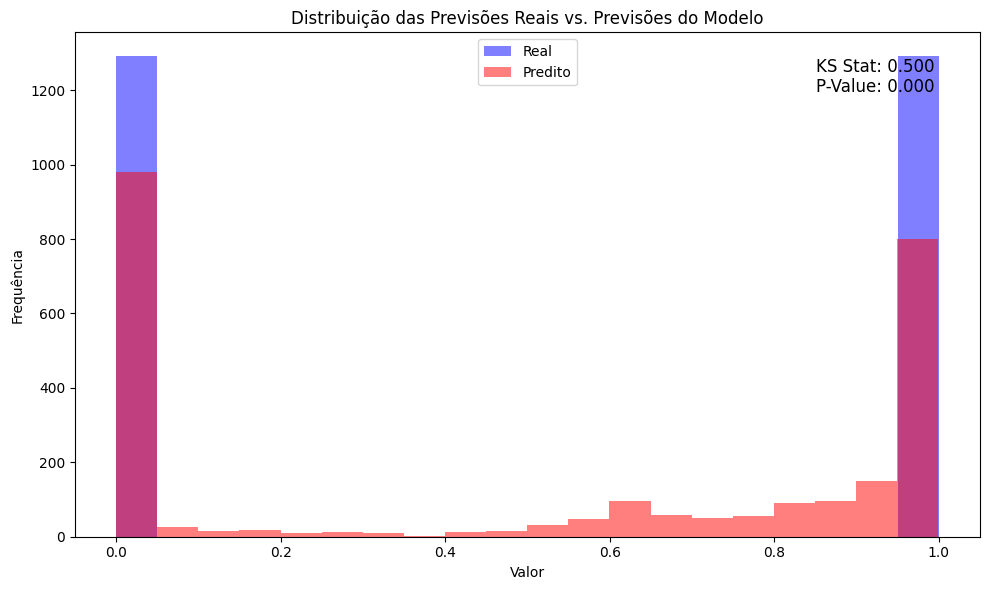

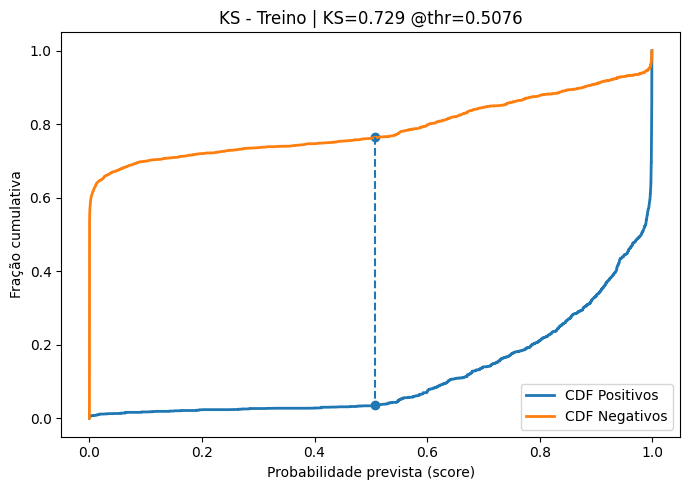

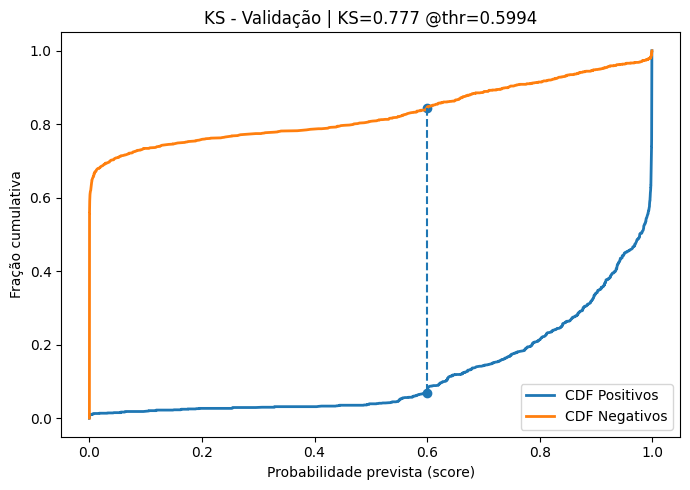

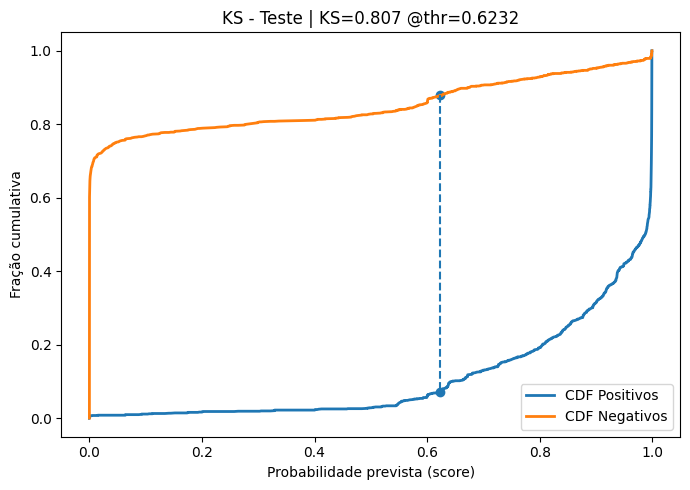

In [ ]:
model_torch = load_stab_from_state(   #para arquivos .pth/.pt torch.load($PATH, map_location="cpu")
    STAB2_PATH,
    input_dim=input_dim,
    d_model=64,
    n_heads=8,
    n_layers=3,
    dropout=0.3
)

evaluate_model_pytorch(
    model_torch,
    X_train_nn.astype("float32"),
    X_val_nn.astype("float32"),
    X_test_nn.astype("float32"),
    np.asarray(y_train_nn).ravel().astype(int),
    np.asarray(y_val_nn  ).ravel().astype(int),
    np.asarray(y_test_nn ).ravel().astype(int)
)



MSE Train: 0.11119721038357226
MSE Val: 0.07862122385747483
MSE Test: 0.07087529047250193




Cross-Entropy Train: 0.6996694950202011
Cross-Entropy Val: 0.41069280634922434
Cross-Entropy Test: 0.3619866147615909




Accuracy Train: 0.8888027896164278
Accuracy Val: 0.9213787761425252
Accuracy Test: 0.929124709527498




Precision Train: 0.8490434782608696
Precision Val: 0.9005891016200295
Precision Test: 0.9049707602339181




Recall Train: 0.945757458349477
Recall Val: 0.9473276529821844
Recall Test: 0.9589465530596437




F1 Train: 0.8947947214076246
F1 Val: 0.9233673084182711
F1 Test: 0.9311771342610003




AUC Train: 0.9336290698231239
AUC Val: 0.9647170034337704
AUC Test: 0.9705993528455655




Confusion Matrix Train: 
[[2147  434]
 [ 140 2441]]
Confusion Matrix Val: 
[[1156  135]
 [  68 1223]]
Confusion Matrix Test: 
[[1161  130]
 [  53 1238]]






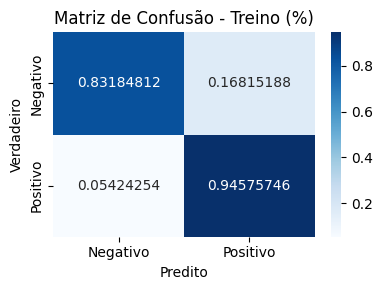

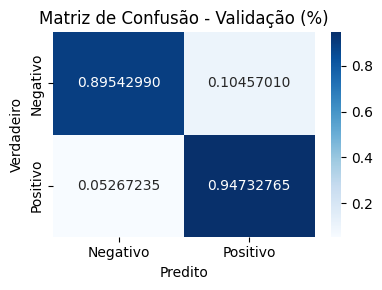

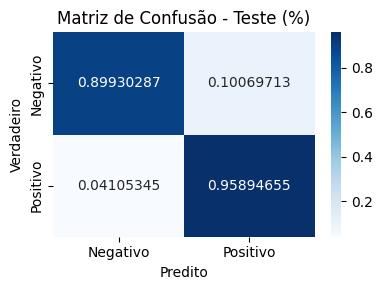

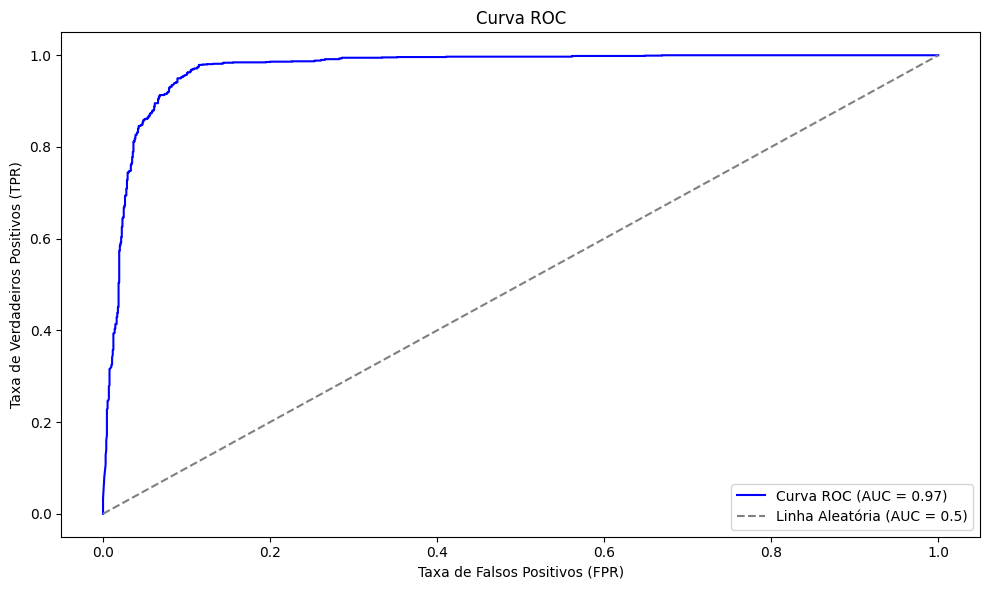

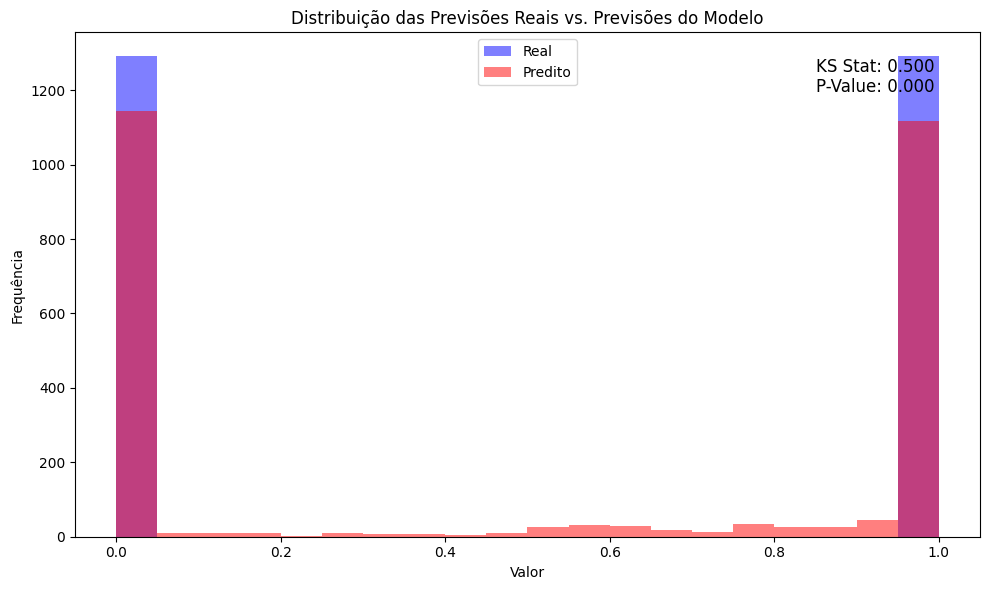

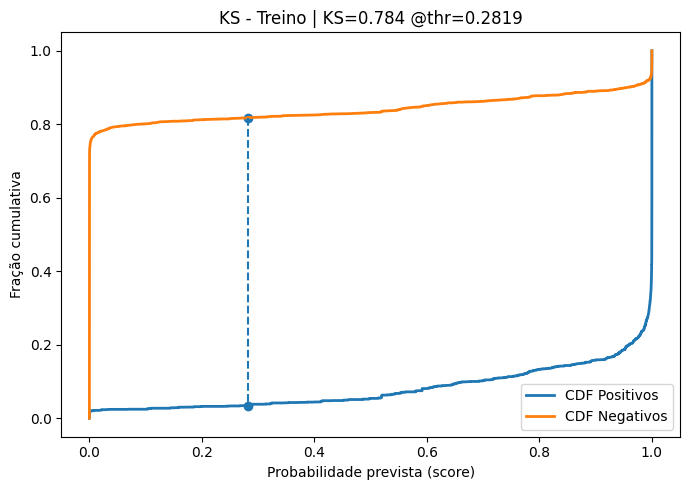

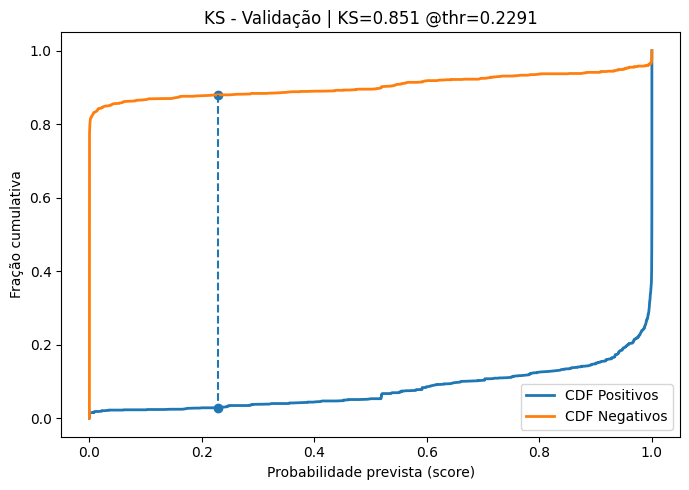

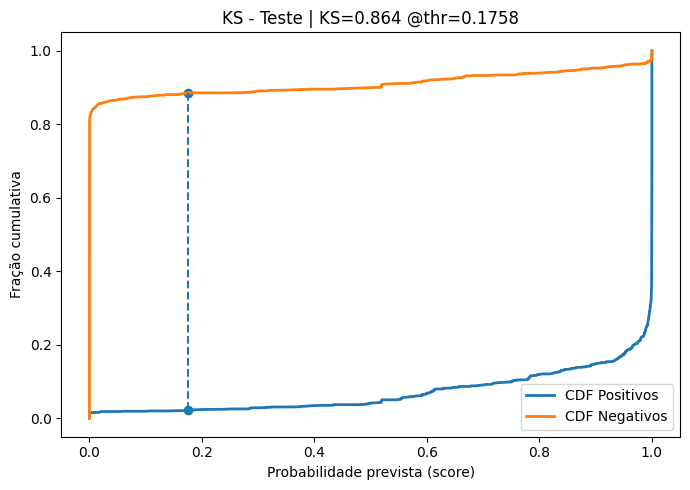

In [ ]:
model_torch = load_stab_from_state(   #para arquivos .pth/.pt torch.load($PATH, map_location="cpu")
    STAB3_PATH,
    input_dim=input_dim,
    d_model=64,
    n_heads=16,
    n_layers=1,
    dropout=0.1
)

evaluate_model_pytorch(
    model_torch,
    X_train_nn.astype("float32"),
    X_val_nn.astype("float32"),
    X_test_nn.astype("float32"),
    np.asarray(y_train_nn).ravel().astype(int),
    np.asarray(y_val_nn  ).ravel().astype(int),
    np.asarray(y_test_nn ).ravel().astype(int)
)